In [63]:
import sys
sys.path.append(r'/Users/malwersh/Desktop')
import MyFCA
import time
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

import random
import numpy as np
import time
import numpy as np
from scipy.sparse import random
from scipy.sparse import coo_matrix
from scipy.sparse import coo_matrix, csr_matrix, csc_matrix
from sklearn.cluster import KMeans
from sklearn.metrics import davies_bouldin_score, silhouette_score, silhouette_samples
import matplotlib.pyplot as plt
from scipy.sparse import csr_matrix
from scipy.sparse import random, csr_matrix
import numpy as np
from scipy.sparse import random
import heapq
# Load the categorical attribute data into a pandas DataFrame
#data = pd.read_csv(r'/Users/malwersh/Desktop/bunchdatsets/balance-scale/balance-scalecopy.csv')
data = pd.read_csv(r'/Users/malwersh/Desktop/bunchdatsets/tae/taescopy.csv')
#data = pd.read_csv(r'/Users/malwersh/Desktop/bunchdatsets/breast-cancer1/breastCancerss.csv')
#data = pd.read_csv(r'/Users/malwersh/Desktop/bunchdatsets/CarEvaluation/carcopy.csv')
#data = pd.read_csv(r'/Users/malwersh/Desktop/adult+stretch1.csv')


In [64]:
import pandas as pd

# Create a list of unique values for each column
unique_values = {}
for column in data.columns:
    unique_values[column] = data[column].unique()

# Create an empty binary matrix with the appropriate number of rows and columns
num_instances = len(data)
num_columns = sum([len(values) for values in unique_values.values()])
binary_matrix = pd.DataFrame(0, index=range(num_instances), columns=range(num_columns))

# Rename the columns of the binary matrix based on the unique values
column_index = 0
column_mapping = {}
attributes_names=[]
for column, values in unique_values.items():
    for value in values:
        binary_matrix.loc[:, column_index] = (data[column] == value).astype(int)
        column_mapping[column_index] = f"{column}_{str(value)}"
        attributes_names.append(column_mapping[column_index])
        column_index += 1

binary_matrix = binary_matrix.rename(columns=column_mapping)

# Print the binary matrix
print(binary_matrix)
attributes_names

     Eng_Nat_spk_1  Eng_Nat_spk_2  Course_Instructor_23  Course_Instructor_15  \
0                1              0                     1                     0   
1                0              1                     0                     1   
2                1              0                     1                     0   
3                1              0                     0                     0   
4                0              1                     0                     0   
..             ...            ...                   ...                   ...   
146              0              1                     0                     0   
147              0              1                     0                     0   
148              1              0                     0                     0   
149              0              1                     0                     0   
150              0              1                     0                     0   

     Course_Instructor_5  C

['Eng_Nat_spk_1',
 'Eng_Nat_spk_2',
 'Course_Instructor_23',
 'Course_Instructor_15',
 'Course_Instructor_5',
 'Course_Instructor_7',
 'Course_Instructor_9',
 'Course_Instructor_10',
 'Course_Instructor_22',
 'Course_Instructor_13',
 'Course_Instructor_18',
 'Course_Instructor_6',
 'Course_Instructor_25',
 'Course_Instructor_2',
 'Course_Instructor_1',
 'Course_Instructor_8',
 'Course_Instructor_14',
 'Course_Instructor_21',
 'Course_Instructor_11',
 'Course_Instructor_16',
 'Course_Instructor_4',
 'Course_Instructor_17',
 'Course_Instructor_20',
 'Course_Instructor_12',
 'Course_Instructor_24',
 'Course_Instructor_3',
 'Course_Instructor_19',
 'Course_3',
 'Course_2',
 'Course_11',
 'Course_5',
 'Course_22',
 'Course_1',
 'Course_21',
 'Course_17',
 'Course_25',
 'Course_7',
 'Course_9',
 'Course_15',
 'Course_13',
 'Course_8',
 'Course_16',
 'Course_19',
 'Course_14',
 'Course_6',
 'Course_12',
 'Course_18',
 'Course_23',
 'Course_26',
 'Course_24',
 'Course_20',
 'Course_4',
 'Cours

In [65]:
density = binary_matrix.mean().mean()
print('Density:', density)

Density: 0.04950495049504949


In [66]:
data=binary_matrix.values

In [67]:

import time
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from scipy.sparse import random, coo_matrix, csr_matrix, csc_matrix
import heapq
from typing import Set, List, Tuple, Dict
from collections import deque
import networkx as nx


class RandomContext:
    def __init__(self, num_objects, num_attributes, dens):
        self.num_objects = num_objects
        self.num_attributes = num_attributes 
        self.dens = dens

    def _generate_set(self, num, prefix):
        return [f"{prefix}{i + 1}" for i in range(num)]

    def get_objects(self):
        return self._generate_set(self.num_objects, 'o')
    
    def get_attributes(self):
        return self._generate_set(self.num_attributes, 'a')
    
    def get_context(self):
        return random(self.num_objects, self.num_attributes, density=self.dens, format='csr', data_rvs=np.ones)

class FormalConcepts:
    def __init__(self, objects, attributes, context):
        self.objects = objects
        self.attributes = attributes
        self.context = context
        self.concepts = self._get_formal_concepts()

    def _extract_indices(self, elements, reference_list):
        return [reference_list.index(e) for e in elements]

    def _set_with_mask(self, mask, reference_list):
        return {reference_list[i] for i, m in enumerate(mask) if m}

    def objects_with_attributes(self, subset_Y):
        subset_indices = self._extract_indices(subset_Y, self.attributes)
        mask = np.all(self.context[:, subset_indices].toarray(), axis=1)
        return self._set_with_mask(mask, self.objects)

    def attributes_with_objects(self, subset_O):
        subset_indices = self._extract_indices(subset_O, self.objects)
        mask = np.all(self.context[subset_indices, :].toarray(), axis=0)
        return self._set_with_mask(mask, self.attributes)

    def _get_formal_concepts(self):
        concepts = []
        B = set(self.attributes_with_objects(self.objects_with_attributes(())))
        A = set(self.objects_with_attributes(set(B)))
        concepts.append((A,B))
        while B != set(self.attributes):
            for index, i in reversed(list(enumerate(self.attributes))):
                if i in B:
                    B.remove(i)    
                else:
                    I_plus = self.attributes[:index]
                    inter_Un = B | set((i,)) # Use the `|` operator to compute the union
                    B_p = set(self.objects_with_attributes(inter_Un))
                    B_plus = set(self.attributes_with_objects(B_p))
                    if not set(I_plus) & (B_plus - B): # Use the `&` operator to compute the intersection
                        B = B_plus
                        D = tuple(B)
                        A = set(self.objects_with_attributes(B))
                        concepts.append((A,D))
                        break
        return  sorted(concepts, key=lambda x: len(x[0]))


    def object_concept(self):
        object_concept = {}
        for o in self.objects:
            shared_att=self.attributes_with_objects((o,))
            shared_obj=self.objects_with_attributes(shared_att)
            C_a=(set(shared_obj),set(shared_att))
            for idx, c in enumerate(self.concepts):
                if C_a[0].issubset(c[0]) and C_a[1].issubset(set(c[1])):
                    if idx in object_concept:
                        object_concept[idx] |= {o}
                    else:
                        object_concept[idx] = {o}
        return object_concept

    def attribute_concept(self):
        attribute_concept = {}
        for a in self.attributes:
            shared_obj=self.objects_with_attributes((a,))
            shared_att=self.attributes_with_objects(shared_obj)
            C_a=(set(shared_obj),set(shared_att))
            for idx, c in enumerate(self.concepts):
                if C_a[0].issubset(c[0]) and C_a[1].issubset(set(c[1])):
                    if idx in attribute_concept:
                        attribute_concept[idx] |= {a}
                    else:
                        attribute_concept[idx] = {a}
        return attribute_concept

    def _conceptualize(self, elements, func):
        element_concept = {}
        for elem in elements:
            shared_set = func((elem,))
            C_a = (shared_set, func(shared_set))
            for idx, c in enumerate(self.concepts):
                if C_a[0].issubset(c[0]) and C_a[1].issubset(c[1]):
                    element_concept.setdefault(idx, set()).add(elem)
        return element_concept




In [54]:
#generating random context
context = RandomContext(110, 9, 0.14)
objects=context.get_objects()
attributes=context.get_attributes()

new_context=context.get_context()
context=csr_matrix(new_context)

fc = FormalConcepts(objects, attributes, context)
concepts=fc._get_formal_concepts()
print('Done')
print('lattice Size',len(concepts))

Done
lattice Size 50


In [68]:
new_context=data
new_context=csr_matrix(new_context)
attributes=attributes_names

attributes

['Eng_Nat_spk_1',
 'Eng_Nat_spk_2',
 'Course_Instructor_23',
 'Course_Instructor_15',
 'Course_Instructor_5',
 'Course_Instructor_7',
 'Course_Instructor_9',
 'Course_Instructor_10',
 'Course_Instructor_22',
 'Course_Instructor_13',
 'Course_Instructor_18',
 'Course_Instructor_6',
 'Course_Instructor_25',
 'Course_Instructor_2',
 'Course_Instructor_1',
 'Course_Instructor_8',
 'Course_Instructor_14',
 'Course_Instructor_21',
 'Course_Instructor_11',
 'Course_Instructor_16',
 'Course_Instructor_4',
 'Course_Instructor_17',
 'Course_Instructor_20',
 'Course_Instructor_12',
 'Course_Instructor_24',
 'Course_Instructor_3',
 'Course_Instructor_19',
 'Course_3',
 'Course_2',
 'Course_11',
 'Course_5',
 'Course_22',
 'Course_1',
 'Course_21',
 'Course_17',
 'Course_25',
 'Course_7',
 'Course_9',
 'Course_15',
 'Course_13',
 'Course_8',
 'Course_16',
 'Course_19',
 'Course_14',
 'Course_6',
 'Course_12',
 'Course_18',
 'Course_23',
 'Course_26',
 'Course_24',
 'Course_20',
 'Course_4',
 'Cours

In [69]:
Nobjects=[f"{i}" for i in range(151)]

In [70]:
objects=Nobjects
context=new_context
fc = FormalConcepts(objects, attributes, context)
concepts=fc._get_formal_concepts()

print('Done')
print(len(concepts))

Done
276


In [39]:
lattice1=concepts #300, 17, 0.15 (394) 

In [43]:
lattice2=concepts #400, 28, 0.15 (1764)

In [48]:
lattice3=concepts #10000, 28, 0.05 (2461)

In [50]:
lattice4=concepts #23000, 47, 0.03 (5810)

In [55]:
lattice5=concepts #20000, 15, 0.20 (6899)

In [229]:
len(lattice2)

24

## GA

Universal Concept (Greatest): s276
Empty Concept (Least): s1

Attribute Concepts (must be included in C_M):
  Course_21: s149
  Course_Instructor_14: s226
  Class_Size_18: s71
  Course_Instructor_18: s228
  Class_Size_12: s76
  Class_Size_44: s50
  Class_Size_49: s122
  Course_Instructor_6: s227
  Course_Instructor_25: s174
  Class_Size_19: s252
  Course_16: s128
  Class_Size_26: s3
  Class_Size_37: s206
  Course_26: s5
  Class_Size_36: s134
  Class_Size_45: s68
  Course_Instructor_24: s5
  Course_Instructor_2: s173
  Course_6: s103
  Course_23: s16
  Class_Size_9: s100
  Class_Size_29: s199
  Class_Size_10: s205
  Course_12: s26
  Course_Instructor_22: s256
  Class_Size_48: s127
  Course_Instructor_13: s259
  Class_Size_54: s58
  Course_Instructor_20: s191
  Class_Size_28: s98
  Course_18: s69
  Course_Instructor_1: s172
  Course_9: s147
  Class_Size_3: s9
  Course_17: s248
  Course_7: s212
  Class_Size_20: s251
  Class_Size_15: s67
  Course_Instructor_3: s77
  Class_Size_31: s198
  C

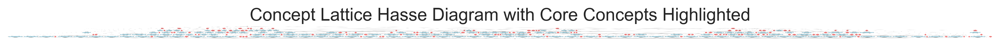

In [77]:
from typing import Set, List, Tuple, Dict
import networkx as nx
import matplotlib.pyplot as plt
import random
import numpy as np
import logging

# ----------------------------
# Function Definitions
# ----------------------------

def assign_ids(concepts_lattice: List[Tuple[Set[str], Tuple[str, ...]]]) -> List[Tuple[str, frozenset, frozenset]]:
    """
    Assigns unique IDs to each concept in the lattice.

    Returns:
    - List of tuples: (ID, extent, intent)
    """
    assigned_concepts = []
    for idx, (extent, intent) in enumerate(concepts_lattice, start=1):
        concept_id = f's{idx}'
        assigned_concepts.append((concept_id, frozenset(extent), frozenset(intent)))
    return assigned_concepts

def build_hasse_diagram(assigned_concepts: List[Tuple[str, frozenset, frozenset]]) -> nx.DiGraph:
    """
    Builds a directed Hasse diagram graph where each node is a concept ID.
    Edges point from a concept to its immediate subconcepts.

    Returns:
    - Directed Graph (networkx.DiGraph)
    """
    DG = nx.DiGraph()
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}

    # Initialize nodes
    for cid, _, _ in assigned_concepts:
        DG.add_node(cid)

    # For each concept, find its immediate subconcepts
    for cid_c, _, intent_c in assigned_concepts:
        # Potential subconcepts are those with intents that are supersets of intent_c and not equal
        potential_subconcepts = [(cid_d, intent_d) for cid_d, _, intent_d in assigned_concepts
                                 if intent_d != intent_c and intent_d.issuperset(intent_c)]

        # Now, for each potential subconcept, check if it's an immediate subconcept
        for cid_d, intent_d in potential_subconcepts:
            # There should be no concept intent_e such that intent_c ⊂ intent_e ⊂ intent_d
            is_immediate = True
            for cid_e, _, intent_e in assigned_concepts:
                if intent_e != intent_c and intent_e != intent_d:
                    if intent_e.issuperset(intent_c) and intent_e.issubset(intent_d):
                        is_immediate = False
                        break
            if is_immediate:
                # Add edge from cid_c to cid_d
                DG.add_edge(cid_c, cid_d)

    return DG

def find_attribute_concepts(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                            all_attributes: Set[str],
                            exclude_concepts: Set[str]) -> Dict[str, str]:
    """
    Finds the attribute concepts s_{A_i} for each attribute A_i in all_attributes,
    excluding any concepts in exclude_concepts.

    Returns:
    - Dictionary mapping attribute A_i to concept ID of s_{A_i}
    """
    attribute_concepts = {}
    for A_i in all_attributes:
        # Find concepts where A_i is in intent and not excluded
        concepts_with_Ai = [(cid, intent) for cid, _, intent in assigned_concepts
                            if A_i in intent and cid not in exclude_concepts]
        if not concepts_with_Ai:
            continue  # No concepts with A_i in intent
        # Find minimal intent size
        min_intent_size = min(len(intent) for cid, intent in concepts_with_Ai)
        # Select concepts with minimal intent size
        minimal_concepts = [(cid, intent) for cid, intent in concepts_with_Ai
                            if len(intent) == min_intent_size]
        # If multiple concepts, pick one (e.g., first)
        cid_min, _ = minimal_concepts[0]
        attribute_concepts[A_i] = cid_min
    return attribute_concepts

def generate_weighted_frequencies(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                                  C_M: Set[str],
                                  exclude_concepts: Set[str],
                                  seed_value: int = 42) -> Dict[str, float]:
    """
    Generates weighted frequency values for each concept.
    Core concepts (attributes and randomly selected) are assigned higher frequencies.
    Other concepts are assigned lower frequencies.
    The frequencies are normalized to sum to 1.

    Parameters:
    - assigned_concepts: List of all assigned concepts with IDs.
    - C_M: Core concepts subset.
    - exclude_concepts: Set of concepts to exclude from processing.
    - seed_value: Seed for random number generator for reproducibility.

    Returns:
    - Dictionary mapping concept IDs to their frequencies.
    """
    random.seed(seed_value)
    frequencies = {}
    total = 0.0

    for cid, _, intent in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts
        if cid in C_M:
            # Assign higher frequency range for core concepts
            freq = random.uniform(0.4, 1.0)  # Adjusted range for core concepts
        else:
            # Assign lower frequency range for non-core concepts
            freq = random.uniform(0.05, 0.3)  # Adjusted range for non-core concepts
        frequencies[cid] = freq
        total += freq

    # Normalize frequencies to sum to 1
    for cid in frequencies:
        frequencies[cid] /= total

    return frequencies

def assign_words_to_core_concepts(C_M: Set[str],
                                  assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                                  attribute_to_cid: Dict[str, str],
                                  P_s: Dict[str, float]) -> Dict[str, str]:
    """
    Assigns unique words to concepts in the core concepts C_M.

    For attribute concepts s_{A_i}, assigns the attribute name A_i as the word.
    For randomly selected core concepts, assigns unique words based on frequency.

    Parameters:
    - C_M: Set of concept IDs in core concepts.
    - assigned_concepts: List of all assigned concepts with IDs.
    - attribute_to_cid: Mapping from attribute to concept ID.
    - P_s: Frequency distribution of concepts.

    Returns:
    - Dictionary mapping concept IDs to words.
    """
    C_M_word_map = {}
    used_words = set()

    # Map from concept ID to intent and extent
    cid_to_intent = {cid: intent for cid, _, intent in assigned_concepts}
    cid_to_extent = {cid: extent for cid, extent, _ in assigned_concepts}

    # Assign words to attribute concepts
    for A_i, cid in attribute_to_cid.items():
        C_M_word_map[cid] = A_i
        used_words.add(A_i)

    # Identify randomly selected core concepts (C_M excluding attribute concepts)
    attribute_concept_ids = set(attribute_to_cid.values())
    random_core_concepts = C_M - attribute_concept_ids

    # If there are randomly selected core concepts, assign words based on frequency
    if random_core_concepts:
        # Sort randomly selected core concepts based on descending frequency
        sorted_random_C_M = sorted(random_core_concepts, key=lambda cid: P_s.get(cid, 0), reverse=True)

        extra_word_counter = 1

        for cid in sorted_random_C_M:
            extent = cid_to_extent[cid]
            intent = cid_to_intent[cid]
            # Prefer words from the intent
            possible_words = sorted(intent)
            # If intent is empty, use words from extent
            if not possible_words:
                possible_words = sorted(extent)
            # Assign the first available word not already used
            assigned = False
            for word in possible_words:
                if word not in used_words:
                    C_M_word_map[cid] = word
                    used_words.add(word)
                    assigned = True
                    break
            if not assigned:
                # If all words in intent and extent are used, assign any new unique word
                word = f'word{extra_word_counter}'
                extra_word_counter += 1
                C_M_word_map[cid] = word
                used_words.add(word)
    return C_M_word_map

def calculate_costs(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                    DG: nx.DiGraph,
                    C_M: Set[str],
                    id_to_intent: Dict[str, frozenset],
                    alpha_p: int = 1,
                    alpha_c: int = 2,
                    exclude_concepts: Set[str] = set(),
                    verbose: bool = True) -> Tuple[Dict[str, float], Dict[str, Tuple[str, str, Set[str]]]]:
    """
    Calculates the generation cost c(s) for each concept and identifies the minimal cost paths.

    Parameters:
    - assigned_concepts: List of all assigned concepts with IDs.
    - DG: Directed Hasse diagram graph.
    - C_M: Core concepts subset.
    - id_to_intent: Mapping from concept ID to intent.
    - alpha_p: Cost parameter for superconcept paths.
    - alpha_c: Cost parameter for subconcept paths.
    - exclude_concepts: Set of concepts to exclude from processing.

    Returns:
    - Tuple containing:
        - Dictionary mapping concept IDs to their costs.
        - Dictionary mapping concept IDs to their minimal cost path information.
    """
    c = {}
    min_cost_paths = {}  # To store minimal cost path info for each concept

    for cid, _, intent_s in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts
        if verbose:
            print(f"\nProcessing Concept {cid} with Intent: {set(intent_s)}")
        if cid in C_M:
            c_s = 1  # Single word representation
            c[cid] = c_s
            if verbose:
                print(f"  {cid} is in C_M. c({cid}) = {c_s}")
            min_cost_paths[cid] = ('core_concept', cid, set())
            continue
        # Initialize min_cost to a large value
        min_cost = float('inf')
        min_path = None  # To store minimal cost path info
        # Find nearest superconcepts in C_M
        superconcepts_in_C_M = set(nx.ancestors(DG, cid)).intersection(C_M)
        if superconcepts_in_C_M:
            # Reduce to nearest superconcepts in C_M
            nearest_superconcepts = []
            min_length = float('inf')
            for super_cid in superconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=super_cid, target=cid)
                    if length < min_length:
                        min_length = length
                        nearest_superconcepts = [super_cid]
                    elif length == min_length:
                        nearest_superconcepts.append(super_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest superconcepts in C_M: {sorted(nearest_superconcepts)}")
            for super_cid in nearest_superconcepts:
                # Compute cost via superconcept
                intent_s_p = id_to_intent[super_cid]
                A_r = intent_s - intent_s_p  # Remaining attributes
                cost_p = alpha_p * (1 + len(A_r))
                if verbose:
                    print(f"    Via Superconcept {super_cid}:")
                    print(f"      Attributes covered by {super_cid}: {intent_s_p}")
                    print(f"      Remaining Attributes to Add: {A_r}")
                    print(f"      Cost: {alpha_p} * (1 + {len(A_r)}) = {cost_p}")
                if cost_p < min_cost:
                    min_cost = cost_p
                    min_path = ('superconcept', super_cid, A_r)
        else:
            if verbose:
                print("  No superconcepts in C_M.")

        # Find nearest subconcepts in C_M
        subconcepts_in_C_M = set(nx.descendants(DG, cid)).intersection(C_M)
        if subconcepts_in_C_M:
            # Reduce to nearest subconcepts in C_M
            nearest_subconcepts = []
            min_length = float('inf')
            for sub_cid in subconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=cid, target=sub_cid)
                    if length < min_length:
                        min_length = length
                        nearest_subconcepts = [sub_cid]
                    elif length == min_length:
                        nearest_subconcepts.append(sub_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest subconcepts in C_M: {sorted(nearest_subconcepts)}")
            for sub_cid in nearest_subconcepts:
                # Compute cost via subconcept
                intent_s_c = id_to_intent[sub_cid]
                A_e = intent_s_c - intent_s  # Extra attributes to remove
                cost_c = alpha_c * (1 + len(A_e))
                if verbose:
                    print(f"    Via Subconcept {sub_cid}:")
                    print(f"      Attributes covered by {sub_cid}: {intent_s_c}")
                    print(f"      Extra Attributes to Remove: {A_e}")
                    print(f"      Cost: {alpha_c} * (1 + {len(A_e)}) = {cost_c}")
                if cost_c < min_cost:
                    min_cost = cost_c
                    min_path = ('subconcept', sub_cid, A_e)
        else:
            if verbose:
                print("  No subconcepts in C_M.")

        if min_cost == float('inf'):
            # No paths via C_M, assign default cost
            c_s = alpha_p * len(intent_s)
            if verbose:
                print(f"  No paths via C_M. Assigning default cost: c({cid}) = {c_s}")
            min_cost_paths[cid] = ('default', '', intent_s)
        else:
            c_s = min_cost
            if verbose:
                print(f"  Minimal Cost for {cid}: c({cid}) = {c_s}")
            min_cost_paths[cid] = min_path

        c[cid] = c_s

    return c, min_cost_paths

def generate_word_sequences(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                            DG: nx.DiGraph,
                            C_M: Set[str],
                            C_M_word_map: Dict[str, str],
                            c: Dict[str, float],
                            min_cost_paths: Dict[str, Tuple[str, str, Set[str]]],
                            exclude_concepts: Set[str],
                            attribute_to_cid: Dict[str, str],
                            ) -> Dict[str, str]:
    """
    Generates word sequences for each concept based on the minimal cost paths used in cost calculation.

    Parameters:
    - assigned_concepts: List of all assigned concepts with IDs.
    - DG: Directed Hasse diagram graph.
    - C_M: Core concepts subset.
    - C_M_word_map: Mapping from core concept IDs to words.
    - c: Dictionary of minimal costs for each concept.
    - min_cost_paths: Dictionary of minimal cost paths for each concept.
    - exclude_concepts: Set of concepts to exclude from processing.
    - attribute_to_cid: Mapping from attribute A_i to concept ID s_{A_i}

    Returns:
    - Dictionary mapping concept IDs to their generated word sequences.
    """
    word_sequences = {}

    for cid, _, intent_s in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts

        path_info = min_cost_paths.get(cid)
        if not path_info:
            # Assign 'Unknown' if no minimal cost path was found
            word_sequences[cid] = 'Unknown'
            continue

        path_type, ref_cid, attributes = path_info

        if path_type == 'core_concept':
            # Concept is in C_M
            word_sequences[cid] = C_M_word_map[cid]
        elif path_type in ['superconcept', 'subconcept']:
            # Word sequence is word of ref_cid + words of attributes
            words = [C_M_word_map[ref_cid]]
            for A_i in attributes:
                s_Ai_cid = attribute_to_cid.get(A_i)
                if s_Ai_cid and s_Ai_cid in C_M_word_map:
                    words.append(C_M_word_map[s_Ai_cid])
                else:
                    # Attribute concept not found, use attribute name
                    words.append(A_i)
            sequence = ' '.join(words)
            word_sequences[cid] = sequence.strip()
        elif path_type == 'default':
            # No paths via C_M, use words of attributes directly
            words = []
            for A_i in attributes:
                s_Ai_cid = attribute_to_cid.get(A_i)
                if s_Ai_cid and s_Ai_cid in C_M_word_map:
                    words.append(C_M_word_map[s_Ai_cid])
                else:
                    # Attribute concept not found, use attribute name
                    words.append(A_i)
            sequence = ' '.join(words)
            word_sequences[cid] = sequence.strip()
        else:
            # Should not happen, but handle unexpected cases
            word_sequences[cid] = 'Unknown'

    return word_sequences

def visualize_hasse_diagram(DG: nx.DiGraph,
                            id_to_intent: Dict[str, frozenset],
                            C_M_word_map: Dict[str, str],
                            C_M: Set[str],
                            exclude_concepts: Set[str],
                            output_filename: str = 'concept_lattice_hasse.png',
                            dpi: int = 300):
    """
    Visualizes the Hasse diagram of the concept lattice using NetworkX and PyGraphviz.
    The graph is set to display from Top to Bottom (rankdir=TB).

    Parameters:
    - DG: Directed Hasse diagram graph.
    - id_to_intent: Mapping from concept ID to intent.
    - C_M_word_map: Mapping from core concept IDs to words.
    - C_M: Core concepts subset.
    - exclude_concepts: Set of concepts to exclude from visualization (e.g., universal and empty).
    - output_filename: Filename for saving the visualization.
    - dpi: Resolution of the saved image.
    """
    try:
        import pygraphviz
        from networkx.drawing.nx_agraph import to_agraph
    except ImportError:
        print("PyGraphviz is not installed. Please install it to visualize the Hasse diagram.")
        return

    # Initialize PyGraphviz AGraph
    A = to_agraph(DG)

    # Set graph attributes for Top to Bottom direction
    A.graph_attr.update(rankdir='TB')  # Top to Bottom

    # Apply hierarchical layout
    A.layout(prog='dot')  # 'dot' is suitable for hierarchical layouts

    # Customize node styles
    for node in A.nodes():
        cid = node.name
        word = C_M_word_map.get(cid, '')
        if cid in C_M:
            node.attr['color'] = 'red'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightcoral'
            node.attr['label'] = f"{cid}\n{word}"
        elif cid in exclude_concepts:
            node.attr['color'] = 'gray'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightgray'
        else:
            node.attr['color'] = 'black'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightblue'
            node.attr['label'] = f"{cid}\n{set(id_to_intent[cid])}"
        node.attr['shape'] = 'ellipse'
        node.attr['fontsize'] = '10'

    # Customize edge styles
    for edge in A.edges():
        edge.attr['color'] = 'gray'
        edge.attr['arrowsize'] = '0.5'

    # Render the graph to a file with high resolution
    A.draw(output_filename, format='png', prog='dot')

    # Display the graph using matplotlib with increased figure size for better clarity
    plt.figure(figsize=(16, 12), dpi=dpi)  # Increased figure size and DPI
    img = plt.imread(output_filename)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Concept Lattice Hasse Diagram with Core Concepts Highlighted", fontsize=16)
    plt.show()

def print_relationships(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                        DG: nx.DiGraph,
                        id_to_intent: Dict[str, frozenset],
                        C_M: Set[str],
                        exclude_concepts: Set[str]) -> None:
    """
    Prints all superconcepts and subconcepts in L and C_M for each concept,
    excluding the universal and empty concepts.

    Parameters:
    - assigned_concepts: List of all assigned concepts with IDs.
    - DG: Directed Hasse diagram graph.
    - id_to_intent: Mapping from concept ID to intent.
    - C_M: Core concepts subset.
    - exclude_concepts: Set of concepts to exclude from printing.
    """
    for cid, extent, intent in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts

        print(f"Concept ID: {cid}")
        print("-" * 40)
        print(f"  Extent (Objects): {set(extent)}")
        print(f"  Intent (Attributes): {set(intent)}\n")

        # All superconcepts in L, excluding universal and empty concepts
        all_super_in_L = nx.ancestors(DG, cid) - exclude_concepts
        if all_super_in_L:
            print("  All Superconcepts in L:")
            for super_id in sorted(all_super_in_L, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("  All Superconcepts in L: None")

        # All superconcepts in C_M
        all_super_in_C_M = all_super_in_L.intersection(C_M)
        if all_super_in_C_M:
            print("\n  All Superconcepts in C_M:")
            for super_id in sorted(all_super_in_C_M, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("\n  All Superconcepts in C_M: None")

        # All subconcepts in L, excluding universal and empty concepts
        all_sub_in_L = nx.descendants(DG, cid) - exclude_concepts
        if all_sub_in_L:
            print("\n  All Subconcepts in L:")
            for sub_id in sorted(all_sub_in_L, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in L: None")

        # All subconcepts in C_M
        all_sub_in_C_M = all_sub_in_L.intersection(C_M)
        if all_sub_in_C_M:
            print("\n  All Subconcepts in C_M:")
            for sub_id in sorted(all_sub_in_C_M, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in C_M: None")

        print("-" * 40 + "\n")

# Genetic Algorithm Functions with Improvements

def initialize_population(pop_size: int,
                          num_additional_concepts: int,
                          attribute_concept_ids: Set[str],
                          exclude_concepts: Set[str],
                          total_concepts: List[str]) -> List[Set[str]]:
    """
    Initializes a population of individuals (subsets of concept IDs).
    Ensures diversity by random sampling.
    """
    population = []
    eligible_concepts = set(total_concepts) - attribute_concept_ids - exclude_concepts
    for _ in range(pop_size):
        individual = set(random.sample(eligible_concepts, num_additional_concepts))
        individual.update(attribute_concept_ids)
        population.append(individual)
    return population

def fitness_function(C_M_candidate: Set[str],
                     assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                     DG: nx.DiGraph,
                     exclude_concepts: Set[str],
                     id_to_intent: Dict[str, frozenset],
                     P_s: Dict[str, float],
                     attribute_to_cid: Dict[str, str],
                     alpha_p: int = 1,
                     alpha_c: int = 2) -> float:
    """
    Calculates the total expected generation cost c_M for a candidate C_M.
    """
    c_candidate, _ = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M_candidate,
        id_to_intent=id_to_intent,
        alpha_p=alpha_p,
        alpha_c=alpha_c,
        exclude_concepts=exclude_concepts,
        verbose=False
    )

    # Calculate Total Expected Generation Cost c_M
    c_M_total = 0.0
    for cid in c_candidate:
        c_s = c_candidate[cid]
        ps = P_s.get(cid, 0)
        term = c_s * ps
        c_M_total += term
    return c_M_total

def selection(population: List[Set[str]], fitness_scores: List[float], num_parents: int) -> List[Set[str]]:
    """
    Selects parents for crossover based on fitness scores using tournament selection.
    """
    parents = []
    for _ in range(num_parents):
        # Tournament selection with k=3
        candidates = random.sample(list(zip(population, fitness_scores)), k=3)
        parent = min(candidates, key=lambda x: x[1])[0]  # Select the individual with the lowest fitness
        parents.append(parent)
    return parents

def crossover(parent1: Set[str], parent2: Set[str], attribute_concept_ids: Set[str]) -> Set[str]:
    """
    Performs uniform crossover between two parents to produce an offspring.
    Ensures consistent gene ordering by sorting.
    """
    offspring = set()
    genes1 = sorted(parent1 - attribute_concept_ids)
    genes2 = sorted(parent2 - attribute_concept_ids)

    # Ensure both gene lists are of the same length by padding shorter one
    max_length = max(len(genes1), len(genes2))
    genes1.extend([None] * (max_length - len(genes1)))
    genes2.extend([None] * (max_length - len(genes2)))

    for gene1, gene2 in zip(genes1, genes2):
        if gene1 is None and gene2 is not None:
            offspring.add(gene2)
        elif gene2 is None and gene1 is not None:
            offspring.add(gene1)
        elif gene1 is not None and gene2 is not None:
            if random.random() < 0.5:
                offspring.add(gene1)
            else:
                offspring.add(gene2)
        # If both genes are None, do nothing

    # Ensure attribute concepts are included
    offspring.update(attribute_concept_ids)
    return offspring

def mutation(individual: Set[str], mutation_rate: float, eligible_concepts: Set[str], attribute_concept_ids: Set[str]) -> Set[str]:
    """
    Mutates an individual by randomly adding/removing concepts.
    """
    individual = set(individual)
    non_attribute_genes = individual - attribute_concept_ids
    for gene in list(non_attribute_genes):
        if random.random() < mutation_rate:
            individual.remove(gene)
            available_genes = eligible_concepts - individual
            if available_genes:
                new_gene = random.choice(list(available_genes))
                individual.add(new_gene)
    # Attribute concepts remain included
    individual.update(attribute_concept_ids)
    return individual

def calculate_genotypic_diversity(population: List[Set[str]]) -> float:
    """
    Calculates the average pairwise Hamming distance among individuals.
    """
    total_distance = 0
    count = 0
    pop_list = [list(individual) for individual in population]
    for i in range(len(pop_list)):
        for j in range(i + 1, len(pop_list)):
            set1 = set(pop_list[i])
            set2 = set(pop_list[j])
            distance = len(set1.symmetric_difference(set2))
            total_distance += distance
            count += 1
    return total_distance / count if count > 0 else 0

def genetic_algorithm(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                      DG: nx.DiGraph,
                      exclude_concepts: Set[str],
                      id_to_intent: Dict[str, frozenset],
                      P_s: Dict[str, float],
                      attribute_to_cid: Dict[str, str],
                      total_concepts: List[str],
                      pop_size: int = 50,
                      num_generations: int = 100,
                      mutation_rate: float = 0.1,
                      alpha_p: int = 1,
                      alpha_c: int = 2,
                      desired_percentage: float = 0.50,
                      seed_value: int = 42,
                      elitism_rate: float = 0.05) -> Set[str]:
    """
    Runs the genetic algorithm to find the optimal subset C_M.
    Incorporates elitism to preserve top individuals across generations.
    """
    random.seed(seed_value)
    np.random.seed(seed_value)

    # Calculate elite count
    elite_count = max(1, int(elitism_rate * pop_size))

    attribute_concept_ids = set(attribute_to_cid.values())
    total_concepts_set = set(total_concepts) - exclude_concepts

    # Calculate number of additional concepts to select (excluding attribute concepts)
    num_additional_concepts = int(round(desired_percentage * len(total_concepts_set - attribute_concept_ids)))
    # Ensure we don't select more concepts than are available
    num_additional_concepts = min(num_additional_concepts, len(total_concepts_set - attribute_concept_ids))

    # Total number of concepts to select (size of C_M)
    total_concepts_to_select = len(attribute_concept_ids) + num_additional_concepts

    print(f"Total number of concepts in the lattice (excluding exclude_concepts): {len(total_concepts_set)}")
    print(f"Number of attribute concepts: {len(attribute_concept_ids)}")
    print(f"Desired percentage of additional concepts: {desired_percentage * 100}%")
    print(f"Number of additional concepts to select: {num_additional_concepts}")
    print(f"Total number of concepts in C_M: {total_concepts_to_select}\n")

    # Initialize population
    population = initialize_population(
        pop_size=pop_size,
        num_additional_concepts=num_additional_concepts,
        attribute_concept_ids=attribute_concept_ids,
        exclude_concepts=exclude_concepts,
        total_concepts=total_concepts
    )

    best_fitness = float('inf')
    best_individual = None

    # Configure logging for monitoring
    logging.basicConfig(filename='ga_log.txt', level=logging.INFO,
                        format='%(asctime)s - Generation %(message)s')

    for generation in range(num_generations):
        fitness_scores = [fitness_function(
            individual, assigned_concepts, DG, exclude_concepts, id_to_intent, P_s, attribute_to_cid,
            alpha_p, alpha_c) for individual in population]

        # Identify elite individuals
        elite_indices = np.argsort(fitness_scores)[:elite_count]
        elites = [population[i] for i in elite_indices]
        elite_fitness = [fitness_scores[i] for i in elite_indices]

        # Update best individual
        if elite_fitness[0] < best_fitness:
            best_fitness = elite_fitness[0]
            best_individual = elites[0]

        # Calculate diversity
        diversity = calculate_genotypic_diversity(population)

        # Log current generation's best fitness and diversity
        logging.info(f"{generation + 1}, Best Fitness: {best_fitness:.4f}, Diversity: {diversity:.4f}")

        # Selection
        parents = selection(population, fitness_scores, num_parents=pop_size // 2)

        # Crossover and Mutation to create new population
        offspring = []
        eligible_concepts = set(total_concepts_set) - attribute_concept_ids
        while len(offspring) < pop_size - elite_count:
            parent1, parent2 = random.sample(parents, 2)
            child = crossover(parent1, parent2, attribute_concept_ids)
            # Adaptive mutation rate based on diversity (optional)
            adjusted_mutation_rate = mutation_rate * (1 - diversity / len(eligible_concepts))
            child = mutation(child, adjusted_mutation_rate, eligible_concepts, attribute_concept_ids)
            offspring.append(child)

        # Combine elites with offspring to form the new population
        population = elites + offspring

        if (generation + 1) % 10 == 0 or generation == 0:
            print(f"Generation {generation + 1}/{num_generations}, Best Fitness: {best_fitness:.4f}")

    print(f"\nOptimal c_M_total found: {best_fitness:.4f}")
    return best_individual

# ----------------------------
# Main Execution
# ----------------------------

if __name__ == "__main__":
    # Define your lattice data with corrected single-element intents
    # Example: concepts = [(set_of_extent, tuple_of_intent), ...]
    # Replace the following line with your actual concept lattice data

    # Example data (replace this with your actual data)
    # Ensure 'concepts' is defined appropriately
    # concepts_lattice = concepts

    # For demonstration purposes, here's a simple example lattice
    concepts_lattice = concepts

    # Assign unique IDs to each concept
    assigned_concepts = assign_ids(concepts_lattice)

    # Create mappings for easy reference
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}
    id_to_intent = {cid: intent for cid, _, intent in assigned_concepts}

    # Build directed Hasse diagram
    DG = build_hasse_diagram(assigned_concepts)  # Directed Hasse diagram

    # Build set of all objects and all attributes
    all_objects = set()
    all_attributes = set()
    for extent, intent in concepts_lattice:
        all_objects.update(extent)
        all_attributes.update(intent)

    # Convert to frozensets for comparison
    all_objects = frozenset(all_objects)
    all_attributes = frozenset(all_attributes)

    # Identify the universal (top) and empty (bottom) concepts
    universal_concept_id = None
    empty_concept_id = None
    for cid, extent, intent in assigned_concepts:
        if extent == all_objects and len(intent) == 0:
            universal_concept_id = cid
        if len(extent) == 0 and intent == all_attributes:
            empty_concept_id = cid

    exclude_concepts = {universal_concept_id, empty_concept_id}
    exclude_concepts.discard(None)  # Remove None values if any

    # Print Universal and Empty Concepts
    print(f"Universal Concept (Greatest): {universal_concept_id}")
    print(f"Empty Concept (Least): {empty_concept_id}\n")

    # Find attribute concepts and define Core Concepts C_M
    attribute_to_cid = find_attribute_concepts(assigned_concepts, all_attributes, exclude_concepts)
    C_M = set(attribute_to_cid.values())

    print("Attribute Concepts (must be included in C_M):")
    for attr, cid in attribute_to_cid.items():
        print(f"  {attr}: {cid}")
    print()

    # Generate weighted frequencies
    P_s = generate_weighted_frequencies(assigned_concepts, C_M, exclude_concepts)

    # Determine population size based on lattice size
    def determine_population_size(total_concepts: int, scaling_factor: float = 0.1) -> int:
        """
        Determines population size based on total number of concepts.
        """
        return max(50, int(total_concepts * scaling_factor))

    total_concept_ids = [cid for cid, _, _ in assigned_concepts]
    lattice_size = len(total_concept_ids) - len(exclude_concepts)
    pop_size = determine_population_size(lattice_size, scaling_factor=0.1)

    # Run Genetic Algorithm to find optimal C_M
    optimal_C_M = genetic_algorithm(
        assigned_concepts=assigned_concepts,
        DG=DG,
        exclude_concepts=exclude_concepts,
        id_to_intent=id_to_intent,
        P_s=P_s,
        attribute_to_cid=attribute_to_cid,
        total_concepts=total_concept_ids,
        pop_size=pop_size,
        num_generations=100,
        mutation_rate=0.1,
        alpha_p=1,
        alpha_c=2,
        desired_percentage=0.20,
        seed_value=42,
        elitism_rate=0.05  # 5% elitism
    )

    C_M = optimal_C_M

    print("\nCore Concepts C_M (Attribute Concepts + Optimized Concepts):")
    print(f"Total number of concepts in C_M: {len(C_M)}")
    print(f"Number of attribute concepts: {len(attribute_to_cid)}")
    print(f"Number of additional concepts: {len(C_M) - len(attribute_to_cid)}\n")
    for cid in sorted(C_M, key=lambda x: int(x[1:])):
        intent = id_to_intent[cid]
        print(f"  {cid}: {set(intent)}")
    print("\n" + "="*50 + "\n")

    # Assign words to C_M concepts based on frequency
    C_M_word_map = assign_words_to_core_concepts(C_M, assigned_concepts, attribute_to_cid, P_s)

    # Print relationships for all concepts, excluding universal and empty concepts
    print_relationships(assigned_concepts, DG, id_to_intent, C_M, exclude_concepts)

    # ----------------------------
    # Cost Calculation
    # ----------------------------

    # Initialize cost parameters
    alpha_p = 1
    alpha_c = 2

    print("\n" + "="*50 + "\n")
    print("Generation Cost c(s) for Each Concept (using new cost calculation with tracing):")
    print("----------------------------------------------------------------")

    # Calculate costs
    c, min_cost_paths = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M,
        id_to_intent=id_to_intent,
        alpha_p=alpha_p,
        alpha_c=alpha_c,
        exclude_concepts=exclude_concepts,
        verbose=True
    )

    # Calculate Total Expected Generation Cost c_M
    print("\nTotal Expected Generation Cost c_M (using new cost calculation):")
    print("----------------------------------------------------------------")
    c_M_total = 0.0
    for cid in sorted(c.keys(), key=lambda x: int(x[1:])):
        c_s = c[cid]
        ps = P_s.get(cid, 0)
        term = c_s * ps
        c_M_total += term
        print(f"  {cid}: c({cid}) * P({cid}) = {c_s} * {ps:.4f} = {term:.4f}")
    print(f"\nTotal Expected Generation Cost c_M = {c_M_total:.4f}")

    # Generate word sequences based on minimal cost paths
    word_sequences = generate_word_sequences(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M,
        C_M_word_map=C_M_word_map,
        c=c,
        min_cost_paths=min_cost_paths,
        exclude_concepts=exclude_concepts,
        attribute_to_cid=attribute_to_cid
    )

    # Print word sequences for verification
    print("\nWord Sequences for Each Concept:\n")
    for cid in sorted(word_sequences.keys(), key=lambda x: int(x[1:])):  # Sort by numerical ID
        sequence = word_sequences[cid]
        word_count = len(sequence.split()) if sequence else 0
        print(f"{cid}: '{sequence}' (Word Count: {word_count})")

    # ----------------------------
    # Visualization
    # ----------------------------

    # Visualize the Hasse Diagram
    visualize_hasse_diagram(
        DG=DG,
        id_to_intent=id_to_intent,
        C_M_word_map=C_M_word_map,
        C_M=C_M,
        exclude_concepts=exclude_concepts,
        output_filename='concept_lattice_hasse.png',
        dpi=300
    )


## SA

Universal Concept (Greatest): s276
Empty Concept (Least): s1

Attribute Concepts (must be included in C_M):
  Course_21: s149
  Course_Instructor_14: s226
  Class_Size_18: s71
  Course_Instructor_18: s228
  Class_Size_12: s76
  Class_Size_44: s50
  Class_Size_49: s122
  Course_Instructor_6: s227
  Course_Instructor_25: s174
  Class_Size_19: s252
  Course_16: s128
  Class_Size_26: s3
  Class_Size_37: s206
  Course_26: s5
  Class_Size_36: s134
  Class_Size_45: s68
  Course_Instructor_24: s5
  Course_Instructor_2: s173
  Course_6: s103
  Course_23: s16
  Class_Size_9: s100
  Class_Size_29: s199
  Class_Size_10: s205
  Course_12: s26
  Course_Instructor_22: s256
  Class_Size_48: s127
  Course_Instructor_13: s259
  Class_Size_54: s58
  Course_Instructor_20: s191
  Class_Size_28: s98
  Course_18: s69
  Course_Instructor_1: s172
  Course_9: s147
  Class_Size_3: s9
  Course_17: s248
  Course_7: s212
  Class_Size_20: s251
  Class_Size_15: s67
  Course_Instructor_3: s77
  Class_Size_31: s198
  C

Iteration 99, Temperature: 9.3482, Best Fitness: 1.3283
Iteration 100, Temperature: 8.8808, Best Fitness: 1.3283
Iteration 101, Temperature: 8.4368, Best Fitness: 1.3283
Iteration 102, Temperature: 8.0149, Best Fitness: 1.3283
Iteration 103, Temperature: 7.6142, Best Fitness: 1.3283
Iteration 104, Temperature: 7.2335, Best Fitness: 1.3283
Iteration 105, Temperature: 6.8718, Best Fitness: 1.3283
Iteration 106, Temperature: 6.5282, Best Fitness: 1.3283
Iteration 107, Temperature: 6.2018, Best Fitness: 1.3283
Iteration 108, Temperature: 5.8917, Best Fitness: 1.3283
Iteration 109, Temperature: 5.5971, Best Fitness: 1.3283
Iteration 110, Temperature: 5.3173, Best Fitness: 1.3283
Iteration 111, Temperature: 5.0514, Best Fitness: 1.3283
Iteration 112, Temperature: 4.7988, Best Fitness: 1.3283
Iteration 113, Temperature: 4.5589, Best Fitness: 1.3283
Iteration 114, Temperature: 4.3309, Best Fitness: 1.3283
Iteration 115, Temperature: 4.1144, Best Fitness: 1.3283
Iteration 116, Temperature: 3.90

/Users/malwersh/anaconda3/envs/new_env_name/lib/python3.8/site-packages/pygraphviz/agraph.py:1405: RuntimeWarning: dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.703683 to fit

  warnings.warn(b"".join(errors).decode(self.encoding), RuntimeWarning)


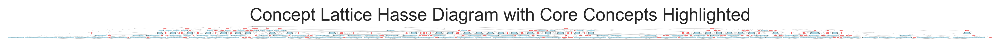

In [78]:
from typing import Set, List, Tuple, Dict
import networkx as nx
import matplotlib.pyplot as plt
import random
import numpy as np

# ----------------------------
# Function Definitions
# ----------------------------

def assign_ids(concepts_lattice: List[Tuple[Set[str], Tuple[str, ...]]]) -> List[Tuple[str, frozenset, frozenset]]:
    """
    Assigns unique IDs to each concept in the lattice.

    Returns:
    - List of tuples: (ID, extent, intent)
    """
    assigned_concepts = []
    for idx, (extent, intent) in enumerate(concepts_lattice, start=1):
        concept_id = f's{idx}'
        assigned_concepts.append((concept_id, frozenset(extent), frozenset(intent)))
    return assigned_concepts

def build_hasse_diagram(assigned_concepts: List[Tuple[str, frozenset, frozenset]]) -> nx.DiGraph:
    """
    Builds a directed Hasse diagram graph where each node is a concept ID.
    Edges point from a concept to its immediate subconcepts.

    Returns:
    - Directed Graph (networkx.DiGraph)
    """
    DG = nx.DiGraph()
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}

    # Initialize nodes
    for cid, _, _ in assigned_concepts:
        DG.add_node(cid)

    # For each concept, find its immediate subconcepts
    for cid_c, _, intent_c in assigned_concepts:
        # Potential subconcepts are those with intents that are supersets of intent_c and not equal
        potential_subconcepts = [(cid_d, intent_d) for cid_d, _, intent_d in assigned_concepts
                                 if intent_d != intent_c and intent_d.issuperset(intent_c)]

        # Now, for each potential subconcept, check if it's an immediate subconcept
        for cid_d, intent_d in potential_subconcepts:
            # There should be no concept intent_e such that intent_c ⊂ intent_e ⊂ intent_d
            is_immediate = True
            for cid_e, _, intent_e in assigned_concepts:
                if intent_e != intent_c and intent_e != intent_d:
                    if intent_e.issuperset(intent_c) and intent_e.issubset(intent_d):
                        is_immediate = False
                        break
            if is_immediate:
                # Add edge from cid_c to cid_d
                DG.add_edge(cid_c, cid_d)

    return DG

def find_attribute_concepts(assigned_concepts: List[Tuple[str, frozenset, frozenset]], 
                           all_attributes: Set[str],
                           exclude_concepts: Set[str]) -> Dict[str, str]:
    """
    Finds the attribute concepts s_{A_i} for each attribute A_i in all_attributes,
    excluding any concepts in exclude_concepts.

    Returns:
    - Dictionary mapping attribute A_i to concept ID of s_{A_i}
    """
    attribute_concepts = {}
    for A_i in all_attributes:
        # Find concepts where A_i is in intent and not excluded
        concepts_with_Ai = [(cid, intent) for cid, _, intent in assigned_concepts 
                            if A_i in intent and cid not in exclude_concepts]
        if not concepts_with_Ai:
            continue  # No concepts with A_i in intent
        # Find minimal intent size
        min_intent_size = min(len(intent) for cid, intent in concepts_with_Ai)
        # Select concepts with minimal intent size
        minimal_concepts = [(cid, intent) for cid, intent in concepts_with_Ai 
                            if len(intent) == min_intent_size]
        # If multiple concepts, pick one (e.g., first)
        cid_min, _ = minimal_concepts[0]
        attribute_concepts[A_i] = cid_min
    return attribute_concepts

# Simulated Annealing Functions
def initial_solution(attribute_concept_ids: Set[str],
                     eligible_concepts: Set[str],
                     num_additional_concepts: int) -> Set[str]:
    """
    Generates an initial solution (subset of concept IDs).
    """
    solution = set(random.sample(eligible_concepts, num_additional_concepts))
    solution.update(attribute_concept_ids)
    return solution

def fitness_function(C_M_candidate: Set[str],
                     assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                     DG: nx.DiGraph,
                     exclude_concepts: Set[str],
                     id_to_intent: Dict[str, frozenset],
                     P_s: Dict[str, float],
                     attribute_to_cid: Dict[str, str],
                     alpha_p: int = 1,
                     alpha_c: int = 2) -> float:
    """
    Calculates the total expected generation cost c_M for a candidate C_M.
    """
    # Calculate costs c(s) and minimal cost paths for the candidate C_M
    c_candidate, _ = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M_candidate,
        id_to_intent=id_to_intent,
        alpha_p=alpha_p,
        alpha_c=alpha_c,
        exclude_concepts=exclude_concepts,
        verbose=False  # Suppress detailed tracing during fitness evaluation
    )

    # Calculate Total Expected Generation Cost c_M
    c_M_total = 0.0
    for cid in c_candidate:
        c_s = c_candidate[cid]
        ps = P_s.get(cid, 0)
        term = c_s * ps
        c_M_total += term
    return c_M_total

def get_neighbor(solution: Set[str],
                 attribute_concept_ids: Set[str],
                 eligible_concepts: Set[str]) -> Set[str]:
    """
    Generates a neighboring solution by swapping a concept.
    """
    neighbor = set(solution)
    non_attribute_genes = neighbor - attribute_concept_ids
    if not non_attribute_genes:
        return neighbor  # No non-attribute genes to swap

    # Remove a random non-attribute concept
    gene_to_remove = random.choice(list(non_attribute_genes))
    neighbor.remove(gene_to_remove)

    # Add a new concept not in the current solution
    available_genes = eligible_concepts - neighbor - attribute_concept_ids
    if available_genes:
        gene_to_add = random.choice(list(available_genes))
        neighbor.add(gene_to_add)
    else:
        # If no available genes, re-add the removed gene
        neighbor.add(gene_to_remove)

    return neighbor

def simulated_annealing(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                        DG: nx.DiGraph,
                        exclude_concepts: Set[str],
                        id_to_intent: Dict[str, frozenset],
                        P_s: Dict[str, float],
                        attribute_to_cid: Dict[str, str],
                        total_concepts: List[str],
                        initial_temp: float = 1000.0,
                        final_temp: float = 1.0,
                        alpha: float = 0.9,
                        num_iterations: int = 100,
                        desired_percentage: float = 0.20,
                        seed_value: int = None) -> Set[str]:
    """
    Runs the simulated annealing algorithm to find the optimal subset C_M.
    """
    if seed_value is not None:
        random.seed(seed_value)
        np.random.seed(seed_value)

    attribute_concept_ids = set(attribute_to_cid.values())
    total_concepts_set = set(total_concepts) - exclude_concepts

    # Calculate number of additional concepts to select (excluding attribute concepts)
    num_additional_concepts = int(round(desired_percentage * len(total_concepts_set - attribute_concept_ids)))
    # Ensure we don't select more concepts than are available
    num_additional_concepts = min(num_additional_concepts, len(total_concepts_set - attribute_concept_ids))

    # Total number of concepts to select (size of C_M)
    total_concepts_to_select = len(attribute_concept_ids) + num_additional_concepts

    print(f"Total number of concepts in the lattice (excluding exclude_concepts): {len(total_concepts_set)}")
    print(f"Number of attribute concepts: {len(attribute_concept_ids)}")
    print(f"Desired percentage of additional concepts: {desired_percentage * 100}%")
    print(f"Number of additional concepts to select: {num_additional_concepts}")
    print(f"Total number of concepts in C_M: {total_concepts_to_select}\n")

    # Generate initial solution
    eligible_concepts = total_concepts_set - attribute_concept_ids
    current_solution = initial_solution(attribute_concept_ids, eligible_concepts, num_additional_concepts)
    current_fitness = fitness_function(
        C_M_candidate=current_solution,
        assigned_concepts=assigned_concepts,
        DG=DG,
        exclude_concepts=exclude_concepts,
        id_to_intent=id_to_intent,
        P_s=P_s,
        attribute_to_cid=attribute_to_cid
    )

    best_solution = set(current_solution)
    best_fitness = current_fitness

    temp = initial_temp
    iteration = 0

    while temp > final_temp:
        for _ in range(num_iterations):
            neighbor_solution = get_neighbor(current_solution, attribute_concept_ids, eligible_concepts)
            neighbor_fitness = fitness_function(
                C_M_candidate=neighbor_solution,
                assigned_concepts=assigned_concepts,
                DG=DG,
                exclude_concepts=exclude_concepts,
                id_to_intent=id_to_intent,
                P_s=P_s,
                attribute_to_cid=attribute_to_cid
            )

            delta_fitness = neighbor_fitness - current_fitness

            if delta_fitness < 0 or random.uniform(0, 1) < np.exp(-delta_fitness / temp):
                current_solution = neighbor_solution
                current_fitness = neighbor_fitness

                if current_fitness < best_fitness:
                    best_solution = set(current_solution)
                    best_fitness = current_fitness

        temp *= alpha
        iteration += 1
        print(f"Iteration {iteration}, Temperature: {temp:.4f}, Best Fitness: {best_fitness:.4f}")

    print(f"\nOptimal c_M_total found: {best_fitness:.4f}")
    return best_solution

def generate_weighted_frequencies(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                                  C_M: Set[str],
                                  exclude_concepts: Set[str],
                                  seed_value: int = None) -> Dict[str, float]:
    """
    Generates weighted frequency values for each concept.
    """
    if seed_value is not None:
        random.seed(seed_value)

    frequencies = {}
    total = 0.0

    for cid, _, intent in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts
        if cid in C_M:
            # Assign higher frequency range for core concepts
            freq = random.uniform(0.4, 1.0)  # Adjusted range for core concepts
        else:
            # Assign lower frequency range for non-core concepts
            freq = random.uniform(0.05, 0.3)  # Adjusted range for non-core concepts
        frequencies[cid] = freq
        total += freq

    # Normalize frequencies to sum to 1
    for cid in frequencies:
        frequencies[cid] /= total

    print("\nWeighted Frequency Distribution P(s):")
    print("--------------------------------------")
    for cid in sorted(frequencies, key=lambda x: int(x[1:])):
        freq = frequencies[cid]
        print(f"  {cid}: {freq:.4f}")
    print("\n" + "="*50 + "\n")

    return frequencies

def assign_words_to_core_concepts(C_M: Set[str], 
                                  assigned_concepts: List[Tuple[str, frozenset, frozenset]], 
                                  attribute_to_cid: Dict[str, str], 
                                  P_s: Dict[str, float]) -> Dict[str, str]:
    """
    Assigns unique words to concepts in the core concepts C_M.
    """
    C_M_word_map = {}
    used_words = set()

    # Map from concept ID to intent and extent
    cid_to_intent = {cid: intent for cid, _, intent in assigned_concepts}
    cid_to_extent = {cid: extent for cid, extent, _ in assigned_concepts}

    # Assign words to attribute concepts
    for A_i, cid in attribute_to_cid.items():
        C_M_word_map[cid] = A_i
        used_words.add(A_i)

    # Identify randomly selected core concepts (C_M excluding attribute concepts)
    attribute_concept_ids = set(attribute_to_cid.values())
    random_core_concepts = C_M - attribute_concept_ids

    # If there are randomly selected core concepts, assign words based on frequency
    if random_core_concepts:
        # Sort randomly selected core concepts based on descending frequency
        sorted_random_C_M = sorted(random_core_concepts, key=lambda cid: P_s.get(cid, 0), reverse=True)

        extra_word_counter = 1

        for cid in sorted_random_C_M:
            extent = cid_to_extent[cid]
            intent = cid_to_intent[cid]
            # Prefer words from the intent
            possible_words = sorted(intent)
            # If intent is empty, use words from extent
            if not possible_words:
                possible_words = sorted(extent)
            # Assign the first available word not already used
            assigned = False
            for word in possible_words:
                if word not in used_words:
                    C_M_word_map[cid] = word
                    used_words.add(word)
                    assigned = True
                    break
            if not assigned:
                # If all words in intent and extent are used, assign any new unique word
                word = f'word{extra_word_counter}'
                extra_word_counter += 1
                C_M_word_map[cid] = word
                used_words.add(word)
    return C_M_word_map

def calculate_costs(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                   DG: nx.DiGraph,
                   C_M: Set[str],
                   id_to_intent: Dict[str, frozenset],
                   alpha_p: int = 1,
                   alpha_c: int = 2,
                   exclude_concepts: Set[str] = set(),
                   verbose: bool = True) -> Tuple[Dict[str, float], Dict[str, Tuple[str, str, Set[str]]]]:
    """
    Calculates the generation cost c(s) for each concept and identifies the minimal cost paths.
    """
    c = {}
    min_cost_paths = {}  # To store minimal cost path info for each concept

    for cid, _, intent_s in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts
        if verbose:
            print(f"\nProcessing Concept {cid} with Intent: {set(intent_s)}")
        if cid in C_M:
            c_s = 1  # Single word representation
            c[cid] = c_s
            if verbose:
                print(f"  {cid} is in C_M. c({cid}) = {c_s}")
            min_cost_paths[cid] = ('core_concept', cid, set())
            continue
        # Initialize min_cost to a large value
        min_cost = float('inf')
        min_path = None  # To store minimal cost path info
        # Find nearest superconcepts in C_M
        superconcepts_in_C_M = set(nx.ancestors(DG, cid)).intersection(C_M)
        if superconcepts_in_C_M:
            # Reduce to nearest superconcepts in C_M
            nearest_superconcepts = []
            min_length = float('inf')
            for super_cid in superconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=super_cid, target=cid)
                    if length < min_length:
                        min_length = length
                        nearest_superconcepts = [super_cid]
                    elif length == min_length:
                        nearest_superconcepts.append(super_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest superconcepts in C_M: {sorted(nearest_superconcepts)}")
            for super_cid in nearest_superconcepts:
                # Compute cost via superconcept
                intent_s_p = id_to_intent[super_cid]
                A_r = intent_s - intent_s_p  # Remaining attributes
                cost_p = alpha_p * (1 + len(A_r))
                if verbose:
                    print(f"    Via Superconcept {super_cid}:")
                    print(f"      Attributes covered by {super_cid}: {intent_s_p}")
                    print(f"      Remaining Attributes to Add: {A_r}")
                    print(f"      Cost: {alpha_p} * (1 + {len(A_r)}) = {cost_p}")
                if cost_p < min_cost:
                    min_cost = cost_p
                    min_path = ('superconcept', super_cid, A_r)
        else:
            if verbose:
                print("  No superconcepts in C_M.")

        # Find nearest subconcepts in C_M
        subconcepts_in_C_M = set(nx.descendants(DG, cid)).intersection(C_M)
        if subconcepts_in_C_M:
            # Reduce to nearest subconcepts in C_M
            nearest_subconcepts = []
            min_length = float('inf')
            for sub_cid in subconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=cid, target=sub_cid)
                    if length < min_length:
                        min_length = length
                        nearest_subconcepts = [sub_cid]
                    elif length == min_length:
                        nearest_subconcepts.append(sub_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest subconcepts in C_M: {sorted(nearest_subconcepts)}")
            for sub_cid in nearest_subconcepts:
                # Compute cost via subconcept
                intent_s_c = id_to_intent[sub_cid]
                A_e = intent_s_c - intent_s  # Extra attributes to remove
                cost_c = alpha_c * (1 + len(A_e))
                if verbose:
                    print(f"    Via Subconcept {sub_cid}:")
                    print(f"      Attributes covered by {sub_cid}: {intent_s_c}")
                    print(f"      Extra Attributes to Remove: {A_e}")
                    print(f"      Cost: {alpha_c} * (1 + {len(A_e)}) = {cost_c}")
                if cost_c < min_cost:
                    min_cost = cost_c
                    min_path = ('subconcept', sub_cid, A_e)
        else:
            if verbose:
                print("  No subconcepts in C_M.")

        if min_cost == float('inf'):
            # No paths via C_M, assign default cost
            c_s = alpha_p * len(intent_s)
            if verbose:
                print(f"  No paths via C_M. Assigning default cost: c({cid}) = {c_s}")
            min_cost_paths[cid] = ('default', '', intent_s)
        else:
            c_s = min_cost
            if verbose:
                print(f"  Minimal Cost for {cid}: c({cid}) = {c_s}")
            min_cost_paths[cid] = min_path

        c[cid] = c_s

    return c, min_cost_paths

def generate_word_sequences(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                            DG: nx.DiGraph,
                            C_M: Set[str],
                            C_M_word_map: Dict[str, str],
                            c: Dict[str, float],
                            min_cost_paths: Dict[str, Tuple[str, str, Set[str]]],
                            exclude_concepts: Set[str],
                            attribute_to_cid: Dict[str, str],
                            ) -> Dict[str, str]:
    """
    Generates word sequences for each concept based on the minimal cost paths used in cost calculation.
    """
    word_sequences = {}

    for cid, _, intent_s in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts

        path_info = min_cost_paths.get(cid)
        if not path_info:
            # Assign 'Unknown' if no minimal cost path was found
            word_sequences[cid] = 'Unknown'
            continue

        path_type, ref_cid, attributes = path_info

        if path_type == 'core_concept':
            # Concept is in C_M
            word_sequences[cid] = C_M_word_map[cid]
        elif path_type in ['superconcept', 'subconcept']:
            # Word sequence is word of ref_cid + words of attributes
            words = [C_M_word_map[ref_cid]]
            for A_i in attributes:
                s_Ai_cid = attribute_to_cid.get(A_i)
                if s_Ai_cid and s_Ai_cid in C_M_word_map:
                    words.append(C_M_word_map[s_Ai_cid])
                else:
                    # Attribute concept not found, use attribute name
                    words.append(A_i)
            sequence = ' '.join(words)
            word_sequences[cid] = sequence.strip()
        elif path_type == 'default':
            # No paths via C_M, use words of attributes directly
            words = []
            for A_i in attributes:
                s_Ai_cid = attribute_to_cid.get(A_i)
                if s_Ai_cid and s_Ai_cid in C_M_word_map:
                    words.append(C_M_word_map[s_Ai_cid])
                else:
                    # Attribute concept not found, use attribute name
                    words.append(A_i)
            sequence = ' '.join(words)
            word_sequences[cid] = sequence.strip()
        else:
            # Should not happen, but handle unexpected cases
            word_sequences[cid] = 'Unknown'

    return word_sequences

def visualize_hasse_diagram(DG: nx.DiGraph, 
                            id_to_intent: Dict[str, frozenset], 
                            C_M_word_map: Dict[str, str], 
                            C_M: Set[str], 
                            exclude_concepts: Set[str], 
                            output_filename: str = 'concept_lattice_hasse.png', 
                            dpi: int = 300):
    """
    Visualizes the Hasse diagram of the concept lattice using NetworkX and PyGraphviz.
    The graph is set to display from Top to Bottom (rankdir=TB).
    """
    try:
        import pygraphviz
        from networkx.drawing.nx_agraph import to_agraph
    except ImportError:
        print("PyGraphviz is not installed. Please install it to visualize the Hasse diagram.")
        return

    # Initialize PyGraphviz AGraph
    A = to_agraph(DG)

    # Set graph attributes for Top to Bottom direction
    A.graph_attr.update(rankdir='TB')  # Top to Bottom

    # Apply hierarchical layout
    A.layout(prog='dot')  # 'dot' is suitable for hierarchical layouts

    # Customize node styles
    for node in A.nodes():
        cid = node.name
        word = C_M_word_map.get(cid, '')
        if cid in C_M:
            node.attr['color'] = 'red'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightcoral'
            node.attr['label'] = f"{cid}\n{word}"
        elif cid in exclude_concepts:
            node.attr['color'] = 'gray'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightgray'
            # node.attr['label'] = f"{cid}\n{set(id_to_intent[cid])}"
        else:
            node.attr['color'] = 'black'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightblue'
            node.attr['label'] = f"{cid}\n{set(id_to_intent[cid])}"
        node.attr['shape'] = 'ellipse'
        node.attr['fontsize'] = '10'

    # Customize edge styles
    for edge in A.edges():
        edge.attr['color'] = 'gray'
        edge.attr['arrowsize'] = '0.5'

    # Render the graph to a file with high resolution
    A.draw(output_filename, format='png', prog='dot')

    # Display the graph using matplotlib with increased figure size for better clarity
    plt.figure(figsize=(16, 12), dpi=dpi)  # Increased figure size and DPI
    img = plt.imread(output_filename)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Concept Lattice Hasse Diagram with Core Concepts Highlighted", fontsize=16)
    plt.show()

def print_relationships(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                        DG: nx.DiGraph,
                        id_to_intent: Dict[str, frozenset],
                        C_M: Set[str],
                        exclude_concepts: Set[str]) -> None:
    """
    Prints all superconcepts and subconcepts in L and C_M for each concept,
    excluding the universal and empty concepts.
    """
    for cid, extent, intent in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts

        print(f"Concept ID: {cid}")
        print("-" * 40)
        print(f"  Extent (Objects): {set(extent)}")
        print(f"  Intent (Attributes): {set(intent)}\n")

        # All superconcepts in L, excluding universal and empty concepts
        all_super_in_L = nx.ancestors(DG, cid) - exclude_concepts
        if all_super_in_L:
            print("  All Superconcepts in L:")
            for super_id in sorted(all_super_in_L, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("  All Superconcepts in L: None")

        # All superconcepts in C_M
        all_super_in_C_M = all_super_in_L.intersection(C_M)
        if all_super_in_C_M:
            print("\n  All Superconcepts in C_M:")
            for super_id in sorted(all_super_in_C_M, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("\n  All Superconcepts in C_M: None")

        # All subconcepts in L, excluding universal and empty concepts
        all_sub_in_L = nx.descendants(DG, cid) - exclude_concepts
        if all_sub_in_L:
            print("\n  All Subconcepts in L:")
            for sub_id in sorted(all_sub_in_L, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in L: None")

        # All subconcepts in C_M
        all_sub_in_C_M = all_sub_in_L.intersection(C_M)
        if all_sub_in_C_M:
            print("\n  All Subconcepts in C_M:")
            for sub_id in sorted(all_sub_in_C_M, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in C_M: None")

        print("-" * 40 + "\n")

# ----------------------------
# Main Execution
# ----------------------------

if __name__ == "__main__":
    # Define your lattice data with corrected single-element intents
    # Replace the following line with your actual concept lattice data

    # Example data (replace this with your actual data)
    concepts_lattice = concepts

    # Assign unique IDs to each concept
    assigned_concepts = assign_ids(concepts_lattice)

    # Create mappings for easy reference
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}
    id_to_intent = {cid: intent for cid, _, intent in assigned_concepts}

    # Build directed Hasse diagram
    DG = build_hasse_diagram(assigned_concepts)  # Directed Hasse diagram

    # Build set of all objects and all attributes
    all_objects = set()
    all_attributes = set()
    for extent, intent in concepts_lattice:
        all_objects.update(extent)
        all_attributes.update(intent)

    # Convert to frozensets for comparison
    all_objects = frozenset(all_objects)
    all_attributes = frozenset(all_attributes)

    # Identify the universal (top) and empty (bottom) concepts
    universal_concept_id = None
    empty_concept_id = None
    for cid, extent, intent in assigned_concepts:
        if extent == all_objects and len(intent) == 0:
            universal_concept_id = cid
        if len(extent) == 0 and intent == all_attributes:
            empty_concept_id = cid

    exclude_concepts = {universal_concept_id, empty_concept_id}
    exclude_concepts.discard(None)  # Remove None values if any

    # Print Universal and Empty Concepts
    print(f"Universal Concept (Greatest): {universal_concept_id}")
    print(f"Empty Concept (Least): {empty_concept_id}\n")

    # Find attribute concepts and define Core Concepts C_M
    attribute_to_cid = find_attribute_concepts(assigned_concepts, all_attributes, exclude_concepts)
    C_M = set(attribute_to_cid.values())

    print("Attribute Concepts (must be included in C_M):")
    for attr, cid in attribute_to_cid.items():
        print(f"  {attr}: {cid}")
    print()

    # Generate weighted frequencies
    #P_s = generate_weighted_frequencies(assigned_concepts, C_M, exclude_concepts)

    # Run Simulated Annealing to find optimal C_M
    total_concept_ids = [cid for cid, _, _ in assigned_concepts]
    optimal_C_M = simulated_annealing(
        assigned_concepts=assigned_concepts,
        DG=DG,
        exclude_concepts=exclude_concepts,
        id_to_intent=id_to_intent,
        P_s=P_s,
        attribute_to_cid=attribute_to_cid,
        total_concepts=total_concept_ids,
        initial_temp=1500.0,
        final_temp=1.0,
        alpha=0.95,
        num_iterations=200,
        desired_percentage=0.20,
        seed_value=None  # No seed value to allow randomness
    )

    C_M = optimal_C_M

    print("\nCore Concepts C_M (Attribute Concepts + Optimized Concepts):")
    print(f"Total number of concepts in C_M: {len(C_M)}")
    print(f"Number of attribute concepts: {len(attribute_to_cid)}")
    print(f"Number of additional concepts: {len(C_M) - len(attribute_to_cid)}\n")
    for cid in sorted(C_M, key=lambda x: int(x[1:])):
        intent = id_to_intent[cid]
        print(f"  {cid}: {set(intent)}")
    print("\n" + "="*50 + "\n")

    # Assign words to C_M concepts based on frequency
    C_M_word_map = assign_words_to_core_concepts(C_M, assigned_concepts, attribute_to_cid, P_s)

    # Print relationships for all concepts, excluding universal and empty concepts
    print_relationships(assigned_concepts, DG, id_to_intent, C_M, exclude_concepts)

    # ----------------------------
    # Cost Calculation
    # ----------------------------

    # Initialize cost parameters
    alpha_p = 1
    alpha_c = 2

    print("\n" + "="*50 + "\n")
    print("Generation Cost c(s) for Each Concept (using new cost calculation with tracing):")
    print("----------------------------------------------------------------")

    # Calculate costs
    c, min_cost_paths = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M,
        id_to_intent=id_to_intent,
        alpha_p=alpha_p,
        alpha_c=alpha_c,
        exclude_concepts=exclude_concepts,
        verbose=True
    )

    # Calculate Total Expected Generation Cost c_M
    print("\nTotal Expected Generation Cost c_M (using new cost calculation):")
    print("----------------------------------------------------------------")
    c_M_total = 0.0
    for cid in sorted(c.keys(), key=lambda x: int(x[1:])):
        c_s = c[cid]
        ps = P_s.get(cid, 0)
        term = c_s * ps
        c_M_total += term
        print(f"  {cid}: c({cid}) * P({cid}) = {c_s} * {ps:.4f} = {term:.4f}")
    print(f"\nTotal Expected Generation Cost c_M = {c_M_total:.4f}")

    # Generate word sequences based on minimal cost paths
    word_sequences = generate_word_sequences(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M,
        C_M_word_map=C_M_word_map,
        c=c,
        min_cost_paths=min_cost_paths,
        exclude_concepts=exclude_concepts,
        attribute_to_cid=attribute_to_cid
    )

    # Print word sequences for verification
    print("\nWord Sequences for Each Concept:\n")
    for cid in sorted(word_sequences.keys(), key=lambda x: int(x[1:])):  # Sort by numerical ID
        sequence = word_sequences[cid]
        word_count = len(sequence.split()) if sequence else 0
        print(f"{cid}: '{sequence}' (Word Count: {word_count})")

    # ----------------------------
    # Visualization
    # ----------------------------

    # Visualize the Hasse Diagram
    visualize_hasse_diagram(
        DG=DG,
        id_to_intent=id_to_intent,
        C_M_word_map=C_M_word_map,
        C_M=C_M,
        exclude_concepts=exclude_concepts,
        output_filename='concept_lattice_hasse.png',
        dpi=300
    )


## Analyzing

In [79]:

concept_lattices = {
    'lattice1': lattice1,  # Replace with your actual lattice data
    'lattice2': lattice2,
    'lattice3': lattice3,
    'lattice4': lattice4
}


Processing Lattice 1
----------------------------------------

Weighted Frequency Distribution P(s):
--------------------------------------
  s2: 0.0404
  s3: 0.0108
  s4: 0.0229
  s5: 0.0204
  s6: 0.0451
  s7: 0.0422
  s8: 0.0526
  s9: 0.0138
  s10: 0.0300
  s11: 0.0111
  s12: 0.1024
  s13: 0.1355
  s14: 0.0802
  s15: 0.1001
  s16: 0.1523
  s17: 0.1401


Total number of concepts in the lattice (excluding exclude_concepts): 16
Number of attribute concepts: 6
Desired percentage of additional concepts: 20.0%
Number of additional concepts to select: 2
Total number of concepts in C_M: 8

Generation 1/100, Best Fitness: 1.1917
Generation 10/100, Best Fitness: 1.1917
Generation 20/100, Best Fitness: 1.1917
Generation 30/100, Best Fitness: 1.1917
Generation 40/100, Best Fitness: 1.1917
Generation 50/100, Best Fitness: 1.1917
Generation 60/100, Best Fitness: 1.1917
Generation 70/100, Best Fitness: 1.1917
Generation 80/100, Best Fitness: 1.1917
Generation 90/100, Best Fitness: 1.1917
Generatio

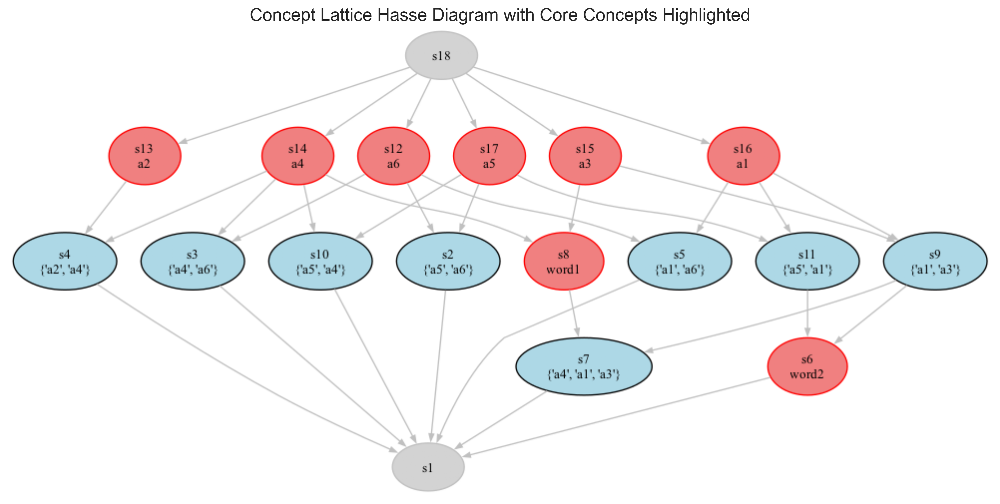

Total number of concepts in the lattice (excluding exclude_concepts): 16
Number of attribute concepts: 6
Desired percentage of additional concepts: 20.0%
Number of additional concepts to select: 2
Total number of concepts in C_M: 8

Iteration 1, Temperature: 1425.0000, Best Fitness: 1.1917
Iteration 2, Temperature: 1353.7500, Best Fitness: 1.1917
Iteration 3, Temperature: 1286.0625, Best Fitness: 1.1917
Iteration 4, Temperature: 1221.7594, Best Fitness: 1.1917
Iteration 5, Temperature: 1160.6714, Best Fitness: 1.1917
Iteration 6, Temperature: 1102.6378, Best Fitness: 1.1917
Iteration 7, Temperature: 1047.5059, Best Fitness: 1.1917
Iteration 8, Temperature: 995.1306, Best Fitness: 1.1917
Iteration 9, Temperature: 945.3741, Best Fitness: 1.1917
Iteration 10, Temperature: 898.1054, Best Fitness: 1.1917
Iteration 11, Temperature: 853.2001, Best Fitness: 1.1917
Iteration 12, Temperature: 810.5401, Best Fitness: 1.1917
Iteration 13, Temperature: 770.0131, Best Fitness: 1.1917
Iteration 14, T

Iteration 140, Temperature: 1.1413, Best Fitness: 1.1917
Iteration 141, Temperature: 1.0842, Best Fitness: 1.1917
Iteration 142, Temperature: 1.0300, Best Fitness: 1.1917
Iteration 143, Temperature: 0.9785, Best Fitness: 1.1917

Optimal c_M_total found: 1.1917


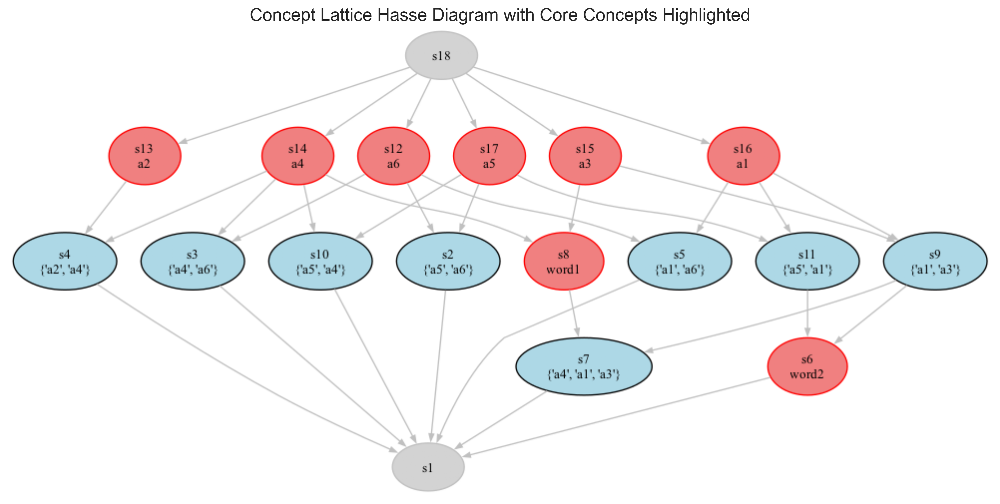


Processing Lattice 2
----------------------------------------

Weighted Frequency Distribution P(s):
--------------------------------------
  s2: 0.0389
  s3: 0.0212
  s4: 0.0096
  s5: 0.0198
  s6: 0.0332
  s7: 0.0133
  s8: 0.0125
  s9: 0.0389
  s10: 0.0336
  s11: 0.0386
  s12: 0.0250
  s13: 0.0121
  s14: 0.0357
  s15: 0.0280
  s16: 0.0243
  s17: 0.0276
  s18: 0.0686
  s19: 0.1048
  s20: 0.1034
  s21: 0.1177
  s22: 0.0796
  s23: 0.1137


Total number of concepts in the lattice (excluding exclude_concepts): 22
Number of attribute concepts: 6
Desired percentage of additional concepts: 20.0%
Number of additional concepts to select: 3
Total number of concepts in C_M: 9

Generation 1/100, Best Fitness: 1.3513
Generation 10/100, Best Fitness: 1.3320
Generation 20/100, Best Fitness: 1.3320
Generation 30/100, Best Fitness: 1.3320
Generation 40/100, Best Fitness: 1.3320
Generation 50/100, Best Fitness: 1.3320
Generation 60/100, Best Fitness: 1.3320
Generation 70/100, Best Fitness: 1.3320
Gener

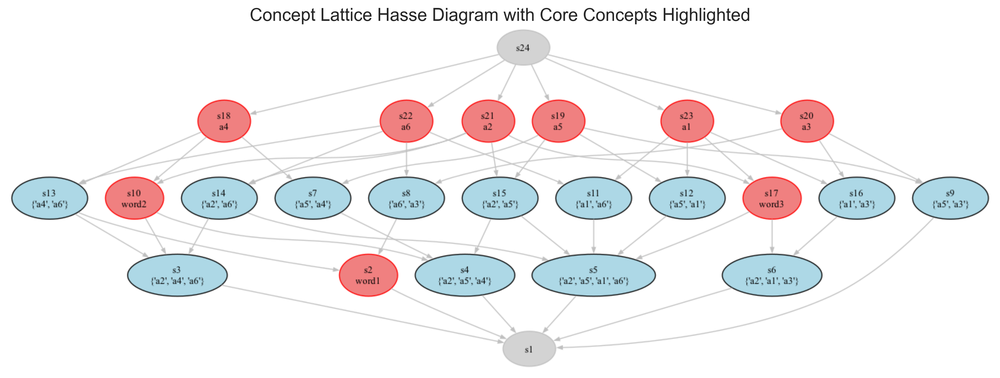

Total number of concepts in the lattice (excluding exclude_concepts): 22
Number of attribute concepts: 6
Desired percentage of additional concepts: 20.0%
Number of additional concepts to select: 3
Total number of concepts in C_M: 9

Iteration 1, Temperature: 1425.0000, Best Fitness: 1.3461
Iteration 2, Temperature: 1353.7500, Best Fitness: 1.3461
Iteration 3, Temperature: 1286.0625, Best Fitness: 1.3320
Iteration 4, Temperature: 1221.7594, Best Fitness: 1.3320
Iteration 5, Temperature: 1160.6714, Best Fitness: 1.3320
Iteration 6, Temperature: 1102.6378, Best Fitness: 1.3320
Iteration 7, Temperature: 1047.5059, Best Fitness: 1.3320
Iteration 8, Temperature: 995.1306, Best Fitness: 1.3320
Iteration 9, Temperature: 945.3741, Best Fitness: 1.3320
Iteration 10, Temperature: 898.1054, Best Fitness: 1.3320
Iteration 11, Temperature: 853.2001, Best Fitness: 1.3320
Iteration 12, Temperature: 810.5401, Best Fitness: 1.3320
Iteration 13, Temperature: 770.0131, Best Fitness: 1.3320
Iteration 14, T

Iteration 143, Temperature: 0.9785, Best Fitness: 1.3320

Optimal c_M_total found: 1.3320


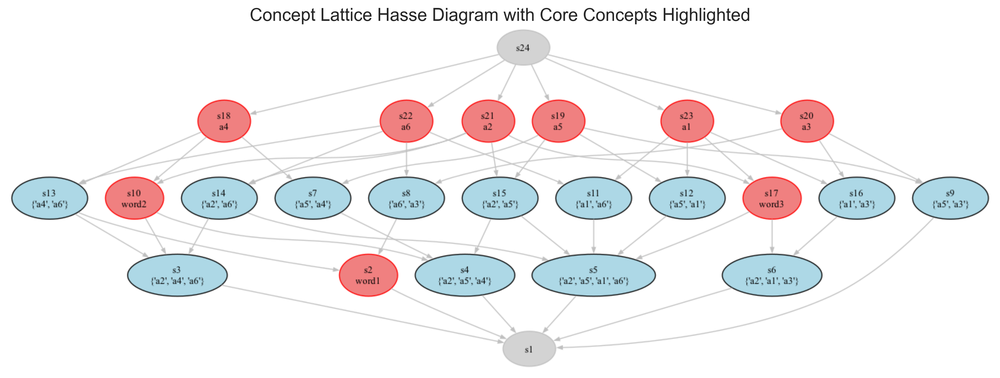


Processing Lattice 3
----------------------------------------

Weighted Frequency Distribution P(s):
--------------------------------------
  s2: 0.0134
  s3: 0.0257
  s4: 0.0228
  s5: 0.0335
  s6: 0.0113
  s7: 0.0263
  s8: 0.0207
  s9: 0.0192
  s10: 0.0303
  s11: 0.0288
  s12: 0.0250
  s13: 0.0253
  s14: 0.0062
  s15: 0.0278
  s16: 0.0155
  s17: 0.0219
  s18: 0.0253
  s19: 0.0183
  s20: 0.0252
  s21: 0.0174
  s22: 0.0187
  s23: 0.0323
  s24: 0.0560
  s25: 0.1046
  s26: 0.0911
  s27: 0.0907
  s28: 0.0593
  s29: 0.0562
  s30: 0.0510


Total number of concepts in the lattice (excluding exclude_concepts): 29
Number of attribute concepts: 7
Desired percentage of additional concepts: 20.0%
Number of additional concepts to select: 4
Total number of concepts in C_M: 11

Generation 1/100, Best Fitness: 1.4021
Generation 10/100, Best Fitness: 1.3824
Generation 20/100, Best Fitness: 1.3800
Generation 30/100, Best Fitness: 1.3800
Generation 40/100, Best Fitness: 1.3800
Generation 50/100, Best Fi

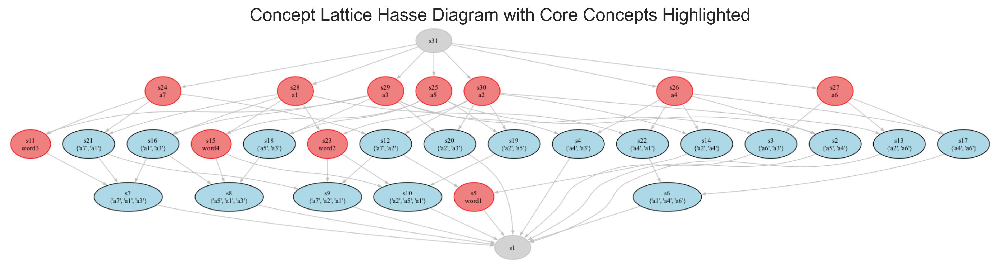

Total number of concepts in the lattice (excluding exclude_concepts): 29
Number of attribute concepts: 7
Desired percentage of additional concepts: 20.0%
Number of additional concepts to select: 4
Total number of concepts in C_M: 11

Iteration 1, Temperature: 1425.0000, Best Fitness: 1.3908
Iteration 2, Temperature: 1353.7500, Best Fitness: 1.3908
Iteration 3, Temperature: 1286.0625, Best Fitness: 1.3908
Iteration 4, Temperature: 1221.7594, Best Fitness: 1.3908
Iteration 5, Temperature: 1160.6714, Best Fitness: 1.3908
Iteration 6, Temperature: 1102.6378, Best Fitness: 1.3908
Iteration 7, Temperature: 1047.5059, Best Fitness: 1.3908
Iteration 8, Temperature: 995.1306, Best Fitness: 1.3908
Iteration 9, Temperature: 945.3741, Best Fitness: 1.3908
Iteration 10, Temperature: 898.1054, Best Fitness: 1.3908
Iteration 11, Temperature: 853.2001, Best Fitness: 1.3908
Iteration 12, Temperature: 810.5401, Best Fitness: 1.3905
Iteration 13, Temperature: 770.0131, Best Fitness: 1.3905
Iteration 14, 

Iteration 140, Temperature: 1.1413, Best Fitness: 1.3800
Iteration 141, Temperature: 1.0842, Best Fitness: 1.3800
Iteration 142, Temperature: 1.0300, Best Fitness: 1.3800
Iteration 143, Temperature: 0.9785, Best Fitness: 1.3800

Optimal c_M_total found: 1.3800


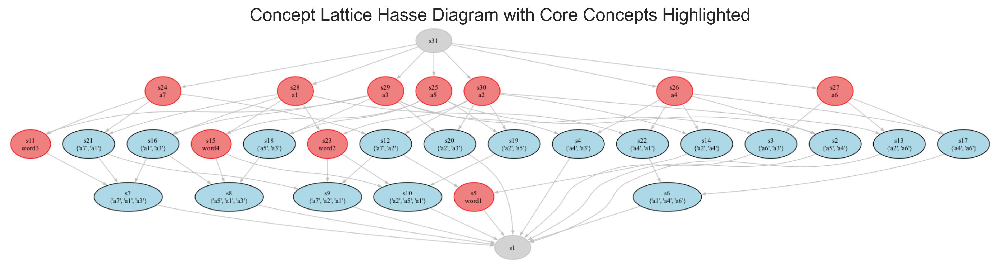


Processing Lattice 4
----------------------------------------

Weighted Frequency Distribution P(s):
--------------------------------------
  s2: 0.0053
  s3: 0.0092
  s4: 0.0213
  s5: 0.0192
  s6: 0.0240
  s7: 0.0151
  s8: 0.0194
  s9: 0.0115
  s10: 0.0228
  s11: 0.0065
  s12: 0.0105
  s13: 0.0079
  s14: 0.0110
  s15: 0.0094
  s16: 0.0270
  s17: 0.0088
  s18: 0.0123
  s19: 0.0120
  s20: 0.0165
  s21: 0.0129
  s22: 0.0255
  s23: 0.0120
  s24: 0.0147
  s25: 0.0182
  s26: 0.0096
  s27: 0.0157
  s28: 0.0084
  s29: 0.0271
  s30: 0.0047
  s31: 0.0128
  s32: 0.0056
  s33: 0.0906
  s34: 0.0582
  s35: 0.0784
  s36: 0.0572
  s37: 0.0832
  s38: 0.0702
  s39: 0.0512
  s40: 0.0738


Total number of concepts in the lattice (excluding exclude_concepts): 39
Number of attribute concepts: 8
Desired percentage of additional concepts: 20.0%
Number of additional concepts to select: 6
Total number of concepts in C_M: 14

Generation 1/100, Best Fitness: 1.4089
Generation 10/100, Best Fitness: 1.3671
Genera

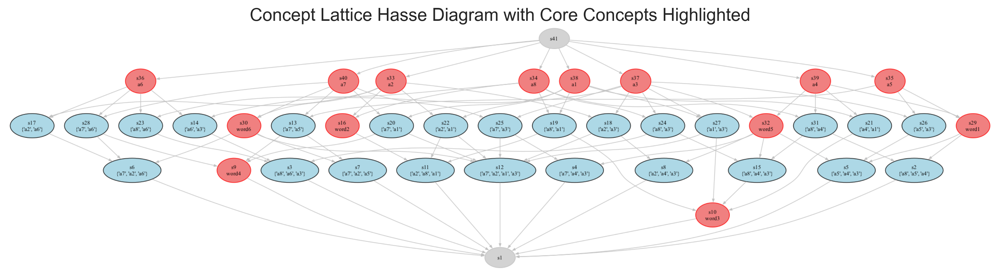

Total number of concepts in the lattice (excluding exclude_concepts): 39
Number of attribute concepts: 8
Desired percentage of additional concepts: 20.0%
Number of additional concepts to select: 6
Total number of concepts in C_M: 14

Iteration 1, Temperature: 1425.0000, Best Fitness: 1.4021
Iteration 2, Temperature: 1353.7500, Best Fitness: 1.3878
Iteration 3, Temperature: 1286.0625, Best Fitness: 1.3810
Iteration 4, Temperature: 1221.7594, Best Fitness: 1.3810
Iteration 5, Temperature: 1160.6714, Best Fitness: 1.3810
Iteration 6, Temperature: 1102.6378, Best Fitness: 1.3755
Iteration 7, Temperature: 1047.5059, Best Fitness: 1.3726
Iteration 8, Temperature: 995.1306, Best Fitness: 1.3726
Iteration 9, Temperature: 945.3741, Best Fitness: 1.3726
Iteration 10, Temperature: 898.1054, Best Fitness: 1.3649
Iteration 11, Temperature: 853.2001, Best Fitness: 1.3649
Iteration 12, Temperature: 810.5401, Best Fitness: 1.3649
Iteration 13, Temperature: 770.0131, Best Fitness: 1.3649
Iteration 14, 

Iteration 141, Temperature: 1.0842, Best Fitness: 1.3576
Iteration 142, Temperature: 1.0300, Best Fitness: 1.3576
Iteration 143, Temperature: 0.9785, Best Fitness: 1.3576

Optimal c_M_total found: 1.3576


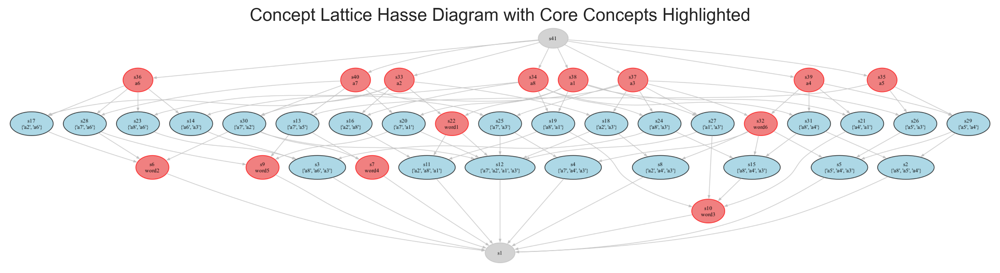


Experimental Results Summary:
  Lattice  Total Concepts  Core Concepts GA  Core Concepts SA  c_T Before Reduction  c_T After Reduction GA  c_T After Reduction SA  GA Time (s)  SA Time (s)  GA Reduction (%)  SA Reduction (%)  Stored Concepts Reduction GA (%)  Stored Concepts Reduction SA (%)
Lattice 1              18                 8                 8              1.376811                1.191687                1.191687     0.457573     2.502937         13.445822         13.445822                         55.555556                         55.555556
Lattice 2              24                 9                 9              1.554759                1.331978                1.331978     0.867839     4.629663         14.328968         14.328968                         62.500000                         62.500000
Lattice 3              31                11                11              1.632393                1.379970                1.379970     1.233180     7.190634         15.463403        

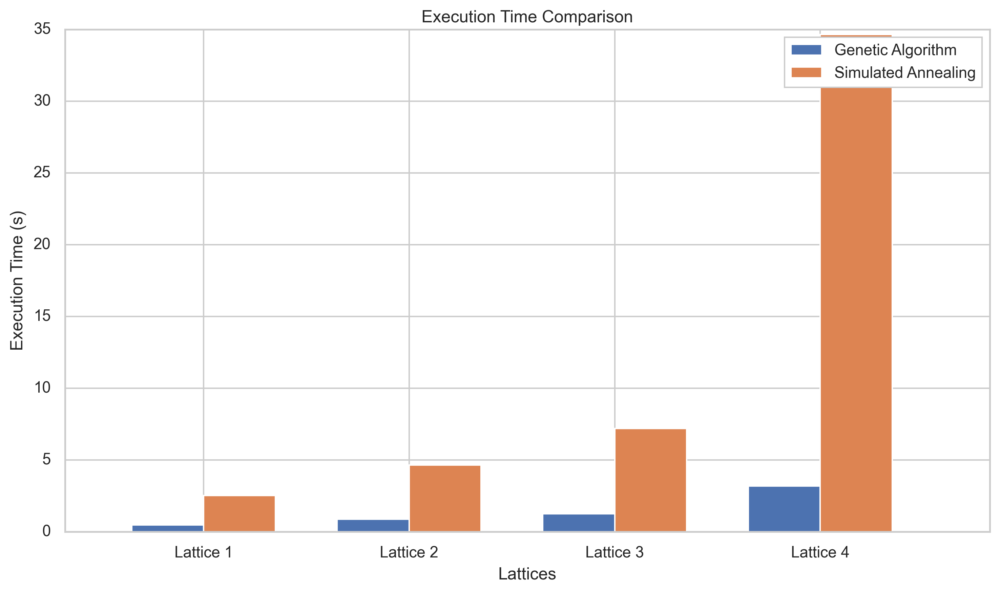

In [83]:
# Required Libraries
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import random
import time
import logging
import os

# Suppress warnings for clarity
import warnings
warnings.filterwarnings('ignore')

# Ensure the code uses a consistent random seed
random.seed(42)
np.random.seed(42)

# ----------------------------
# Function Definitions (Assuming GA and SA implementations are provided)
# ----------------------------

# The GA and SA implementations provided are assumed to be available in the same script or imported as modules.

# We'll use the functions you provided earlier:
# - assign_ids
# - build_hasse_diagram
# - find_attribute_concepts
# - generate_weighted_frequencies
# - assign_words_to_core_concepts
# - calculate_costs
# - generate_word_sequences
# - genetic_algorithm
# - simulated_annealing
# - visualize_hasse_diagram

# ----------------------------
# Main Execution
# ----------------------------

if __name__ == "__main__":
    # List of lattices to be processed
    lattices = [lattice1, lattice2, lattice3, lattice4]
    lattice_names = ['Lattice 1', 'Lattice 2', 'Lattice 3', 'Lattice 4']

    # Results storage
    results = []
    ga_times = []
    sa_times = []

    for lattice, lattice_name in zip(lattices, lattice_names):
        print(f"\nProcessing {lattice_name}")
        print("-" * 40)

        # Assign unique IDs to each concept
        assigned_concepts = assign_ids(lattice)

        # Create mappings for easy reference
        intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}
        id_to_intent = {cid: intent for cid, _, intent in assigned_concepts}

        # Build directed Hasse diagram
        DG = build_hasse_diagram(assigned_concepts)  # Directed Hasse diagram

        # Build set of all objects and all attributes
        all_objects = set()
        all_attributes = set()
        for extent, intent in lattice:
            all_objects.update(extent)
            all_attributes.update(intent)

        # Convert to frozensets for comparison
        all_objects = frozenset(all_objects)
        all_attributes = frozenset(all_attributes)

        # Identify the universal (top) and empty (bottom) concepts
        universal_concept_id = None
        empty_concept_id = None
        for cid, extent, intent in assigned_concepts:
            if extent == all_objects and len(intent) == 0:
                universal_concept_id = cid
            if len(extent) == 0 and intent == all_attributes:
                empty_concept_id = cid

        exclude_concepts = {universal_concept_id, empty_concept_id}
        exclude_concepts.discard(None)  # Remove None values if any

        # Find attribute concepts and define Core Concepts C_M
        attribute_to_cid = find_attribute_concepts(assigned_concepts, all_attributes, exclude_concepts)
        C_M = set(attribute_to_cid.values())

        # Generate weighted frequencies
        P_s = generate_weighted_frequencies(assigned_concepts, C_M, exclude_concepts)

        # Determine population size based on lattice size
        def determine_population_size(total_concepts: int, scaling_factor: float = 0.1) -> int:
            """
            Determines population size based on total number of concepts.
            """
            return max(50, int(total_concepts * scaling_factor))

        total_concept_ids = [cid for cid, _, _ in assigned_concepts]
        lattice_size = len(total_concept_ids) - len(exclude_concepts)
        pop_size = determine_population_size(lattice_size, scaling_factor=0.1)

        # Initialize cost parameters
        alpha_p = 1
        alpha_c = 2  # As per experimental settings

        # Run Genetic Algorithm to find optimal C_M
        start_time_ga = time.time()
        optimal_C_M_ga = genetic_algorithm(
            assigned_concepts=assigned_concepts,
            DG=DG,
            exclude_concepts=exclude_concepts,
            id_to_intent=id_to_intent,
            P_s=P_s,
            attribute_to_cid=attribute_to_cid,
            total_concepts=total_concept_ids,
            pop_size=pop_size,
            num_generations=100,
            mutation_rate=0.1,
            alpha_p=alpha_p,
            alpha_c=alpha_c,
            desired_percentage=0.20,  # Adjust as needed
            seed_value=42,
            elitism_rate=0.05  # 5% elitism
        )
        end_time_ga = time.time()
        ga_time = end_time_ga - start_time_ga
        ga_times.append(ga_time)

        # Calculate total expected generation cost for GA
        C_M_ga = optimal_C_M_ga
        c_ga, min_cost_paths_ga = calculate_costs(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M_ga,
            id_to_intent=id_to_intent,
            alpha_p=alpha_p,
            alpha_c=alpha_c,
            exclude_concepts=exclude_concepts,
            verbose=False
        )
        c_T_ga = sum(P_s.get(cid, 0) * c_ga.get(cid, 0) for cid in c_ga)

        # Assign words to core concepts
        C_M_word_map_ga = assign_words_to_core_concepts(C_M_ga, assigned_concepts, attribute_to_cid, P_s)

        # Generate word sequences
        word_sequences_ga = generate_word_sequences(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M_ga,
            C_M_word_map=C_M_word_map_ga,
            c=c_ga,
            min_cost_paths=min_cost_paths_ga,
            exclude_concepts=exclude_concepts,
            attribute_to_cid=attribute_to_cid
        )

        # Visualize the Hasse Diagram for GA
        visualize_hasse_diagram(
            DG=DG,
            id_to_intent=id_to_intent,
            C_M_word_map=C_M_word_map_ga,
            C_M=C_M_ga,
            exclude_concepts=exclude_concepts,
            output_filename=f'{lattice_name}_Hasse_GA.png',
            dpi=300
        )

        # Run Simulated Annealing to find optimal C_M
        start_time_sa = time.time()
        optimal_C_M_sa = simulated_annealing(
            assigned_concepts=assigned_concepts,
            DG=DG,
            exclude_concepts=exclude_concepts,
            id_to_intent=id_to_intent,
            P_s=P_s,
            attribute_to_cid=attribute_to_cid,
            total_concepts=total_concept_ids,
            initial_temp=1500.0,
            final_temp=1.0,
            alpha=0.95,
            num_iterations=200,
            desired_percentage=0.20,  # Adjust as needed
            seed_value=42
        )
        end_time_sa = time.time()
        sa_time = end_time_sa - start_time_sa
        sa_times.append(sa_time)

        # Calculate total expected generation cost for SA
        C_M_sa = optimal_C_M_sa
        c_sa, min_cost_paths_sa = calculate_costs(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M_sa,
            id_to_intent=id_to_intent,
            alpha_p=alpha_p,
            alpha_c=alpha_c,
            exclude_concepts=exclude_concepts,
            verbose=False
        )
        c_T_sa = sum(P_s.get(cid, 0) * c_sa.get(cid, 0) for cid in c_sa)

        # Assign words to core concepts
        C_M_word_map_sa = assign_words_to_core_concepts(C_M_sa, assigned_concepts, attribute_to_cid, P_s)

        # Generate word sequences
        word_sequences_sa = generate_word_sequences(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M_sa,
            C_M_word_map=C_M_word_map_sa,
            c=c_sa,
            min_cost_paths=min_cost_paths_sa,
            exclude_concepts=exclude_concepts,
            attribute_to_cid=attribute_to_cid
        )

        # Visualize the Hasse Diagram for SA
        visualize_hasse_diagram(
            DG=DG,
            id_to_intent=id_to_intent,
            C_M_word_map=C_M_word_map_sa,
            C_M=C_M_sa,
            exclude_concepts=exclude_concepts,
            output_filename=f'{lattice_name}_Hasse_SA.png',
            dpi=300
        )

        # Total expected generation cost before reduction
        c_full, _ = calculate_costs(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M,  # Only attribute concepts in C_M
            id_to_intent=id_to_intent,
            alpha_p=alpha_p,
            alpha_c=alpha_c,
            exclude_concepts=exclude_concepts,
            verbose=False
        )
        c_T_full = sum(P_s.get(cid, 0) * c_full.get(cid, 0) for cid in c_full)

        # Record the results
        results.append({
            'Lattice': lattice_name,
            'Total Concepts': len(total_concept_ids),
            'Core Concepts GA': len(C_M_ga),
            'Core Concepts SA': len(C_M_sa),
            'c_T Before Reduction': c_T_full,
            'c_T After Reduction GA': c_T_ga,
            'c_T After Reduction SA': c_T_sa,
            'GA Time (s)': ga_time,
            'SA Time (s)': sa_time,
            'GA Reduction (%)': ((c_T_full - c_T_ga) / c_T_full) * 100,
            'SA Reduction (%)': ((c_T_full - c_T_sa) / c_T_full) * 100,
            'Stored Concepts Reduction GA (%)': ((len(total_concept_ids) - len(C_M_ga)) / len(total_concept_ids)) * 100,
            'Stored Concepts Reduction SA (%)': ((len(total_concept_ids) - len(C_M_sa)) / len(total_concept_ids)) * 100,
        })

        # Plot c_T vs. D for different memory sizes (Optional)
        # You can implement a loop over different D values to plot c_T vs. D

    # Display the results
    import pandas as pd
    df_results = pd.DataFrame(results)
    print("\nExperimental Results Summary:")
    print(df_results.to_string(index=False))

    # Plot Execution Times Comparison
    plt.figure(figsize=(10, 6))
    indices = np.arange(len(lattice_names))
    width = 0.35
    plt.bar(indices, ga_times, width, label='Genetic Algorithm')
    plt.bar(indices + width, sa_times, width, label='Simulated Annealing')
    plt.xlabel('Lattices')
    plt.ylabel('Execution Time (s)')
    plt.title('Execution Time Comparison')
    plt.xticks(indices + width / 2, lattice_names)
    plt.legend()
    plt.tight_layout()
    plt.show()


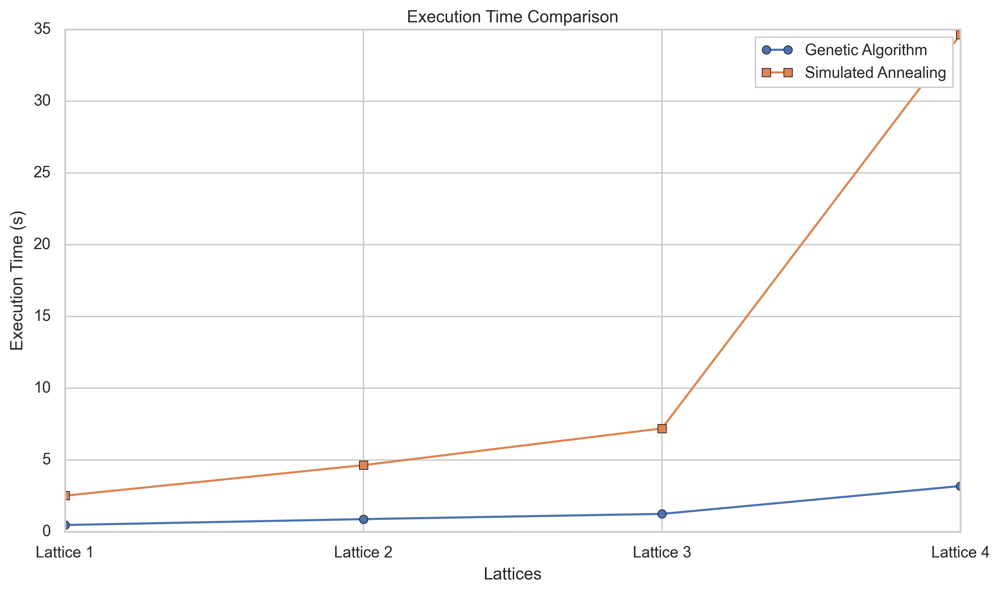

In [84]:
# Plot Execution Times Comparison as a Line Chart
plt.figure(figsize=(10, 6))

# Plotting the lines
plt.plot(lattice_names, ga_times, marker='o', label='Genetic Algorithm')
plt.plot(lattice_names, sa_times, marker='s', label='Simulated Annealing')

# Labels and title
plt.xlabel('Lattices')
plt.ylabel('Execution Time (s)')
plt.title('Execution Time Comparison')

# Adding legend and grid
plt.legend()
plt.grid(True)

# Tight layout for better spacing
plt.tight_layout()
plt.show()



Weighted Frequency Distribution P(s):
--------------------------------------
  s1: 0.1413
  s2: 0.0748
  s3: 0.1019
  s4: 0.0963
  s5: 0.1518
  s6: 0.1453
  s7: 0.1686
  s8: 0.0815
  s9: 0.0280
  s10: 0.0104



Processing Lattice 3 with Core Concepts Size: 20%
--------------------------------------------------
Total number of concepts in the lattice (excluding exclude_concepts): 10
Number of attribute concepts: 8
Desired percentage of additional concepts: 20.0%
Number of additional concepts to select: 0
Total number of concepts in C_M: 8

Generation 1/100, Best Fitness: 1.0384
Generation 10/100, Best Fitness: 1.0384
Generation 20/100, Best Fitness: 1.0384
Generation 30/100, Best Fitness: 1.0384
Generation 40/100, Best Fitness: 1.0384
Generation 50/100, Best Fitness: 1.0384
Generation 60/100, Best Fitness: 1.0384
Generation 70/100, Best Fitness: 1.0384
Generation 80/100, Best Fitness: 1.0384
Generation 90/100, Best Fitness: 1.0384
Generation 100/100, Best Fitness: 1.0384

Optimal c_M_t

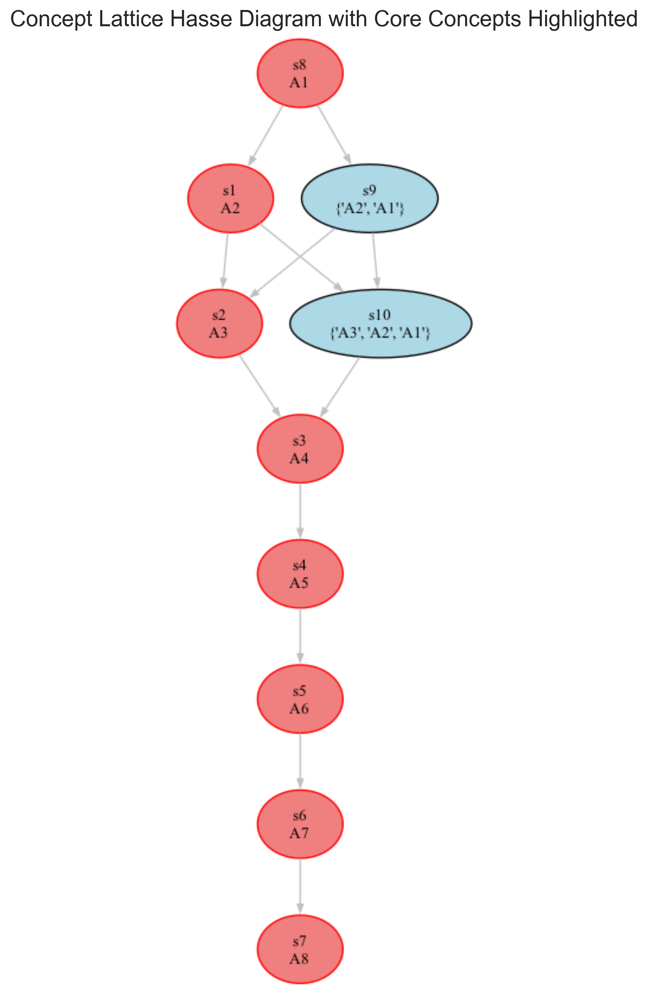

Total number of concepts in the lattice (excluding exclude_concepts): 10
Number of attribute concepts: 8
Desired percentage of additional concepts: 20.0%
Number of additional concepts to select: 0
Total number of concepts in C_M: 8

Iteration 1, Temperature: 1425.0000, Best Fitness: 1.0384
Iteration 2, Temperature: 1353.7500, Best Fitness: 1.0384
Iteration 3, Temperature: 1286.0625, Best Fitness: 1.0384
Iteration 4, Temperature: 1221.7594, Best Fitness: 1.0384
Iteration 5, Temperature: 1160.6714, Best Fitness: 1.0384
Iteration 6, Temperature: 1102.6378, Best Fitness: 1.0384
Iteration 7, Temperature: 1047.5059, Best Fitness: 1.0384
Iteration 8, Temperature: 995.1306, Best Fitness: 1.0384
Iteration 9, Temperature: 945.3741, Best Fitness: 1.0384
Iteration 10, Temperature: 898.1054, Best Fitness: 1.0384
Iteration 11, Temperature: 853.2001, Best Fitness: 1.0384
Iteration 12, Temperature: 810.5401, Best Fitness: 1.0384
Iteration 13, Temperature: 770.0131, Best Fitness: 1.0384
Iteration 14, T

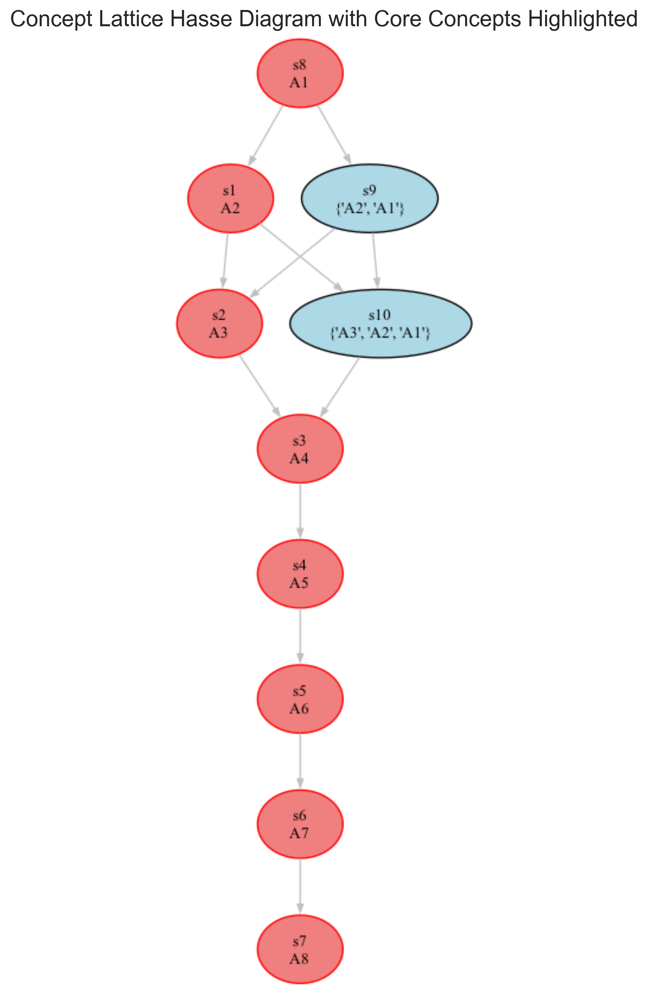


Processing Lattice 3 with Core Concepts Size: 25%
--------------------------------------------------
Total number of concepts in the lattice (excluding exclude_concepts): 10
Number of attribute concepts: 8
Desired percentage of additional concepts: 25.0%
Number of additional concepts to select: 0
Total number of concepts in C_M: 8

Generation 1/100, Best Fitness: 1.0384
Generation 10/100, Best Fitness: 1.0384
Generation 20/100, Best Fitness: 1.0384
Generation 30/100, Best Fitness: 1.0384
Generation 40/100, Best Fitness: 1.0384
Generation 50/100, Best Fitness: 1.0384
Generation 60/100, Best Fitness: 1.0384
Generation 70/100, Best Fitness: 1.0384
Generation 80/100, Best Fitness: 1.0384
Generation 90/100, Best Fitness: 1.0384
Generation 100/100, Best Fitness: 1.0384

Optimal c_M_total found: 1.0384


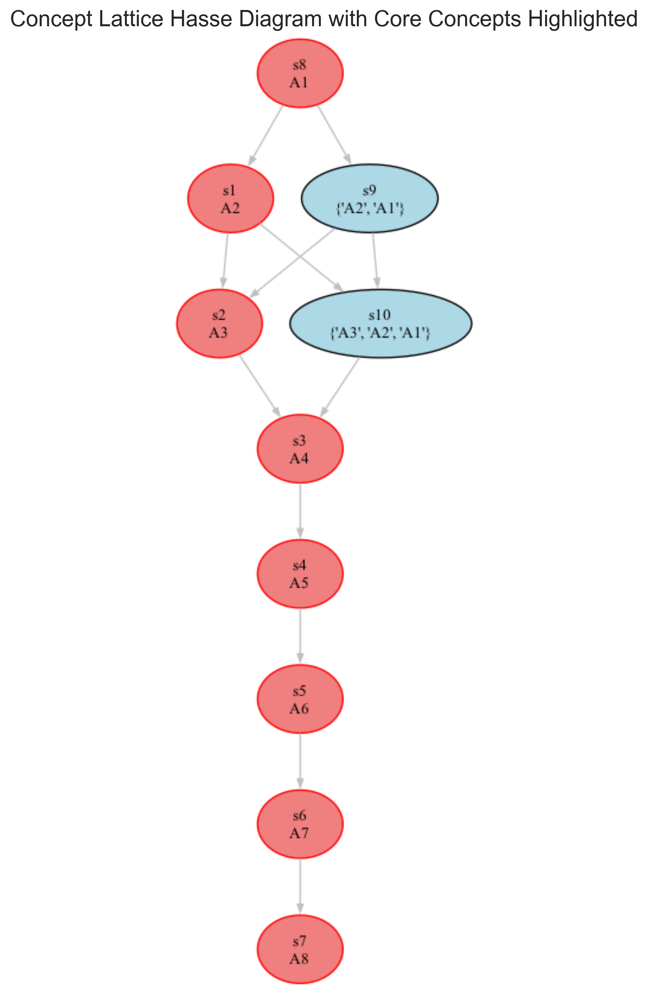

Total number of concepts in the lattice (excluding exclude_concepts): 10
Number of attribute concepts: 8
Desired percentage of additional concepts: 25.0%
Number of additional concepts to select: 0
Total number of concepts in C_M: 8

Iteration 1, Temperature: 1425.0000, Best Fitness: 1.0384
Iteration 2, Temperature: 1353.7500, Best Fitness: 1.0384
Iteration 3, Temperature: 1286.0625, Best Fitness: 1.0384
Iteration 4, Temperature: 1221.7594, Best Fitness: 1.0384
Iteration 5, Temperature: 1160.6714, Best Fitness: 1.0384
Iteration 6, Temperature: 1102.6378, Best Fitness: 1.0384
Iteration 7, Temperature: 1047.5059, Best Fitness: 1.0384
Iteration 8, Temperature: 995.1306, Best Fitness: 1.0384
Iteration 9, Temperature: 945.3741, Best Fitness: 1.0384
Iteration 10, Temperature: 898.1054, Best Fitness: 1.0384
Iteration 11, Temperature: 853.2001, Best Fitness: 1.0384
Iteration 12, Temperature: 810.5401, Best Fitness: 1.0384
Iteration 13, Temperature: 770.0131, Best Fitness: 1.0384
Iteration 14, T

Iteration 142, Temperature: 1.0300, Best Fitness: 1.0384
Iteration 143, Temperature: 0.9785, Best Fitness: 1.0384

Optimal c_M_total found: 1.0384


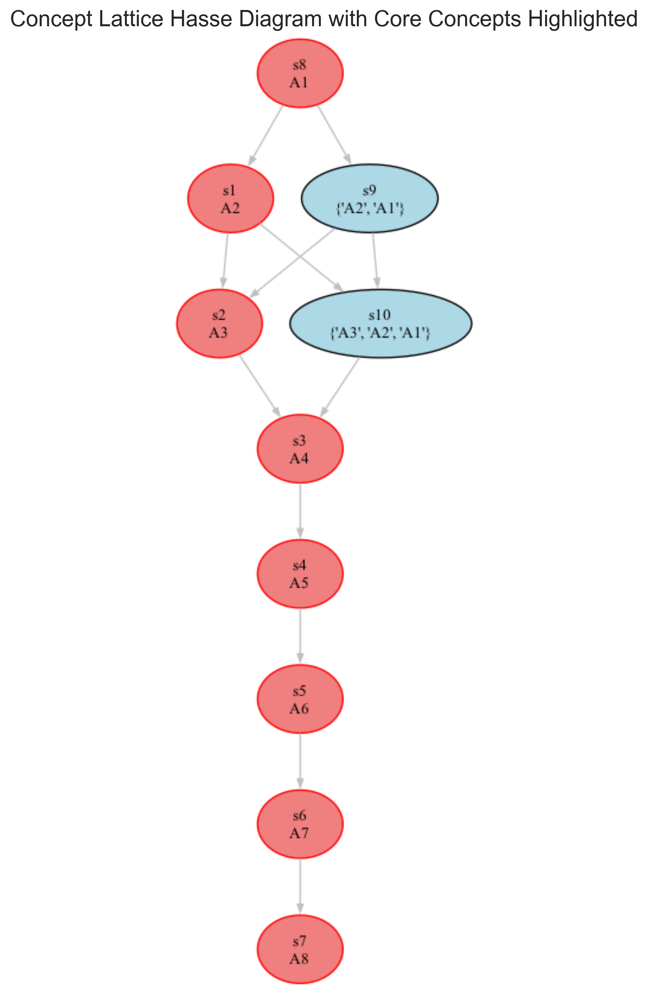


Processing Lattice 3 with Core Concepts Size: 30%
--------------------------------------------------
Total number of concepts in the lattice (excluding exclude_concepts): 10
Number of attribute concepts: 8
Desired percentage of additional concepts: 30.0%
Number of additional concepts to select: 1
Total number of concepts in C_M: 9

Generation 1/100, Best Fitness: 1.0104
Generation 10/100, Best Fitness: 1.0104
Generation 20/100, Best Fitness: 1.0104
Generation 30/100, Best Fitness: 1.0104
Generation 40/100, Best Fitness: 1.0104
Generation 50/100, Best Fitness: 1.0104
Generation 60/100, Best Fitness: 1.0104
Generation 70/100, Best Fitness: 1.0104
Generation 80/100, Best Fitness: 1.0104
Generation 90/100, Best Fitness: 1.0104
Generation 100/100, Best Fitness: 1.0104

Optimal c_M_total found: 1.0104


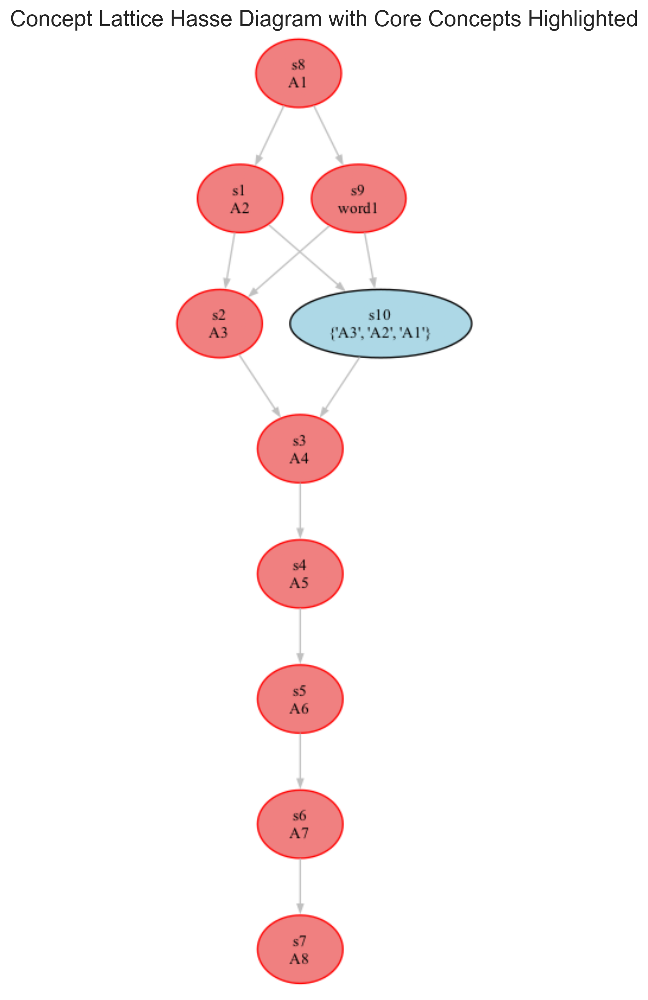

Total number of concepts in the lattice (excluding exclude_concepts): 10
Number of attribute concepts: 8
Desired percentage of additional concepts: 30.0%
Number of additional concepts to select: 1
Total number of concepts in C_M: 9

Iteration 1, Temperature: 1425.0000, Best Fitness: 1.0104
Iteration 2, Temperature: 1353.7500, Best Fitness: 1.0104
Iteration 3, Temperature: 1286.0625, Best Fitness: 1.0104
Iteration 4, Temperature: 1221.7594, Best Fitness: 1.0104
Iteration 5, Temperature: 1160.6714, Best Fitness: 1.0104
Iteration 6, Temperature: 1102.6378, Best Fitness: 1.0104
Iteration 7, Temperature: 1047.5059, Best Fitness: 1.0104
Iteration 8, Temperature: 995.1306, Best Fitness: 1.0104
Iteration 9, Temperature: 945.3741, Best Fitness: 1.0104
Iteration 10, Temperature: 898.1054, Best Fitness: 1.0104
Iteration 11, Temperature: 853.2001, Best Fitness: 1.0104
Iteration 12, Temperature: 810.5401, Best Fitness: 1.0104
Iteration 13, Temperature: 770.0131, Best Fitness: 1.0104
Iteration 14, T

Iteration 142, Temperature: 1.0300, Best Fitness: 1.0104
Iteration 143, Temperature: 0.9785, Best Fitness: 1.0104

Optimal c_M_total found: 1.0104


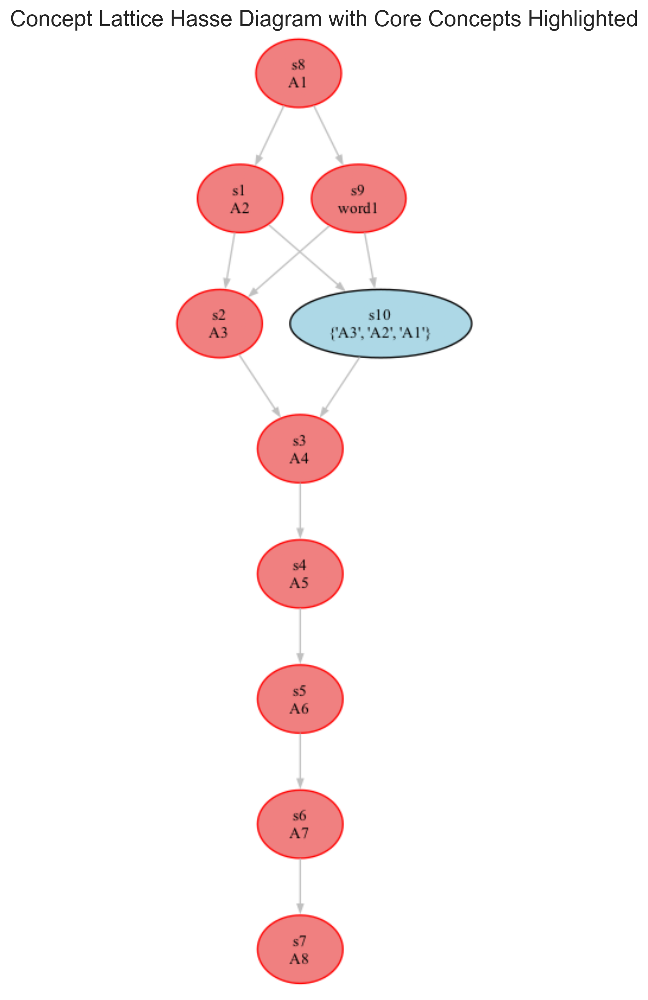

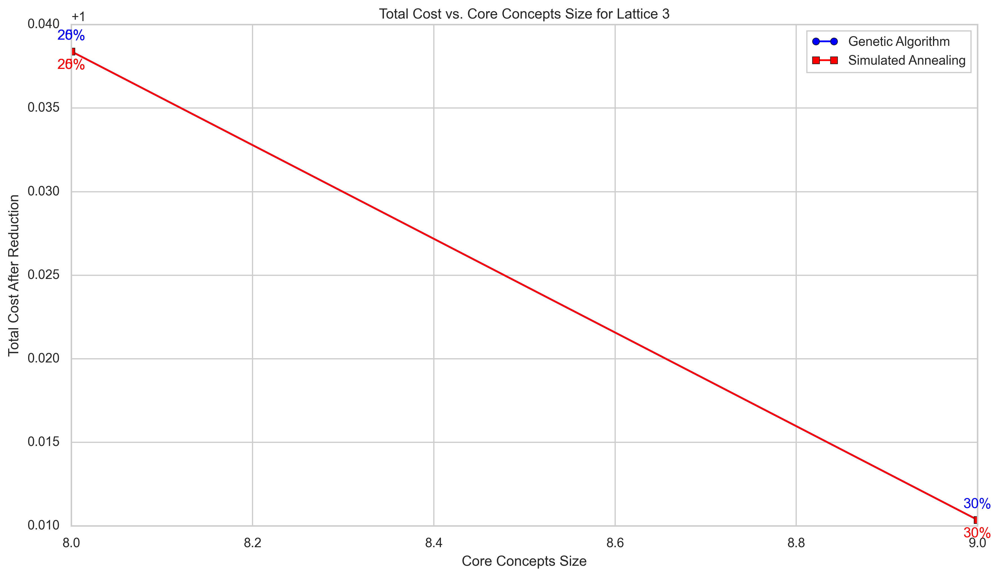

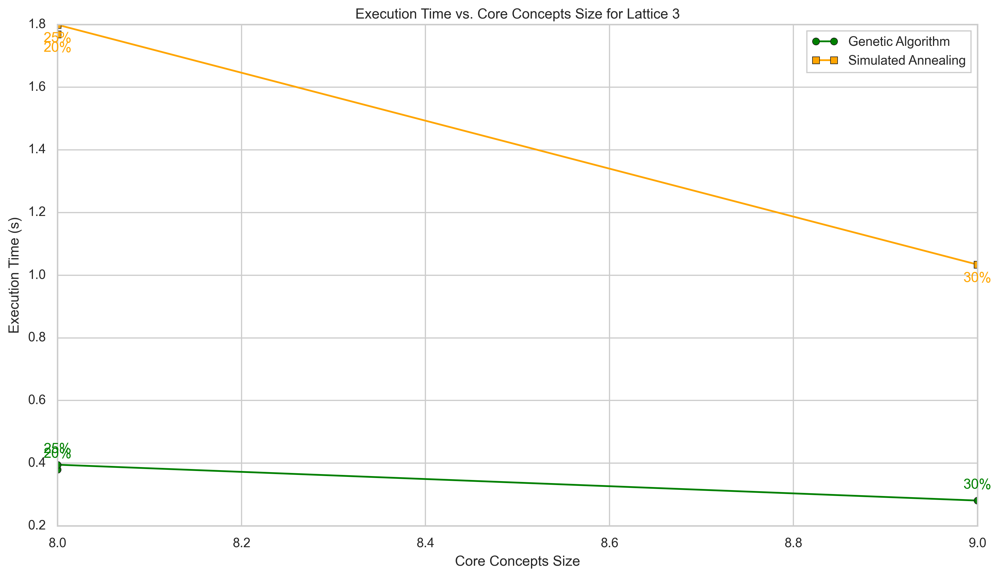


Results Summary for Lattice 3:
 Desired Core Concepts (%)  GA Core Concepts Size  SA Core Concepts Size  Total Cost Before Reduction  GA Total Cost After Reduction  SA Total Cost After Reduction  GA Reduction (%)  SA Reduction (%)  GA Stored Concepts Reduction (%)  SA Stored Concepts Reduction (%)  GA Execution Time (s)  SA Execution Time (s)
                        20                      8                      8                     1.038394                       1.038394                       1.038394          0.000000          0.000000                              20.0                              20.0               0.379437               1.769310
                        25                      8                      8                     1.038394                       1.038394                       1.038394          0.000000          0.000000                              20.0                              20.0               0.395120               1.799316
                        30

In [87]:
# Required Libraries
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import random
import time
import logging
import os

# Suppress warnings for clarity
import warnings
warnings.filterwarnings('ignore')

# Ensure the code uses a consistent random seed
random.seed(42)
np.random.seed(42)

# ----------------------------
# Function Definitions (Assuming GA and SA implementations are provided)
# ----------------------------

# The GA and SA implementations provided are assumed to be available in the same script or imported as modules.

# We'll use the functions you provided earlier:
# - assign_ids
# - build_hasse_diagram
# - find_attribute_concepts
# - generate_weighted_frequencies
# - assign_words_to_core_concepts
# - calculate_costs
# - generate_word_sequences
# - genetic_algorithm
# - simulated_annealing
# - visualize_hasse_diagram

# ----------------------------
# Main Execution
# ----------------------------

if __name__ == "__main__":
    # ----------------------------
    # 1. Setup: Define Lattice 3 and Desired Percentages
    # ----------------------------
    
    # Example definition of lattice3 (Replace this with your actual lattice3)
    # Each element in lattice3 is a tuple: (extent, intent)
    # For example:
    # lattice3 = [
    #     (frozenset(['object1', 'object2']), frozenset(['attribute1'])),
    #     (frozenset(['object1']), frozenset(['attribute1', 'attribute2'])),
    #     # Add more concepts as needed
    # ]
    
    # TODO: Replace the following with your actual lattice3 data
    
    # Desired core concepts percentages
    desired_percentages = [0.20, 0.25, 0.30]  # 20%, 25%, 30%
    
    # ----------------------------
    # 2. Preprocessing Lattice 3
    # ----------------------------
    
    # Assign unique IDs to each concept
    assigned_concepts = assign_ids(lattice3)
    
    # Create mappings for easy reference
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}
    id_to_intent = {cid: intent for cid, _, intent in assigned_concepts}
    
    # Build directed Hasse diagram
    DG = build_hasse_diagram(assigned_concepts)  # Directed Hasse diagram
    
    # Build set of all objects and all attributes
    all_objects = set()
    all_attributes = set()
    for extent, intent in lattice3:
        all_objects.update(extent)
        all_attributes.update(intent)
    
    # Convert to frozensets for comparison
    all_objects = frozenset(all_objects)
    all_attributes = frozenset(all_attributes)
    
    # Identify the universal (top) and empty (bottom) concepts
    universal_concept_id = None
    empty_concept_id = None
    for cid, extent, intent in assigned_concepts:
        if extent == all_objects and len(intent) == 0:
            universal_concept_id = cid
        if len(extent) == 0 and intent == all_attributes:
            empty_concept_id = cid
    
    exclude_concepts = {universal_concept_id, empty_concept_id}
    exclude_concepts.discard(None)  # Remove None values if any
    
    # Find attribute concepts and define Core Concepts C_M
    attribute_to_cid = find_attribute_concepts(assigned_concepts, all_attributes, exclude_concepts)
    # Initially, C_M contains all attribute concepts
    # We will modify C_M based on desired core concepts size
    
    # Generate weighted frequencies
    P_s = generate_weighted_frequencies(assigned_concepts, attribute_to_cid.values(), exclude_concepts)
    
    # Total concepts (excluding universal and empty)
    total_concept_ids = [cid for cid, _, _ in assigned_concepts if cid not in exclude_concepts]
    lattice_size = len(total_concept_ids)
    
    # Initialize cost parameters
    alpha_p = 1
    alpha_c = 2  # As per experimental settings
    
    # ----------------------------
    # 3. Function to Run Algorithms for a Given Percentage
    # ----------------------------
    
    def run_algorithms(desired_percentage, assigned_concepts, DG, exclude_concepts, id_to_intent,
                      P_s, attribute_to_cid, total_concept_ids, alpha_p, alpha_c):
        """
        Runs GA and SA for a given desired_percentage and returns the results.
        """
        results = {}
        
        # Determine population size based on lattice size
        def determine_population_size(total_concepts: int, scaling_factor: float = 0.1) -> int:
            """
            Determines population size based on total number of concepts.
            """
            return max(50, int(total_concepts * scaling_factor))
        
        pop_size = determine_population_size(lattice_size, scaling_factor=0.1)
        
        # Run Genetic Algorithm to find optimal C_M
        start_time_ga = time.time()
        optimal_C_M_ga = genetic_algorithm(
            assigned_concepts=assigned_concepts,
            DG=DG,
            exclude_concepts=exclude_concepts,
            id_to_intent=id_to_intent,
            P_s=P_s,
            attribute_to_cid=attribute_to_cid,
            total_concepts=total_concept_ids,
            pop_size=pop_size,
            num_generations=100,
            mutation_rate=0.1,
            alpha_p=alpha_p,
            alpha_c=alpha_c,
            desired_percentage=desired_percentage,  # Variable percentage
            seed_value=42,
            elitism_rate=0.05  # 5% elitism
        )
        end_time_ga = time.time()
        ga_time = end_time_ga - start_time_ga
        
        # Calculate total expected generation cost for GA
        C_M_ga = optimal_C_M_ga
        c_ga, min_cost_paths_ga = calculate_costs(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M_ga,
            id_to_intent=id_to_intent,
            alpha_p=alpha_p,
            alpha_c=alpha_c,
            exclude_concepts=exclude_concepts,
            verbose=False
        )
        c_T_ga = sum(P_s.get(cid, 0) * c_ga.get(cid, 0) for cid in c_ga)
        
        # Assign words to core concepts
        C_M_word_map_ga = assign_words_to_core_concepts(C_M_ga, assigned_concepts, attribute_to_cid, P_s)
        
        # Generate word sequences
        word_sequences_ga = generate_word_sequences(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M_ga,
            C_M_word_map=C_M_word_map_ga,
            c=c_ga,
            min_cost_paths=min_cost_paths_ga,
            exclude_concepts=exclude_concepts,
            attribute_to_cid=attribute_to_cid
        )
        
        # Visualize the Hasse Diagram for GA
        visualize_hasse_diagram(
            DG=DG,
            id_to_intent=id_to_intent,
            C_M_word_map=C_M_word_map_ga,
            C_M=C_M_ga,
            exclude_concepts=exclude_concepts,
            output_filename=f'Lattice3_Hasse_GA_{int(desired_percentage*100)}%.png',
            dpi=300
        )
        
        # Run Simulated Annealing to find optimal C_M
        start_time_sa = time.time()
        optimal_C_M_sa = simulated_annealing(
            assigned_concepts=assigned_concepts,
            DG=DG,
            exclude_concepts=exclude_concepts,
            id_to_intent=id_to_intent,
            P_s=P_s,
            attribute_to_cid=attribute_to_cid,
            total_concepts=total_concept_ids,
            initial_temp=1500.0,
            final_temp=1.0,
            alpha=0.95,
            num_iterations=200,
            desired_percentage=desired_percentage,  # Variable percentage
            seed_value=42
        )
        end_time_sa = time.time()
        sa_time = end_time_sa - start_time_sa
        
        # Calculate total expected generation cost for SA
        C_M_sa = optimal_C_M_sa
        c_sa, min_cost_paths_sa = calculate_costs(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M_sa,
            id_to_intent=id_to_intent,
            alpha_p=alpha_p,
            alpha_c=alpha_c,
            exclude_concepts=exclude_concepts,
            verbose=False
        )
        c_T_sa = sum(P_s.get(cid, 0) * c_sa.get(cid, 0) for cid in c_sa)
        
        # Assign words to core concepts
        C_M_word_map_sa = assign_words_to_core_concepts(C_M_sa, assigned_concepts, attribute_to_cid, P_s)
        
        # Generate word sequences
        word_sequences_sa = generate_word_sequences(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M_sa,
            C_M_word_map=C_M_word_map_sa,
            c=c_sa,
            min_cost_paths=min_cost_paths_sa,
            exclude_concepts=exclude_concepts,
            attribute_to_cid=attribute_to_cid
        )
        
        # Visualize the Hasse Diagram for SA
        visualize_hasse_diagram(
            DG=DG,
            id_to_intent=id_to_intent,
            C_M_word_map=C_M_word_map_sa,
            C_M=C_M_sa,
            exclude_concepts=exclude_concepts,
            output_filename=f'Lattice3_Hasse_SA_{int(desired_percentage*100)}%.png',
            dpi=300
        )
        
        # Total expected generation cost before reduction
        c_full, _ = calculate_costs(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=attribute_to_cid.values(),  # Only attribute concepts in C_M
            id_to_intent=id_to_intent,
            alpha_p=alpha_p,
            alpha_c=alpha_c,
            exclude_concepts=exclude_concepts,
            verbose=False
        )
        c_T_full = sum(P_s.get(cid, 0) * c_full.get(cid, 0) for cid in c_full)
        
        # Record GA Results
        ga_reduction_pct = ((c_T_full - c_T_ga) / c_T_full) * 100
        stored_reduction_ga_pct = ((lattice_size - len(C_M_ga)) / lattice_size) * 100
        
        # Record SA Results
        sa_reduction_pct = ((c_T_full - c_T_sa) / c_T_full) * 100
        stored_reduction_sa_pct = ((lattice_size - len(C_M_sa)) / lattice_size) * 100
        
        # Populate results
        results['GA'] = {
            'Core Concepts Size': len(C_M_ga),
            'Total Cost After Reduction': c_T_ga,
            'Execution Time (s)': ga_time,
            'Reduction (%)': ga_reduction_pct,
            'Stored Concepts Reduction (%)': stored_reduction_ga_pct
        }
        
        results['SA'] = {
            'Core Concepts Size': len(C_M_sa),
            'Total Cost After Reduction': c_T_sa,
            'Execution Time (s)': sa_time,
            'Reduction (%)': sa_reduction_pct,
            'Stored Concepts Reduction (%)': stored_reduction_sa_pct
        }
        
        return results, c_T_full
    
    # ----------------------------
    # 4. Running the Algorithms for Each Desired Percentage
    # ----------------------------
    
    # Storage for plotting and summarizing
    percentages = []
    core_size_ga = []
    core_size_sa = []
    total_cost_ga = []
    total_cost_sa = []
    execution_time_ga = []
    execution_time_sa = []
    reduction_ga = []
    reduction_sa = []
    stored_reduction_ga = []
    stored_reduction_sa = []
    total_cost_full_list = []
    
    for percentage in desired_percentages:
        print(f"\nProcessing Lattice 3 with Core Concepts Size: {int(percentage*100)}%")
        print("-" * 50)
        
        # Run GA and SA
        algo_results, c_T_full = run_algorithms(
            desired_percentage=percentage,
            assigned_concepts=assigned_concepts,
            DG=DG,
            exclude_concepts=exclude_concepts,
            id_to_intent=id_to_intent,
            P_s=P_s,
            attribute_to_cid=attribute_to_cid,
            total_concept_ids=total_concept_ids,
            alpha_p=alpha_p,
            alpha_c=alpha_c
        )
        
        # Collect data
        percentages.append(int(percentage*100))
        
        # GA Data
        core_size_ga.append(algo_results['GA']['Core Concepts Size'])
        total_cost_ga.append(algo_results['GA']['Total Cost After Reduction'])
        execution_time_ga.append(algo_results['GA']['Execution Time (s)'])
        reduction_ga.append(algo_results['GA']['Reduction (%)'])
        stored_reduction_ga.append(algo_results['GA']['Stored Concepts Reduction (%)'])
        
        # SA Data
        core_size_sa.append(algo_results['SA']['Core Concepts Size'])
        total_cost_sa.append(algo_results['SA']['Total Cost After Reduction'])
        execution_time_sa.append(algo_results['SA']['Execution Time (s)'])
        reduction_sa.append(algo_results['SA']['Reduction (%)'])
        stored_reduction_sa.append(algo_results['SA']['Stored Concepts Reduction (%)'])
        
        # Full Cost
        total_cost_full_list.append(c_T_full)
    
    # ----------------------------
    # 5. Plotting Results
    # ----------------------------
    
    import matplotlib.ticker as mtick  # For percentage formatting
    
    # Plot 1: Total Cost vs Core Concepts Size
    plt.figure(figsize=(12, 7))
    
    # Plot GA
    plt.plot(core_size_ga, total_cost_ga, marker='o', color='blue', label='Genetic Algorithm')
    
    # Plot SA
    plt.plot(core_size_sa, total_cost_sa, marker='s', color='red', label='Simulated Annealing')
    
    # Labels and title
    plt.xlabel('Core Concepts Size')
    plt.ylabel('Total Cost After Reduction')
    plt.title('Total Cost vs. Core Concepts Size for Lattice 3')
    
    # Adding legend and grid
    plt.legend()
    plt.grid(True)
    
    # Annotate points with percentage labels
    for i, percentage in enumerate(percentages):
        plt.annotate(f'{percentage}%', (core_size_ga[i], total_cost_ga[i]),
                     textcoords="offset points", xytext=(0,10), ha='center', color='blue')
        plt.annotate(f'{percentage}%', (core_size_sa[i], total_cost_sa[i]),
                     textcoords="offset points", xytext=(0,-15), ha='center', color='red')
    
    # Tight layout for better spacing
    plt.tight_layout()
    plt.show()
    
    # Plot 2: Execution Time vs Core Concepts Size
    plt.figure(figsize=(12, 7))
    
    # Plot GA
    plt.plot(core_size_ga, execution_time_ga, marker='o', color='green', label='Genetic Algorithm')
    
    # Plot SA
    plt.plot(core_size_sa, execution_time_sa, marker='s', color='orange', label='Simulated Annealing')
    
    # Labels and title
    plt.xlabel('Core Concepts Size')
    plt.ylabel('Execution Time (s)')
    plt.title('Execution Time vs. Core Concepts Size for Lattice 3')
    
    # Adding legend and grid
    plt.legend()
    plt.grid(True)
    
    # Annotate points with percentage labels
    for i, percentage in enumerate(percentages):
        plt.annotate(f'{percentage}%', (core_size_ga[i], execution_time_ga[i]),
                     textcoords="offset points", xytext=(0,10), ha='center', color='green')
        plt.annotate(f'{percentage}%', (core_size_sa[i], execution_time_sa[i]),
                     textcoords="offset points", xytext=(0,-15), ha='center', color='orange')
    
    # Tight layout for better spacing
    plt.tight_layout()
    plt.show()
    
    # ----------------------------
    # 6. Displaying Results in Tabular Format
    # ----------------------------
    
    try:
        import pandas as pd
        # Create a DataFrame to summarize the results
        data = {
            'Desired Core Concepts (%)': percentages,
            'GA Core Concepts Size': core_size_ga,
            'GA Total Cost After Reduction': total_cost_ga,
            'GA Execution Time (s)': execution_time_ga,
            'GA Reduction (%)': reduction_ga,
            'GA Stored Concepts Reduction (%)': stored_reduction_ga,
            'SA Core Concepts Size': core_size_sa,
            'SA Total Cost After Reduction': total_cost_sa,
            'SA Execution Time (s)': execution_time_sa,
            'SA Reduction (%)': reduction_sa,
            'SA Stored Concepts Reduction (%)': stored_reduction_sa,
            'Total Cost Before Reduction': total_cost_full_list
        }
        
        df_results = pd.DataFrame(data)
        # Reorder columns for better readability
        df_results = df_results[[
            'Desired Core Concepts (%)',
            'GA Core Concepts Size',
            'SA Core Concepts Size',
            'Total Cost Before Reduction',
            'GA Total Cost After Reduction',
            'SA Total Cost After Reduction',
            'GA Reduction (%)',
            'SA Reduction (%)',
            'GA Stored Concepts Reduction (%)',
            'SA Stored Concepts Reduction (%)',
            'GA Execution Time (s)',
            'SA Execution Time (s)'
        ]]
        
        print("\nResults Summary for Lattice 3:")
        print(df_results.to_string(index=False))
    except ImportError:
        print("\nPandas is not installed. Skipping the results table display.")



Processing Lattice 4
----------------------------------------

Weighted Frequency Distribution P(s):
--------------------------------------
  s2: 0.0184
  s3: 0.0049
  s4: 0.0104
  s5: 0.0093
  s6: 0.0205
  s7: 0.0192
  s8: 0.0239
  s9: 0.0063
  s10: 0.0136
  s11: 0.0050
  s12: 0.0092
  s13: 0.0154
  s14: 0.0050
  s15: 0.0087
  s16: 0.0186
  s17: 0.0163
  s18: 0.0092
  s19: 0.0173
  s20: 0.0221
  s21: 0.0045
  s22: 0.0220
  s23: 0.0197
  s24: 0.0118
  s25: 0.0078
  s26: 0.0253
  s27: 0.0117
  s28: 0.0064
  s29: 0.0065
  s30: 0.0229
  s31: 0.0176
  s32: 0.0221
  s33: 0.0734
  s34: 0.0632
  s35: 0.0862
  s36: 0.0549
  s37: 0.0640
  s38: 0.0786
  s39: 0.0675
  s40: 0.0803



Testing Core Concept Size: 20.0%
----------------------------------------
Total number of concepts in the lattice (excluding exclude_concepts): 39
Number of attribute concepts: 8
Desired percentage of additional concepts: 20.0%
Number of additional concepts to select: 6
Total number of concepts in C_M: 14

Generation

Iteration 114, Temperature: 4.3309, Best Fitness: 1.3348
Iteration 115, Temperature: 4.1144, Best Fitness: 1.3348
Iteration 116, Temperature: 3.9087, Best Fitness: 1.3348
Iteration 117, Temperature: 3.7132, Best Fitness: 1.3348
Iteration 118, Temperature: 3.5276, Best Fitness: 1.3348
Iteration 119, Temperature: 3.3512, Best Fitness: 1.3348
Iteration 120, Temperature: 3.1836, Best Fitness: 1.3348
Iteration 121, Temperature: 3.0245, Best Fitness: 1.3348
Iteration 122, Temperature: 2.8732, Best Fitness: 1.3348
Iteration 123, Temperature: 2.7296, Best Fitness: 1.3348
Iteration 124, Temperature: 2.5931, Best Fitness: 1.3348
Iteration 125, Temperature: 2.4634, Best Fitness: 1.3348
Iteration 126, Temperature: 2.3403, Best Fitness: 1.3348
Iteration 127, Temperature: 2.2233, Best Fitness: 1.3348
Iteration 128, Temperature: 2.1121, Best Fitness: 1.3348
Iteration 129, Temperature: 2.0065, Best Fitness: 1.3348
Iteration 130, Temperature: 1.9062, Best Fitness: 1.3348
Iteration 131, Temperature: 1.8

Iteration 99, Temperature: 9.3482, Best Fitness: 1.2913
Iteration 100, Temperature: 8.8808, Best Fitness: 1.2913
Iteration 101, Temperature: 8.4368, Best Fitness: 1.2913
Iteration 102, Temperature: 8.0149, Best Fitness: 1.2913
Iteration 103, Temperature: 7.6142, Best Fitness: 1.2913
Iteration 104, Temperature: 7.2335, Best Fitness: 1.2913
Iteration 105, Temperature: 6.8718, Best Fitness: 1.2913
Iteration 106, Temperature: 6.5282, Best Fitness: 1.2913
Iteration 107, Temperature: 6.2018, Best Fitness: 1.2913
Iteration 108, Temperature: 5.8917, Best Fitness: 1.2913
Iteration 109, Temperature: 5.5971, Best Fitness: 1.2913
Iteration 110, Temperature: 5.3173, Best Fitness: 1.2913
Iteration 111, Temperature: 5.0514, Best Fitness: 1.2913
Iteration 112, Temperature: 4.7988, Best Fitness: 1.2913
Iteration 113, Temperature: 4.5589, Best Fitness: 1.2913
Iteration 114, Temperature: 4.3309, Best Fitness: 1.2913
Iteration 115, Temperature: 4.1144, Best Fitness: 1.2913
Iteration 116, Temperature: 3.90

Iteration 84, Temperature: 20.1778, Best Fitness: 1.2705
Iteration 85, Temperature: 19.1689, Best Fitness: 1.2705
Iteration 86, Temperature: 18.2105, Best Fitness: 1.2705
Iteration 87, Temperature: 17.3000, Best Fitness: 1.2705
Iteration 88, Temperature: 16.4350, Best Fitness: 1.2705
Iteration 89, Temperature: 15.6132, Best Fitness: 1.2705
Iteration 90, Temperature: 14.8325, Best Fitness: 1.2705
Iteration 91, Temperature: 14.0909, Best Fitness: 1.2705
Iteration 92, Temperature: 13.3864, Best Fitness: 1.2705
Iteration 93, Temperature: 12.7171, Best Fitness: 1.2705
Iteration 94, Temperature: 12.0812, Best Fitness: 1.2705
Iteration 95, Temperature: 11.4771, Best Fitness: 1.2705
Iteration 96, Temperature: 10.9033, Best Fitness: 1.2705
Iteration 97, Temperature: 10.3581, Best Fitness: 1.2705
Iteration 98, Temperature: 9.8402, Best Fitness: 1.2705
Iteration 99, Temperature: 9.3482, Best Fitness: 1.2705
Iteration 100, Temperature: 8.8808, Best Fitness: 1.2705
Iteration 101, Temperature: 8.436

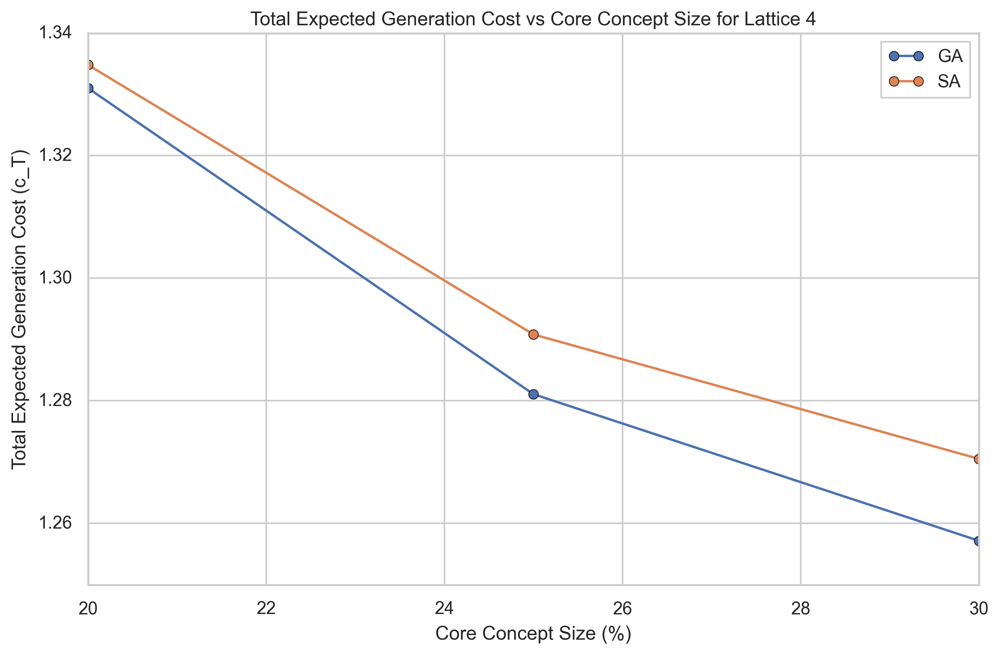

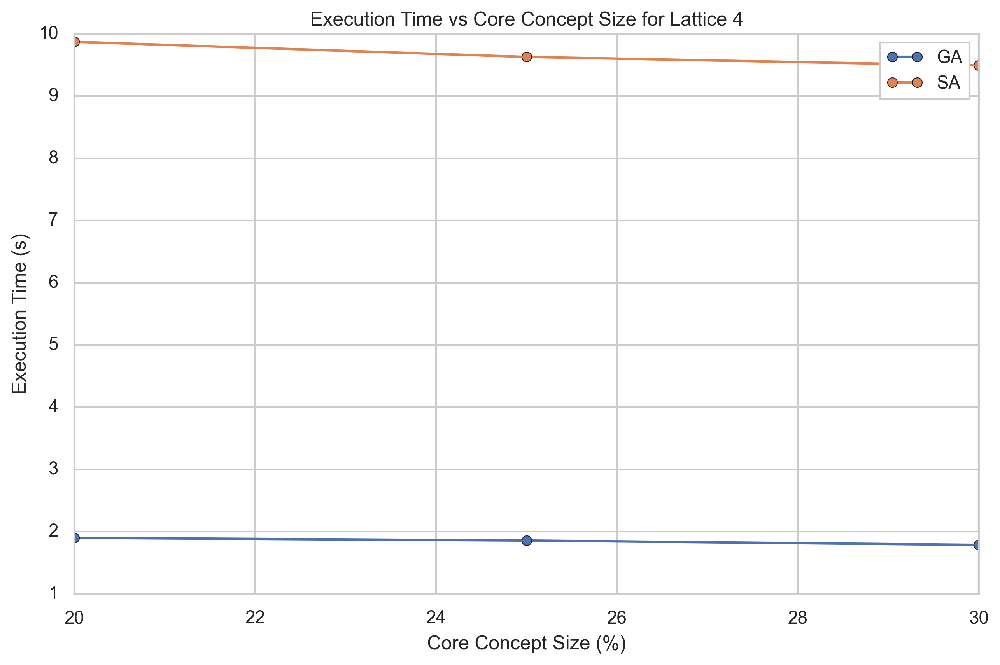

In [89]:
# Required Libraries
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import random
import time
import logging
import os

# Suppress warnings for clarity
import warnings
warnings.filterwarnings('ignore')

# Ensure the code uses a consistent random seed
random.seed(42)
np.random.seed(42)

# ----------------------------
# Function Definitions (Assuming GA and SA implementations are provided)
# ----------------------------

# The GA and SA implementations provided are assumed to be available in the same script or imported as modules.

# We'll use the functions you provided earlier:
# - assign_ids
# - build_hasse_diagram
# - find_attribute_concepts
# - generate_weighted_frequencies
# - assign_words_to_core_concepts
# - calculate_costs
# - generate_word_sequences
# - genetic_algorithm
# - simulated_annealing
# - visualize_hasse_diagram

# ----------------------------
# Main Execution
# ----------------------------

if __name__ == "__main__":
    # Assuming lattices are defined: lattice1, lattice2, lattice3, lattice4
    # For this test, we focus on lattice3
    lattice = lattice4
    lattice_name = 'Lattice 4'

    # Desired core concept sizes
    desired_percentages = [0.20, 0.25, 0.30]

    # Results storage
    results = []

    print(f"\nProcessing {lattice_name}")
    print("-" * 40)

    # Assign unique IDs to each concept
    assigned_concepts = assign_ids(lattice)

    # Create mappings for easy reference
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}
    id_to_intent = {cid: intent for cid, _, intent in assigned_concepts}

    # Build directed Hasse diagram
    DG = build_hasse_diagram(assigned_concepts)  # Directed Hasse diagram

    # Build set of all objects and all attributes
    all_objects = set()
    all_attributes = set()
    for extent, intent in lattice:
        all_objects.update(extent)
        all_attributes.update(intent)

    # Convert to frozensets for comparison
    all_objects = frozenset(all_objects)
    all_attributes = frozenset(all_attributes)

    # Identify the universal (top) and empty (bottom) concepts
    universal_concept_id = None
    empty_concept_id = None
    for cid, extent, intent in assigned_concepts:
        if extent == all_objects and len(intent) == 0:
            universal_concept_id = cid
        if len(extent) == 0 and intent == all_attributes:
            empty_concept_id = cid

    exclude_concepts = {universal_concept_id, empty_concept_id}
    exclude_concepts.discard(None)  # Remove None values if any

    # Find attribute concepts and define Core Concepts C_M
    attribute_to_cid = find_attribute_concepts(assigned_concepts, all_attributes, exclude_concepts)
    C_M = set(attribute_to_cid.values())

    # Generate weighted frequencies
    P_s = generate_weighted_frequencies(assigned_concepts, C_M, exclude_concepts)

    # Determine population size based on lattice size
    def determine_population_size(total_concepts: int, scaling_factor: float = 0.1) -> int:
        """
        Determines population size based on total number of concepts.
        """
        return max(50, int(total_concepts * scaling_factor))

    total_concept_ids = [cid for cid, _, _ in assigned_concepts]
    lattice_size = len(total_concept_ids) - len(exclude_concepts)
    pop_size = determine_population_size(lattice_size, scaling_factor=0.1)

    # Initialize cost parameters
    alpha_p = 1
    alpha_c = 2  # As per experimental settings

    # Total expected generation cost before reduction (using only attribute concepts in C_M)
    c_full, _ = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M,  # Only attribute concepts in C_M
        id_to_intent=id_to_intent,
        alpha_p=alpha_p,
        alpha_c=alpha_c,
        exclude_concepts=exclude_concepts,
        verbose=False
    )
    c_T_full = sum(P_s.get(cid, 0) * c_full.get(cid, 0) for cid in c_full)

    # For each desired_percentage, run GA and SA
    for desired_percentage in desired_percentages:
        print(f"\nTesting Core Concept Size: {desired_percentage * 100}%")
        print("-" * 40)

        # Run Genetic Algorithm to find optimal C_M
        start_time_ga = time.time()
        optimal_C_M_ga = genetic_algorithm(
            assigned_concepts=assigned_concepts,
            DG=DG,
            exclude_concepts=exclude_concepts,
            id_to_intent=id_to_intent,
            P_s=P_s,
            attribute_to_cid=attribute_to_cid,
            total_concepts=total_concept_ids,
            pop_size=pop_size,
            num_generations=100,
            mutation_rate=0.1,
            alpha_p=alpha_p,
            alpha_c=alpha_c,
            desired_percentage=desired_percentage,
            seed_value=42,
            elitism_rate=0.05  # 5% elitism
        )
        end_time_ga = time.time()
        ga_time = end_time_ga - start_time_ga

        # Calculate total expected generation cost for GA
        C_M_ga = optimal_C_M_ga
        c_ga, min_cost_paths_ga = calculate_costs(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M_ga,
            id_to_intent=id_to_intent,
            alpha_p=alpha_p,
            alpha_c=alpha_c,
            exclude_concepts=exclude_concepts,
            verbose=False
        )
        c_T_ga = sum(P_s.get(cid, 0) * c_ga.get(cid, 0) for cid in c_ga)

        # Run Simulated Annealing to find optimal C_M
        start_time_sa = time.time()
        optimal_C_M_sa = simulated_annealing(
            assigned_concepts=assigned_concepts,
            DG=DG,
            exclude_concepts=exclude_concepts,
            id_to_intent=id_to_intent,
            P_s=P_s,
            attribute_to_cid=attribute_to_cid,
            total_concepts=total_concept_ids,
            initial_temp=1500.0,
            final_temp=1.0,
            alpha=0.95,
            num_iterations=200,
            desired_percentage=desired_percentage,
            seed_value=42
        )
        end_time_sa = time.time()
        sa_time = end_time_sa - start_time_sa

        # Calculate total expected generation cost for SA
        C_M_sa = optimal_C_M_sa
        c_sa, min_cost_paths_sa = calculate_costs(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M_sa,
            id_to_intent=id_to_intent,
            alpha_p=alpha_p,
            alpha_c=alpha_c,
            exclude_concepts=exclude_concepts,
            verbose=False
        )
        c_T_sa = sum(P_s.get(cid, 0) * c_sa.get(cid, 0) for cid in c_sa)

        # Record the results
        results.append({
            'Core Concept Size (%)': desired_percentage * 100,
            'Algorithm': 'GA',
            'Core Concepts Selected': len(C_M_ga),
            'c_T Before Reduction': c_T_full,
            'c_T After Reduction': c_T_ga,
            'Execution Time (s)': ga_time,
            'Reduction in c_T (%)': ((c_T_full - c_T_ga) / c_T_full) * 100,
            'Stored Concepts Reduction (%)': ((lattice_size - len(C_M_ga)) / lattice_size) * 100,
        })
        results.append({
            'Core Concept Size (%)': desired_percentage * 100,
            'Algorithm': 'SA',
            'Core Concepts Selected': len(C_M_sa),
            'c_T Before Reduction': c_T_full,
            'c_T After Reduction': c_T_sa,
            'Execution Time (s)': sa_time,
            'Reduction in c_T (%)': ((c_T_full - c_T_sa) / c_T_full) * 100,
            'Stored Concepts Reduction (%)': ((lattice_size - len(C_M_sa)) / lattice_size) * 100,
        })

    # After collecting results, we can plot c_T vs desired_percentage for both algorithms

    # Convert results to DataFrame
    import pandas as pd
    df_results = pd.DataFrame(results)

    # Print the results
    print("\nExperimental Results Summary:")
    print(df_results)

    # Plot c_T vs Core Concept Size (%)
    plt.figure(figsize=(10, 6))
    for algorithm in ['GA', 'SA']:
        df_algo = df_results[df_results['Algorithm'] == algorithm]
        plt.plot(df_algo['Core Concept Size (%)'], df_algo['c_T After Reduction'], marker='o', label=algorithm)
    plt.xlabel('Core Concept Size (%)')
    plt.ylabel('Total Expected Generation Cost (c_T)')
    plt.title(f'Total Expected Generation Cost vs Core Concept Size for {lattice_name}')
    plt.legend()
    plt.grid(True)
    plt.show()




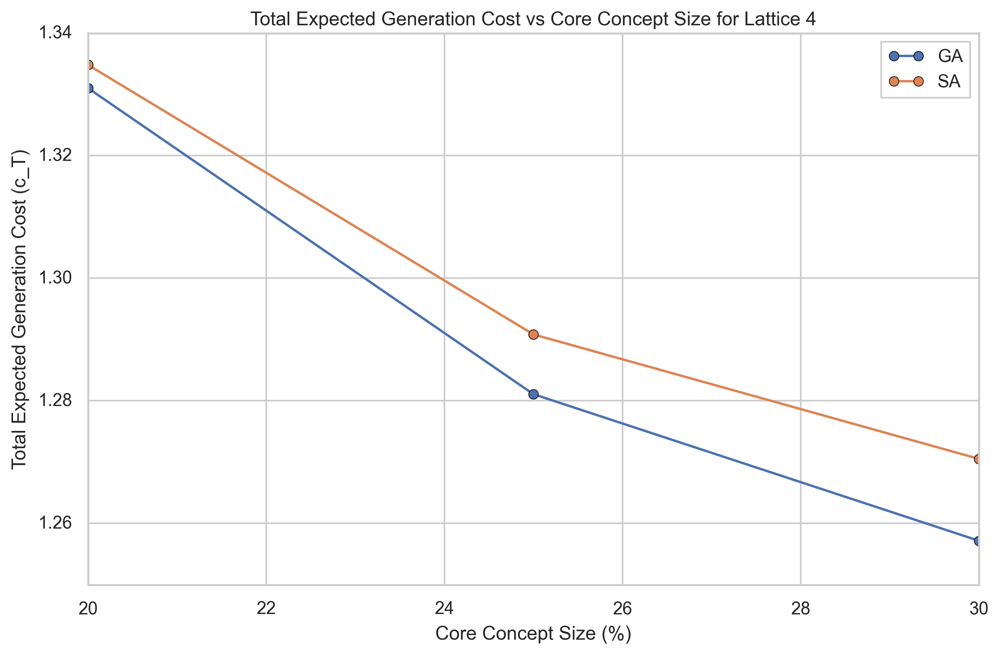

In [90]:
    # Plot c_T vs Core Concept Size (%)
    plt.figure(figsize=(10, 6))
    for algorithm in ['GA', 'SA']:
        df_algo = df_results[df_results['Algorithm'] == algorithm]
        plt.plot(df_algo['Core Concept Size (%)'], df_algo['c_T After Reduction'], marker='o', label=algorithm)
    plt.xlabel('Core Concept Size (%)')
    plt.ylabel('Total Expected Generation Cost (c_T)')
    plt.title(f'Total Expected Generation Cost vs Core Concept Size for {lattice_name}')
    plt.legend()
    plt.grid(True)
    plt.show()


Processing Lattice Example with different frequency distributions
------------------------------------------------------------
Universal Concept (Greatest): s41
Empty Concept (Least): s1

Attribute Concepts (must be included in C_M):
  a7: s40
  a4: s39
  a2: s33
  a5: s35
  a8: s34
  a1: s38
  a3: s37
  a6: s36


Testing with Frequency Distribution: Default
----------------------------------------

Testing Core Concept Size: 20.0%
----------------------------------------
Total number of concepts in the lattice (excluding exclude_concepts): 39
Number of attribute concepts: 8
Desired percentage of additional concepts: 20.0%
Number of additional concepts to select: 6
Total number of concepts in C_M: 14

Generation 1/100, Best Fitness: 1.3854
Generation 10/100, Best Fitness: 1.3423
Generation 20/100, Best Fitness: 1.3343
Generation 30/100, Best Fitness: 1.3310
Generation 40/100, Best Fitness: 1.3310
Generation 50/100, Best Fitness: 1.3310
Generation 60/100, Best Fitness: 1.3310
Generatio

Iteration 122, Temperature: 2.8732, Best Fitness: 1.3348
Iteration 123, Temperature: 2.7296, Best Fitness: 1.3348
Iteration 124, Temperature: 2.5931, Best Fitness: 1.3348
Iteration 125, Temperature: 2.4634, Best Fitness: 1.3348
Iteration 126, Temperature: 2.3403, Best Fitness: 1.3348
Iteration 127, Temperature: 2.2233, Best Fitness: 1.3348
Iteration 128, Temperature: 2.1121, Best Fitness: 1.3348
Iteration 129, Temperature: 2.0065, Best Fitness: 1.3348
Iteration 130, Temperature: 1.9062, Best Fitness: 1.3348
Iteration 131, Temperature: 1.8109, Best Fitness: 1.3348
Iteration 132, Temperature: 1.7203, Best Fitness: 1.3348
Iteration 133, Temperature: 1.6343, Best Fitness: 1.3348
Iteration 134, Temperature: 1.5526, Best Fitness: 1.3348
Iteration 135, Temperature: 1.4750, Best Fitness: 1.3348
Iteration 136, Temperature: 1.4012, Best Fitness: 1.3348
Iteration 137, Temperature: 1.3311, Best Fitness: 1.3348
Iteration 138, Temperature: 1.2646, Best Fitness: 1.3348
Iteration 139, Temperature: 1.2

Iteration 106, Temperature: 6.5282, Best Fitness: 1.2913
Iteration 107, Temperature: 6.2018, Best Fitness: 1.2913
Iteration 108, Temperature: 5.8917, Best Fitness: 1.2913
Iteration 109, Temperature: 5.5971, Best Fitness: 1.2913
Iteration 110, Temperature: 5.3173, Best Fitness: 1.2913
Iteration 111, Temperature: 5.0514, Best Fitness: 1.2913
Iteration 112, Temperature: 4.7988, Best Fitness: 1.2913
Iteration 113, Temperature: 4.5589, Best Fitness: 1.2913
Iteration 114, Temperature: 4.3309, Best Fitness: 1.2913
Iteration 115, Temperature: 4.1144, Best Fitness: 1.2913
Iteration 116, Temperature: 3.9087, Best Fitness: 1.2913
Iteration 117, Temperature: 3.7132, Best Fitness: 1.2913
Iteration 118, Temperature: 3.5276, Best Fitness: 1.2913
Iteration 119, Temperature: 3.3512, Best Fitness: 1.2913
Iteration 120, Temperature: 3.1836, Best Fitness: 1.2913
Iteration 121, Temperature: 3.0245, Best Fitness: 1.2913
Iteration 122, Temperature: 2.8732, Best Fitness: 1.2913
Iteration 123, Temperature: 2.7

Iteration 89, Temperature: 15.6132, Best Fitness: 1.2705
Iteration 90, Temperature: 14.8325, Best Fitness: 1.2705
Iteration 91, Temperature: 14.0909, Best Fitness: 1.2705
Iteration 92, Temperature: 13.3864, Best Fitness: 1.2705
Iteration 93, Temperature: 12.7171, Best Fitness: 1.2705
Iteration 94, Temperature: 12.0812, Best Fitness: 1.2705
Iteration 95, Temperature: 11.4771, Best Fitness: 1.2705
Iteration 96, Temperature: 10.9033, Best Fitness: 1.2705
Iteration 97, Temperature: 10.3581, Best Fitness: 1.2705
Iteration 98, Temperature: 9.8402, Best Fitness: 1.2705
Iteration 99, Temperature: 9.3482, Best Fitness: 1.2705
Iteration 100, Temperature: 8.8808, Best Fitness: 1.2705
Iteration 101, Temperature: 8.4368, Best Fitness: 1.2705
Iteration 102, Temperature: 8.0149, Best Fitness: 1.2705
Iteration 103, Temperature: 7.6142, Best Fitness: 1.2705
Iteration 104, Temperature: 7.2335, Best Fitness: 1.2705
Iteration 105, Temperature: 6.8718, Best Fitness: 1.2705
Iteration 106, Temperature: 6.528

Iteration 72, Temperature: 37.3414, Best Fitness: 1.5279
Iteration 73, Temperature: 35.4743, Best Fitness: 1.5279
Iteration 74, Temperature: 33.7006, Best Fitness: 1.5279
Iteration 75, Temperature: 32.0156, Best Fitness: 1.5279
Iteration 76, Temperature: 30.4148, Best Fitness: 1.5279
Iteration 77, Temperature: 28.8941, Best Fitness: 1.5279
Iteration 78, Temperature: 27.4494, Best Fitness: 1.5279
Iteration 79, Temperature: 26.0769, Best Fitness: 1.5279
Iteration 80, Temperature: 24.7731, Best Fitness: 1.5279
Iteration 81, Temperature: 23.5344, Best Fitness: 1.5279
Iteration 82, Temperature: 22.3577, Best Fitness: 1.5279
Iteration 83, Temperature: 21.2398, Best Fitness: 1.5279
Iteration 84, Temperature: 20.1778, Best Fitness: 1.5279
Iteration 85, Temperature: 19.1689, Best Fitness: 1.5279
Iteration 86, Temperature: 18.2105, Best Fitness: 1.5279
Iteration 87, Temperature: 17.3000, Best Fitness: 1.5279
Iteration 88, Temperature: 16.4350, Best Fitness: 1.5279
Iteration 89, Temperature: 15.6

Iteration 58, Temperature: 76.5703, Best Fitness: 1.4555
Iteration 59, Temperature: 72.7418, Best Fitness: 1.4555
Iteration 60, Temperature: 69.1047, Best Fitness: 1.4555
Iteration 61, Temperature: 65.6495, Best Fitness: 1.4555
Iteration 62, Temperature: 62.3670, Best Fitness: 1.4555
Iteration 63, Temperature: 59.2486, Best Fitness: 1.4555
Iteration 64, Temperature: 56.2862, Best Fitness: 1.4555
Iteration 65, Temperature: 53.4719, Best Fitness: 1.4555
Iteration 66, Temperature: 50.7983, Best Fitness: 1.4555
Iteration 67, Temperature: 48.2584, Best Fitness: 1.4555
Iteration 68, Temperature: 45.8455, Best Fitness: 1.4555
Iteration 69, Temperature: 43.5532, Best Fitness: 1.4555
Iteration 70, Temperature: 41.3755, Best Fitness: 1.4555
Iteration 71, Temperature: 39.3068, Best Fitness: 1.4555
Iteration 72, Temperature: 37.3414, Best Fitness: 1.4555
Iteration 73, Temperature: 35.4743, Best Fitness: 1.4555
Iteration 74, Temperature: 33.7006, Best Fitness: 1.4555
Iteration 75, Temperature: 32.0

Iteration 41, Temperature: 183.1298, Best Fitness: 1.4262
Iteration 42, Temperature: 173.9733, Best Fitness: 1.4262
Iteration 43, Temperature: 165.2747, Best Fitness: 1.4262
Iteration 44, Temperature: 157.0109, Best Fitness: 1.4262
Iteration 45, Temperature: 149.1604, Best Fitness: 1.4262
Iteration 46, Temperature: 141.7024, Best Fitness: 1.4262
Iteration 47, Temperature: 134.6172, Best Fitness: 1.4262
Iteration 48, Temperature: 127.8864, Best Fitness: 1.4262
Iteration 49, Temperature: 121.4921, Best Fitness: 1.4262
Iteration 50, Temperature: 115.4175, Best Fitness: 1.4262
Iteration 51, Temperature: 109.6466, Best Fitness: 1.4262
Iteration 52, Temperature: 104.1643, Best Fitness: 1.4262
Iteration 53, Temperature: 98.9560, Best Fitness: 1.4262
Iteration 54, Temperature: 94.0082, Best Fitness: 1.4262
Iteration 55, Temperature: 89.3078, Best Fitness: 1.4262
Iteration 56, Temperature: 84.8424, Best Fitness: 1.4262
Iteration 57, Temperature: 80.6003, Best Fitness: 1.4262
Iteration 58, Tempe

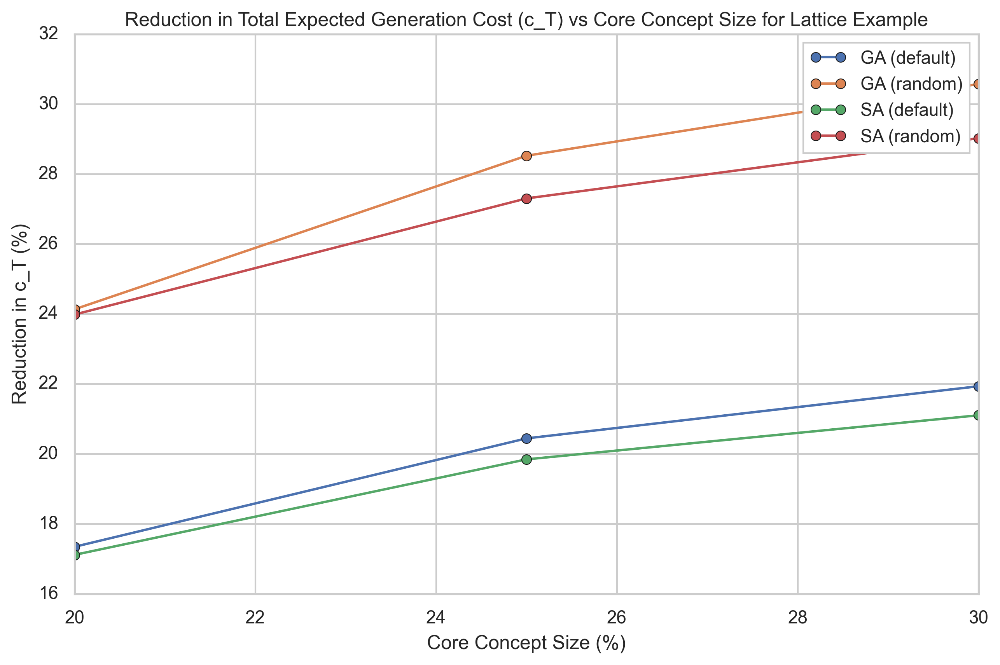

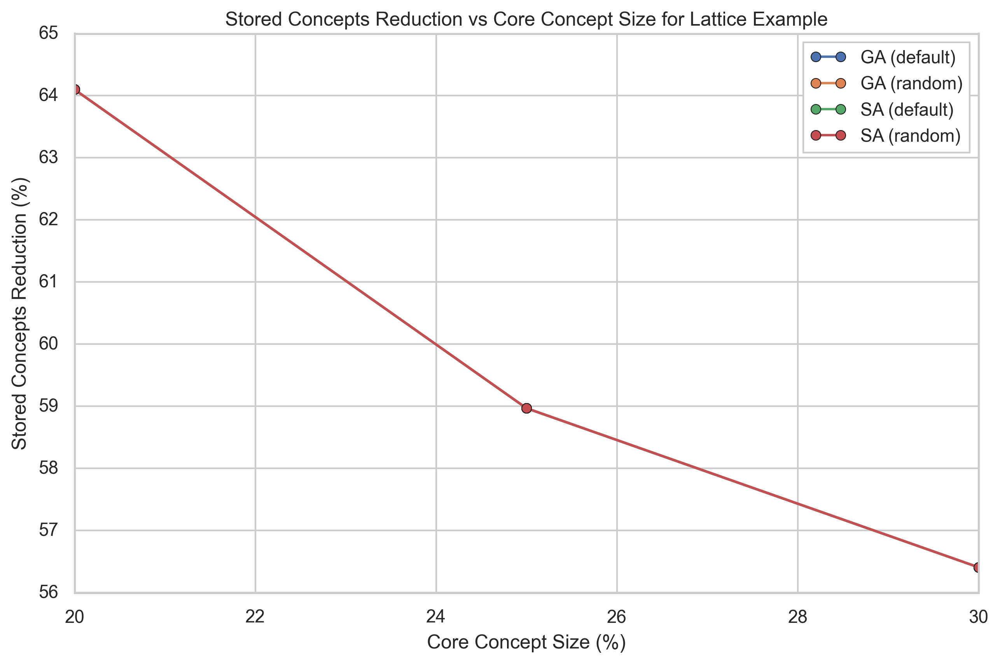

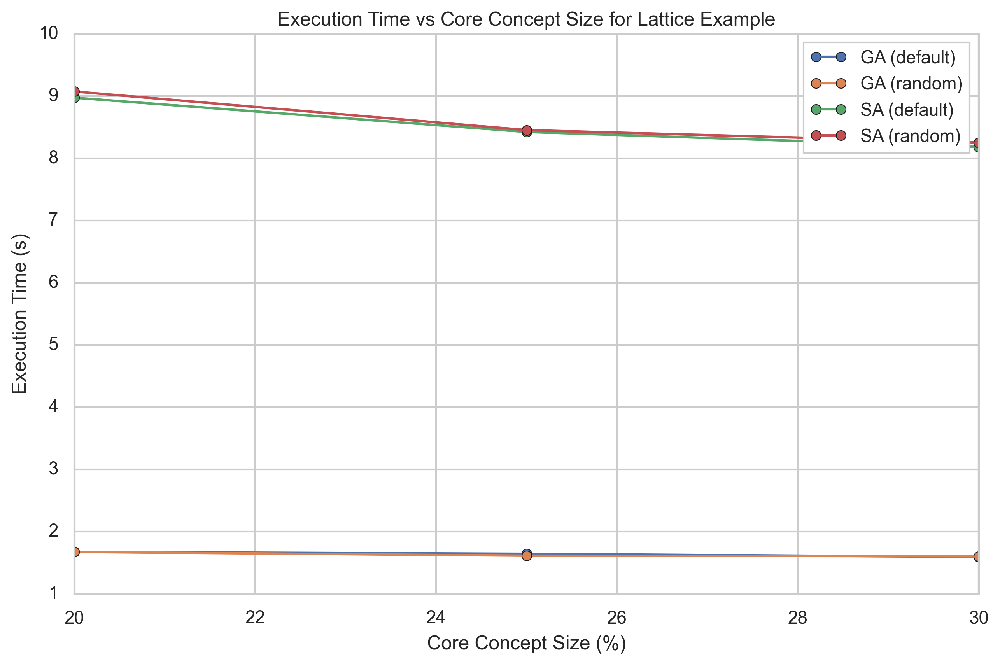

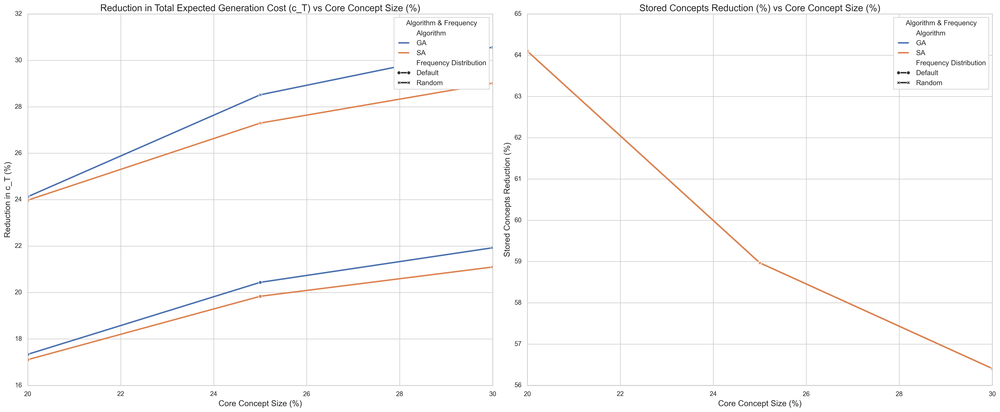

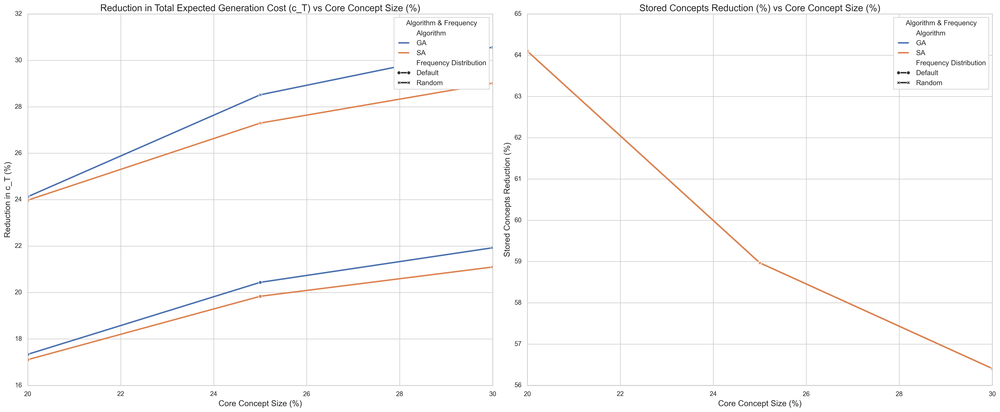


Average Reduction in c_T (%) by Frequency Distribution and Algorithm:
  Frequency Distribution Algorithm  Reduction in c_T (%)
0                Default        GA             19.903333
1                Default        SA             19.350000
2                 Random        GA             27.740000
3                 Random        SA             26.766667

Average Stored Concepts Reduction (%) by Frequency Distribution and Algorithm:
  Frequency Distribution Algorithm  Stored Concepts Reduction (%)
0                Default        GA                      59.826667
1                Default        SA                      59.826667
2                 Random        GA                      59.826667
3                 Random        SA                      59.826667

All tests completed successfully. Results have been saved to 'frequency_influence_results.csv'.
Figures have been saved as PNG files in the current directory.


In [93]:
# Required Libraries
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import random
import time
import logging
import os
import warnings

# Suppress warnings for clarity
warnings.filterwarnings('ignore')

# Ensure the code uses a consistent random seed
random.seed(42)
np.random.seed(42)

# ----------------------------
# Function Definitions
# ----------------------------

def assign_ids(concepts_lattice):
    """
    Assigns unique IDs to each concept in the lattice.

    Parameters:
    - concepts_lattice: List of tuples, each containing a set of objects and a tuple of attributes.

    Returns:
    - List of tuples: (ID, extent, intent)
    """
    assigned_concepts = []
    for idx, (extent, intent) in enumerate(concepts_lattice, start=1):
        concept_id = f's{idx}'
        assigned_concepts.append((concept_id, frozenset(extent), frozenset(intent)))
    return assigned_concepts

def build_hasse_diagram(assigned_concepts):
    """
    Builds a directed Hasse diagram graph where each node is a concept ID.
    Edges point from a concept to its immediate subconcepts.

    Parameters:
    - assigned_concepts: List of tuples (ID, extent, intent)

    Returns:
    - Directed Graph (networkx.DiGraph)
    """
    DG = nx.DiGraph()
    # Initialize nodes
    for cid, _, _ in assigned_concepts:
        DG.add_node(cid)

    # For each concept, find its immediate subconcepts
    for cid_c, _, intent_c in assigned_concepts:
        # Potential subconcepts are those with intents that are supersets of intent_c and not equal
        potential_subconcepts = [
            (cid_d, intent_d) for cid_d, _, intent_d in assigned_concepts
            if intent_d != intent_c and intent_d.issuperset(intent_c)
        ]

        # Now, for each potential subconcept, check if it's an immediate subconcept
        for cid_d, intent_d in potential_subconcepts:
            # There should be no concept intent_e such that intent_c ⊂ intent_e ⊂ intent_d
            is_immediate = True
            for cid_e, _, intent_e in assigned_concepts:
                if intent_e != intent_c and intent_e != intent_d:
                    if intent_e.issuperset(intent_c) and intent_e.issubset(intent_d):
                        is_immediate = False
                        break
            if is_immediate:
                # Add edge from cid_c to cid_d
                DG.add_edge(cid_c, cid_d)

    return DG

def find_attribute_concepts(assigned_concepts, all_attributes, exclude_concepts):
    """
    Finds the attribute concepts s_{A_i} for each attribute A_i in all_attributes,
    excluding any concepts in exclude_concepts.

    Parameters:
    - assigned_concepts: List of tuples (ID, extent, intent)
    - all_attributes: Set of all attribute names
    - exclude_concepts: Set of concept IDs to exclude

    Returns:
    - Dictionary mapping attribute A_i to concept ID of s_{A_i}
    """
    attribute_concepts = {}
    for A_i in all_attributes:
        # Find concepts where A_i is in intent and not excluded
        concepts_with_Ai = [
            (cid, intent) for cid, _, intent in assigned_concepts
            if A_i in intent and cid not in exclude_concepts
        ]
        if not concepts_with_Ai:
            continue  # No concepts with A_i in intent
        # Find minimal intent size
        min_intent_size = min(len(intent) for cid, intent in concepts_with_Ai)
        # Select concepts with minimal intent size
        minimal_concepts = [
            (cid, intent) for cid, intent in concepts_with_Ai
            if len(intent) == min_intent_size
        ]
        # If multiple concepts, pick one (e.g., first)
        cid_min, _ = minimal_concepts[0]
        attribute_concepts[A_i] = cid_min
    return attribute_concepts

def generate_weighted_frequencies(assigned_concepts, C_M, exclude_concepts, distribution='default', seed_value=42):
    """
    Generates weighted frequency values for each concept based on the specified distribution.

    Parameters:
    - assigned_concepts: List of tuples (ID, extent, intent)
    - C_M: Set of core concept IDs
    - exclude_concepts: Set of concept IDs to exclude
    - distribution: 'default' for exponential decay, 'random' for uniform random
    - seed_value: Seed for random number generator for reproducibility

    Returns:
    - Dictionary mapping concept IDs to their frequencies (P_s)
    """
    if seed_value is not None:
        random.seed(seed_value)
        np.random.seed(seed_value)

    frequencies = {}
    if distribution == 'default':
        # Assign higher frequencies to core concepts, lower to others
        for cid, _, intent in assigned_concepts:
            if cid in exclude_concepts:
                continue
            if cid in C_M:
                freq = random.uniform(0.4, 1.0)  # Core concepts
            else:
                freq = random.uniform(0.05, 0.3)  # Non-core concepts
            frequencies[cid] = freq
    elif distribution == 'random':
        # Uniform random distribution for all non-excluded concepts
        for cid, _, intent in assigned_concepts:
            if cid in exclude_concepts:
                continue
            freq = random.uniform(0.05, 1.0)
            frequencies[cid] = freq
    else:
        raise ValueError("Unsupported distribution type. Choose 'default' or 'random'.")

    # Normalize frequencies to sum to 1
    total = sum(frequencies.values())
    P_s = {cid: freq / total for cid, freq in frequencies.items()}
    return P_s

def assign_words_to_core_concepts(C_M, assigned_concepts, attribute_to_cid, P_s):
    """
    Assigns unique words to concepts in the core concepts C_M.

    Parameters:
    - C_M: Set of concept IDs in core concepts
    - assigned_concepts: List of tuples (ID, extent, intent)
    - attribute_to_cid: Dictionary mapping attributes to concept IDs
    - P_s: Frequency distribution of concepts

    Returns:
    - Dictionary mapping concept IDs to words
    """
    C_M_word_map = {}
    used_words = set()

    # Map from concept ID to intent and extent
    cid_to_intent = {cid: intent for cid, _, intent in assigned_concepts}
    cid_to_extent = {cid: extent for cid, extent, _ in assigned_concepts}

    # Assign words to attribute concepts
    for A_i, cid in attribute_to_cid.items():
        C_M_word_map[cid] = A_i
        used_words.add(A_i)

    # Identify randomly selected core concepts (C_M excluding attribute concepts)
    attribute_concept_ids = set(attribute_to_cid.values())
    random_core_concepts = C_M - attribute_concept_ids

    # If there are randomly selected core concepts, assign words based on frequency
    if random_core_concepts:
        # Sort randomly selected core concepts based on descending frequency
        sorted_random_C_M = sorted(random_core_concepts, key=lambda cid: P_s.get(cid, 0), reverse=True)

        extra_word_counter = 1

        for cid in sorted_random_C_M:
            extent = cid_to_extent[cid]
            intent = cid_to_intent[cid]
            # Prefer words from the intent
            possible_words = sorted(intent)
            # If intent is empty, use words from extent
            if not possible_words:
                possible_words = sorted(extent)
            # Assign the first available word not already used
            assigned = False
            for word in possible_words:
                if word not in used_words:
                    C_M_word_map[cid] = word
                    used_words.add(word)
                    assigned = True
                    break
            if not assigned:
                # If all words in intent and extent are used, assign any new unique word
                word = f'word{extra_word_counter}'
                extra_word_counter += 1
                C_M_word_map[cid] = word
                used_words.add(word)
    return C_M_word_map

def calculate_costs(assigned_concepts, DG, C_M, id_to_intent, alpha_p=1, alpha_c=2, exclude_concepts=set(), verbose=True):
    """
    Calculates the generation cost c(s) for each concept and identifies the minimal cost paths.

    Parameters:
    - assigned_concepts: List of tuples (ID, extent, intent)
    - DG: Directed Hasse diagram graph
    - C_M: Set of core concept IDs
    - id_to_intent: Dictionary mapping concept IDs to intents
    - alpha_p: Cost parameter for superconcept paths
    - alpha_c: Cost parameter for subconcept paths
    - exclude_concepts: Set of concept IDs to exclude
    - verbose: If True, prints detailed tracing information

    Returns:
    - Tuple containing:
        - Dictionary mapping concept IDs to their costs
        - Dictionary mapping concept IDs to their minimal cost path information
    """
    c = {}
    min_cost_paths = {}  # To store minimal cost path info for each concept

    for cid, _, intent_s in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts
        if verbose:
            print(f"\nProcessing Concept {cid} with Intent: {set(intent_s)}")
        if cid in C_M:
            c_s = 1  # Single word representation
            c[cid] = c_s
            if verbose:
                print(f"  {cid} is in C_M. c({cid}) = {c_s}")
            min_cost_paths[cid] = ('core_concept', cid, set())
            continue
        # Initialize min_cost to a large value
        min_cost = float('inf')
        min_path = None  # To store minimal cost path info
        # Find nearest superconcepts in C_M
        superconcepts_in_C_M = set(nx.ancestors(DG, cid)).intersection(C_M)
        if superconcepts_in_C_M:
            # Reduce to nearest superconcepts in C_M
            nearest_superconcepts = []
            min_length = float('inf')
            for super_cid in superconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=super_cid, target=cid)
                    if length < min_length:
                        min_length = length
                        nearest_superconcepts = [super_cid]
                    elif length == min_length:
                        nearest_superconcepts.append(super_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest superconcepts in C_M: {sorted(nearest_superconcepts)}")
            for super_cid in nearest_superconcepts:
                # Compute cost via superconcept
                intent_s_p = id_to_intent[super_cid]
                A_r = intent_s - intent_s_p  # Remaining attributes
                cost_p = alpha_p * (1 + len(A_r))
                if verbose:
                    print(f"    Via Superconcept {super_cid}:")
                    print(f"      Attributes covered by {super_cid}: {intent_s_p}")
                    print(f"      Remaining Attributes to Add: {A_r}")
                    print(f"      Cost: {alpha_p} * (1 + {len(A_r)}) = {cost_p}")
                if cost_p < min_cost:
                    min_cost = cost_p
                    min_path = ('superconcept', super_cid, A_r)
        else:
            if verbose:
                print("  No superconcepts in C_M.")

        # Find nearest subconcepts in C_M
        subconcepts_in_C_M = set(nx.descendants(DG, cid)).intersection(C_M)
        if subconcepts_in_C_M:
            # Reduce to nearest subconcepts in C_M
            nearest_subconcepts = []
            min_length = float('inf')
            for sub_cid in subconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=cid, target=sub_cid)
                    if length < min_length:
                        min_length = length
                        nearest_subconcepts = [sub_cid]
                    elif length == min_length:
                        nearest_subconcepts.append(sub_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest subconcepts in C_M: {sorted(nearest_subconcepts)}")
            for sub_cid in nearest_subconcepts:
                # Compute cost via subconcept
                intent_s_c = id_to_intent[sub_cid]
                A_e = intent_s_c - intent_s  # Extra attributes to remove
                cost_c = alpha_c * (1 + len(A_e))
                if verbose:
                    print(f"    Via Subconcept {sub_cid}:")
                    print(f"      Attributes covered by {sub_cid}: {intent_s_c}")
                    print(f"      Extra Attributes to Remove: {A_e}")
                    print(f"      Cost: {alpha_c} * (1 + {len(A_e)}) = {cost_c}")
                if cost_c < min_cost:
                    min_cost = cost_c
                    min_path = ('subconcept', sub_cid, A_e)
        else:
            if verbose:
                print("  No subconcepts in C_M.")

        if min_cost == float('inf'):
            # No paths via C_M, assign default cost
            c_s = alpha_p * len(intent_s)
            if verbose:
                print(f"  No paths via C_M. Assigning default cost: c({cid}) = {c_s}")
            min_cost_paths[cid] = ('default', '', intent_s)
        else:
            c_s = min_cost
            if verbose:
                print(f"  Minimal Cost for {cid}: c({cid}) = {c_s}")
            min_cost_paths[cid] = min_path

        c[cid] = c_s

    return c, min_cost_paths

def generate_word_sequences(assigned_concepts, DG, C_M, C_M_word_map, c, min_cost_paths, exclude_concepts, attribute_to_cid):
    """
    Generates word sequences for each concept based on the minimal cost paths used in cost calculation.

    Parameters:
    - assigned_concepts: List of tuples (ID, extent, intent)
    - DG: Directed Hasse diagram graph
    - C_M: Set of core concept IDs
    - C_M_word_map: Dictionary mapping core concept IDs to words
    - c: Dictionary mapping concept IDs to costs
    - min_cost_paths: Dictionary mapping concept IDs to minimal cost path info
    - exclude_concepts: Set of concept IDs to exclude
    - attribute_to_cid: Dictionary mapping attributes to concept IDs

    Returns:
    - Dictionary mapping concept IDs to their generated word sequences
    """
    word_sequences = {}

    for cid, _, intent_s in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts

        path_info = min_cost_paths.get(cid)
        if not path_info:
            # Assign 'Unknown' if no minimal cost path was found
            word_sequences[cid] = 'Unknown'
            continue

        path_type, ref_cid, attributes = path_info

        if path_type == 'core_concept':
            # Concept is in C_M
            word_sequences[cid] = C_M_word_map[cid]
        elif path_type in ['superconcept', 'subconcept']:
            # Word sequence is word of ref_cid + words of attributes
            words = [C_M_word_map[ref_cid]]
            for A_i in attributes:
                s_Ai_cid = attribute_to_cid.get(A_i)
                if s_Ai_cid and s_Ai_cid in C_M_word_map:
                    words.append(C_M_word_map[s_Ai_cid])
                else:
                    # Attribute concept not found, use attribute name
                    words.append(A_i)
            sequence = ' '.join(words)
            word_sequences[cid] = sequence.strip()
        elif path_type == 'default':
            # No paths via C_M, use words of attributes directly
            words = []
            for A_i in attributes:
                s_Ai_cid = attribute_to_cid.get(A_i)
                if s_Ai_cid and s_Ai_cid in C_M_word_map:
                    words.append(C_M_word_map[s_Ai_cid])
                else:
                    # Attribute concept not found, use attribute name
                    words.append(A_i)
            sequence = ' '.join(words)
            word_sequences[cid] = sequence.strip()
        else:
            # Should not happen, but handle unexpected cases
            word_sequences[cid] = 'Unknown'

    return word_sequences

def visualize_hasse_diagram(DG, id_to_intent, C_M_word_map, C_M, exclude_concepts, output_filename='concept_lattice_hasse.png', dpi=300):
    """
    Visualizes the Hasse diagram of the concept lattice using NetworkX and PyGraphviz.
    The graph is set to display from Top to Bottom (rankdir=TB).

    Parameters:
    - DG: Directed Hasse diagram graph
    - id_to_intent: Dictionary mapping concept IDs to intents
    - C_M_word_map: Dictionary mapping core concept IDs to words
    - C_M: Set of core concept IDs
    - exclude_concepts: Set of concept IDs to exclude from visualization
    - output_filename: Filename for saving the visualization
    - dpi: Resolution of the saved image
    """
    try:
        import pygraphviz
        from networkx.drawing.nx_agraph import to_agraph
    except ImportError:
        print("PyGraphviz is not installed. Please install it to visualize the Hasse diagram.")
        return

    # Initialize PyGraphviz AGraph
    A = to_agraph(DG)

    # Set graph attributes for Top to Bottom direction
    A.graph_attr.update(rankdir='TB')  # Top to Bottom

    # Apply hierarchical layout
    A.layout(prog='dot')  # 'dot' is suitable for hierarchical layouts

    # Customize node styles
    for node in A.nodes():
        cid = node.name
        word = C_M_word_map.get(cid, '')
        if cid in C_M:
            node.attr['color'] = 'red'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightcoral'
            node.attr['label'] = f"{cid}\n{word}"
        elif cid in exclude_concepts:
            node.attr['color'] = 'gray'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightgray'
            node.attr['label'] = f"{cid}\n"  # Optionally include intent
        else:
            node.attr['color'] = 'black'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightblue'
            node.attr['label'] = f"{cid}\n{set(id_to_intent[cid])}"
        node.attr['shape'] = 'ellipse'
        node.attr['fontsize'] = '10'

    # Customize edge styles
    for edge in A.edges():
        edge.attr['color'] = 'gray'
        edge.attr['arrowsize'] = '0.5'

    # Render the graph to a file with high resolution
    A.draw(output_filename, format='png', prog='dot')

    # Display the graph using matplotlib with increased figure size for better clarity
    plt.figure(figsize=(16, 12), dpi=dpi)  # Increased figure size and DPI
    img = plt.imread(output_filename)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Concept Lattice Hasse Diagram with Core Concepts Highlighted", fontsize=16)
    plt.show()

def print_relationships(assigned_concepts, DG, id_to_intent, C_M, exclude_concepts):
    """
    Prints all superconcepts and subconcepts in L and C_M for each concept,
    excluding the universal and empty concepts.

    Parameters:
    - assigned_concepts: List of tuples (ID, extent, intent)
    - DG: Directed Hasse diagram graph
    - id_to_intent: Dictionary mapping concept IDs to intents
    - C_M: Set of core concept IDs
    - exclude_concepts: Set of concept IDs to exclude
    """
    for cid, extent, intent in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts

        print(f"Concept ID: {cid}")
        print("-" * 40)
        print(f"  Extent (Objects): {set(extent)}")
        print(f"  Intent (Attributes): {set(intent)}\n")

        # All superconcepts in L, excluding universal and empty concepts
        all_super_in_L = nx.ancestors(DG, cid) - exclude_concepts
        if all_super_in_L:
            print("  All Superconcepts in L:")
            for super_id in sorted(all_super_in_L, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("  All Superconcepts in L: None")

        # All superconcepts in C_M
        all_super_in_C_M = all_super_in_L.intersection(C_M)
        if all_super_in_C_M:
            print("\n  All Superconcepts in C_M:")
            for super_id in sorted(all_super_in_C_M, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("\n  All Superconcepts in C_M: None")

        # All subconcepts in L, excluding universal and empty concepts
        all_sub_in_L = nx.descendants(DG, cid) - exclude_concepts
        if all_sub_in_L:
            print("\n  All Subconcepts in L:")
            for sub_id in sorted(all_sub_in_L, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in L: None")

        # All subconcepts in C_M
        all_sub_in_C_M = all_sub_in_L.intersection(C_M)
        if all_sub_in_C_M:
            print("\n  All Subconcepts in C_M:")
            for sub_id in sorted(all_sub_in_C_M, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in C_M: None")

        print("-" * 40 + "\n")

# ----------------------------
# Genetic Algorithm and Related Functions
# ----------------------------

def initialize_population(pop_size, num_additional_concepts, attribute_concept_ids, exclude_concepts, total_concepts):
    """
    Initializes a population of individuals (subsets of concept IDs).
    Ensures diversity by random sampling.

    Parameters:
    - pop_size: Population size
    - num_additional_concepts: Number of additional concepts to select
    - attribute_concept_ids: Set of attribute concept IDs
    - exclude_concepts: Set of concept IDs to exclude
    - total_concepts: List of all concept IDs

    Returns:
    - List of sets, each representing an individual
    """
    population = []
    eligible_concepts = set(total_concepts) - attribute_concept_ids - exclude_concepts
    for _ in range(pop_size):
        if len(eligible_concepts) >= num_additional_concepts:
            individual = set(random.sample(eligible_concepts, num_additional_concepts))
        else:
            individual = set(eligible_concepts)
        individual.update(attribute_concept_ids)
        population.append(individual)
    return population

def ga_fitness_function(C_M_candidate, assigned_concepts, DG, exclude_concepts, id_to_intent, P_s, attribute_to_cid, alpha_p=1, alpha_c=2):
    """
    Calculates the total expected generation cost c_M for a candidate C_M.

    Parameters:
    - C_M_candidate: Set of concept IDs representing the candidate C_M
    - assigned_concepts: List of tuples (ID, extent, intent)
    - DG: Directed Hasse diagram graph
    - exclude_concepts: Set of concept IDs to exclude
    - id_to_intent: Dictionary mapping concept IDs to intents
    - P_s: Frequency distribution of concepts
    - attribute_to_cid: Dictionary mapping attributes to concept IDs
    - alpha_p: Cost parameter for superconcept paths
    - alpha_c: Cost parameter for subconcept paths

    Returns:
    - Float representing the total expected generation cost
    """
    c_candidate, _ = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M_candidate,
        id_to_intent=id_to_intent,
        alpha_p=alpha_p,
        alpha_c=alpha_c,
        exclude_concepts=exclude_concepts,
        verbose=False
    )

    # Calculate Total Expected Generation Cost c_M
    c_M_total = 0.0
    for cid in c_candidate:
        c_s = c_candidate[cid]
        ps = P_s.get(cid, 0)
        term = c_s * ps
        c_M_total += term
    return c_M_total

def selection(population, fitness_scores, num_parents):
    """
    Selects parents for crossover based on fitness scores using tournament selection.

    Parameters:
    - population: List of individuals
    - fitness_scores: List of fitness scores corresponding to the population
    - num_parents: Number of parents to select

    Returns:
    - List of selected parent individuals
    """
    parents = []
    for _ in range(num_parents):
        # Tournament selection with k=3
        candidates = random.sample(list(zip(population, fitness_scores)), k=3)
        parent = min(candidates, key=lambda x: x[1])[0]  # Select the individual with the lowest fitness
        parents.append(parent)
    return parents

def crossover(parent1, parent2, attribute_concept_ids):
    """
    Performs uniform crossover between two parents to produce an offspring.
    Ensures consistent gene ordering by sorting.

    Parameters:
    - parent1: First parent individual (set)
    - parent2: Second parent individual (set)
    - attribute_concept_ids: Set of attribute concept IDs

    Returns:
    - Offspring individual (set)
    """
    offspring = set()
    genes1 = sorted(parent1 - attribute_concept_ids)
    genes2 = sorted(parent2 - attribute_concept_ids)

    # Ensure both gene lists are of the same length by padding shorter one
    max_length = max(len(genes1), len(genes2))
    genes1.extend([None] * (max_length - len(genes1)))
    genes2.extend([None] * (max_length - len(genes2)))

    for gene1, gene2 in zip(genes1, genes2):
        if gene1 is None and gene2 is not None:
            offspring.add(gene2)
        elif gene2 is None and gene1 is not None:
            offspring.add(gene1)
        elif gene1 is not None and gene2 is not None:
            if random.random() < 0.5:
                offspring.add(gene1)
            else:
                offspring.add(gene2)
        # If both genes are None, do nothing

    # Ensure attribute concepts are included
    offspring.update(attribute_concept_ids)
    return offspring

def mutation(individual, mutation_rate, eligible_concepts, attribute_concept_ids):
    """
    Mutates an individual by randomly adding/removing concepts.

    Parameters:
    - individual: Individual to mutate (set)
    - mutation_rate: Probability of mutation
    - eligible_concepts: Set of eligible concept IDs for mutation
    - attribute_concept_ids: Set of attribute concept IDs

    Returns:
    - Mutated individual (set)
    """
    individual = set(individual)
    non_attribute_genes = individual - attribute_concept_ids
    for gene in list(non_attribute_genes):
        if random.random() < mutation_rate:
            individual.remove(gene)
            available_genes = eligible_concepts - individual
            if available_genes:
                new_gene = random.choice(list(available_genes))
                individual.add(new_gene)
    # Attribute concepts remain included
    individual.update(attribute_concept_ids)
    return individual

def calculate_genotypic_diversity(population):
    """
    Calculates the average pairwise Hamming distance among individuals.

    Parameters:
    - population: List of individuals (sets)

    Returns:
    - Average Hamming distance (float)
    """
    total_distance = 0
    count = 0
    pop_list = [sorted(individual) for individual in population]
    for i in range(len(pop_list)):
        for j in range(i + 1, len(pop_list)):
            set1 = set(pop_list[i])
            set2 = set(pop_list[j])
            distance = len(set1.symmetric_difference(set2))
            total_distance += distance
            count += 1
    return total_distance / count if count > 0 else 0

def genetic_algorithm(assigned_concepts, DG, exclude_concepts, id_to_intent, P_s, attribute_to_cid,
                      total_concepts, pop_size=50, num_generations=100, mutation_rate=0.1,
                      alpha_p=1, alpha_c=2, desired_percentage=0.20, seed_value=42,
                      elitism_rate=0.05):
    """
    Runs the genetic algorithm to find the optimal subset C_M.
    Incorporates elitism to preserve top individuals across generations.

    Parameters:
    - assigned_concepts: List of tuples (ID, extent, intent)
    - DG: Directed Hasse diagram graph
    - exclude_concepts: Set of concept IDs to exclude
    - id_to_intent: Dictionary mapping concept IDs to intents
    - P_s: Frequency distribution of concepts
    - attribute_to_cid: Dictionary mapping attributes to concept IDs
    - total_concepts: List of all concept IDs
    - pop_size: Population size
    - num_generations: Number of generations
    - mutation_rate: Mutation rate
    - alpha_p: Cost parameter for superconcept paths
    - alpha_c: Cost parameter for subconcept paths
    - desired_percentage: Desired percentage of additional concepts
    - seed_value: Seed for random number generator
    - elitism_rate: Fraction of top individuals to preserve

    Returns:
    - Best individual found (set)
    """
    if seed_value is not None:
        random.seed(seed_value)
        np.random.seed(seed_value)

    # Calculate elite count
    elite_count = max(1, int(elitism_rate * pop_size))

    attribute_concept_ids = set(attribute_to_cid.values())
    total_concepts_set = set(total_concepts) - exclude_concepts

    # Calculate number of additional concepts to select (excluding attribute concepts)
    num_additional_concepts = int(round(desired_percentage * len(total_concepts_set - attribute_concept_ids)))
    # Ensure we don't select more concepts than are available
    num_additional_concepts = min(num_additional_concepts, len(total_concepts_set - attribute_concept_ids))

    # Total number of concepts to select (size of C_M)
    total_concepts_to_select = len(attribute_concept_ids) + num_additional_concepts

    print(f"Total number of concepts in the lattice (excluding exclude_concepts): {len(total_concepts_set)}")
    print(f"Number of attribute concepts: {len(attribute_concept_ids)}")
    print(f"Desired percentage of additional concepts: {desired_percentage * 100}%")
    print(f"Number of additional concepts to select: {num_additional_concepts}")
    print(f"Total number of concepts in C_M: {total_concepts_to_select}\n")

    # Initialize population
    population = initialize_population(
        pop_size=pop_size,
        num_additional_concepts=num_additional_concepts,
        attribute_concept_ids=attribute_concept_ids,
        exclude_concepts=exclude_concepts,
        total_concepts=total_concepts
    )

    best_fitness = float('inf')
    best_individual = None

    # Configure logging for monitoring
    logging.basicConfig(filename='ga_log.txt', level=logging.INFO,
                        format='%(asctime)s - Generation %(message)s')

    for generation in range(num_generations):
        fitness_scores = [ga_fitness_function(
            individual, assigned_concepts, DG, exclude_concepts, id_to_intent, P_s, attribute_to_cid,
            alpha_p, alpha_c) for individual in population]

        # Identify elite individuals
        elite_indices = np.argsort(fitness_scores)[:elite_count]
        elites = [population[i] for i in elite_indices]
        elite_fitness = [fitness_scores[i] for i in elite_indices]

        # Update best individual
        if elite_fitness[0] < best_fitness:
            best_fitness = elite_fitness[0]
            best_individual = elites[0]

        # Calculate diversity
        diversity = calculate_genotypic_diversity(population)

        # Log current generation's best fitness and diversity
        logging.info(f"{generation + 1}, Best Fitness: {best_fitness:.4f}, Diversity: {diversity:.4f}")

        # Selection
        parents = selection(population, fitness_scores, num_parents=pop_size // 2)

        # Crossover and Mutation to create new population
        offspring = []
        eligible_concepts = set(total_concepts_set) - attribute_concept_ids
        while len(offspring) < pop_size - elite_count:
            parent1, parent2 = random.sample(parents, 2)
            child = crossover(parent1, parent2, attribute_concept_ids)
            # Adaptive mutation rate based on diversity (optional)
            adjusted_mutation_rate = mutation_rate * (1 - diversity / len(eligible_concepts)) if len(eligible_concepts) > 0 else mutation_rate
            child = mutation(child, adjusted_mutation_rate, eligible_concepts, attribute_concept_ids)
            offspring.append(child)

        # Combine elites with offspring to form the new population
        population = elites + offspring

        if (generation + 1) % 10 == 0 or generation == 0:
            print(f"Generation {generation + 1}/{num_generations}, Best Fitness: {best_fitness:.4f}")

    print(f"\nOptimal c_M_total found: {best_fitness:.4f}")
    return best_individual

# ----------------------------
# Simulated Annealing and Related Functions
# ----------------------------

def initial_solution(attribute_concept_ids, eligible_concepts, num_additional_concepts):
    """
    Generates an initial solution (subset of concept IDs).

    Parameters:
    - attribute_concept_ids: Set of attribute concept IDs
    - eligible_concepts: Set of eligible concept IDs for mutation
    - num_additional_concepts: Number of additional concepts to select

    Returns:
    - Set representing the initial solution
    """
    solution = set(random.sample(eligible_concepts, num_additional_concepts))
    solution.update(attribute_concept_ids)
    return solution

def sa_fitness_function(C_M_candidate, assigned_concepts, DG, exclude_concepts, id_to_intent, P_s, attribute_to_cid, alpha_p=1, alpha_c=2):
    """
    Calculates the total expected generation cost c_M for a candidate C_M.

    Parameters:
    - C_M_candidate: Set of concept IDs representing the candidate C_M
    - assigned_concepts: List of tuples (ID, extent, intent)
    - DG: Directed Hasse diagram graph
    - exclude_concepts: Set of concept IDs to exclude
    - id_to_intent: Dictionary mapping concept IDs to intents
    - P_s: Frequency distribution of concepts
    - attribute_to_cid: Dictionary mapping attributes to concept IDs
    - alpha_p: Cost parameter for superconcept paths
    - alpha_c: Cost parameter for subconcept paths

    Returns:
    - Float representing the total expected generation cost
    """
    c_candidate, _ = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M_candidate,
        id_to_intent=id_to_intent,
        alpha_p=alpha_p,
        alpha_c=alpha_c,
        exclude_concepts=exclude_concepts,
        verbose=False
    )

    # Calculate Total Expected Generation Cost c_M
    c_M_total = 0.0
    for cid in c_candidate:
        c_s = c_candidate[cid]
        ps = P_s.get(cid, 0)
        term = c_s * ps
        c_M_total += term
    return c_M_total

def get_neighbor(solution, attribute_concept_ids, eligible_concepts):
    """
    Generates a neighboring solution by swapping a concept.

    Parameters:
    - solution: Current solution (set)
    - attribute_concept_ids: Set of attribute concept IDs
    - eligible_concepts: Set of eligible concept IDs for mutation

    Returns:
    - Neighboring solution (set)
    """
    neighbor = set(solution)
    non_attribute_genes = neighbor - attribute_concept_ids
    if not non_attribute_genes:
        return neighbor  # No non-attribute genes to swap

    # Remove a random non-attribute concept
    gene_to_remove = random.choice(list(non_attribute_genes))
    neighbor.remove(gene_to_remove)

    # Add a new concept not in the current solution
    available_genes = eligible_concepts - neighbor - attribute_concept_ids
    if available_genes:
        gene_to_add = random.choice(list(available_genes))
        neighbor.add(gene_to_add)
    else:
        # If no available genes, re-add the removed gene
        neighbor.add(gene_to_remove)

    return neighbor

def simulated_annealing(assigned_concepts, DG, exclude_concepts, id_to_intent, P_s, attribute_to_cid,
                        total_concepts, initial_temp=1500.0, final_temp=1.0, alpha=0.95,
                        num_iterations=200, desired_percentage=0.20, seed_value=42):
    """
    Runs the simulated annealing algorithm to find the optimal subset C_M.

    Parameters:
    - assigned_concepts: List of tuples (ID, extent, intent)
    - DG: Directed Hasse diagram graph
    - exclude_concepts: Set of concept IDs to exclude
    - id_to_intent: Dictionary mapping concept IDs to intents
    - P_s: Frequency distribution of concepts
    - attribute_to_cid: Dictionary mapping attributes to concept IDs
    - total_concepts: List of all concept IDs
    - initial_temp: Initial temperature
    - final_temp: Final temperature
    - alpha: Cooling rate
    - num_iterations: Number of iterations at each temperature
    - desired_percentage: Desired percentage of additional concepts
    - seed_value: Seed for random number generator

    Returns:
    - Best solution found (set)
    """
    if seed_value is not None:
        random.seed(seed_value)
        np.random.seed(seed_value)

    attribute_concept_ids = set(attribute_to_cid.values())
    total_concepts_set = set(total_concepts) - exclude_concepts

    # Calculate number of additional concepts to select (excluding attribute concepts)
    num_additional_concepts = int(round(desired_percentage * len(total_concepts_set - attribute_concept_ids)))
    # Ensure we don't select more concepts than are available
    num_additional_concepts = min(num_additional_concepts, len(total_concepts_set - attribute_concept_ids))

    # Total number of concepts to select (size of C_M)
    total_concepts_to_select = len(attribute_concept_ids) + num_additional_concepts

    print(f"Total number of concepts in the lattice (excluding exclude_concepts): {len(total_concepts_set)}")
    print(f"Number of attribute concepts: {len(attribute_concept_ids)}")
    print(f"Desired percentage of additional concepts: {desired_percentage * 100}%")
    print(f"Number of additional concepts to select: {num_additional_concepts}")
    print(f"Total number of concepts in C_M: {total_concepts_to_select}\n")

    # Generate initial solution
    eligible_concepts = total_concepts_set - attribute_concept_ids
    current_solution = initial_solution(attribute_concept_ids, eligible_concepts, num_additional_concepts)
    current_fitness = sa_fitness_function(
        C_M_candidate=current_solution,
        assigned_concepts=assigned_concepts,
        DG=DG,
        exclude_concepts=exclude_concepts,
        id_to_intent=id_to_intent,
        P_s=P_s,
        attribute_to_cid=attribute_to_cid
    )

    best_solution = set(current_solution)
    best_fitness = current_fitness

    temp = initial_temp
    iteration = 0

    while temp > final_temp:
        for _ in range(num_iterations):
            neighbor_solution = get_neighbor(current_solution, attribute_concept_ids, eligible_concepts)
            neighbor_fitness = sa_fitness_function(
                C_M_candidate=neighbor_solution,
                assigned_concepts=assigned_concepts,
                DG=DG,
                exclude_concepts=exclude_concepts,
                id_to_intent=id_to_intent,
                P_s=P_s,
                attribute_to_cid=attribute_to_cid
            )

            delta_fitness = neighbor_fitness - current_fitness

            if delta_fitness < 0 or random.uniform(0, 1) < np.exp(-delta_fitness / temp):
                current_solution = neighbor_solution
                current_fitness = neighbor_fitness

                if current_fitness < best_fitness:
                    best_solution = set(current_solution)
                    best_fitness = current_fitness

        temp *= alpha
        iteration += 1
        print(f"Iteration {iteration}, Temperature: {temp:.4f}, Best Fitness: {best_fitness:.4f}")

    print(f"\nOptimal c_M_total found: {best_fitness:.4f}")
    return best_solution

# ----------------------------
# Main Execution for Frequency Influence Testing
# ----------------------------

if __name__ == "__main__":
    # Example concept lattice data
    # Replace this with your actual lattice data
    # Each concept is a tuple: (set of objects, tuple of attributes)
    lattice = lattice4
    lattice_name = 'Lattice Example'

    # Define frequency distributions to test
    frequency_distributions = ['default', 'random']

    # Desired core concept sizes (percentages)
    desired_percentages = [0.20, 0.25, 0.30]

    # Results storage
    results = []

    print(f"\nProcessing {lattice_name} with different frequency distributions")
    print("-" * 60)

    # Assign unique IDs to each concept
    assigned_concepts = assign_ids(lattice)

    # Create mappings for easy reference
    intent_to_id = {tuple(intent): cid for cid, _, intent in assigned_concepts}
    id_to_intent = {cid: intent for cid, _, intent in assigned_concepts}

    # Build directed Hasse diagram
    DG = build_hasse_diagram(assigned_concepts)  # Directed Hasse diagram

    # Build set of all objects and all attributes
    all_objects = set()
    all_attributes = set()
    for extent, intent in lattice:
        all_objects.update(extent)
        all_attributes.update(intent)

    # Convert to frozensets for comparison
    all_objects = frozenset(all_objects)
    all_attributes = frozenset(all_attributes)

    # Identify the universal (top) and empty (bottom) concepts
    universal_concept_id = None
    empty_concept_id = None
    for cid, extent, intent in assigned_concepts:
        if extent == all_objects and len(intent) == 0:
            universal_concept_id = cid
        if len(extent) == 0 and intent == all_attributes:
            empty_concept_id = cid

    exclude_concepts = {universal_concept_id, empty_concept_id}
    exclude_concepts.discard(None)  # Remove None values if any

    # Print Universal and Empty Concepts
    print(f"Universal Concept (Greatest): {universal_concept_id}")
    print(f"Empty Concept (Least): {empty_concept_id}\n")

    # Find attribute concepts and define Core Concepts C_M
    attribute_to_cid = find_attribute_concepts(assigned_concepts, all_attributes, exclude_concepts)
    C_M = set(attribute_to_cid.values())

    print("Attribute Concepts (must be included in C_M):")
    for attr, cid in attribute_to_cid.items():
        print(f"  {attr}: {cid}")
    print()

    # Determine population size based on lattice size
    def determine_population_size(total_concepts: int, scaling_factor: float = 0.1) -> int:
        """
        Determines population size based on total number of concepts.
        """
        return max(50, int(total_concepts * scaling_factor))

    total_concept_ids = [cid for cid, _, _ in assigned_concepts]
    lattice_size = len(total_concept_ids) - len(exclude_concepts)
    pop_size = determine_population_size(lattice_size, scaling_factor=0.1)

    # For each frequency distribution, perform tests
    for distribution in frequency_distributions:
        print(f"\nTesting with Frequency Distribution: {distribution.capitalize()}")
        print("-" * 40)

        # Generate weighted frequencies based on distribution
        P_s = generate_weighted_frequencies(assigned_concepts, C_M, exclude_concepts, distribution=distribution, seed_value=42)

        # Total expected generation cost before reduction (using only attribute concepts in C_M)
        c_full, _ = calculate_costs(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M,  # Only attribute concepts in C_M
            id_to_intent=id_to_intent,
            alpha_p=1,
            alpha_c=2,
            exclude_concepts=exclude_concepts,
            verbose=False
        )
        c_T_full = sum(P_s.get(cid, 0) * c_full.get(cid, 0) for cid in c_full)

        # For each desired_percentage, run GA and SA
        for desired_percentage in desired_percentages:
            print(f"\nTesting Core Concept Size: {desired_percentage * 100}%")
            print("-" * 40)

            # Run Genetic Algorithm to find optimal C_M
            start_time_ga = time.time()
            optimal_C_M_ga = genetic_algorithm(
                assigned_concepts=assigned_concepts,
                DG=DG,
                exclude_concepts=exclude_concepts,
                id_to_intent=id_to_intent,
                P_s=P_s,
                attribute_to_cid=attribute_to_cid,
                total_concepts=total_concept_ids,
                pop_size=pop_size,
                num_generations=100,
                mutation_rate=0.1,
                alpha_p=1,
                alpha_c=2,
                desired_percentage=desired_percentage,
                seed_value=42,
                elitism_rate=0.05  # 5% elitism
            )
            end_time_ga = time.time()
            ga_time = end_time_ga - start_time_ga

            # Calculate total expected generation cost for GA
            C_M_ga = optimal_C_M_ga
            c_ga, min_cost_paths_ga = calculate_costs(
                assigned_concepts=assigned_concepts,
                DG=DG,
                C_M=C_M_ga,
                id_to_intent=id_to_intent,
                alpha_p=1,
                alpha_c=2,
                exclude_concepts=exclude_concepts,
                verbose=False
            )
            c_T_ga = sum(P_s.get(cid, 0) * c_ga.get(cid, 0) for cid in c_ga)

            # Run Simulated Annealing to find optimal C_M
            start_time_sa = time.time()
            optimal_C_M_sa = simulated_annealing(
                assigned_concepts=assigned_concepts,
                DG=DG,
                exclude_concepts=exclude_concepts,
                id_to_intent=id_to_intent,
                P_s=P_s,
                attribute_to_cid=attribute_to_cid,
                total_concepts=total_concept_ids,
                initial_temp=1500.0,
                final_temp=1.0,
                alpha=0.95,
                num_iterations=200,
                desired_percentage=desired_percentage,
                seed_value=42
            )
            end_time_sa = time.time()
            sa_time = end_time_sa - start_time_sa

            # Calculate total expected generation cost for SA
            C_M_sa = optimal_C_M_sa
            c_sa, min_cost_paths_sa = calculate_costs(
                assigned_concepts=assigned_concepts,
                DG=DG,
                C_M=C_M_sa,
                id_to_intent=id_to_intent,
                alpha_p=1,
                alpha_c=2,
                exclude_concepts=exclude_concepts,
                verbose=False
            )
            c_T_sa = sum(P_s.get(cid, 0) * c_sa.get(cid, 0) for cid in c_sa)

            # Record the results
            results.append({
                'Frequency Distribution': distribution.capitalize(),
                'Core Concept Size (%)': desired_percentage * 100,
                'Algorithm': 'GA',
                'Core Concepts Selected': len(C_M_ga),
                'c_T Before Reduction': round(c_T_full, 5),
                'c_T After Reduction': round(c_T_ga, 5),
                'Execution Time (s)': round(ga_time, 2),
                'Reduction in c_T (%)': round(((c_T_full - c_T_ga) / c_T_full) * 100, 2),
                'Stored Concepts Reduction (%)': round(((lattice_size - len(C_M_ga)) / lattice_size) * 100, 2),
            })
            results.append({
                'Frequency Distribution': distribution.capitalize(),
                'Core Concept Size (%)': desired_percentage * 100,
                'Algorithm': 'SA',
                'Core Concepts Selected': len(C_M_sa),
                'c_T Before Reduction': round(c_T_full, 5),
                'c_T After Reduction': round(c_T_sa, 5),
                'Execution Time (s)': round(sa_time, 2),
                'Reduction in c_T (%)': round(((c_T_full - c_T_sa) / c_T_full) * 100, 2),
                'Stored Concepts Reduction (%)': round(((lattice_size - len(C_M_sa)) / lattice_size) * 100, 2),
            })

    # After collecting results, we can plot and save them

    # Convert results to DataFrame
    df_results = pd.DataFrame(results)

    # Print the results
    print("\nExperimental Results Summary:")
    print(df_results)

    # Save the results to a CSV file for future reference
    df_results.to_csv('frequency_influence_results.csv', index=False)

    # Plot Reduction in c_T (%) vs Core Concept Size (%) for each Frequency Distribution and Algorithm
    plt.figure(figsize=(10, 6))
    for algorithm in ['GA', 'SA']:
        for distribution in frequency_distributions:
            df_subset = df_results[
                (df_results['Algorithm'] == algorithm) &
                (df_results['Frequency Distribution'] == distribution.capitalize())
            ]
            plt.plot(df_subset['Core Concept Size (%)'], df_subset['Reduction in c_T (%)'],
                     marker='o', label=f"{algorithm} ({distribution})")
    plt.xlabel('Core Concept Size (%)')
    plt.ylabel('Reduction in c_T (%)')
    plt.title(f'Reduction in Total Expected Generation Cost (c_T) vs Core Concept Size for {lattice_name}')
    plt.legend()
    plt.grid(True)
    plt.savefig('Figure2_Reduction_cT_vs_CoreConceptSize.png')
    plt.show()

    # Plot Reduction in Stored Concepts (%) vs Core Concept Size (%) for each Frequency Distribution and Algorithm
    plt.figure(figsize=(10, 6))
    for algorithm in ['GA', 'SA']:
        for distribution in frequency_distributions:
            df_subset = df_results[
                (df_results['Algorithm'] == algorithm) &
                (df_results['Frequency Distribution'] == distribution.capitalize())
            ]
            plt.plot(df_subset['Core Concept Size (%)'], df_subset['Stored Concepts Reduction (%)'],
                     marker='o', label=f"{algorithm} ({distribution})")
    plt.xlabel('Core Concept Size (%)')
    plt.ylabel('Stored Concepts Reduction (%)')
    plt.title(f'Stored Concepts Reduction vs Core Concept Size for {lattice_name}')
    plt.legend()
    plt.grid(True)
    plt.savefig('Figure3_StoredConceptsReduction_vs_CoreConceptSize.png')
    plt.show()

    # Plot Execution Time (s) vs Core Concept Size (%) for each Frequency Distribution and Algorithm
    plt.figure(figsize=(10, 6))
    for algorithm in ['GA', 'SA']:
        for distribution in frequency_distributions:
            df_subset = df_results[
                (df_results['Algorithm'] == algorithm) &
                (df_results['Frequency Distribution'] == distribution.capitalize())
            ]
            plt.plot(df_subset['Core Concept Size (%)'], df_subset['Execution Time (s)'],
                     marker='o', label=f"{algorithm} ({distribution})")
    plt.xlabel('Core Concept Size (%)')
    plt.ylabel('Execution Time (s)')
    plt.title(f'Execution Time vs Core Concept Size for {lattice_name}')
    plt.legend()
    plt.grid(True)
    plt.savefig('Figure4_ExecutionTime_vs_CoreConceptSize.png')
    plt.show()

    # Combined Plot: Reduction in c_T (%) and Stored Concepts Reduction (%) vs Core Concept Size (%) for each Frequency Distribution and Algorithm
    fig, axes = plt.subplots(1, 2, figsize=(24, 10), sharex=True)

    # Plot Reduction in c_T (%)
    sns.lineplot(ax=axes[0], data=df_results, x='Core Concept Size (%)', y='Reduction in c_T (%)',
                 hue='Algorithm', style='Frequency Distribution', markers=True, dashes=False, linewidth=2.5)
    axes[0].set_title('Reduction in Total Expected Generation Cost (c_T) vs Core Concept Size (%)', fontsize=16)
    axes[0].set_xlabel('Core Concept Size (%)', fontsize=14)
    axes[0].set_ylabel('Reduction in c_T (%)', fontsize=14)
    axes[0].legend(title='Algorithm & Frequency', fontsize=12, title_fontsize=12)
    axes[0].grid(True)

    # Plot Stored Concepts Reduction (%)
    sns.lineplot(ax=axes[1], data=df_results, x='Core Concept Size (%)', y='Stored Concepts Reduction (%)',
                 hue='Algorithm', style='Frequency Distribution', markers=True, dashes=False, linewidth=2.5)
    axes[1].set_title('Stored Concepts Reduction (%) vs Core Concept Size (%)', fontsize=16)
    axes[1].set_xlabel('Core Concept Size (%)', fontsize=14)
    axes[1].set_ylabel('Stored Concepts Reduction (%)', fontsize=14)
    axes[1].legend(title='Algorithm & Frequency', fontsize=12, title_fontsize=12)
    axes[1].grid(True)

    plt.tight_layout()
    plt.savefig('Figure5_Combined_Reductions_vs_CoreConceptSize.png')
    plt.show()

    # Combined Plot: Reduction in c_T (%) and Stored Concepts Reduction (%) vs Core Concept Size (%) for each Frequency Distribution and Algorithm
    fig, axes = plt.subplots(1, 2, figsize=(24, 10), sharex=True)

    # Plot Reduction in c_T (%)
    sns.lineplot(ax=axes[0], data=df_results, x='Core Concept Size (%)', y='Reduction in c_T (%)',
                 hue='Algorithm', style='Frequency Distribution', markers=True, dashes=False, linewidth=2.5)
    axes[0].set_title('Reduction in Total Expected Generation Cost (c_T) vs Core Concept Size (%)', fontsize=16)
    axes[0].set_xlabel('Core Concept Size (%)', fontsize=14)
    axes[0].set_ylabel('Reduction in c_T (%)', fontsize=14)
    axes[0].legend(title='Algorithm & Frequency', fontsize=12, title_fontsize=12)
    axes[0].grid(True)

    # Plot Stored Concepts Reduction (%)
    sns.lineplot(ax=axes[1], data=df_results, x='Core Concept Size (%)', y='Stored Concepts Reduction (%)',
                 hue='Algorithm', style='Frequency Distribution', markers=True, dashes=False, linewidth=2.5)
    axes[1].set_title('Stored Concepts Reduction (%) vs Core Concept Size (%)', fontsize=16)
    axes[1].set_xlabel('Core Concept Size (%)', fontsize=14)
    axes[1].set_ylabel('Stored Concepts Reduction (%)', fontsize=14)
    axes[1].legend(title='Algorithm & Frequency', fontsize=12, title_fontsize=12)
    axes[1].grid(True)

    plt.tight_layout()
    plt.savefig('Figure6_Combined_Reductions_vs_CoreConceptSize.png')
    plt.show()

    # ----------------------------
    # Additional Analysis (Optional)
    # ----------------------------

    # Example: Average Reduction in c_T by Frequency Distribution and Algorithm
    avg_reduction_ct = df_results.groupby(['Frequency Distribution', 'Algorithm'])['Reduction in c_T (%)'].mean().reset_index()
    print("\nAverage Reduction in c_T (%) by Frequency Distribution and Algorithm:")
    print(avg_reduction_ct)

    # Example: Average Stored Concepts Reduction by Frequency Distribution and Algorithm
    avg_reduction_sc = df_results.groupby(['Frequency Distribution', 'Algorithm'])['Stored Concepts Reduction (%)'].mean().reset_index()
    print("\nAverage Stored Concepts Reduction (%) by Frequency Distribution and Algorithm:")
    print(avg_reduction_sc)

    # ----------------------------
    # Saving Figures and Results
    # ----------------------------

    # All figures are already saved using plt.savefig above.
    # Results are saved to 'frequency_influence_results.csv'.
    # You can also save the DataFrame to Excel if needed:
    # df_results.to_excel('frequency_influence_results.xlsx', index=False)

    print("\nAll tests completed successfully. Results have been saved to 'frequency_influence_results.csv'.")
    print("Figures have been saved as PNG files in the current directory.")


Distribution: default, Algorithm: GA, c_T: 1.3310, Runtime: 1.6469 seconds
Iteration 1, Temperature: 950.0000, Best Fitness: 1.3642
Iteration 2, Temperature: 902.5000, Best Fitness: 1.3642
Iteration 3, Temperature: 857.3750, Best Fitness: 1.3520
Iteration 4, Temperature: 814.5062, Best Fitness: 1.3520
Iteration 5, Temperature: 773.7809, Best Fitness: 1.3520
Iteration 6, Temperature: 735.0919, Best Fitness: 1.3470
Iteration 7, Temperature: 698.3373, Best Fitness: 1.3470
Iteration 8, Temperature: 663.4204, Best Fitness: 1.3470
Iteration 9, Temperature: 630.2494, Best Fitness: 1.3470
Iteration 10, Temperature: 598.7369, Best Fitness: 1.3470
Iteration 11, Temperature: 568.8001, Best Fitness: 1.3470
Iteration 12, Temperature: 540.3601, Best Fitness: 1.3470
Iteration 13, Temperature: 513.3421, Best Fitness: 1.3470
Iteration 14, Temperature: 487.6750, Best Fitness: 1.3470
Iteration 15, Temperature: 463.2912, Best Fitness: 1.3470
Iteration 16, Temperature: 440.1267, Best Fitness: 1.3470
Iterat

Iteration 7, Temperature: 698.3373, Best Fitness: 1.7179
Iteration 8, Temperature: 663.4204, Best Fitness: 1.7179
Iteration 9, Temperature: 630.2494, Best Fitness: 1.7179
Iteration 10, Temperature: 598.7369, Best Fitness: 1.7179
Iteration 11, Temperature: 568.8001, Best Fitness: 1.7179
Iteration 12, Temperature: 540.3601, Best Fitness: 1.7179
Iteration 13, Temperature: 513.3421, Best Fitness: 1.7179
Iteration 14, Temperature: 487.6750, Best Fitness: 1.7179
Iteration 15, Temperature: 463.2912, Best Fitness: 1.7179
Iteration 16, Temperature: 440.1267, Best Fitness: 1.7179
Iteration 17, Temperature: 418.1203, Best Fitness: 1.7179
Iteration 18, Temperature: 397.2143, Best Fitness: 1.6923
Iteration 19, Temperature: 377.3536, Best Fitness: 1.6923
Iteration 20, Temperature: 358.4859, Best Fitness: 1.6923
Iteration 21, Temperature: 340.5616, Best Fitness: 1.6923
Iteration 22, Temperature: 323.5335, Best Fitness: 1.6923
Iteration 23, Temperature: 307.3569, Best Fitness: 1.6923
Iteration 24, Tem

Iteration 14, Temperature: 487.6750, Best Fitness: 1.5473
Iteration 15, Temperature: 463.2912, Best Fitness: 1.5473
Iteration 16, Temperature: 440.1267, Best Fitness: 1.5473
Iteration 17, Temperature: 418.1203, Best Fitness: 1.5473
Iteration 18, Temperature: 397.2143, Best Fitness: 1.5473
Iteration 19, Temperature: 377.3536, Best Fitness: 1.5473
Iteration 20, Temperature: 358.4859, Best Fitness: 1.5473
Iteration 21, Temperature: 340.5616, Best Fitness: 1.5473
Iteration 22, Temperature: 323.5335, Best Fitness: 1.5473
Iteration 23, Temperature: 307.3569, Best Fitness: 1.5473
Iteration 24, Temperature: 291.9890, Best Fitness: 1.5473
Iteration 25, Temperature: 277.3896, Best Fitness: 1.5473
Iteration 26, Temperature: 263.5201, Best Fitness: 1.5473
Iteration 27, Temperature: 250.3441, Best Fitness: 1.5473
Iteration 28, Temperature: 237.8269, Best Fitness: 1.5473
Iteration 29, Temperature: 225.9355, Best Fitness: 1.5473
Iteration 30, Temperature: 214.6388, Best Fitness: 1.5473
Iteration 31, 

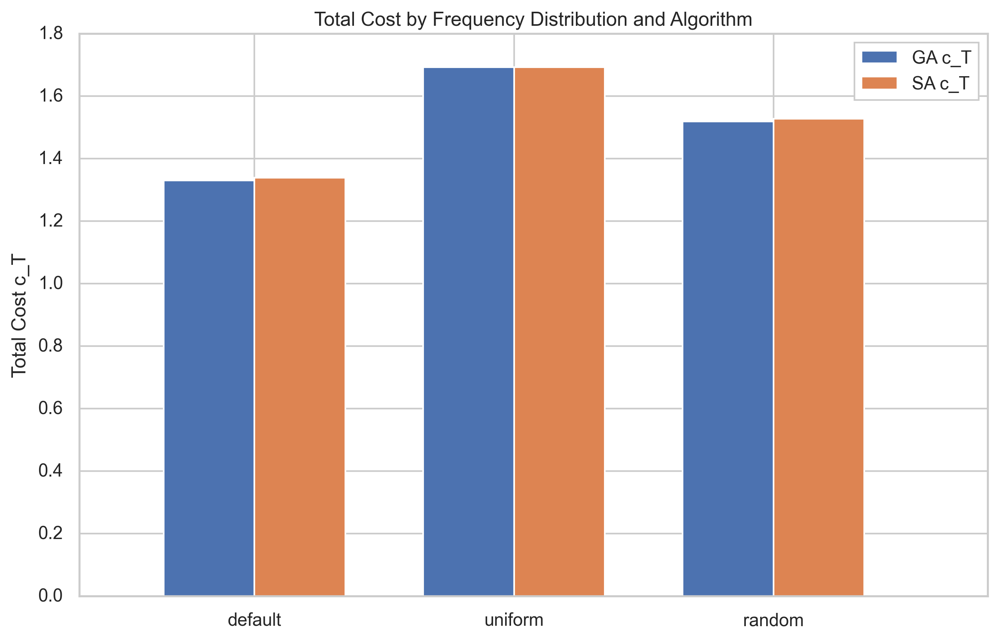

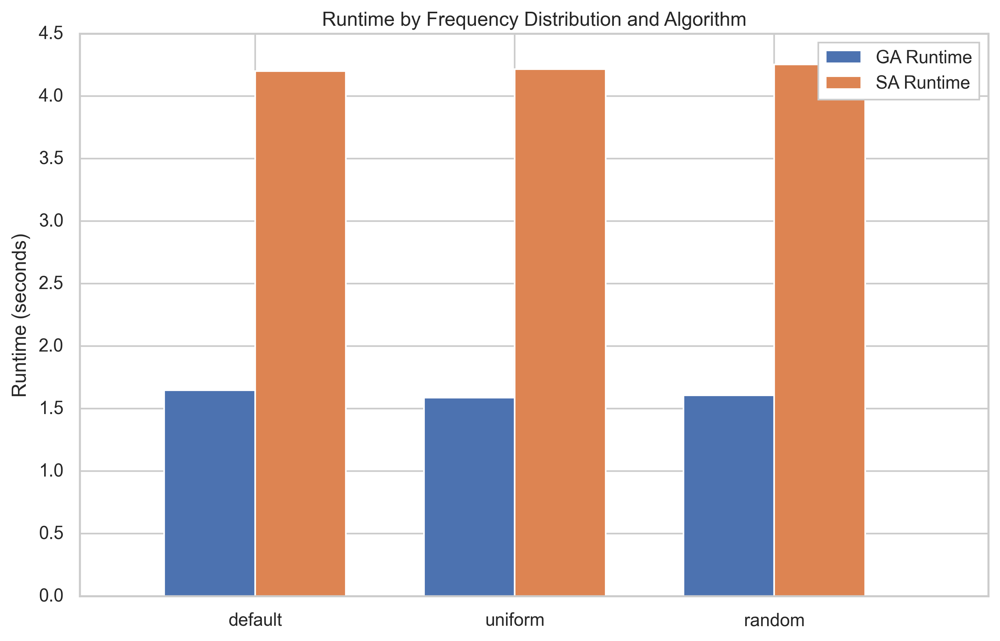

In [95]:
import time
from typing import Set, List, Tuple, Dict
import networkx as nx
import matplotlib.pyplot as plt
import random
import numpy as np
import logging

# ----------------------------
# Function Definitions
# ----------------------------

def assign_ids(concepts_lattice: List[Tuple[Set[str], Tuple[str, ...]]]) -> List[Tuple[str, frozenset, frozenset]]:
    """
    Assigns unique IDs to each concept in the lattice.

    Returns:
    - List of tuples: (ID, extent, intent)
    """
    assigned_concepts = []
    for idx, (extent, intent) in enumerate(concepts_lattice, start=1):
        concept_id = f's{idx}'
        assigned_concepts.append((concept_id, frozenset(extent), frozenset(intent)))
    return assigned_concepts

def build_hasse_diagram(assigned_concepts: List[Tuple[str, frozenset, frozenset]]) -> nx.DiGraph:
    """
    Builds a directed Hasse diagram graph where each node is a concept ID.
    Edges point from a concept to its immediate subconcepts.

    Returns:
    - Directed Graph (networkx.DiGraph)
    """
    DG = nx.DiGraph()
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}

    # Initialize nodes
    for cid, _, _ in assigned_concepts:
        DG.add_node(cid)

    # For each concept, find its immediate subconcepts
    for cid_c, _, intent_c in assigned_concepts:
        # Potential subconcepts are those with intents that are supersets of intent_c and not equal
        potential_subconcepts = [(cid_d, intent_d) for cid_d, _, intent_d in assigned_concepts
                                 if intent_d != intent_c and intent_d.issuperset(intent_c)]

        # Now, for each potential subconcept, check if it's an immediate subconcept
        for cid_d, intent_d in potential_subconcepts:
            # There should be no concept intent_e such that intent_c ⊂ intent_e ⊂ intent_d
            is_immediate = True
            for cid_e, _, intent_e in assigned_concepts:
                if intent_e != intent_c and intent_e != intent_d:
                    if intent_e.issuperset(intent_c) and intent_e.issubset(intent_d):
                        is_immediate = False
                        break
            if is_immediate:
                # Add edge from cid_c to cid_d
                DG.add_edge(cid_c, cid_d)

    return DG

def find_attribute_concepts(assigned_concepts: List[Tuple[str, frozenset, frozenset]], 
                           all_attributes: Set[str],
                           exclude_concepts: Set[str]) -> Dict[str, str]:
    """
    Finds the attribute concepts s_{A_i} for each attribute A_i in all_attributes,
    excluding any concepts in exclude_concepts.

    Returns:
    - Dictionary mapping attribute A_i to concept ID of s_{A_i}
    """
    attribute_concepts = {}
    for A_i in all_attributes:
        # Find concepts where A_i is in intent and not excluded
        concepts_with_Ai = [(cid, intent) for cid, _, intent in assigned_concepts 
                            if A_i in intent and cid not in exclude_concepts]
        if not concepts_with_Ai:
            continue  # No concepts with A_i in intent
        # Find minimal intent size
        min_intent_size = min(len(intent) for cid, intent in concepts_with_Ai)
        # Select concepts with minimal intent size
        minimal_concepts = [(cid, intent) for cid, intent in concepts_with_Ai 
                            if len(intent) == min_intent_size]
        # If multiple concepts, pick one (e.g., first)
        cid_min, _ = minimal_concepts[0]
        attribute_concepts[A_i] = cid_min
    return attribute_concepts

def generate_weighted_frequencies(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                                  C_M: Set[str],
                                  exclude_concepts: Set[str],
                                  distribution: str = 'default',
                                  seed_value: int = 42) -> Dict[str, float]:
    """
    Generates weighted frequency values for each concept based on the specified distribution.
    Core concepts (attributes and randomly selected) are assigned higher frequencies.
    Other concepts are assigned lower frequencies.

    Parameters:
    - assigned_concepts: List of all assigned concepts with IDs.
    - C_M: Core concepts subset.
    - exclude_concepts: Set of concepts to exclude from processing.
    - distribution: Type of frequency distribution ('default', 'uniform', 'random').
    - seed_value: Seed for random number generator for reproducibility.

    Returns:
    - Dictionary mapping concept IDs to their frequencies.
    """
    random.seed(seed_value)
    frequencies = {}
    total = 0.0

    if distribution == 'default':
        for cid, _, intent in assigned_concepts:
            if cid in exclude_concepts:
                continue  # Skip universal and empty concepts
            if cid in C_M:
                # Assign higher frequency range for core concepts
                freq = random.uniform(0.4, 1.0)  # Adjusted range for core concepts
            else:
                # Assign lower frequency range for non-core concepts
                freq = random.uniform(0.05, 0.3)  # Adjusted range for non-core concepts
            frequencies[cid] = freq
            total += freq
    elif distribution == 'uniform':
        for cid, _, intent in assigned_concepts:
            if cid in exclude_concepts:
                continue
            freq = 1.0  # Uniform frequency
            frequencies[cid] = freq
            total += freq
    elif distribution == 'random':
        for cid, _, intent in assigned_concepts:
            if cid in exclude_concepts:
                continue
            freq = random.uniform(0.05, 1.0)  # Completely random frequencies
            frequencies[cid] = freq
            total += freq
    else:
        raise ValueError("Unsupported distribution type. Choose from 'default', 'uniform', 'random'.")

    # Normalize frequencies to sum to 1
    for cid in frequencies:
        frequencies[cid] /= total

    return frequencies

def assign_words_to_core_concepts(C_M: Set[str], 
                                  assigned_concepts: List[Tuple[str, frozenset, frozenset]], 
                                  attribute_to_cid: Dict[str, str], 
                                  P_s: Dict[str, float]) -> Dict[str, str]:
    """
    Assigns unique words to concepts in the core concepts C_M.
    """
    C_M_word_map = {}
    used_words = set()

    # Map from concept ID to intent and extent
    cid_to_intent = {cid: intent for cid, _, intent in assigned_concepts}
    cid_to_extent = {cid: extent for cid, extent, _ in assigned_concepts}

    # Assign words to attribute concepts
    for A_i, cid in attribute_to_cid.items():
        C_M_word_map[cid] = A_i
        used_words.add(A_i)

    # Identify randomly selected core concepts (C_M excluding attribute concepts)
    attribute_concept_ids = set(attribute_to_cid.values())
    random_core_concepts = C_M - attribute_concept_ids

    # If there are randomly selected core concepts, assign words based on frequency
    if random_core_concepts:
        # Sort randomly selected core concepts based on descending frequency
        sorted_random_C_M = sorted(random_core_concepts, key=lambda cid: P_s.get(cid, 0), reverse=True)

        extra_word_counter = 1

        for cid in sorted_random_C_M:
            extent = cid_to_extent[cid]
            intent = cid_to_intent[cid]
            # Prefer words from the intent
            possible_words = sorted(intent)
            # If intent is empty, use words from extent
            if not possible_words:
                possible_words = sorted(extent)
            # Assign the first available word not already used
            assigned = False
            for word in possible_words:
                if word not in used_words:
                    C_M_word_map[cid] = word
                    used_words.add(word)
                    assigned = True
                    break
            if not assigned:
                # If all words in intent and extent are used, assign any new unique word
                word = f'word{extra_word_counter}'
                extra_word_counter += 1
                C_M_word_map[cid] = word
                used_words.add(word)
    return C_M_word_map

def calculate_costs(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                   DG: nx.DiGraph,
                   C_M: Set[str],
                   id_to_intent: Dict[str, frozenset],
                   alpha_p: int = 1,
                   alpha_c: int = 2,
                   exclude_concepts: Set[str] = set(),
                   verbose: bool = False) -> Tuple[Dict[str, float], Dict[str, Tuple[str, str, Set[str]]]]:
    """
    Calculates the generation cost c(s) for each concept and identifies the minimal cost paths.

    Parameters:
    - assigned_concepts: List of all assigned concepts with IDs.
    - DG: Directed Hasse diagram graph.
    - C_M: Core concepts subset.
    - id_to_intent: Mapping from concept ID to intent.
    - alpha_p: Cost parameter for superconcept paths.
    - alpha_c: Cost parameter for subconcept paths.
    - exclude_concepts: Set of concepts to exclude from processing.
    - verbose: If True, prints detailed tracing information.

    Returns:
    - Tuple containing:
        - Dictionary mapping concept IDs to their costs.
        - Dictionary mapping concept IDs to their minimal cost path information.
    """
    c = {}
    min_cost_paths = {}  # To store minimal cost path info for each concept

    for cid, _, intent_s in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts
        if verbose:
            print(f"\nProcessing Concept {cid} with Intent: {set(intent_s)}")
        if cid in C_M:
            c_s = 1  # Single word representation
            c[cid] = c_s
            if verbose:
                print(f"  {cid} is in C_M. c({cid}) = {c_s}")
            min_cost_paths[cid] = ('core_concept', cid, set())
            continue
        # Initialize min_cost to a large value
        min_cost = float('inf')
        min_path = None  # To store minimal cost path info
        # Find nearest superconcepts in C_M
        superconcepts_in_C_M = set(nx.ancestors(DG, cid)).intersection(C_M)
        if superconcepts_in_C_M:
            # Reduce to nearest superconcepts in C_M
            nearest_superconcepts = []
            min_length = float('inf')
            for super_cid in superconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=super_cid, target=cid)
                    if length < min_length:
                        min_length = length
                        nearest_superconcepts = [super_cid]
                    elif length == min_length:
                        nearest_superconcepts.append(super_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest superconcepts in C_M: {sorted(nearest_superconcepts)}")
            for super_cid in nearest_superconcepts:
                # Compute cost via superconcept
                intent_s_p = id_to_intent[super_cid]
                A_r = intent_s - intent_s_p  # Remaining attributes
                cost_p = alpha_p * (1 + len(A_r))
                if verbose:
                    print(f"    Via Superconcept {super_cid}:")
                    print(f"      Attributes covered by {super_cid}: {intent_s_p}")
                    print(f"      Remaining Attributes to Add: {A_r}")
                    print(f"      Cost: {alpha_p} * (1 + {len(A_r)}) = {cost_p}")
                if cost_p < min_cost:
                    min_cost = cost_p
                    min_path = ('superconcept', super_cid, A_r)
        else:
            if verbose:
                print("  No superconcepts in C_M.")

        # Find nearest subconcepts in C_M
        subconcepts_in_C_M = set(nx.descendants(DG, cid)).intersection(C_M)
        if subconcepts_in_C_M:
            # Reduce to nearest subconcepts in C_M
            nearest_subconcepts = []
            min_length = float('inf')
            for sub_cid in subconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=cid, target=sub_cid)
                    if length < min_length:
                        min_length = length
                        nearest_subconcepts = [sub_cid]
                    elif length == min_length:
                        nearest_subconcepts.append(sub_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest subconcepts in C_M: {sorted(nearest_subconcepts)}")
            for sub_cid in nearest_subconcepts:
                # Compute cost via subconcept
                intent_s_c = id_to_intent[sub_cid]
                A_e = intent_s_c - intent_s  # Extra attributes to remove
                cost_c = alpha_c * (1 + len(A_e))
                if verbose:
                    print(f"    Via Subconcept {sub_cid}:")
                    print(f"      Attributes covered by {sub_cid}: {intent_s_c}")
                    print(f"      Extra Attributes to Remove: {A_e}")
                    print(f"      Cost: {alpha_c} * (1 + {len(A_e)}) = {cost_c}")
                if cost_c < min_cost:
                    min_cost = cost_c
                    min_path = ('subconcept', sub_cid, A_e)
        else:
            if verbose:
                print("  No subconcepts in C_M.")

        if min_cost == float('inf'):
            # No paths via C_M, assign default cost
            c_s = alpha_p * len(intent_s)
            if verbose:
                print(f"  No paths via C_M. Assigning default cost: c({cid}) = {c_s}")
            min_cost_paths[cid] = ('default', '', intent_s)
        else:
            c_s = min_cost
            if verbose:
                print(f"  Minimal Cost for {cid}: c({cid}) = {c_s}")
            min_cost_paths[cid] = min_path

        c[cid] = c_s

    return c, min_cost_paths

def genetic_algorithm(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                      DG: nx.DiGraph,
                      exclude_concepts: Set[str],
                      id_to_intent: Dict[str, frozenset],
                      P_s: Dict[str, float],
                      attribute_to_cid: Dict[str, str],
                      total_concepts: List[str],
                      pop_size: int = 50,
                      num_generations: int = 100,
                      mutation_rate: float = 0.1,
                      alpha_p: int = 1,
                      alpha_c: int = 2,
                      desired_percentage: float = 0.50,
                      seed_value: int = 42,
                      elitism_rate: float = 0.05) -> Tuple[Set[str], float]:
    """
    Runs the genetic algorithm to find the optimal subset C_M.
    Returns the best individual and its fitness.
    """
    random.seed(seed_value)
    np.random.seed(seed_value)

    # Calculate elite count
    elite_count = max(1, int(elitism_rate * pop_size))

    attribute_concept_ids = set(attribute_to_cid.values())
    total_concepts_set = set(total_concepts) - exclude_concepts

    # Calculate number of additional concepts to select (excluding attribute concepts)
    num_additional_concepts = int(round(desired_percentage * len(total_concepts_set - attribute_concept_ids)))
    # Ensure we don't select more concepts than are available
    num_additional_concepts = min(num_additional_concepts, len(total_concepts_set - attribute_concept_ids))

    # Total number of concepts to select (size of C_M)
    total_concepts_to_select = len(attribute_concept_ids) + num_additional_concepts

    # Initialize population
    population = initialize_population(
        pop_size=pop_size,
        num_additional_concepts=num_additional_concepts,
        attribute_concept_ids=attribute_concept_ids,
        exclude_concepts=exclude_concepts,
        total_concepts=total_concepts
    )

    best_fitness = float('inf')
    best_individual = None

    for generation in range(num_generations):
        fitness_scores = [fitness_function(
            individual, assigned_concepts, DG, exclude_concepts, id_to_intent, P_s, attribute_to_cid,
            alpha_p, alpha_c) for individual in population]

        # Identify elite individuals
        elite_indices = np.argsort(fitness_scores)[:elite_count]
        elites = [population[i] for i in elite_indices]
        elite_fitness = [fitness_scores[i] for i in elite_indices]

        # Update best individual
        if elite_fitness[0] < best_fitness:
            best_fitness = elite_fitness[0]
            best_individual = elites[0]

        # Selection
        parents = selection(population, fitness_scores, num_parents=pop_size // 2)

        # Crossover and Mutation to create new population
        offspring = []
        eligible_concepts = set(total_concepts_set) - attribute_concept_ids
        while len(offspring) < pop_size - elite_count:
            parent1, parent2 = random.sample(parents, 2)
            child = crossover(parent1, parent2, attribute_concept_ids)
            child = mutation(child, mutation_rate, eligible_concepts, attribute_concept_ids)
            offspring.append(child)

        # Combine elites with offspring to form the new population
        population = elites + offspring

    return best_individual, best_fitness

def simulated_annealing(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                        DG: nx.DiGraph,
                        exclude_concepts: Set[str],
                        id_to_intent: Dict[str, frozenset],
                        P_s: Dict[str, float],
                        attribute_to_cid: Dict[str, str],
                        total_concepts: List[str],
                        initial_temp: float = 1000.0,
                        final_temp: float = 1.0,
                        alpha: float = 0.95,
                        num_iterations: int = 100,
                        desired_percentage: float = 0.20,
                        seed_value: int = 42) -> Tuple[Set[str], float]:
    """
    Runs the simulated annealing algorithm to find the optimal subset C_M.
    Returns the best individual and its fitness.
    """
    random.seed(seed_value)
    np.random.seed(seed_value)

    attribute_concept_ids = set(attribute_to_cid.values())
    total_concepts_set = set(total_concepts) - exclude_concepts

    # Calculate number of additional concepts to select (excluding attribute concepts)
    num_additional_concepts = int(round(desired_percentage * len(total_concepts_set - attribute_concept_ids)))
    # Ensure we don't select more concepts than are available
    num_additional_concepts = min(num_additional_concepts, len(total_concepts_set - attribute_concept_ids))

    # Total number of concepts to select (size of C_M)
    total_concepts_to_select = len(attribute_concept_ids) + num_additional_concepts

    # Generate initial solution
    eligible_concepts = total_concepts_set - attribute_concept_ids
    current_solution = initial_solution(attribute_concept_ids, eligible_concepts, num_additional_concepts)
    current_fitness = fitness_function(
        C_M_candidate=current_solution,
        assigned_concepts=assigned_concepts,
        DG=DG,
        exclude_concepts=exclude_concepts,
        id_to_intent=id_to_intent,
        P_s=P_s,
        attribute_to_cid=attribute_to_cid
    )

    best_solution = set(current_solution)
    best_fitness = current_fitness

    temp = initial_temp
    iteration = 0

    while temp > final_temp:
        for _ in range(num_iterations):
            neighbor_solution = get_neighbor(current_solution, attribute_concept_ids, eligible_concepts)
            neighbor_fitness = fitness_function(
                C_M_candidate=neighbor_solution,
                assigned_concepts=assigned_concepts,
                DG=DG,
                exclude_concepts=exclude_concepts,
                id_to_intent=id_to_intent,
                P_s=P_s,
                attribute_to_cid=attribute_to_cid
            )

            delta_fitness = neighbor_fitness - current_fitness

            if delta_fitness < 0 or random.uniform(0, 1) < np.exp(-delta_fitness / temp):
                current_solution = neighbor_solution
                current_fitness = neighbor_fitness

                if current_fitness < best_fitness:
                    best_solution = set(current_solution)
                    best_fitness = current_fitness

        temp *= alpha
        iteration += 1
        print(f"Iteration {iteration}, Temperature: {temp:.4f}, Best Fitness: {best_fitness:.4f}")

    return best_solution, best_fitness

def initialize_population(pop_size: int,
                          num_additional_concepts: int,
                          attribute_concept_ids: Set[str],
                          exclude_concepts: Set[str],
                          total_concepts: List[str]) -> List[Set[str]]:
    """
    Initializes a population of individuals (subsets of concept IDs).
    Ensures diversity by random sampling.
    """
    population = []
    eligible_concepts = set(total_concepts) - attribute_concept_ids - exclude_concepts
    for _ in range(pop_size):
        individual = set(random.sample(eligible_concepts, num_additional_concepts))
        individual.update(attribute_concept_ids)
        population.append(individual)
    return population

def fitness_function(C_M_candidate: Set[str],
                     assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                     DG: nx.DiGraph,
                     exclude_concepts: Set[str],
                     id_to_intent: Dict[str, frozenset],
                     P_s: Dict[str, float],
                     attribute_to_cid: Dict[str, str],
                     alpha_p: int = 1,
                     alpha_c: int = 2) -> float:
    """
    Calculates the total expected generation cost c_M for a candidate C_M.
    """
    c_candidate, _ = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M_candidate,
        id_to_intent=id_to_intent,
        alpha_p=alpha_p,
        alpha_c=alpha_c,
        exclude_concepts=exclude_concepts,
        verbose=False
    )

    # Calculate Total Expected Generation Cost c_M
    c_M_total = 0.0
    for cid in c_candidate:
        c_s = c_candidate[cid]
        ps = P_s.get(cid, 0)
        term = c_s * ps
        c_M_total += term
    return c_M_total

def selection(population: List[Set[str]], fitness_scores: List[float], num_parents: int) -> List[Set[str]]:
    """
    Selects parents for crossover based on fitness scores using tournament selection.
    """
    parents = []
    for _ in range(num_parents):
        # Tournament selection with k=3
        candidates = random.sample(list(zip(population, fitness_scores)), k=3)
        parent = min(candidates, key=lambda x: x[1])[0]  # Select the individual with the lowest fitness
        parents.append(parent)
    return parents

def crossover(parent1: Set[str], parent2: Set[str], attribute_concept_ids: Set[str]) -> Set[str]:
    """
    Performs uniform crossover between two parents to produce an offspring.
    Ensures consistent gene ordering by sorting.
    """
    offspring = set()
    genes1 = sorted(parent1 - attribute_concept_ids)
    genes2 = sorted(parent2 - attribute_concept_ids)

    # Ensure both gene lists are of the same length by padding shorter one
    max_length = max(len(genes1), len(genes2))
    genes1.extend([None] * (max_length - len(genes1)))
    genes2.extend([None] * (max_length - len(genes2)))

    for gene1, gene2 in zip(genes1, genes2):
        if gene1 is None and gene2 is not None:
            offspring.add(gene2)
        elif gene2 is None and gene1 is not None:
            offspring.add(gene1)
        elif gene1 is not None and gene2 is not None:
            if random.random() < 0.5:
                offspring.add(gene1)
            else:
                offspring.add(gene2)
        # If both genes are None, do nothing

    # Ensure attribute concepts are included
    offspring.update(attribute_concept_ids)
    return offspring

def mutation(individual: Set[str], mutation_rate: float, eligible_concepts: Set[str], attribute_concept_ids: Set[str]) -> Set[str]:
    """
    Mutates an individual by randomly adding/removing concepts.
    """
    individual = set(individual)
    non_attribute_genes = individual - attribute_concept_ids
    for gene in list(non_attribute_genes):
        if random.random() < mutation_rate:
            individual.remove(gene)
            available_genes = eligible_concepts - individual
            if available_genes:
                new_gene = random.choice(list(available_genes))
                individual.add(new_gene)
    # Attribute concepts remain included
    individual.update(attribute_concept_ids)
    return individual

def initial_solution(attribute_concept_ids: Set[str],
                     eligible_concepts: Set[str],
                     num_additional_concepts: int) -> Set[str]:
    """
    Generates an initial solution (subset of concept IDs).
    """
    solution = set(random.sample(eligible_concepts, num_additional_concepts))
    solution.update(attribute_concept_ids)
    return solution

def get_neighbor(solution: Set[str],
                attribute_concept_ids: Set[str],
                eligible_concepts: Set[str]) -> Set[str]:
    """
    Generates a neighboring solution by swapping a concept.
    """
    neighbor = set(solution)
    non_attribute_genes = neighbor - attribute_concept_ids
    if not non_attribute_genes:
        return neighbor  # No non-attribute genes to swap

    # Remove a random non-attribute concept
    gene_to_remove = random.choice(list(non_attribute_genes))
    neighbor.remove(gene_to_remove)

    # Add a new concept not in the current solution
    available_genes = eligible_concepts - neighbor - attribute_concept_ids
    if available_genes:
        gene_to_add = random.choice(list(available_genes))
        neighbor.add(gene_to_add)
    else:
        # If no available genes, re-add the removed gene
        neighbor.add(gene_to_remove)

    return neighbor

def visualize_hasse_diagram(DG: nx.DiGraph, 
                            id_to_intent: Dict[str, frozenset], 
                            C_M_word_map: Dict[str, str], 
                            C_M: Set[str], 
                            exclude_concepts: Set[str], 
                            output_filename: str = 'concept_lattice_hasse.png', 
                            dpi: int = 300):
    """
    Visualizes the Hasse diagram of the concept lattice using NetworkX and PyGraphviz.
    The graph is set to display from Top to Bottom (rankdir=TB).
    """
    try:
        import pygraphviz
        from networkx.drawing.nx_agraph import to_agraph
    except ImportError:
        print("PyGraphviz is not installed. Please install it to visualize the Hasse diagram.")
        return

    # Initialize PyGraphviz AGraph
    A = to_agraph(DG)

    # Set graph attributes for Top to Bottom direction
    A.graph_attr.update(rankdir='TB')  # Top to Bottom

    # Apply hierarchical layout
    A.layout(prog='dot')  # 'dot' is suitable for hierarchical layouts

    # Customize node styles
    for node in A.nodes():
        cid = node.name
        word = C_M_word_map.get(cid, '')
        if cid in C_M:
            node.attr['color'] = 'red'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightcoral'
            node.attr['label'] = f"{cid}\n{word}"
        elif cid in exclude_concepts:
            node.attr['color'] = 'gray'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightgray'
            # node.attr['label'] = f"{cid}\n{set(id_to_intent[cid])}"
        else:
            node.attr['color'] = 'black'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightblue'
            node.attr['label'] = f"{cid}\n{set(id_to_intent[cid])}"
        node.attr['shape'] = 'ellipse'
        node.attr['fontsize'] = '10'

    # Customize edge styles
    for edge in A.edges():
        edge.attr['color'] = 'gray'
        edge.attr['arrowsize'] = '0.5'

    # Render the graph to a file with high resolution
    A.draw(output_filename, format='png', prog='dot')

    # Display the graph using matplotlib with increased figure size for better clarity
    plt.figure(figsize=(16, 12), dpi=dpi)  # Increased figure size and DPI
    img = plt.imread(output_filename)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Concept Lattice Hasse Diagram with Core Concepts Highlighted", fontsize=16)
    plt.show()

def print_relationships(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                        DG: nx.DiGraph,
                        id_to_intent: Dict[str, frozenset],
                        C_M: Set[str],
                        exclude_concepts: Set[str]) -> None:
    """
    Prints all superconcepts and subconcepts in L and C_M for each concept,
    excluding the universal and empty concepts.
    """
    for cid, extent, intent in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts

        print(f"Concept ID: {cid}")
        print("-" * 40)
        print(f"  Extent (Objects): {set(extent)}")
        print(f"  Intent (Attributes): {set(intent)}\n")

        # All superconcepts in L, excluding universal and empty concepts
        all_super_in_L = nx.ancestors(DG, cid) - exclude_concepts
        if all_super_in_L:
            print("  All Superconcepts in L:")
            for super_id in sorted(all_super_in_L, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("  All Superconcepts in L: None")

        # All superconcepts in C_M
        all_super_in_C_M = all_super_in_L.intersection(C_M)
        if all_super_in_C_M:
            print("\n  All Superconcepts in C_M:")
            for super_id in sorted(all_super_in_C_M, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("\n  All Superconcepts in C_M: None")

        # All subconcepts in L, excluding universal and empty concepts
        all_sub_in_L = nx.descendants(DG, cid) - exclude_concepts
        if all_sub_in_L:
            print("\n  All Subconcepts in L:")
            for sub_id in sorted(all_sub_in_L, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in L: None")

        # All subconcepts in C_M
        all_sub_in_C_M = all_sub_in_L.intersection(C_M)
        if all_sub_in_C_M:
            print("\n  All Subconcepts in C_M:")
            for sub_id in sorted(all_sub_in_C_M, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in C_M: None")

        print("-" * 40 + "\n")

# ----------------------------
# Testing Functions
# ----------------------------

def run_test(concept_lattice: List[Tuple[Set[str], Tuple[str, ...]]],
             distribution: str,
             algorithm: str,
             **kwargs) -> Tuple[Set[str], float, float]:
    """
    Runs the specified algorithm (GA or SA) with the given frequency distribution.
    Returns the selected C_M, total cost, and runtime.
    """
    # Assign unique IDs to each concept
    assigned_concepts = assign_ids(concept_lattice)

    # Create mappings for easy reference
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}
    id_to_intent = {cid: intent for cid, _, intent in assigned_concepts}

    # Build directed Hasse diagram
    DG = build_hasse_diagram(assigned_concepts)  # Directed Hasse diagram

    # Build set of all objects and all attributes
    all_objects = set()
    all_attributes = set()
    for extent, intent in concept_lattice:
        all_objects.update(extent)
        all_attributes.update(intent)

    # Convert to frozensets for comparison
    all_objects = frozenset(all_objects)
    all_attributes = frozenset(all_attributes)

    # Identify the universal (top) and empty (bottom) concepts
    universal_concept_id = None
    empty_concept_id = None
    for cid, extent, intent in assigned_concepts:
        if extent == all_objects and len(intent) == 0:
            universal_concept_id = cid
        if len(extent) == 0 and intent == all_attributes:
            empty_concept_id = cid

    exclude_concepts = {universal_concept_id, empty_concept_id}
    exclude_concepts.discard(None)  # Remove None values if any

    # Find attribute concepts and define Core Concepts C_M
    attribute_to_cid = find_attribute_concepts(assigned_concepts, all_attributes, exclude_concepts)
    C_M_initial = set(attribute_to_cid.values())

    # Generate weighted frequencies based on distribution
    P_s = generate_weighted_frequencies(assigned_concepts, C_M_initial, exclude_concepts, distribution=distribution, seed_value=kwargs.get('seed', 42))

    # Depending on the algorithm, run GA or SA
    start_time = time.time()
    if algorithm == 'GA':
        C_M, fitness = genetic_algorithm(
            assigned_concepts=assigned_concepts,
            DG=DG,
            exclude_concepts=exclude_concepts,
            id_to_intent=id_to_intent,
            P_s=P_s,
            attribute_to_cid=attribute_to_cid,
            total_concepts=[cid for cid, _, _ in assigned_concepts],
            pop_size=kwargs.get('pop_size', 50),
            num_generations=kwargs.get('num_generations', 100),
            mutation_rate=kwargs.get('mutation_rate', 0.1),
            alpha_p=kwargs.get('alpha_p', 1),
            alpha_c=kwargs.get('alpha_c', 2),
            desired_percentage=kwargs.get('desired_percentage', 0.20),
            seed_value=kwargs.get('seed', 42),
            elitism_rate=kwargs.get('elitism_rate', 0.05)
        )
    elif algorithm == 'SA':
        C_M, fitness = simulated_annealing(
            assigned_concepts=assigned_concepts,
            DG=DG,
            exclude_concepts=exclude_concepts,
            id_to_intent=id_to_intent,
            P_s=P_s,
            attribute_to_cid=attribute_to_cid,
            total_concepts=[cid for cid, _, _ in assigned_concepts],
            initial_temp=kwargs.get('initial_temp', 1000.0),
            final_temp=kwargs.get('final_temp', 1.0),
            alpha=kwargs.get('alpha', 0.95),
            num_iterations=kwargs.get('num_iterations', 100),
            desired_percentage=kwargs.get('desired_percentage', 0.20),
            seed_value=kwargs.get('seed', 42)
        )
    else:
        raise ValueError("Unsupported algorithm. Choose 'GA' or 'SA'.")
    end_time = time.time()
    runtime = end_time - start_time

    # Calculate total cost c_T
    c, _ = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M,
        id_to_intent=id_to_intent,
        alpha_p=kwargs.get('alpha_p', 1),
        alpha_c=kwargs.get('alpha_c', 2),
        exclude_concepts=exclude_concepts,
        verbose=False
    )
    c_T = sum(c.get(cid, 0) * P_s.get(cid, 0) for cid in c)

    return C_M, c_T, runtime

# ----------------------------
# Main Execution for Testing
# ----------------------------

if __name__ == "__main__":
    # Example Concept Lattice Data
    # Each concept is represented as a tuple: (extent, intent)
    # Replace this with your actual concept lattice data
    concepts_lattice =lattice4

    # Define frequency distributions to test
    distributions = ['default', 'uniform', 'random']

    # Define algorithms to test
    algorithms = ['GA', 'SA']

    # Initialize results dictionary
    results = {dist: {alg: {'c_T': None, 'runtime': None} for alg in algorithms} for dist in distributions}

    # Run tests
    for dist in distributions:
        for alg in algorithms:
            C_M, c_T, runtime = run_test(
                concept_lattice=concepts_lattice,
                distribution=dist,
                algorithm=alg,
                seed=42  # For reproducibility; remove or vary for randomness
            )
            results[dist][alg]['c_T'] = c_T
            results[dist][alg]['runtime'] = runtime
            print(f"Distribution: {dist}, Algorithm: {alg}, c_T: {c_T:.4f}, Runtime: {runtime:.4f} seconds")

    # Display results in a table
    print("\n" + "="*50 + "\n")
    print("Comparison of Frequency Distributions on GA and SA")
    print("-" * 50)
    print(f"{'Distribution':<10} | {'Algorithm':<9} | {'Total Cost c_T':<15} | {'Runtime (s)':<12}")
    print("-" * 50)
    for dist in distributions:
        for alg in algorithms:
            c_T = results[dist][alg]['c_T']
            runtime = results[dist][alg]['runtime']
            print(f"{dist:<10} | {alg:<9} | {c_T:<15.4f} | {runtime:<12.4f}")
    print("-" * 50 + "\n")

    # Optionally, plot the results for better visualization
    import matplotlib.pyplot as plt

    # Prepare data for plotting
    c_T_data = {dist: [results[dist][alg]['c_T'] for alg in algorithms] for dist in distributions}
    runtime_data = {dist: [results[dist][alg]['runtime'] for alg in algorithms] for dist in distributions}

    x = np.arange(len(distributions))  # label locations
    width = 0.35  # width of the bars

    fig, ax = plt.subplots(figsize=(10, 6))
    for idx, alg in enumerate(algorithms):
        c_T_values = [c_T_data[dist][idx] for dist in distributions]
        ax.bar(x + idx*width, c_T_values, width, label=f'{alg} c_T')

    ax.set_ylabel('Total Cost c_T')
    ax.set_title('Total Cost by Frequency Distribution and Algorithm')
    ax.set_xticks(x + width / 2)
    ax.set_xticklabels(distributions)
    ax.legend()

    plt.show()

    fig, ax = plt.subplots(figsize=(10, 6))
    for idx, alg in enumerate(algorithms):
        runtime_values = [runtime_data[dist][idx] for dist in distributions]
        ax.bar(x + idx*width, runtime_values, width, label=f'{alg} Runtime')

    ax.set_ylabel('Runtime (seconds)')
    ax.set_title('Runtime by Frequency Distribution and Algorithm')
    ax.set_xticks(x + width / 2)
    ax.set_xticklabels(distributions)
    ax.legend()

    plt.show()



Run 1/3 for Distribution: default, Algorithm: GA
  Run 1 completed. c_T: 1.3310, Runtime: 1.5864 seconds

Run 2/3 for Distribution: default, Algorithm: GA
  Run 2 completed. c_T: 1.3310, Runtime: 1.5644 seconds

Run 3/3 for Distribution: default, Algorithm: GA
  Run 3 completed. c_T: 1.3310, Runtime: 1.5980 seconds

Distribution: default, Algorithm: GA
  Average c_T: 1.3310 ± 0.0000
  Average Runtime: 1.5829 ± 0.0139 seconds

Run 1/3 for Distribution: default, Algorithm: SA
Iteration 1, Temperature: 950.0000, Best Fitness: 1.3642
Iteration 2, Temperature: 902.5000, Best Fitness: 1.3642
Iteration 3, Temperature: 857.3750, Best Fitness: 1.3520
Iteration 4, Temperature: 814.5062, Best Fitness: 1.3520
Iteration 5, Temperature: 773.7809, Best Fitness: 1.3520
Iteration 6, Temperature: 735.0919, Best Fitness: 1.3470
Iteration 7, Temperature: 698.3373, Best Fitness: 1.3470
Iteration 8, Temperature: 663.4204, Best Fitness: 1.3470
Iteration 9, Temperature: 630.2494, Best Fitness: 1.3470
Iterati

Iteration 2, Temperature: 902.5000, Best Fitness: 1.3642
Iteration 3, Temperature: 857.3750, Best Fitness: 1.3520
Iteration 4, Temperature: 814.5062, Best Fitness: 1.3520
Iteration 5, Temperature: 773.7809, Best Fitness: 1.3520
Iteration 6, Temperature: 735.0919, Best Fitness: 1.3470
Iteration 7, Temperature: 698.3373, Best Fitness: 1.3470
Iteration 8, Temperature: 663.4204, Best Fitness: 1.3470
Iteration 9, Temperature: 630.2494, Best Fitness: 1.3470
Iteration 10, Temperature: 598.7369, Best Fitness: 1.3470
Iteration 11, Temperature: 568.8001, Best Fitness: 1.3470
Iteration 12, Temperature: 540.3601, Best Fitness: 1.3470
Iteration 13, Temperature: 513.3421, Best Fitness: 1.3470
Iteration 14, Temperature: 487.6750, Best Fitness: 1.3470
Iteration 15, Temperature: 463.2912, Best Fitness: 1.3470
Iteration 16, Temperature: 440.1267, Best Fitness: 1.3470
Iteration 17, Temperature: 418.1203, Best Fitness: 1.3470
Iteration 18, Temperature: 397.2143, Best Fitness: 1.3470
Iteration 19, Temperat

Iteration 9, Temperature: 630.2494, Best Fitness: 1.3470
Iteration 10, Temperature: 598.7369, Best Fitness: 1.3470
Iteration 11, Temperature: 568.8001, Best Fitness: 1.3470
Iteration 12, Temperature: 540.3601, Best Fitness: 1.3470
Iteration 13, Temperature: 513.3421, Best Fitness: 1.3470
Iteration 14, Temperature: 487.6750, Best Fitness: 1.3470
Iteration 15, Temperature: 463.2912, Best Fitness: 1.3470
Iteration 16, Temperature: 440.1267, Best Fitness: 1.3470
Iteration 17, Temperature: 418.1203, Best Fitness: 1.3470
Iteration 18, Temperature: 397.2143, Best Fitness: 1.3470
Iteration 19, Temperature: 377.3536, Best Fitness: 1.3470
Iteration 20, Temperature: 358.4859, Best Fitness: 1.3470
Iteration 21, Temperature: 340.5616, Best Fitness: 1.3470
Iteration 22, Temperature: 323.5335, Best Fitness: 1.3470
Iteration 23, Temperature: 307.3569, Best Fitness: 1.3470
Iteration 24, Temperature: 291.9890, Best Fitness: 1.3470
Iteration 25, Temperature: 277.3896, Best Fitness: 1.3470
Iteration 26, T

Iteration 7, Temperature: 698.3373, Best Fitness: 1.7179
Iteration 8, Temperature: 663.4204, Best Fitness: 1.7179
Iteration 9, Temperature: 630.2494, Best Fitness: 1.7179
Iteration 10, Temperature: 598.7369, Best Fitness: 1.7179
Iteration 11, Temperature: 568.8001, Best Fitness: 1.7179
Iteration 12, Temperature: 540.3601, Best Fitness: 1.7179
Iteration 13, Temperature: 513.3421, Best Fitness: 1.7179
Iteration 14, Temperature: 487.6750, Best Fitness: 1.7179
Iteration 15, Temperature: 463.2912, Best Fitness: 1.7179
Iteration 16, Temperature: 440.1267, Best Fitness: 1.7179
Iteration 17, Temperature: 418.1203, Best Fitness: 1.7179
Iteration 18, Temperature: 397.2143, Best Fitness: 1.6923
Iteration 19, Temperature: 377.3536, Best Fitness: 1.6923
Iteration 20, Temperature: 358.4859, Best Fitness: 1.6923
Iteration 21, Temperature: 340.5616, Best Fitness: 1.6923
Iteration 22, Temperature: 323.5335, Best Fitness: 1.6923
Iteration 23, Temperature: 307.3569, Best Fitness: 1.6923
Iteration 24, Tem

Iteration 19, Temperature: 377.3536, Best Fitness: 1.6923
Iteration 20, Temperature: 358.4859, Best Fitness: 1.6923
Iteration 21, Temperature: 340.5616, Best Fitness: 1.6923
Iteration 22, Temperature: 323.5335, Best Fitness: 1.6923
Iteration 23, Temperature: 307.3569, Best Fitness: 1.6923
Iteration 24, Temperature: 291.9890, Best Fitness: 1.6923
Iteration 25, Temperature: 277.3896, Best Fitness: 1.6923
Iteration 26, Temperature: 263.5201, Best Fitness: 1.6923
Iteration 27, Temperature: 250.3441, Best Fitness: 1.6923
Iteration 28, Temperature: 237.8269, Best Fitness: 1.6923
Iteration 29, Temperature: 225.9355, Best Fitness: 1.6923
Iteration 30, Temperature: 214.6388, Best Fitness: 1.6923
Iteration 31, Temperature: 203.9068, Best Fitness: 1.6923
Iteration 32, Temperature: 193.7115, Best Fitness: 1.6923
Iteration 33, Temperature: 184.0259, Best Fitness: 1.6923
Iteration 34, Temperature: 174.8246, Best Fitness: 1.6923
Iteration 35, Temperature: 166.0834, Best Fitness: 1.6923
Iteration 36, 

Iteration 30, Temperature: 214.6388, Best Fitness: 1.6923
Iteration 31, Temperature: 203.9068, Best Fitness: 1.6923
Iteration 32, Temperature: 193.7115, Best Fitness: 1.6923
Iteration 33, Temperature: 184.0259, Best Fitness: 1.6923
Iteration 34, Temperature: 174.8246, Best Fitness: 1.6923
Iteration 35, Temperature: 166.0834, Best Fitness: 1.6923
Iteration 36, Temperature: 157.7792, Best Fitness: 1.6923
Iteration 37, Temperature: 149.8903, Best Fitness: 1.6923
Iteration 38, Temperature: 142.3957, Best Fitness: 1.6923
Iteration 39, Temperature: 135.2760, Best Fitness: 1.6923
Iteration 40, Temperature: 128.5122, Best Fitness: 1.6923
Iteration 41, Temperature: 122.0865, Best Fitness: 1.6923
Iteration 42, Temperature: 115.9822, Best Fitness: 1.6923
Iteration 43, Temperature: 110.1831, Best Fitness: 1.6923
Iteration 44, Temperature: 104.6740, Best Fitness: 1.6923
Iteration 45, Temperature: 99.4403, Best Fitness: 1.6923
Iteration 46, Temperature: 94.4682, Best Fitness: 1.6923
Iteration 47, Te

Iteration 32, Temperature: 193.7115, Best Fitness: 1.5473
Iteration 33, Temperature: 184.0259, Best Fitness: 1.5473
Iteration 34, Temperature: 174.8246, Best Fitness: 1.5473
Iteration 35, Temperature: 166.0834, Best Fitness: 1.5279
Iteration 36, Temperature: 157.7792, Best Fitness: 1.5279
Iteration 37, Temperature: 149.8903, Best Fitness: 1.5279
Iteration 38, Temperature: 142.3957, Best Fitness: 1.5279
Iteration 39, Temperature: 135.2760, Best Fitness: 1.5279
Iteration 40, Temperature: 128.5122, Best Fitness: 1.5279
Iteration 41, Temperature: 122.0865, Best Fitness: 1.5279
Iteration 42, Temperature: 115.9822, Best Fitness: 1.5279
Iteration 43, Temperature: 110.1831, Best Fitness: 1.5279
Iteration 44, Temperature: 104.6740, Best Fitness: 1.5279
Iteration 45, Temperature: 99.4403, Best Fitness: 1.5279
Iteration 46, Temperature: 94.4682, Best Fitness: 1.5279
Iteration 47, Temperature: 89.7448, Best Fitness: 1.5279
Iteration 48, Temperature: 85.2576, Best Fitness: 1.5279
Iteration 49, Temp

Iteration 47, Temperature: 89.7448, Best Fitness: 1.5279
Iteration 48, Temperature: 85.2576, Best Fitness: 1.5279
Iteration 49, Temperature: 80.9947, Best Fitness: 1.5279
Iteration 50, Temperature: 76.9450, Best Fitness: 1.5279
Iteration 51, Temperature: 73.0977, Best Fitness: 1.5279
Iteration 52, Temperature: 69.4428, Best Fitness: 1.5279
Iteration 53, Temperature: 65.9707, Best Fitness: 1.5279
Iteration 54, Temperature: 62.6722, Best Fitness: 1.5279
Iteration 55, Temperature: 59.5386, Best Fitness: 1.5279
Iteration 56, Temperature: 56.5616, Best Fitness: 1.5279
Iteration 57, Temperature: 53.7335, Best Fitness: 1.5279
Iteration 58, Temperature: 51.0469, Best Fitness: 1.5279
Iteration 59, Temperature: 48.4945, Best Fitness: 1.5279
Iteration 60, Temperature: 46.0698, Best Fitness: 1.5279
Iteration 61, Temperature: 43.7663, Best Fitness: 1.5279
Iteration 62, Temperature: 41.5780, Best Fitness: 1.5279
Iteration 63, Temperature: 39.4991, Best Fitness: 1.5279
Iteration 64, Temperature: 37.5

Iteration 54, Temperature: 62.6722, Best Fitness: 1.5279
Iteration 55, Temperature: 59.5386, Best Fitness: 1.5279
Iteration 56, Temperature: 56.5616, Best Fitness: 1.5279
Iteration 57, Temperature: 53.7335, Best Fitness: 1.5279
Iteration 58, Temperature: 51.0469, Best Fitness: 1.5279
Iteration 59, Temperature: 48.4945, Best Fitness: 1.5279
Iteration 60, Temperature: 46.0698, Best Fitness: 1.5279
Iteration 61, Temperature: 43.7663, Best Fitness: 1.5279
Iteration 62, Temperature: 41.5780, Best Fitness: 1.5279
Iteration 63, Temperature: 39.4991, Best Fitness: 1.5279
Iteration 64, Temperature: 37.5241, Best Fitness: 1.5279
Iteration 65, Temperature: 35.6479, Best Fitness: 1.5279
Iteration 66, Temperature: 33.8655, Best Fitness: 1.5279
Iteration 67, Temperature: 32.1723, Best Fitness: 1.5279
Iteration 68, Temperature: 30.5636, Best Fitness: 1.5279
Iteration 69, Temperature: 29.0355, Best Fitness: 1.5279
Iteration 70, Temperature: 27.5837, Best Fitness: 1.5279
Iteration 71, Temperature: 26.2

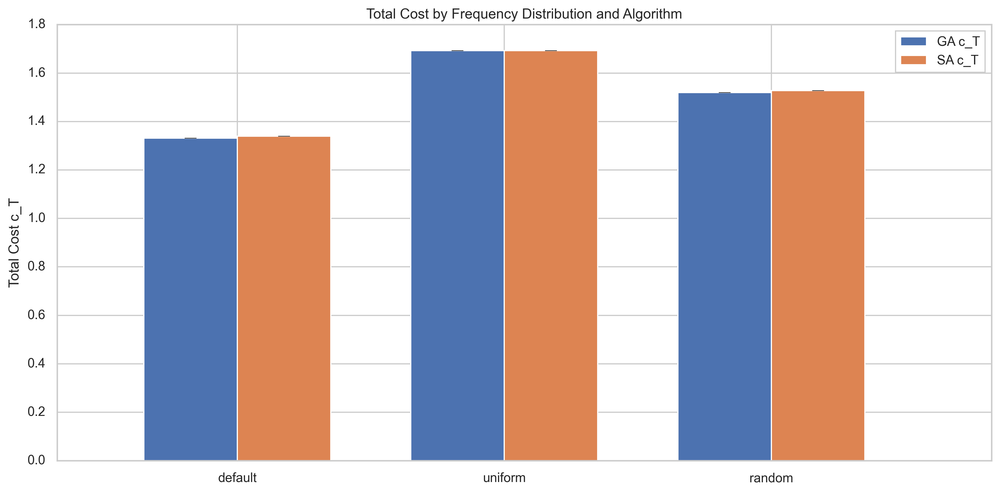

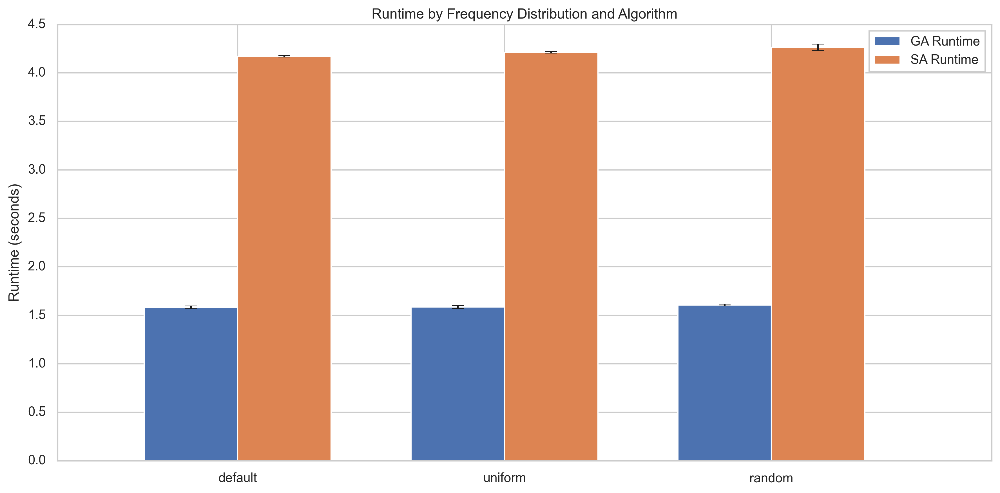

In [97]:
import time
from typing import Set, List, Tuple, Dict
import networkx as nx
import matplotlib.pyplot as plt
import random
import numpy as np
import logging

# ----------------------------
# Function Definitions
# ----------------------------

def assign_ids(concepts_lattice: List[Tuple[Set[str], Tuple[str, ...]]]) -> List[Tuple[str, frozenset, frozenset]]:
    """
    Assigns unique IDs to each concept in the lattice.

    Returns:
    - List of tuples: (ID, extent, intent)
    """
    assigned_concepts = []
    for idx, (extent, intent) in enumerate(concepts_lattice, start=1):
        concept_id = f's{idx}'
        assigned_concepts.append((concept_id, frozenset(extent), frozenset(intent)))
    return assigned_concepts

def build_hasse_diagram(assigned_concepts: List[Tuple[str, frozenset, frozenset]]) -> nx.DiGraph:
    """
    Builds a directed Hasse diagram graph where each node is a concept ID.
    Edges point from a concept to its immediate subconcepts.

    Returns:
    - Directed Graph (networkx.DiGraph)
    """
    DG = nx.DiGraph()
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}

    # Initialize nodes
    for cid, _, _ in assigned_concepts:
        DG.add_node(cid)

    # For each concept, find its immediate subconcepts
    for cid_c, _, intent_c in assigned_concepts:
        # Potential subconcepts are those with intents that are supersets of intent_c and not equal
        potential_subconcepts = [(cid_d, intent_d) for cid_d, _, intent_d in assigned_concepts
                                 if intent_d != intent_c and intent_d.issuperset(intent_c)]

        # Now, for each potential subconcept, check if it's an immediate subconcept
        for cid_d, intent_d in potential_subconcepts:
            # There should be no concept intent_e such that intent_c ⊂ intent_e ⊂ intent_d
            is_immediate = True
            for cid_e, _, intent_e in assigned_concepts:
                if intent_e != intent_c and intent_e != intent_d:
                    if intent_e.issuperset(intent_c) and intent_e.issubset(intent_d):
                        is_immediate = False
                        break
            if is_immediate:
                # Add edge from cid_c to cid_d
                DG.add_edge(cid_c, cid_d)

    return DG

def find_attribute_concepts(assigned_concepts: List[Tuple[str, frozenset, frozenset]], 
                           all_attributes: Set[str],
                           exclude_concepts: Set[str]) -> Dict[str, str]:
    """
    Finds the attribute concepts s_{A_i} for each attribute A_i in all_attributes,
    excluding any concepts in exclude_concepts.

    Returns:
    - Dictionary mapping attribute A_i to concept ID of s_{A_i}
    """
    attribute_concepts = {}
    for A_i in all_attributes:
        # Find concepts where A_i is in intent and not excluded
        concepts_with_Ai = [(cid, intent) for cid, _, intent in assigned_concepts 
                            if A_i in intent and cid not in exclude_concepts]
        if not concepts_with_Ai:
            continue  # No concepts with A_i in intent
        # Find minimal intent size
        min_intent_size = min(len(intent) for cid, intent in concepts_with_Ai)
        # Select concepts with minimal intent size
        minimal_concepts = [(cid, intent) for cid, intent in concepts_with_Ai 
                            if len(intent) == min_intent_size]
        # If multiple concepts, pick one (e.g., first)
        cid_min, _ = minimal_concepts[0]
        attribute_concepts[A_i] = cid_min
    return attribute_concepts

def generate_weighted_frequencies(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                                  C_M: Set[str],
                                  exclude_concepts: Set[str],
                                  distribution: str = 'default',
                                  seed_value: int = 42) -> Dict[str, float]:
    """
    Generates weighted frequency values for each concept based on the specified distribution.
    Core concepts (attributes and randomly selected) are assigned higher frequencies.
    Other concepts are assigned lower frequencies.

    Parameters:
    - assigned_concepts: List of all assigned concepts with IDs.
    - C_M: Core concepts subset.
    - exclude_concepts: Set of concepts to exclude from processing.
    - distribution: Type of frequency distribution ('default', 'uniform', 'random').
    - seed_value: Seed for random number generator for reproducibility.

    Returns:
    - Dictionary mapping concept IDs to their frequencies.
    """
    random.seed(seed_value)
    frequencies = {}
    total = 0.0

    if distribution == 'default':
        for cid, _, intent in assigned_concepts:
            if cid in exclude_concepts:
                continue  # Skip universal and empty concepts
            if cid in C_M:
                # Assign higher frequency range for core concepts
                freq = random.uniform(0.4, 1.0)  # Adjusted range for core concepts
            else:
                # Assign lower frequency range for non-core concepts
                freq = random.uniform(0.05, 0.3)  # Adjusted range for non-core concepts
            frequencies[cid] = freq
            total += freq
    elif distribution == 'uniform':
        for cid, _, intent in assigned_concepts:
            if cid in exclude_concepts:
                continue
            freq = 1.0  # Uniform frequency
            frequencies[cid] = freq
            total += freq
    elif distribution == 'random':
        for cid, _, intent in assigned_concepts:
            if cid in exclude_concepts:
                continue
            freq = random.uniform(0.05, 1.0)  # Completely random frequencies
            frequencies[cid] = freq
            total += freq
    else:
        raise ValueError("Unsupported distribution type. Choose from 'default', 'uniform', 'random'.")

    # Normalize frequencies to sum to 1
    for cid in frequencies:
        frequencies[cid] /= total

    return frequencies

def assign_words_to_core_concepts(C_M: Set[str], 
                                  assigned_concepts: List[Tuple[str, frozenset, frozenset]], 
                                  attribute_to_cid: Dict[str, str], 
                                  P_s: Dict[str, float]) -> Dict[str, str]:
    """
    Assigns unique words to concepts in the core concepts C_M.
    """
    C_M_word_map = {}
    used_words = set()

    # Map from concept ID to intent and extent
    cid_to_intent = {cid: intent for cid, _, intent in assigned_concepts}
    cid_to_extent = {cid: extent for cid, extent, _ in assigned_concepts}

    # Assign words to attribute concepts
    for A_i, cid in attribute_to_cid.items():
        C_M_word_map[cid] = A_i
        used_words.add(A_i)

    # Identify randomly selected core concepts (C_M excluding attribute concepts)
    attribute_concept_ids = set(attribute_to_cid.values())
    random_core_concepts = C_M - attribute_concept_ids

    # If there are randomly selected core concepts, assign words based on frequency
    if random_core_concepts:
        # Sort randomly selected core concepts based on descending frequency
        sorted_random_C_M = sorted(random_core_concepts, key=lambda cid: P_s.get(cid, 0), reverse=True)

        extra_word_counter = 1

        for cid in sorted_random_C_M:
            extent = cid_to_extent[cid]
            intent = cid_to_intent[cid]
            # Prefer words from the intent
            possible_words = sorted(intent)
            # If intent is empty, use words from extent
            if not possible_words:
                possible_words = sorted(extent)
            # Assign the first available word not already used
            assigned = False
            for word in possible_words:
                if word not in used_words:
                    C_M_word_map[cid] = word
                    used_words.add(word)
                    assigned = True
                    break
            if not assigned:
                # If all words in intent and extent are used, assign any new unique word
                word = f'word{extra_word_counter}'
                extra_word_counter += 1
                C_M_word_map[cid] = word
                used_words.add(word)
    return C_M_word_map

def calculate_costs(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                   DG: nx.DiGraph,
                   C_M: Set[str],
                   id_to_intent: Dict[str, frozenset],
                   alpha_p: int = 1,
                   alpha_c: int = 2,
                   exclude_concepts: Set[str] = set(),
                   verbose: bool = False) -> Tuple[Dict[str, float], Dict[str, Tuple[str, str, Set[str]]]]:
    """
    Calculates the generation cost c(s) for each concept and identifies the minimal cost paths.

    Parameters:
    - assigned_concepts: List of all assigned concepts with IDs.
    - DG: Directed Hasse diagram graph.
    - C_M: Core concepts subset.
    - id_to_intent: Mapping from concept ID to intent.
    - alpha_p: Cost parameter for superconcept paths.
    - alpha_c: Cost parameter for subconcept paths.
    - exclude_concepts: Set of concepts to exclude from processing.
    - verbose: If True, prints detailed tracing information.

    Returns:
    - Tuple containing:
        - Dictionary mapping concept IDs to their costs.
        - Dictionary mapping concept IDs to their minimal cost path information.
    """
    c = {}
    min_cost_paths = {}  # To store minimal cost path info for each concept

    for cid, _, intent_s in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts
        if verbose:
            print(f"\nProcessing Concept {cid} with Intent: {set(intent_s)}")
        if cid in C_M:
            c_s = 1  # Single word representation
            c[cid] = c_s
            if verbose:
                print(f"  {cid} is in C_M. c({cid}) = {c_s}")
            min_cost_paths[cid] = ('core_concept', cid, set())
            continue
        # Initialize min_cost to a large value
        min_cost = float('inf')
        min_path = None  # To store minimal cost path info
        # Find nearest superconcepts in C_M
        superconcepts_in_C_M = set(nx.ancestors(DG, cid)).intersection(C_M)
        if superconcepts_in_C_M:
            # Reduce to nearest superconcepts in C_M
            nearest_superconcepts = []
            min_length = float('inf')
            for super_cid in superconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=super_cid, target=cid)
                    if length < min_length:
                        min_length = length
                        nearest_superconcepts = [super_cid]
                    elif length == min_length:
                        nearest_superconcepts.append(super_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest superconcepts in C_M: {sorted(nearest_superconcepts)}")
            for super_cid in nearest_superconcepts:
                # Compute cost via superconcept
                intent_s_p = id_to_intent[super_cid]
                A_r = intent_s - intent_s_p  # Remaining attributes
                cost_p = alpha_p * (1 + len(A_r))
                if verbose:
                    print(f"    Via Superconcept {super_cid}:")
                    print(f"      Attributes covered by {super_cid}: {intent_s_p}")
                    print(f"      Remaining Attributes to Add: {A_r}")
                    print(f"      Cost: {alpha_p} * (1 + {len(A_r)}) = {cost_p}")
                if cost_p < min_cost:
                    min_cost = cost_p
                    min_path = ('superconcept', super_cid, A_r)
        else:
            if verbose:
                print("  No superconcepts in C_M.")

        # Find nearest subconcepts in C_M
        subconcepts_in_C_M = set(nx.descendants(DG, cid)).intersection(C_M)
        if subconcepts_in_C_M:
            # Reduce to nearest subconcepts in C_M
            nearest_subconcepts = []
            min_length = float('inf')
            for sub_cid in subconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=cid, target=sub_cid)
                    if length < min_length:
                        min_length = length
                        nearest_subconcepts = [sub_cid]
                    elif length == min_length:
                        nearest_subconcepts.append(sub_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest subconcepts in C_M: {sorted(nearest_subconcepts)}")
            for sub_cid in nearest_subconcepts:
                # Compute cost via subconcept
                intent_s_c = id_to_intent[sub_cid]
                A_e = intent_s_c - intent_s  # Extra attributes to remove
                cost_c = alpha_c * (1 + len(A_e))
                if verbose:
                    print(f"    Via Subconcept {sub_cid}:")
                    print(f"      Attributes covered by {sub_cid}: {intent_s_c}")
                    print(f"      Extra Attributes to Remove: {A_e}")
                    print(f"      Cost: {alpha_c} * (1 + {len(A_e)}) = {cost_c}")
                if cost_c < min_cost:
                    min_cost = cost_c
                    min_path = ('subconcept', sub_cid, A_e)
        else:
            if verbose:
                print("  No subconcepts in C_M.")

        if min_cost == float('inf'):
            # No paths via C_M, assign default cost
            c_s = alpha_p * len(intent_s)
            if verbose:
                print(f"  No paths via C_M. Assigning default cost: c({cid}) = {c_s}")
            min_cost_paths[cid] = ('default', '', intent_s)
        else:
            c_s = min_cost
            if verbose:
                print(f"  Minimal Cost for {cid}: c({cid}) = {c_s}")
            min_cost_paths[cid] = min_path

        c[cid] = c_s

    return c, min_cost_paths

def genetic_algorithm(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                      DG: nx.DiGraph,
                      exclude_concepts: Set[str],
                      id_to_intent: Dict[str, frozenset],
                      P_s: Dict[str, float],
                      attribute_to_cid: Dict[str, str],
                      total_concepts: List[str],
                      pop_size: int = 50,
                      num_generations: int = 100,
                      mutation_rate: float = 0.1,
                      alpha_p: int = 1,
                      alpha_c: int = 2,
                      desired_percentage: float = 0.50,
                      seed_value: int = 42,
                      elitism_rate: float = 0.05) -> Tuple[Set[str], float]:
    """
    Runs the genetic algorithm to find the optimal subset C_M.
    Returns the best individual and its fitness.
    """
    random.seed(seed_value)
    np.random.seed(seed_value)

    # Calculate elite count
    elite_count = max(1, int(elitism_rate * pop_size))

    attribute_concept_ids = set(attribute_to_cid.values())
    total_concepts_set = set(total_concepts) - exclude_concepts

    # Calculate number of additional concepts to select (excluding attribute concepts)
    num_additional_concepts = int(round(desired_percentage * len(total_concepts_set - attribute_concept_ids)))
    # Ensure we don't select more concepts than are available
    num_additional_concepts = min(num_additional_concepts, len(total_concepts_set - attribute_concept_ids))

    # Total number of concepts to select (size of C_M)
    total_concepts_to_select = len(attribute_concept_ids) + num_additional_concepts

    # Initialize population
    population = initialize_population(
        pop_size=pop_size,
        num_additional_concepts=num_additional_concepts,
        attribute_concept_ids=attribute_concept_ids,
        exclude_concepts=exclude_concepts,
        total_concepts=total_concepts
    )

    best_fitness = float('inf')
    best_individual = None

    for generation in range(num_generations):
        fitness_scores = [fitness_function(
            individual, assigned_concepts, DG, exclude_concepts, id_to_intent, P_s, attribute_to_cid,
            alpha_p, alpha_c) for individual in population]

        # Identify elite individuals
        elite_indices = np.argsort(fitness_scores)[:elite_count]
        elites = [population[i] for i in elite_indices]
        elite_fitness = [fitness_scores[i] for i in elite_indices]

        # Update best individual
        if elite_fitness[0] < best_fitness:
            best_fitness = elite_fitness[0]
            best_individual = elites[0]

        # Selection
        parents = selection(population, fitness_scores, num_parents=pop_size // 2)

        # Crossover and Mutation to create new population
        offspring = []
        eligible_concepts = set(total_concepts_set) - attribute_concept_ids
        while len(offspring) < pop_size - elite_count:
            parent1, parent2 = random.sample(parents, 2)
            child = crossover(parent1, parent2, attribute_concept_ids)
            child = mutation(child, mutation_rate, eligible_concepts, attribute_concept_ids)
            offspring.append(child)

        # Combine elites with offspring to form the new population
        population = elites + offspring

    return best_individual, best_fitness

def simulated_annealing(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                        DG: nx.DiGraph,
                        exclude_concepts: Set[str],
                        id_to_intent: Dict[str, frozenset],
                        P_s: Dict[str, float],
                        attribute_to_cid: Dict[str, str],
                        total_concepts: List[str],
                        initial_temp: float = 1000.0,
                        final_temp: float = 1.0,
                        alpha: float = 0.95,
                        num_iterations: int = 100,
                        desired_percentage: float = 0.20,
                        seed_value: int = 42) -> Tuple[Set[str], float]:
    """
    Runs the simulated annealing algorithm to find the optimal subset C_M.
    Returns the best individual and its fitness.
    """
    random.seed(seed_value)
    np.random.seed(seed_value)

    attribute_concept_ids = set(attribute_to_cid.values())
    total_concepts_set = set(total_concepts) - exclude_concepts

    # Calculate number of additional concepts to select (excluding attribute concepts)
    num_additional_concepts = int(round(desired_percentage * len(total_concepts_set - attribute_concept_ids)))
    # Ensure we don't select more concepts than are available
    num_additional_concepts = min(num_additional_concepts, len(total_concepts_set - attribute_concept_ids))

    # Total number of concepts to select (size of C_M)
    total_concepts_to_select = len(attribute_concept_ids) + num_additional_concepts

    # Generate initial solution
    eligible_concepts = total_concepts_set - attribute_concept_ids
    current_solution = initial_solution(attribute_concept_ids, eligible_concepts, num_additional_concepts)
    current_fitness = fitness_function(
        C_M_candidate=current_solution,
        assigned_concepts=assigned_concepts,
        DG=DG,
        exclude_concepts=exclude_concepts,
        id_to_intent=id_to_intent,
        P_s=P_s,
        attribute_to_cid=attribute_to_cid
    )

    best_solution = set(current_solution)
    best_fitness = current_fitness

    temp = initial_temp
    iteration = 0

    while temp > final_temp:
        for _ in range(num_iterations):
            neighbor_solution = get_neighbor(current_solution, attribute_concept_ids, eligible_concepts)
            neighbor_fitness = fitness_function(
                C_M_candidate=neighbor_solution,
                assigned_concepts=assigned_concepts,
                DG=DG,
                exclude_concepts=exclude_concepts,
                id_to_intent=id_to_intent,
                P_s=P_s,
                attribute_to_cid=attribute_to_cid
            )

            delta_fitness = neighbor_fitness - current_fitness

            if delta_fitness < 0 or random.uniform(0, 1) < np.exp(-delta_fitness / temp):
                current_solution = neighbor_solution
                current_fitness = neighbor_fitness

                if current_fitness < best_fitness:
                    best_solution = set(current_solution)
                    best_fitness = current_fitness

        temp *= alpha
        iteration += 1
        print(f"Iteration {iteration}, Temperature: {temp:.4f}, Best Fitness: {best_fitness:.4f}")

    return best_solution, best_fitness

def initialize_population(pop_size: int,
                          num_additional_concepts: int,
                          attribute_concept_ids: Set[str],
                          exclude_concepts: Set[str],
                          total_concepts: List[str]) -> List[Set[str]]:
    """
    Initializes a population of individuals (subsets of concept IDs).
    Ensures diversity by random sampling.
    """
    population = []
    eligible_concepts = set(total_concepts) - attribute_concept_ids - exclude_concepts
    for _ in range(pop_size):
        individual = set(random.sample(eligible_concepts, num_additional_concepts))
        individual.update(attribute_concept_ids)
        population.append(individual)
    return population

def fitness_function(C_M_candidate: Set[str],
                     assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                     DG: nx.DiGraph,
                     exclude_concepts: Set[str],
                     id_to_intent: Dict[str, frozenset],
                     P_s: Dict[str, float],
                     attribute_to_cid: Dict[str, str],
                     alpha_p: int = 1,
                     alpha_c: int = 2) -> float:
    """
    Calculates the total expected generation cost c_M for a candidate C_M.
    """
    c_candidate, _ = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M_candidate,
        id_to_intent=id_to_intent,
        alpha_p=alpha_p,
        alpha_c=alpha_c,
        exclude_concepts=exclude_concepts,
        verbose=False
    )

    # Calculate Total Expected Generation Cost c_M
    c_M_total = 0.0
    for cid in c_candidate:
        c_s = c_candidate[cid]
        ps = P_s.get(cid, 0)
        term = c_s * ps
        c_M_total += term
    return c_M_total

def selection(population: List[Set[str]], fitness_scores: List[float], num_parents: int) -> List[Set[str]]:
    """
    Selects parents for crossover based on fitness scores using tournament selection.
    """
    parents = []
    for _ in range(num_parents):
        # Tournament selection with k=3
        candidates = random.sample(list(zip(population, fitness_scores)), k=3)
        parent = min(candidates, key=lambda x: x[1])[0]  # Select the individual with the lowest fitness
        parents.append(parent)
    return parents

def crossover(parent1: Set[str], parent2: Set[str], attribute_concept_ids: Set[str]) -> Set[str]:
    """
    Performs uniform crossover between two parents to produce an offspring.
    Ensures consistent gene ordering by sorting.
    """
    offspring = set()
    genes1 = sorted(parent1 - attribute_concept_ids)
    genes2 = sorted(parent2 - attribute_concept_ids)

    # Ensure both gene lists are of the same length by padding shorter one
    max_length = max(len(genes1), len(genes2))
    genes1.extend([None] * (max_length - len(genes1)))
    genes2.extend([None] * (max_length - len(genes2)))

    for gene1, gene2 in zip(genes1, genes2):
        if gene1 is None and gene2 is not None:
            offspring.add(gene2)
        elif gene2 is None and gene1 is not None:
            offspring.add(gene1)
        elif gene1 is not None and gene2 is not None:
            if random.random() < 0.5:
                offspring.add(gene1)
            else:
                offspring.add(gene2)
        # If both genes are None, do nothing

    # Ensure attribute concepts are included
    offspring.update(attribute_concept_ids)
    return offspring

def mutation(individual: Set[str], mutation_rate: float, eligible_concepts: Set[str], attribute_concept_ids: Set[str]) -> Set[str]:
    """
    Mutates an individual by randomly adding/removing concepts.
    """
    individual = set(individual)
    non_attribute_genes = individual - attribute_concept_ids
    for gene in list(non_attribute_genes):
        if random.random() < mutation_rate:
            individual.remove(gene)
            available_genes = eligible_concepts - individual
            if available_genes:
                new_gene = random.choice(list(available_genes))
                individual.add(new_gene)
    # Attribute concepts remain included
    individual.update(attribute_concept_ids)
    return individual

def initial_solution(attribute_concept_ids: Set[str],
                     eligible_concepts: Set[str],
                     num_additional_concepts: int) -> Set[str]:
    """
    Generates an initial solution (subset of concept IDs).
    """
    solution = set(random.sample(eligible_concepts, num_additional_concepts))
    solution.update(attribute_concept_ids)
    return solution

def get_neighbor(solution: Set[str],
                attribute_concept_ids: Set[str],
                eligible_concepts: Set[str]) -> Set[str]:
    """
    Generates a neighboring solution by swapping a concept.
    """
    neighbor = set(solution)
    non_attribute_genes = neighbor - attribute_concept_ids
    if not non_attribute_genes:
        return neighbor  # No non-attribute genes to swap

    # Remove a random non-attribute concept
    gene_to_remove = random.choice(list(non_attribute_genes))
    neighbor.remove(gene_to_remove)

    # Add a new concept not in the current solution
    available_genes = eligible_concepts - neighbor - attribute_concept_ids
    if available_genes:
        gene_to_add = random.choice(list(available_genes))
        neighbor.add(gene_to_add)
    else:
        # If no available genes, re-add the removed gene
        neighbor.add(gene_to_remove)

    return neighbor

def visualize_hasse_diagram(DG: nx.DiGraph, 
                            id_to_intent: Dict[str, frozenset], 
                            C_M_word_map: Dict[str, str], 
                            C_M: Set[str], 
                            exclude_concepts: Set[str], 
                            output_filename: str = 'concept_lattice_hasse.png', 
                            dpi: int = 300):
    """
    Visualizes the Hasse diagram of the concept lattice using NetworkX and PyGraphviz.
    The graph is set to display from Top to Bottom (rankdir=TB).
    """
    try:
        import pygraphviz
        from networkx.drawing.nx_agraph import to_agraph
    except ImportError:
        print("PyGraphviz is not installed. Please install it to visualize the Hasse diagram.")
        return

    # Initialize PyGraphviz AGraph
    A = to_agraph(DG)

    # Set graph attributes for Top to Bottom direction
    A.graph_attr.update(rankdir='TB')  # Top to Bottom

    # Apply hierarchical layout
    A.layout(prog='dot')  # 'dot' is suitable for hierarchical layouts

    # Customize node styles
    for node in A.nodes():
        cid = node.name
        word = C_M_word_map.get(cid, '')
        if cid in C_M:
            node.attr['color'] = 'red'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightcoral'
            node.attr['label'] = f"{cid}\n{word}"
        elif cid in exclude_concepts:
            node.attr['color'] = 'gray'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightgray'
            # node.attr['label'] = f"{cid}\n{set(id_to_intent[cid])}"
        else:
            node.attr['color'] = 'black'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightblue'
            node.attr['label'] = f"{cid}\n{set(id_to_intent[cid])}"
        node.attr['shape'] = 'ellipse'
        node.attr['fontsize'] = '10'

    # Customize edge styles
    for edge in A.edges():
        edge.attr['color'] = 'gray'
        edge.attr['arrowsize'] = '0.5'

    # Render the graph to a file with high resolution
    A.draw(output_filename, format='png', prog='dot')

    # Display the graph using matplotlib with increased figure size for better clarity
    plt.figure(figsize=(16, 12), dpi=dpi)  # Increased figure size and DPI
    img = plt.imread(output_filename)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Concept Lattice Hasse Diagram with Core Concepts Highlighted", fontsize=16)
    plt.show()

def print_relationships(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                        DG: nx.DiGraph,
                        id_to_intent: Dict[str, frozenset],
                        C_M: Set[str],
                        exclude_concepts: Set[str]) -> None:
    """
    Prints all superconcepts and subconcepts in L and C_M for each concept,
    excluding the universal and empty concepts.
    """
    for cid, extent, intent in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts

        print(f"Concept ID: {cid}")
        print("-" * 40)
        print(f"  Extent (Objects): {set(extent)}")
        print(f"  Intent (Attributes): {set(intent)}\n")

        # All superconcepts in L, excluding universal and empty concepts
        all_super_in_L = nx.ancestors(DG, cid) - exclude_concepts
        if all_super_in_L:
            print("  All Superconcepts in L:")
            for super_id in sorted(all_super_in_L, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("  All Superconcepts in L: None")

        # All superconcepts in C_M
        all_super_in_C_M = all_super_in_L.intersection(C_M)
        if all_super_in_C_M:
            print("\n  All Superconcepts in C_M:")
            for super_id in sorted(all_super_in_C_M, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("\n  All Superconcepts in C_M: None")

        # All subconcepts in L, excluding universal and empty concepts
        all_sub_in_L = nx.descendants(DG, cid) - exclude_concepts
        if all_sub_in_L:
            print("\n  All Subconcepts in L:")
            for sub_id in sorted(all_sub_in_L, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in L: None")

        # All subconcepts in C_M
        all_sub_in_C_M = all_sub_in_L.intersection(C_M)
        if all_sub_in_C_M:
            print("\n  All Subconcepts in C_M:")
            for sub_id in sorted(all_sub_in_C_M, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in C_M: None")

        print("-" * 40 + "\n")

# ----------------------------
# Testing Functions
# ----------------------------

def run_test(concept_lattice: List[Tuple[Set[str], Tuple[str, ...]]],
             distribution: str,
             algorithm: str,
             num_runs: int = 3,
             **kwargs) -> Dict[str, Dict[str, float]]:
    """
    Runs the specified algorithm (GA or SA) multiple times with the given frequency distribution.
    Returns the average and standard deviation of total cost and runtime.

    Parameters:
    - concept_lattice: List of concepts represented as tuples of (extent, intent).
    - distribution: Type of frequency distribution ('default', 'uniform', 'random').
    - algorithm: Algorithm to run ('GA' or 'SA').
    - num_runs: Number of runs to perform for averaging.
    - kwargs: Additional parameters for the algorithms.

    Returns:
    - Dictionary containing average and std deviation of c_T and runtime.
    """
    # Assign unique IDs to each concept
    assigned_concepts = assign_ids(concept_lattice)

    # Create mappings for easy reference
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}
    id_to_intent = {cid: intent for cid, _, intent in assigned_concepts}

    # Build directed Hasse diagram
    DG = build_hasse_diagram(assigned_concepts)  # Directed Hasse diagram

    # Build set of all objects and all attributes
    all_objects = set()
    all_attributes = set()
    for extent, intent in concept_lattice:
        all_objects.update(extent)
        all_attributes.update(intent)

    # Convert to frozensets for comparison
    all_objects = frozenset(all_objects)
    all_attributes = frozenset(all_attributes)

    # Identify the universal (top) and empty (bottom) concepts
    universal_concept_id = None
    empty_concept_id = None
    for cid, extent, intent in assigned_concepts:
        if extent == all_objects and len(intent) == 0:
            universal_concept_id = cid
        if len(extent) == 0 and intent == all_attributes:
            empty_concept_id = cid

    exclude_concepts = {universal_concept_id, empty_concept_id}
    exclude_concepts.discard(None)  # Remove None values if any

    # Find attribute concepts and define Core Concepts C_M
    attribute_to_cid = find_attribute_concepts(assigned_concepts, all_attributes, exclude_concepts)
    C_M_initial = set(attribute_to_cid.values())

    # Generate weighted frequencies based on distribution
    P_s = generate_weighted_frequencies(assigned_concepts, C_M_initial, exclude_concepts, distribution=distribution, seed_value=kwargs.get('seed', 42))

    # Initialize lists to store results
    c_T_list = []
    runtime_list = []

    for run in range(1, num_runs + 1):
        print(f"\nRun {run}/{num_runs} for Distribution: {distribution}, Algorithm: {algorithm}")
        # Depending on the algorithm, run GA or SA
        start_time = time.time()
        if algorithm == 'GA':
            C_M, fitness = genetic_algorithm(
                assigned_concepts=assigned_concepts,
                DG=DG,
                exclude_concepts=exclude_concepts,
                id_to_intent=id_to_intent,
                P_s=P_s,
                attribute_to_cid=attribute_to_cid,
                total_concepts=[cid for cid, _, _ in assigned_concepts],
                pop_size=kwargs.get('pop_size', 50),
                num_generations=kwargs.get('num_generations', 100),
                mutation_rate=kwargs.get('mutation_rate', 0.1),
                alpha_p=kwargs.get('alpha_p', 1),
                alpha_c=kwargs.get('alpha_c', 2),
                desired_percentage=kwargs.get('desired_percentage', 0.20),
                seed_value=kwargs.get('seed', 42 + run),  # Different seed for each run
                elitism_rate=kwargs.get('elitism_rate', 0.05)
            )
        elif algorithm == 'SA':
            C_M, fitness = simulated_annealing(
                assigned_concepts=assigned_concepts,
                DG=DG,
                exclude_concepts=exclude_concepts,
                id_to_intent=id_to_intent,
                P_s=P_s,
                attribute_to_cid=attribute_to_cid,
                total_concepts=[cid for cid, _, _ in assigned_concepts],
                initial_temp=kwargs.get('initial_temp', 1000.0),
                final_temp=kwargs.get('final_temp', 1.0),
                alpha=kwargs.get('alpha', 0.95),
                num_iterations=kwargs.get('num_iterations', 100),
                desired_percentage=kwargs.get('desired_percentage', 0.20),
                seed_value=kwargs.get('seed', 42 + run)  # Different seed for each run
            )
        else:
            raise ValueError("Unsupported algorithm. Choose 'GA' or 'SA'.")
        end_time = time.time()
        runtime = end_time - start_time

        # Calculate total cost c_T
        c, _ = calculate_costs(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M,
            id_to_intent=id_to_intent,
            alpha_p=kwargs.get('alpha_p', 1),
            alpha_c=kwargs.get('alpha_c', 2),
            exclude_concepts=exclude_concepts,
            verbose=False
        )
        c_T = sum(c.get(cid, 0) * P_s.get(cid, 0) for cid in c)

        # Store the results
        c_T_list.append(c_T)
        runtime_list.append(runtime)

        print(f"  Run {run} completed. c_T: {c_T:.4f}, Runtime: {runtime:.4f} seconds")

    # Calculate average and standard deviation
    c_T_avg = np.mean(c_T_list)
    c_T_std = np.std(c_T_list)
    runtime_avg = np.mean(runtime_list)
    runtime_std = np.std(runtime_list)

    return {
        'average_c_T': c_T_avg,
        'std_c_T': c_T_std,
        'average_runtime': runtime_avg,
        'std_runtime': runtime_std
    }

# ----------------------------
# Main Execution for Testing
# ----------------------------

if __name__ == "__main__":
    # Example Concept Lattice Data
    # Each concept is represented as a tuple: (extent, intent)
    # Replace this with your actual concept lattice data
    concepts_lattice = lattice4
    # Define frequency distributions to test
    distributions = ['default', 'uniform', 'random']

    # Define algorithms to test
    algorithms = ['GA', 'SA']

    # Number of runs per combination
    num_runs = 3

    # Initialize results dictionary
    results = {dist: {alg: {'average_c_T': None, 'std_c_T': None, 
                            'average_runtime': None, 'std_runtime': None} 
                    for alg in algorithms} for dist in distributions}

    # Run tests
    for dist in distributions:
        for alg in algorithms:
            stats = run_test(
                concept_lattice=concepts_lattice,
                distribution=dist,
                algorithm=alg,
                num_runs=num_runs,
                seed=42  # Base seed for reproducibility
            )
            results[dist][alg]['average_c_T'] = stats['average_c_T']
            results[dist][alg]['std_c_T'] = stats['std_c_T']
            results[dist][alg]['average_runtime'] = stats['average_runtime']
            results[dist][alg]['std_runtime'] = stats['std_runtime']
            print(f"\nDistribution: {dist}, Algorithm: {alg}")
            print(f"  Average c_T: {stats['average_c_T']:.4f} ± {stats['std_c_T']:.4f}")
            print(f"  Average Runtime: {stats['average_runtime']:.4f} ± {stats['std_runtime']:.4f} seconds")

    # Display results in a table
    print("\n" + "="*80 + "\n")
    print("Comparison of Frequency Distributions on GA and SA with Multiple Runs")
    print("-" * 80)
    header = f"{'Distribution':<12} | {'Algorithm':<9} | {'Avg c_T':<10} | {'Std c_T':<10} | {'Avg Runtime (s)':<15} | {'Std Runtime (s)':<15}"
    print(header)
    print("-" * 80)
    for dist in distributions:
        for alg in algorithms:
            avg_c_T = results[dist][alg]['average_c_T']
            std_c_T = results[dist][alg]['std_c_T']
            avg_runtime = results[dist][alg]['average_runtime']
            std_runtime = results[dist][alg]['std_runtime']
            line = f"{dist:<12} | {alg:<9} | {avg_c_T:<10.4f} | {std_c_T:<10.4f} | {avg_runtime:<15.4f} | {std_runtime:<15.4f}"
            print(line)
    print("-" * 80 + "\n")

    # Optionally, plot the results for better visualization
    import matplotlib.pyplot as plt

    # Prepare data for plotting
    c_T_avg_data = {dist: [results[dist][alg]['average_c_T'] for alg in algorithms] for dist in distributions}
    c_T_std_data = {dist: [results[dist][alg]['std_c_T'] for alg in algorithms] for dist in distributions}
    runtime_avg_data = {dist: [results[dist][alg]['average_runtime'] for alg in algorithms] for dist in distributions}
    runtime_std_data = {dist: [results[dist][alg]['std_runtime'] for alg in algorithms] for dist in distributions}

    x = np.arange(len(distributions))  # label locations
    width = 0.35  # width of the bars

    # Plot Total Cost c_T
    fig, ax = plt.subplots(figsize=(12, 6))
    for idx, alg in enumerate(algorithms):
        c_T_values = [c_T_avg_data[dist][idx] for dist in distributions]
        c_T_errors = [c_T_std_data[dist][idx] for dist in distributions]
        ax.bar(x + idx*width, c_T_values, width, yerr=c_T_errors, label=f'{alg} c_T', capsize=5)

    ax.set_ylabel('Total Cost c_T')
    ax.set_title('Total Cost by Frequency Distribution and Algorithm')
    ax.set_xticks(x + width / 2)
    ax.set_xticklabels(distributions)
    ax.legend()
    plt.tight_layout()
    plt.show()

    # Plot Runtime
    fig, ax = plt.subplots(figsize=(12, 6))
    for idx, alg in enumerate(algorithms):
        runtime_values = [runtime_avg_data[dist][idx] for dist in distributions]
        runtime_errors = [runtime_std_data[dist][idx] for dist in distributions]
        ax.bar(x + idx*width, runtime_values, width, yerr=runtime_errors, label=f'{alg} Runtime', capsize=5)

    ax.set_ylabel('Runtime (seconds)')
    ax.set_title('Runtime by Frequency Distribution and Algorithm')
    ax.set_xticks(x + width / 2)
    ax.set_xticklabels(distributions)
    ax.legend()
    plt.tight_layout()
    plt.show()



Run 1/3 for Distribution: default, Algorithm: GA
  Run 1 completed. c_T: 1.3310, Runtime: 1.6206 seconds
  Selected C_M: {'s36', 's38', 's37', 's39', 's34', 's20', 's32', 's35', 's10', 's22', 's33', 's40', 's30', 's2'}

Run 2/3 for Distribution: default, Algorithm: GA
  Run 2 completed. c_T: 1.3310, Runtime: 1.5987 seconds
  Selected C_M: {'s36', 's38', 's37', 's39', 's34', 's20', 's32', 's35', 's10', 's22', 's33', 's40', 's30', 's2'}

Run 3/3 for Distribution: default, Algorithm: GA
  Run 3 completed. c_T: 1.3310, Runtime: 1.6166 seconds
  Selected C_M: {'s36', 's38', 's37', 's39', 's34', 's20', 's32', 's35', 's10', 's22', 's33', 's40', 's30', 's2'}

Distribution: default, Algorithm: GA
  Average c_T: 1.3310 ± 0.0000
  Median c_T: 1.3310
  Min c_T: 1.3310
  Max c_T: 1.3310
  Average Runtime: 1.6120 ± 0.0095 seconds
  Median Runtime: 1.6166 seconds
  Min Runtime: 1.5987 seconds
  Max Runtime: 1.6206 seconds
  C_M Distribution: {frozenset({'s10', 's22', 's36', 's38', 's37', 's33', 's39

Iteration 130, Temperature: 1.2708, Best Fitness: 1.3392
Iteration 131, Temperature: 1.2072, Best Fitness: 1.3392
Iteration 132, Temperature: 1.1469, Best Fitness: 1.3392
Iteration 133, Temperature: 1.0895, Best Fitness: 1.3392
Iteration 134, Temperature: 1.0351, Best Fitness: 1.3392
Iteration 135, Temperature: 0.9833, Best Fitness: 1.3392
  Run 1 completed. c_T: 1.3392, Runtime: 4.3344 seconds
  Selected C_M: {'s36', 's23', 's38', 's37', 's31', 's33', 's39', 's34', 's40', 's30', 's20', 's19', 's32', 's35'}

Run 2/3 for Distribution: default, Algorithm: SA
Iteration 1, Temperature: 950.0000, Best Fitness: 1.3642
Iteration 2, Temperature: 902.5000, Best Fitness: 1.3642
Iteration 3, Temperature: 857.3750, Best Fitness: 1.3520
Iteration 4, Temperature: 814.5062, Best Fitness: 1.3520
Iteration 5, Temperature: 773.7809, Best Fitness: 1.3520
Iteration 6, Temperature: 735.0919, Best Fitness: 1.3470
Iteration 7, Temperature: 698.3373, Best Fitness: 1.3470
Iteration 8, Temperature: 663.4204, Be

Iteration 2, Temperature: 902.5000, Best Fitness: 1.3642
Iteration 3, Temperature: 857.3750, Best Fitness: 1.3520
Iteration 4, Temperature: 814.5062, Best Fitness: 1.3520
Iteration 5, Temperature: 773.7809, Best Fitness: 1.3520
Iteration 6, Temperature: 735.0919, Best Fitness: 1.3470
Iteration 7, Temperature: 698.3373, Best Fitness: 1.3470
Iteration 8, Temperature: 663.4204, Best Fitness: 1.3470
Iteration 9, Temperature: 630.2494, Best Fitness: 1.3470
Iteration 10, Temperature: 598.7369, Best Fitness: 1.3470
Iteration 11, Temperature: 568.8001, Best Fitness: 1.3470
Iteration 12, Temperature: 540.3601, Best Fitness: 1.3470
Iteration 13, Temperature: 513.3421, Best Fitness: 1.3470
Iteration 14, Temperature: 487.6750, Best Fitness: 1.3470
Iteration 15, Temperature: 463.2912, Best Fitness: 1.3470
Iteration 16, Temperature: 440.1267, Best Fitness: 1.3470
Iteration 17, Temperature: 418.1203, Best Fitness: 1.3470
Iteration 18, Temperature: 397.2143, Best Fitness: 1.3470
Iteration 19, Temperat

  Run 1 completed. c_T: 1.6923, Runtime: 1.6002 seconds
  Selected C_M: {'s36', 's23', 's38', 's37', 's39', 's34', 's32', 's35', 's15', 's33', 's9', 's40', 's30', 's29'}

Run 2/3 for Distribution: uniform, Algorithm: GA
  Run 2 completed. c_T: 1.6923, Runtime: 1.6163 seconds
  Selected C_M: {'s36', 's23', 's38', 's37', 's39', 's34', 's32', 's35', 's15', 's33', 's9', 's40', 's30', 's29'}

Run 3/3 for Distribution: uniform, Algorithm: GA
  Run 3 completed. c_T: 1.6923, Runtime: 1.5938 seconds
  Selected C_M: {'s36', 's23', 's38', 's37', 's39', 's34', 's32', 's35', 's15', 's33', 's9', 's40', 's30', 's29'}

Distribution: uniform, Algorithm: GA
  Average c_T: 1.6923 ± 0.0000
  Median c_T: 1.6923
  Min c_T: 1.6923
  Max c_T: 1.6923
  Average Runtime: 1.6034 ± 0.0095 seconds
  Median Runtime: 1.6002 seconds
  Min Runtime: 1.5938 seconds
  Max Runtime: 1.6163 seconds
  C_M Distribution: {frozenset({'s36', 's23', 's15', 's38', 's37', 's33', 's39', 's9', 's34', 's40', 's30', 's29', 's32', 's35'}

Iteration 130, Temperature: 1.2708, Best Fitness: 1.6923
Iteration 131, Temperature: 1.2072, Best Fitness: 1.6923
Iteration 132, Temperature: 1.1469, Best Fitness: 1.6923
Iteration 133, Temperature: 1.0895, Best Fitness: 1.6923
Iteration 134, Temperature: 1.0351, Best Fitness: 1.6923
Iteration 135, Temperature: 0.9833, Best Fitness: 1.6923
  Run 1 completed. c_T: 1.6923, Runtime: 4.3278 seconds
  Selected C_M: {'s36', 's38', 's37', 's33', 's39', 's9', 's34', 's40', 's30', 's29', 's11', 's32', 's12', 's35'}

Run 2/3 for Distribution: uniform, Algorithm: SA
Iteration 1, Temperature: 950.0000, Best Fitness: 1.7692
Iteration 2, Temperature: 902.5000, Best Fitness: 1.7692
Iteration 3, Temperature: 857.3750, Best Fitness: 1.7436
Iteration 4, Temperature: 814.5062, Best Fitness: 1.7179
Iteration 5, Temperature: 773.7809, Best Fitness: 1.7179
Iteration 6, Temperature: 735.0919, Best Fitness: 1.7179
Iteration 7, Temperature: 698.3373, Best Fitness: 1.7179
Iteration 8, Temperature: 663.4204, Bes

Iteration 1, Temperature: 950.0000, Best Fitness: 1.7692
Iteration 2, Temperature: 902.5000, Best Fitness: 1.7692
Iteration 3, Temperature: 857.3750, Best Fitness: 1.7436
Iteration 4, Temperature: 814.5062, Best Fitness: 1.7179
Iteration 5, Temperature: 773.7809, Best Fitness: 1.7179
Iteration 6, Temperature: 735.0919, Best Fitness: 1.7179
Iteration 7, Temperature: 698.3373, Best Fitness: 1.7179
Iteration 8, Temperature: 663.4204, Best Fitness: 1.7179
Iteration 9, Temperature: 630.2494, Best Fitness: 1.7179
Iteration 10, Temperature: 598.7369, Best Fitness: 1.7179
Iteration 11, Temperature: 568.8001, Best Fitness: 1.7179
Iteration 12, Temperature: 540.3601, Best Fitness: 1.7179
Iteration 13, Temperature: 513.3421, Best Fitness: 1.7179
Iteration 14, Temperature: 487.6750, Best Fitness: 1.7179
Iteration 15, Temperature: 463.2912, Best Fitness: 1.7179
Iteration 16, Temperature: 440.1267, Best Fitness: 1.7179
Iteration 17, Temperature: 418.1203, Best Fitness: 1.7179
Iteration 18, Temperatu

  Run 1 completed. c_T: 1.5189, Runtime: 1.6128 seconds
  Selected C_M: {'s36', 's38', 's37', 's39', 's34', 's20', 's32', 's35', 's10', 's26', 's33', 's40', 's2', 's30'}

Run 2/3 for Distribution: random, Algorithm: GA
  Run 2 completed. c_T: 1.5189, Runtime: 1.5989 seconds
  Selected C_M: {'s36', 's38', 's37', 's39', 's34', 's20', 's32', 's35', 's10', 's26', 's33', 's40', 's2', 's30'}

Run 3/3 for Distribution: random, Algorithm: GA
  Run 3 completed. c_T: 1.5189, Runtime: 1.6266 seconds
  Selected C_M: {'s36', 's38', 's37', 's39', 's34', 's20', 's32', 's35', 's10', 's26', 's33', 's40', 's2', 's30'}

Distribution: random, Algorithm: GA
  Average c_T: 1.5189 ± 0.0000
  Median c_T: 1.5189
  Min c_T: 1.5189
  Max c_T: 1.5189
  Average Runtime: 1.6128 ± 0.0113 seconds
  Median Runtime: 1.6128 seconds
  Min Runtime: 1.5989 seconds
  Max Runtime: 1.6266 seconds
  C_M Distribution: {frozenset({'s10', 's26', 's36', 's38', 's37', 's33', 's39', 's34', 's40', 's2', 's30', 's20', 's32', 's35'}): 

Iteration 127, Temperature: 1.4822, Best Fitness: 1.5279
Iteration 128, Temperature: 1.4081, Best Fitness: 1.5279
Iteration 129, Temperature: 1.3377, Best Fitness: 1.5279
Iteration 130, Temperature: 1.2708, Best Fitness: 1.5279
Iteration 131, Temperature: 1.2072, Best Fitness: 1.5279
Iteration 132, Temperature: 1.1469, Best Fitness: 1.5279
Iteration 133, Temperature: 1.0895, Best Fitness: 1.5279
Iteration 134, Temperature: 1.0351, Best Fitness: 1.5279
Iteration 135, Temperature: 0.9833, Best Fitness: 1.5279
  Run 1 completed. c_T: 1.5279, Runtime: 4.3112 seconds
  Selected C_M: {'s22', 's36', 's23', 's38', 's37', 's33', 's39', 's34', 's40', 's2', 's30', 's20', 's32', 's35'}

Run 2/3 for Distribution: random, Algorithm: SA
Iteration 1, Temperature: 950.0000, Best Fitness: 1.5760
Iteration 2, Temperature: 902.5000, Best Fitness: 1.5760
Iteration 3, Temperature: 857.3750, Best Fitness: 1.5760
Iteration 4, Temperature: 814.5062, Best Fitness: 1.5760
Iteration 5, Temperature: 773.7809, Best

Iteration 1, Temperature: 950.0000, Best Fitness: 1.5760
Iteration 2, Temperature: 902.5000, Best Fitness: 1.5760
Iteration 3, Temperature: 857.3750, Best Fitness: 1.5760
Iteration 4, Temperature: 814.5062, Best Fitness: 1.5760
Iteration 5, Temperature: 773.7809, Best Fitness: 1.5738
Iteration 6, Temperature: 735.0919, Best Fitness: 1.5738
Iteration 7, Temperature: 698.3373, Best Fitness: 1.5652
Iteration 8, Temperature: 663.4204, Best Fitness: 1.5652
Iteration 9, Temperature: 630.2494, Best Fitness: 1.5652
Iteration 10, Temperature: 598.7369, Best Fitness: 1.5652
Iteration 11, Temperature: 568.8001, Best Fitness: 1.5652
Iteration 12, Temperature: 540.3601, Best Fitness: 1.5652
Iteration 13, Temperature: 513.3421, Best Fitness: 1.5473
Iteration 14, Temperature: 487.6750, Best Fitness: 1.5473
Iteration 15, Temperature: 463.2912, Best Fitness: 1.5473
Iteration 16, Temperature: 440.1267, Best Fitness: 1.5473
Iteration 17, Temperature: 418.1203, Best Fitness: 1.5473
Iteration 18, Temperatu

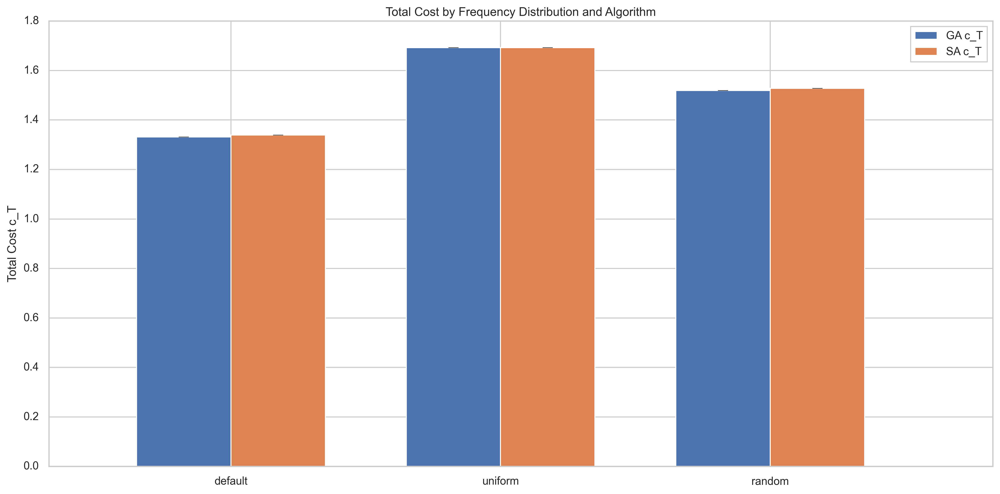

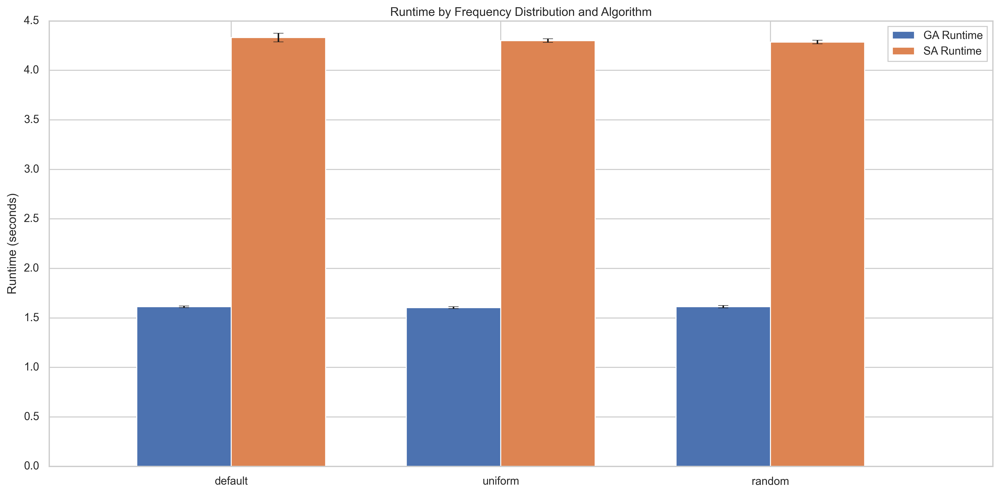

In [101]:
import time
from typing import Set, List, Tuple, Dict
import networkx as nx
import matplotlib.pyplot as plt
import random
import numpy as np
import logging
from collections import defaultdict

# ----------------------------
# Function Definitions
# ----------------------------

def assign_ids(concepts_lattice: List[Tuple[Set[str], Tuple[str, ...]]]) -> List[Tuple[str, frozenset, frozenset]]:
    """
    Assigns unique IDs to each concept in the lattice.

    Returns:
    - List of tuples: (ID, extent, intent)
    """
    assigned_concepts = []
    for idx, (extent, intent) in enumerate(concepts_lattice, start=1):
        concept_id = f's{idx}'
        assigned_concepts.append((concept_id, frozenset(extent), frozenset(intent)))
    return assigned_concepts

def build_hasse_diagram(assigned_concepts: List[Tuple[str, frozenset, frozenset]]) -> nx.DiGraph:
    """
    Builds a directed Hasse diagram graph where each node is a concept ID.
    Edges point from a concept to its immediate subconcepts.

    Returns:
    - Directed Graph (networkx.DiGraph)
    """
    DG = nx.DiGraph()
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}

    # Initialize nodes
    for cid, _, _ in assigned_concepts:
        DG.add_node(cid)

    # For each concept, find its immediate subconcepts
    for cid_c, _, intent_c in assigned_concepts:
        # Potential subconcepts are those with intents that are supersets of intent_c and not equal
        potential_subconcepts = [(cid_d, intent_d) for cid_d, _, intent_d in assigned_concepts
                                 if intent_d != intent_c and intent_d.issuperset(intent_c)]

        # Now, for each potential subconcept, check if it's an immediate subconcept
        for cid_d, intent_d in potential_subconcepts:
            # There should be no concept intent_e such that intent_c ⊂ intent_e ⊂ intent_d
            is_immediate = True
            for cid_e, _, intent_e in assigned_concepts:
                if intent_e != intent_c and intent_e != intent_d:
                    if intent_e.issuperset(intent_c) and intent_e.issubset(intent_d):
                        is_immediate = False
                        break
            if is_immediate:
                # Add edge from cid_c to cid_d
                DG.add_edge(cid_c, cid_d)

    return DG

def find_attribute_concepts(assigned_concepts: List[Tuple[str, frozenset, frozenset]], 
                           all_attributes: Set[str],
                           exclude_concepts: Set[str]) -> Dict[str, str]:
    """
    Finds the attribute concepts s_{A_i} for each attribute A_i in all_attributes,
    excluding any concepts in exclude_concepts.

    Returns:
    - Dictionary mapping attribute A_i to concept ID of s_{A_i}
    """
    attribute_concepts = {}
    for A_i in all_attributes:
        # Find concepts where A_i is in intent and not excluded
        concepts_with_Ai = [(cid, intent) for cid, _, intent in assigned_concepts 
                            if A_i in intent and cid not in exclude_concepts]
        if not concepts_with_Ai:
            continue  # No concepts with A_i in intent
        # Find minimal intent size
        min_intent_size = min(len(intent) for cid, intent in concepts_with_Ai)
        # Select concepts with minimal intent size
        minimal_concepts = [(cid, intent) for cid, intent in concepts_with_Ai 
                            if len(intent) == min_intent_size]
        # If multiple concepts, pick one (e.g., first)
        cid_min, _ = minimal_concepts[0]
        attribute_concepts[A_i] = cid_min
    return attribute_concepts

def generate_weighted_frequencies(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                                  C_M: Set[str],
                                  exclude_concepts: Set[str],
                                  distribution: str = 'default',
                                  seed_value: int = 42) -> Dict[str, float]:
    """
    Generates weighted frequency values for each concept based on the specified distribution.
    Core concepts (attributes and randomly selected) are assigned higher frequencies.
    Other concepts are assigned lower frequencies.

    Parameters:
    - assigned_concepts: List of all assigned concepts with IDs.
    - C_M: Core concepts subset.
    - exclude_concepts: Set of concepts to exclude from processing.
    - distribution: Type of frequency distribution ('default', 'uniform', 'random').
    - seed_value: Seed for random number generator for reproducibility.

    Returns:
    - Dictionary mapping concept IDs to their frequencies.
    """
    random.seed(seed_value)
    frequencies = {}
    total = 0.0

    if distribution == 'default':
        for cid, _, intent in assigned_concepts:
            if cid in exclude_concepts:
                continue  # Skip universal and empty concepts
            if cid in C_M:
                # Assign higher frequency range for core concepts
                freq = random.uniform(0.4, 1.0)  # Adjusted range for core concepts
            else:
                # Assign lower frequency range for non-core concepts
                freq = random.uniform(0.05, 0.3)  # Adjusted range for non-core concepts
            frequencies[cid] = freq
            total += freq
    elif distribution == 'uniform':
        for cid, _, intent in assigned_concepts:
            if cid in exclude_concepts:
                continue
            freq = 1.0  # Uniform frequency
            frequencies[cid] = freq
            total += freq
    elif distribution == 'random':
        for cid, _, intent in assigned_concepts:
            if cid in exclude_concepts:
                continue
            freq = random.uniform(0.05, 1.0)  # Completely random frequencies
            frequencies[cid] = freq
            total += freq
    else:
        raise ValueError("Unsupported distribution type. Choose from 'default', 'uniform', 'random'.")

    # Normalize frequencies to sum to 1
    for cid in frequencies:
        frequencies[cid] /= total

    return frequencies

def assign_words_to_core_concepts(C_M: Set[str], 
                                  assigned_concepts: List[Tuple[str, frozenset, frozenset]], 
                                  attribute_to_cid: Dict[str, str], 
                                  P_s: Dict[str, float]) -> Dict[str, str]:
    """
    Assigns unique words to concepts in the core concepts C_M.
    """
    C_M_word_map = {}
    used_words = set()

    # Map from concept ID to intent and extent
    cid_to_intent = {cid: intent for cid, _, intent in assigned_concepts}
    cid_to_extent = {cid: extent for cid, extent, _ in assigned_concepts}

    # Assign words to attribute concepts
    for A_i, cid in attribute_to_cid.items():
        C_M_word_map[cid] = A_i
        used_words.add(A_i)

    # Identify randomly selected core concepts (C_M excluding attribute concepts)
    attribute_concept_ids = set(attribute_to_cid.values())
    random_core_concepts = C_M - attribute_concept_ids

    # If there are randomly selected core concepts, assign words based on frequency
    if random_core_concepts:
        # Sort randomly selected core concepts based on descending frequency
        sorted_random_C_M = sorted(random_core_concepts, key=lambda cid: P_s.get(cid, 0), reverse=True)

        extra_word_counter = 1

        for cid in sorted_random_C_M:
            extent = cid_to_extent[cid]
            intent = cid_to_intent[cid]
            # Prefer words from the intent
            possible_words = sorted(intent)
            # If intent is empty, use words from extent
            if not possible_words:
                possible_words = sorted(extent)
            # Assign the first available word not already used
            assigned = False
            for word in possible_words:
                if word not in used_words:
                    C_M_word_map[cid] = word
                    used_words.add(word)
                    assigned = True
                    break
            if not assigned:
                # If all words in intent and extent are used, assign any new unique word
                word = f'word{extra_word_counter}'
                extra_word_counter += 1
                C_M_word_map[cid] = word
                used_words.add(word)
    return C_M_word_map

def calculate_costs(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                   DG: nx.DiGraph,
                   C_M: Set[str],
                   id_to_intent: Dict[str, frozenset],
                   alpha_p: int = 1,
                   alpha_c: int = 2,
                   exclude_concepts: Set[str] = set(),
                   verbose: bool = False) -> Tuple[Dict[str, float], Dict[str, Tuple[str, str, Set[str]]]]:
    """
    Calculates the generation cost c(s) for each concept and identifies the minimal cost paths.

    Parameters:
    - assigned_concepts: List of all assigned concepts with IDs.
    - DG: Directed Hasse diagram graph.
    - C_M: Core concepts subset.
    - id_to_intent: Mapping from concept ID to intent.
    - alpha_p: Cost parameter for superconcept paths.
    - alpha_c: Cost parameter for subconcept paths.
    - exclude_concepts: Set of concepts to exclude from processing.
    - verbose: If True, prints detailed tracing information.

    Returns:
    - Tuple containing:
        - Dictionary mapping concept IDs to their costs.
        - Dictionary mapping concept IDs to their minimal cost path information.
    """
    c = {}
    min_cost_paths = {}  # To store minimal cost path info for each concept

    for cid, _, intent_s in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts
        if verbose:
            print(f"\nProcessing Concept {cid} with Intent: {set(intent_s)}")
        if cid in C_M:
            c_s = 1  # Single word representation
            c[cid] = c_s
            if verbose:
                print(f"  {cid} is in C_M. c({cid}) = {c_s}")
            min_cost_paths[cid] = ('core_concept', cid, set())
            continue
        # Initialize min_cost to a large value
        min_cost = float('inf')
        min_path = None  # To store minimal cost path info
        # Find nearest superconcepts in C_M
        superconcepts_in_C_M = set(nx.ancestors(DG, cid)).intersection(C_M)
        if superconcepts_in_C_M:
            # Reduce to nearest superconcepts in C_M
            nearest_superconcepts = []
            min_length = float('inf')
            for super_cid in superconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=super_cid, target=cid)
                    if length < min_length:
                        min_length = length
                        nearest_superconcepts = [super_cid]
                    elif length == min_length:
                        nearest_superconcepts.append(super_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest superconcepts in C_M: {sorted(nearest_superconcepts)}")
            for super_cid in nearest_superconcepts:
                # Compute cost via superconcept
                intent_s_p = id_to_intent[super_cid]
                A_r = intent_s - intent_s_p  # Remaining attributes
                cost_p = alpha_p * (1 + len(A_r))
                if verbose:
                    print(f"    Via Superconcept {super_cid}:")
                    print(f"      Attributes covered by {super_cid}: {intent_s_p}")
                    print(f"      Remaining Attributes to Add: {A_r}")
                    print(f"      Cost: {alpha_p} * (1 + {len(A_r)}) = {cost_p}")
                if cost_p < min_cost:
                    min_cost = cost_p
                    min_path = ('superconcept', super_cid, A_r)
        else:
            if verbose:
                print("  No superconcepts in C_M.")

        # Find nearest subconcepts in C_M
        subconcepts_in_C_M = set(nx.descendants(DG, cid)).intersection(C_M)
        if subconcepts_in_C_M:
            # Reduce to nearest subconcepts in C_M
            nearest_subconcepts = []
            min_length = float('inf')
            for sub_cid in subconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=cid, target=sub_cid)
                    if length < min_length:
                        min_length = length
                        nearest_subconcepts = [sub_cid]
                    elif length == min_length:
                        nearest_subconcepts.append(sub_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest subconcepts in C_M: {sorted(nearest_subconcepts)}")
            for sub_cid in nearest_subconcepts:
                # Compute cost via subconcept
                intent_s_c = id_to_intent[sub_cid]
                A_e = intent_s_c - intent_s  # Extra attributes to remove
                cost_c = alpha_c * (1 + len(A_e))
                if verbose:
                    print(f"    Via Subconcept {sub_cid}:")
                    print(f"      Attributes covered by {sub_cid}: {intent_s_c}")
                    print(f"      Extra Attributes to Remove: {A_e}")
                    print(f"      Cost: {alpha_c} * (1 + {len(A_e)}) = {cost_c}")
                if cost_c < min_cost:
                    min_cost = cost_c
                    min_path = ('subconcept', sub_cid, A_e)
        else:
            if verbose:
                print("  No subconcepts in C_M.")

        if min_cost == float('inf'):
            # No paths via C_M, assign default cost
            c_s = alpha_p * len(intent_s)
            if verbose:
                print(f"  No paths via C_M. Assigning default cost: c({cid}) = {c_s}")
            min_cost_paths[cid] = ('default', '', intent_s)
        else:
            c_s = min_cost
            if verbose:
                print(f"  Minimal Cost for {cid}: c({cid}) = {c_s}")
            min_cost_paths[cid] = min_path

        c[cid] = c_s

    return c, min_cost_paths

def genetic_algorithm(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                      DG: nx.DiGraph,
                      exclude_concepts: Set[str],
                      id_to_intent: Dict[str, frozenset],
                      P_s: Dict[str, float],
                      attribute_to_cid: Dict[str, str],
                      total_concepts: List[str],
                      pop_size: int = 50,
                      num_generations: int = 100,
                      mutation_rate: float = 0.1,
                      alpha_p: int = 1,
                      alpha_c: int = 2,
                      desired_percentage: float = 0.50,
                      seed_value: int = 42,
                      elitism_rate: float = 0.05) -> Tuple[Set[str], float]:
    """
    Runs the genetic algorithm to find the optimal subset C_M.
    Returns the best individual and its fitness.
    """
    random.seed(seed_value)
    np.random.seed(seed_value)

    # Calculate elite count
    elite_count = max(1, int(elitism_rate * pop_size))

    attribute_concept_ids = set(attribute_to_cid.values())
    total_concepts_set = set(total_concepts) - exclude_concepts

    # Calculate number of additional concepts to select (excluding attribute concepts)
    num_additional_concepts = int(round(desired_percentage * len(total_concepts_set - attribute_concept_ids)))
    # Ensure we don't select more concepts than are available
    num_additional_concepts = min(num_additional_concepts, len(total_concepts_set - attribute_concept_ids))

    # Total number of concepts to select (size of C_M)
    total_concepts_to_select = len(attribute_concept_ids) + num_additional_concepts

    # Initialize population
    population = initialize_population(
        pop_size=pop_size,
        num_additional_concepts=num_additional_concepts,
        attribute_concept_ids=attribute_concept_ids,
        exclude_concepts=exclude_concepts,
        total_concepts=total_concepts
    )

    best_fitness = float('inf')
    best_individual = None

    for generation in range(num_generations):
        fitness_scores = [fitness_function(
            individual, assigned_concepts, DG, exclude_concepts, id_to_intent, P_s, attribute_to_cid,
            alpha_p, alpha_c) for individual in population]

        # Identify elite individuals
        elite_indices = np.argsort(fitness_scores)[:elite_count]
        elites = [population[i] for i in elite_indices]
        elite_fitness = [fitness_scores[i] for i in elite_indices]

        # Update best individual
        if elite_fitness[0] < best_fitness:
            best_fitness = elite_fitness[0]
            best_individual = elites[0]

        # Selection
        parents = selection(population, fitness_scores, num_parents=pop_size // 2)

        # Crossover and Mutation to create new population
        offspring = []
        eligible_concepts = set(total_concepts_set) - attribute_concept_ids
        while len(offspring) < pop_size - elite_count:
            parent1, parent2 = random.sample(parents, 2)
            child = crossover(parent1, parent2, attribute_concept_ids)
            child = mutation(child, mutation_rate, eligible_concepts, attribute_concept_ids)
            offspring.append(child)

        # Combine elites with offspring to form the new population
        population = elites + offspring

    return best_individual, best_fitness

def simulated_annealing(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                        DG: nx.DiGraph,
                        exclude_concepts: Set[str],
                        id_to_intent: Dict[str, frozenset],
                        P_s: Dict[str, float],
                        attribute_to_cid: Dict[str, str],
                        total_concepts: List[str],
                        initial_temp: float = 1000.0,
                        final_temp: float = 1.0,
                        alpha: float = 0.95,
                        num_iterations: int = 100,
                        desired_percentage: float = 0.20,
                        seed_value: int = 42) -> Tuple[Set[str], float]:
    """
    Runs the simulated annealing algorithm to find the optimal subset C_M.
    Returns the best individual and its fitness.
    """
    random.seed(seed_value)
    np.random.seed(seed_value)

    attribute_concept_ids = set(attribute_to_cid.values())
    total_concepts_set = set(total_concepts) - exclude_concepts

    # Calculate number of additional concepts to select (excluding attribute concepts)
    num_additional_concepts = int(round(desired_percentage * len(total_concepts_set - attribute_concept_ids)))
    # Ensure we don't select more concepts than are available
    num_additional_concepts = min(num_additional_concepts, len(total_concepts_set - attribute_concept_ids))

    # Total number of concepts to select (size of C_M)
    total_concepts_to_select = len(attribute_concept_ids) + num_additional_concepts

    # Generate initial solution
    eligible_concepts = total_concepts_set - attribute_concept_ids
    current_solution = initial_solution(attribute_concept_ids, eligible_concepts, num_additional_concepts)
    current_fitness = fitness_function(
        C_M_candidate=current_solution,
        assigned_concepts=assigned_concepts,
        DG=DG,
        exclude_concepts=exclude_concepts,
        id_to_intent=id_to_intent,
        P_s=P_s,
        attribute_to_cid=attribute_to_cid
    )

    best_solution = set(current_solution)
    best_fitness = current_fitness

    temp = initial_temp
    iteration = 0

    while temp > final_temp:
        for _ in range(num_iterations):
            neighbor_solution = get_neighbor(current_solution, attribute_concept_ids, eligible_concepts)
            neighbor_fitness = fitness_function(
                C_M_candidate=neighbor_solution,
                assigned_concepts=assigned_concepts,
                DG=DG,
                exclude_concepts=exclude_concepts,
                id_to_intent=id_to_intent,
                P_s=P_s,
                attribute_to_cid=attribute_to_cid
            )

            delta_fitness = neighbor_fitness - current_fitness

            if delta_fitness < 0 or random.uniform(0, 1) < np.exp(-delta_fitness / temp):
                current_solution = neighbor_solution
                current_fitness = neighbor_fitness

                if current_fitness < best_fitness:
                    best_solution = set(current_solution)
                    best_fitness = current_fitness

        temp *= alpha
        iteration += 1
        print(f"Iteration {iteration}, Temperature: {temp:.4f}, Best Fitness: {best_fitness:.4f}")

    return best_solution, best_fitness

def initialize_population(pop_size: int,
                          num_additional_concepts: int,
                          attribute_concept_ids: Set[str],
                          exclude_concepts: Set[str],
                          total_concepts: List[str]) -> List[Set[str]]:
    """
    Initializes a population of individuals (subsets of concept IDs).
    Ensures diversity by random sampling.
    """
    population = []
    eligible_concepts = set(total_concepts) - attribute_concept_ids - exclude_concepts
    for _ in range(pop_size):
        individual = set(random.sample(eligible_concepts, num_additional_concepts))
        individual.update(attribute_concept_ids)
        population.append(individual)
    return population

def fitness_function(C_M_candidate: Set[str],
                     assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                     DG: nx.DiGraph,
                     exclude_concepts: Set[str],
                     id_to_intent: Dict[str, frozenset],
                     P_s: Dict[str, float],
                     attribute_to_cid: Dict[str, str],
                     alpha_p: int = 1,
                     alpha_c: int = 2) -> float:
    """
    Calculates the total expected generation cost c_M for a candidate C_M.
    """
    c_candidate, _ = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M_candidate,
        id_to_intent=id_to_intent,
        alpha_p=alpha_p,
        alpha_c=alpha_c,
        exclude_concepts=exclude_concepts,
        verbose=False
    )

    # Calculate Total Expected Generation Cost c_M
    c_M_total = 0.0
    for cid in c_candidate:
        c_s = c_candidate[cid]
        ps = P_s.get(cid, 0)
        term = c_s * ps
        c_M_total += term
    return c_M_total

def selection(population: List[Set[str]], fitness_scores: List[float], num_parents: int) -> List[Set[str]]:
    """
    Selects parents for crossover based on fitness scores using tournament selection.
    """
    parents = []
    for _ in range(num_parents):
        # Tournament selection with k=3
        candidates = random.sample(list(zip(population, fitness_scores)), k=3)
        parent = min(candidates, key=lambda x: x[1])[0]  # Select the individual with the lowest fitness
        parents.append(parent)
    return parents

def crossover(parent1: Set[str], parent2: Set[str], attribute_concept_ids: Set[str]) -> Set[str]:
    """
    Performs uniform crossover between two parents to produce an offspring.
    Ensures consistent gene ordering by sorting.
    """
    offspring = set()
    genes1 = sorted(parent1 - attribute_concept_ids)
    genes2 = sorted(parent2 - attribute_concept_ids)

    # Ensure both gene lists are of the same length by padding shorter one
    max_length = max(len(genes1), len(genes2))
    genes1.extend([None] * (max_length - len(genes1)))
    genes2.extend([None] * (max_length - len(genes2)))

    for gene1, gene2 in zip(genes1, genes2):
        if gene1 is None and gene2 is not None:
            offspring.add(gene2)
        elif gene2 is None and gene1 is not None:
            offspring.add(gene1)
        elif gene1 is not None and gene2 is not None:
            if random.random() < 0.5:
                offspring.add(gene1)
            else:
                offspring.add(gene2)
        # If both genes are None, do nothing

    # Ensure attribute concepts are included
    offspring.update(attribute_concept_ids)
    return offspring

def mutation(individual: Set[str], mutation_rate: float, eligible_concepts: Set[str], attribute_concept_ids: Set[str]) -> Set[str]:
    """
    Mutates an individual by randomly adding/removing concepts.
    """
    individual = set(individual)
    non_attribute_genes = individual - attribute_concept_ids
    for gene in list(non_attribute_genes):
        if random.random() < mutation_rate:
            individual.remove(gene)
            available_genes = eligible_concepts - individual
            if available_genes:
                new_gene = random.choice(list(available_genes))
                individual.add(new_gene)
    # Attribute concepts remain included
    individual.update(attribute_concept_ids)
    return individual

def initial_solution(attribute_concept_ids: Set[str],
                     eligible_concepts: Set[str],
                     num_additional_concepts: int) -> Set[str]:
    """
    Generates an initial solution (subset of concept IDs).
    """
    solution = set(random.sample(eligible_concepts, num_additional_concepts))
    solution.update(attribute_concept_ids)
    return solution

def get_neighbor(solution: Set[str],
                attribute_concept_ids: Set[str],
                eligible_concepts: Set[str]) -> Set[str]:
    """
    Generates a neighboring solution by swapping a concept.
    """
    neighbor = set(solution)
    non_attribute_genes = neighbor - attribute_concept_ids
    if not non_attribute_genes:
        return neighbor  # No non-attribute genes to swap

    # Remove a random non-attribute concept
    gene_to_remove = random.choice(list(non_attribute_genes))
    neighbor.remove(gene_to_remove)

    # Add a new concept not in the current solution
    available_genes = eligible_concepts - neighbor - attribute_concept_ids
    if available_genes:
        gene_to_add = random.choice(list(available_genes))
        neighbor.add(gene_to_add)
    else:
        # If no available genes, re-add the removed gene
        neighbor.add(gene_to_remove)

    return neighbor

def visualize_hasse_diagram(DG: nx.DiGraph, 
                            id_to_intent: Dict[str, frozenset], 
                            C_M_word_map: Dict[str, str], 
                            C_M: Set[str], 
                            exclude_concepts: Set[str], 
                            output_filename: str = 'concept_lattice_hasse.png', 
                            dpi: int = 300):
    """
    Visualizes the Hasse diagram of the concept lattice using NetworkX and PyGraphviz.
    The graph is set to display from Top to Bottom (rankdir=TB).
    """
    try:
        import pygraphviz
        from networkx.drawing.nx_agraph import to_agraph
    except ImportError:
        print("PyGraphviz is not installed. Please install it to visualize the Hasse diagram.")
        return

    # Initialize PyGraphviz AGraph
    A = to_agraph(DG)

    # Set graph attributes for Top to Bottom direction
    A.graph_attr.update(rankdir='TB')  # Top to Bottom

    # Apply hierarchical layout
    A.layout(prog='dot')  # 'dot' is suitable for hierarchical layouts

    # Customize node styles
    for node in A.nodes():
        cid = node.name
        word = C_M_word_map.get(cid, '')
        if cid in C_M:
            node.attr['color'] = 'red'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightcoral'
            node.attr['label'] = f"{cid}\n{word}"
        elif cid in exclude_concepts:
            node.attr['color'] = 'gray'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightgray'
            # node.attr['label'] = f"{cid}\n{set(id_to_intent[cid])}"
        else:
            node.attr['color'] = 'black'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightblue'
            node.attr['label'] = f"{cid}\n{set(id_to_intent[cid])}"
        node.attr['shape'] = 'ellipse'
        node.attr['fontsize'] = '10'

    # Customize edge styles
    for edge in A.edges():
        edge.attr['color'] = 'gray'
        edge.attr['arrowsize'] = '0.5'

    # Render the graph to a file with high resolution
    A.draw(output_filename, format='png', prog='dot')

    # Display the graph using matplotlib with increased figure size for better clarity
    plt.figure(figsize=(16, 12), dpi=dpi)  # Increased figure size and DPI
    img = plt.imread(output_filename)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Concept Lattice Hasse Diagram with Core Concepts Highlighted", fontsize=16)
    plt.show()

def print_relationships(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                        DG: nx.DiGraph,
                        id_to_intent: Dict[str, frozenset],
                        C_M: Set[str],
                        exclude_concepts: Set[str]) -> None:
    """
    Prints all superconcepts and subconcepts in L and C_M for each concept,
    excluding the universal and empty concepts.
    """
    for cid, extent, intent in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts

        print(f"Concept ID: {cid}")
        print("-" * 40)
        print(f"  Extent (Objects): {set(extent)}")
        print(f"  Intent (Attributes): {set(intent)}\n")

        # All superconcepts in L, excluding universal and empty concepts
        all_super_in_L = nx.ancestors(DG, cid) - exclude_concepts
        if all_super_in_L:
            print("  All Superconcepts in L:")
            for super_id in sorted(all_super_in_L, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("  All Superconcepts in L: None")

        # All superconcepts in C_M
        all_super_in_C_M = all_super_in_L.intersection(C_M)
        if all_super_in_C_M:
            print("\n  All Superconcepts in C_M:")
            for super_id in sorted(all_super_in_C_M, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("\n  All Superconcepts in C_M: None")

        # All subconcepts in L, excluding universal and empty concepts
        all_sub_in_L = nx.descendants(DG, cid) - exclude_concepts
        if all_sub_in_L:
            print("\n  All Subconcepts in L:")
            for sub_id in sorted(all_sub_in_L, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in L: None")

        # All subconcepts in C_M
        all_sub_in_C_M = all_sub_in_L.intersection(C_M)
        if all_sub_in_C_M:
            print("\n  All Subconcepts in C_M:")
            for sub_id in sorted(all_sub_in_C_M, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in C_M: None")

        print("-" * 40 + "\n")

# ----------------------------
# Testing Functions
# ----------------------------

def run_test(concept_lattice: List[Tuple[Set[str], Tuple[str, ...]]],
             distribution: str,
             algorithm: str,
             num_runs: int = 3,
             **kwargs) -> Dict[str, Dict[str, float]]:
    """
    Runs the specified algorithm (GA or SA) multiple times with the given frequency distribution.
    Returns the average and standard deviation of total cost and runtime.

    Parameters:
    - concept_lattice: List of concepts represented as tuples of (extent, intent).
    - distribution: Type of frequency distribution ('default', 'uniform', 'random').
    - algorithm: Algorithm to run ('GA' or 'SA').
    - num_runs: Number of runs to perform for averaging.
    - kwargs: Additional parameters for the algorithms.

    Returns:
    - Dictionary containing average and std deviation of c_T and runtime.
    """
    # Assign unique IDs to each concept
    assigned_concepts = assign_ids(concept_lattice)

    # Create mappings for easy reference
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}
    id_to_intent = {cid: intent for cid, _, intent in assigned_concepts}

    # Build directed Hasse diagram
    DG = build_hasse_diagram(assigned_concepts)  # Directed Hasse diagram

    # Build set of all objects and all attributes
    all_objects = set()
    all_attributes = set()
    for extent, intent in concept_lattice:
        all_objects.update(extent)
        all_attributes.update(intent)

    # Convert to frozensets for comparison
    all_objects = frozenset(all_objects)
    all_attributes = frozenset(all_attributes)

    # Identify the universal (top) and empty (bottom) concepts
    universal_concept_id = None
    empty_concept_id = None
    for cid, extent, intent in assigned_concepts:
        if extent == all_objects and len(intent) == 0:
            universal_concept_id = cid
        if len(extent) == 0 and intent == all_attributes:
            empty_concept_id = cid

    exclude_concepts = {universal_concept_id, empty_concept_id}
    exclude_concepts.discard(None)  # Remove None values if any

    # Find attribute concepts and define Core Concepts C_M
    attribute_to_cid = find_attribute_concepts(assigned_concepts, all_attributes, exclude_concepts)
    C_M_initial = set(attribute_to_cid.values())

    # Generate weighted frequencies based on distribution
    P_s = generate_weighted_frequencies(assigned_concepts, C_M_initial, exclude_concepts, distribution=distribution, seed_value=kwargs.get('seed', 42))

    # Initialize lists to store results
    c_T_list = []
    runtime_list = []
    C_M_runs = []

    for run in range(1, num_runs + 1):
        print(f"\nRun {run}/{num_runs} for Distribution: {distribution}, Algorithm: {algorithm}")
        # Depending on the algorithm, run GA or SA
        start_time = time.time()
        if algorithm == 'GA':
            C_M, fitness = genetic_algorithm(
                assigned_concepts=assigned_concepts,
                DG=DG,
                exclude_concepts=exclude_concepts,
                id_to_intent=id_to_intent,
                P_s=P_s,
                attribute_to_cid=attribute_to_cid,
                total_concepts=[cid for cid, _, _ in assigned_concepts],
                pop_size=kwargs.get('pop_size', 50),
                num_generations=kwargs.get('num_generations', 100),
                mutation_rate=kwargs.get('mutation_rate', 0.1),
                alpha_p=kwargs.get('alpha_p', 1),
                alpha_c=kwargs.get('alpha_c', 2),
                desired_percentage=kwargs.get('desired_percentage', 0.20),
                seed_value=kwargs.get('seed', 42 + run),  # Different seed for each run
                elitism_rate=kwargs.get('elitism_rate', 0.05)
            )
        elif algorithm == 'SA':
            C_M, fitness = simulated_annealing(
                assigned_concepts=assigned_concepts,
                DG=DG,
                exclude_concepts=exclude_concepts,
                id_to_intent=id_to_intent,
                P_s=P_s,
                attribute_to_cid=attribute_to_cid,
                total_concepts=[cid for cid, _, _ in assigned_concepts],
                initial_temp=kwargs.get('initial_temp', 1000.0),
                final_temp=kwargs.get('final_temp', 1.0),
                alpha=kwargs.get('alpha', 0.95),
                num_iterations=kwargs.get('num_iterations', 100),
                desired_percentage=kwargs.get('desired_percentage', 0.20),
                seed_value=kwargs.get('seed', 42 + run)  # Different seed for each run
            )
        else:
            raise ValueError("Unsupported algorithm. Choose 'GA' or 'SA'.")
        end_time = time.time()
        runtime = end_time - start_time

        # Calculate total cost c_T
        c, _ = calculate_costs(
            assigned_concepts=assigned_concepts,
            DG=DG,
            C_M=C_M,
            id_to_intent=id_to_intent,
            alpha_p=kwargs.get('alpha_p', 1),
            alpha_c=kwargs.get('alpha_c', 2),
            exclude_concepts=exclude_concepts,
            verbose=False
        )
        c_T = sum(c.get(cid, 0) * P_s.get(cid, 0) for cid in c)

        # Store the results
        c_T_list.append(c_T)
        runtime_list.append(runtime)
        C_M_runs.append(frozenset(C_M))

        print(f"  Run {run} completed. c_T: {c_T:.4f}, Runtime: {runtime:.4f} seconds")
        print(f"  Selected C_M: {C_M}")

    # Calculate average and standard deviation
    c_T_avg = np.mean(c_T_list)
    c_T_std = np.std(c_T_list)
    median_c_T = np.median(c_T_list)
    min_c_T = np.min(c_T_list)
    max_c_T = np.max(c_T_list)
    runtime_avg = np.mean(runtime_list)
    runtime_std = np.std(runtime_list)
    median_runtime = np.median(runtime_list)
    min_runtime = np.min(runtime_list)
    max_runtime = np.max(runtime_list)

    # Analyze C_M distribution
    C_M_counter = defaultdict(int)
    for c_M in C_M_runs:
        C_M_counter[c_M] += 1

    # Log C_M distribution
    logging.info(f"  C_M Distribution: {dict(C_M_counter)}")

    return {
        'average_c_T': c_T_avg,
        'std_c_T': c_T_std,
        'median_c_T': median_c_T,
        'min_c_T': min_c_T,
        'max_c_T': max_c_T,
        'average_runtime': runtime_avg,
        'std_runtime': runtime_std,
        'median_runtime': median_runtime,
        'min_runtime': min_runtime,
        'max_runtime': max_runtime,
        'C_M_distribution': dict(C_M_counter)
    }

# ----------------------------
# Main Execution for Testing
# ----------------------------

if __name__ == "__main__":
    # Configure logging
    logging.basicConfig(level=logging.INFO, format='%(message)s')
    logger = logging.getLogger()

    # Enhanced Concept Lattice Data
    # Each concept is represented as a tuple: (extent, intent)
    # Larger and more complex to promote variability
    concepts_lattice = lattice4

    # Define frequency distributions to test
    distributions = ['default', 'uniform', 'random']

    # Define algorithms to test
    algorithms = ['GA', 'SA']

    # Number of runs per combination
    num_runs = 3  # Increased to 10 for better statistical reliability

    # Initialize results dictionary
    results = {dist: {alg: {'average_c_T': None, 'std_c_T': None, 
                            'median_c_T': None, 'min_c_T': None, 'max_c_T': None,
                            'average_runtime': None, 'std_runtime': None,
                            'median_runtime': None, 'min_runtime': None, 'max_runtime': None,
                            'C_M_distribution': None} 
                    for alg in algorithms} for dist in distributions}

    # Run tests
    for dist in distributions:
        for alg in algorithms:
            stats = run_test(
                concept_lattice=concepts_lattice,
                distribution=dist,
                algorithm=alg,
                num_runs=num_runs,
                seed=42  # Base seed for reproducibility
            )
            results[dist][alg]['average_c_T'] = stats['average_c_T']
            results[dist][alg]['std_c_T'] = stats['std_c_T']
            results[dist][alg]['median_c_T'] = stats['median_c_T']
            results[dist][alg]['min_c_T'] = stats['min_c_T']
            results[dist][alg]['max_c_T'] = stats['max_c_T']
            results[dist][alg]['average_runtime'] = stats['average_runtime']
            results[dist][alg]['std_runtime'] = stats['std_runtime']
            results[dist][alg]['median_runtime'] = stats['median_runtime']
            results[dist][alg]['min_runtime'] = stats['min_runtime']
            results[dist][alg]['max_runtime'] = stats['max_runtime']
            results[dist][alg]['C_M_distribution'] = stats['C_M_distribution']
            print(f"\nDistribution: {dist}, Algorithm: {alg}")
            print(f"  Average c_T: {stats['average_c_T']:.4f} ± {stats['std_c_T']:.4f}")
            print(f"  Median c_T: {stats['median_c_T']:.4f}")
            print(f"  Min c_T: {stats['min_c_T']:.4f}")
            print(f"  Max c_T: {stats['max_c_T']:.4f}")
            print(f"  Average Runtime: {stats['average_runtime']:.4f} ± {stats['std_runtime']:.4f} seconds")
            print(f"  Median Runtime: {stats['median_runtime']:.4f} seconds")
            print(f"  Min Runtime: {stats['min_runtime']:.4f} seconds")
            print(f"  Max Runtime: {stats['max_runtime']:.4f} seconds")
            print(f"  C_M Distribution: {stats['C_M_distribution']}")

    # Display results in a table
    print("\n" + "="*120 + "\n")
    print("Comparison of Frequency Distributions on GA and SA with Multiple Runs")
    print("-" * 120)
    header = f"{'Distribution':<12} | {'Algorithm':<9} | {'Avg c_T':<10} | {'Std c_T':<10} | {'Median c_T':<12} | {'Min c_T':<10} | {'Max c_T':<10} | {'Avg Runtime (s)':<15} | {'Std Runtime (s)':<15} | {'Median Runtime (s)':<17} | {'Min Runtime (s)':<15} | {'Max Runtime (s)':<15}"
    print(header)
    print("-" * 120)
    for dist in distributions:
        for alg in algorithms:
            avg_c_T = results[dist][alg]['average_c_T']
            std_c_T = results[dist][alg]['std_c_T']
            median_c_T = results[dist][alg]['median_c_T']
            min_c_T = results[dist][alg]['min_c_T']
            max_c_T = results[dist][alg]['max_c_T']
            avg_runtime = results[dist][alg]['average_runtime']
            std_runtime = results[dist][alg]['std_runtime']
            median_runtime = results[dist][alg]['median_runtime']
            min_runtime = results[dist][alg]['min_runtime']
            max_runtime = results[dist][alg]['max_runtime']
            line = f"{dist:<12} | {alg:<9} | {avg_c_T:<10.4f} | {std_c_T:<10.4f} | {median_c_T:<12.4f} | {min_c_T:<10.4f} | {max_c_T:<10.4f} | {avg_runtime:<15.4f} | {std_runtime:<15.4f} | {median_runtime:<17.4f} | {min_runtime:<15.4f} | {max_runtime:<15.4f}"
            print(line)
    print("-" * 120 + "\n")

    # Optionally, plot the results for better visualization

    # Prepare data for plotting
    c_T_avg_data = {dist: [results[dist][alg]['average_c_T'] for alg in algorithms] for dist in distributions}
    c_T_std_data = {dist: [results[dist][alg]['std_c_T'] for alg in algorithms] for dist in distributions}
    runtime_avg_data = {dist: [results[dist][alg]['average_runtime'] for alg in algorithms] for dist in distributions}
    runtime_std_data = {dist: [results[dist][alg]['std_runtime'] for alg in algorithms] for dist in distributions}

    x = np.arange(len(distributions))  # label locations
    width = 0.35  # width of the bars

    # Plot Total Cost c_T
    fig, ax = plt.subplots(figsize=(14, 7))
    for idx, alg in enumerate(algorithms):
        c_T_values = [c_T_avg_data[dist][idx] for dist in distributions]
        c_T_errors = [c_T_std_data[dist][idx] for dist in distributions]
        ax.bar(x + idx*width, c_T_values, width, yerr=c_T_errors, label=f'{alg} c_T', capsize=5)

    ax.set_ylabel('Total Cost c_T')
    ax.set_title('Total Cost by Frequency Distribution and Algorithm')
    ax.set_xticks(x + width / 2)
    ax.set_xticklabels(distributions)
    ax.legend()
    plt.tight_layout()
    plt.show()

    # Plot Runtime
    fig, ax = plt.subplots(figsize=(14, 7))
    for idx, alg in enumerate(algorithms):
        runtime_values = [runtime_avg_data[dist][idx] for dist in distributions]
        runtime_errors = [runtime_std_data[dist][idx] for dist in distributions]
        ax.bar(x + idx*width, runtime_values, width, yerr=runtime_errors, label=f'{alg} Runtime', capsize=5)

    ax.set_ylabel('Runtime (seconds)')
    ax.set_title('Runtime by Frequency Distribution and Algorithm')
    ax.set_xticks(x + width / 2)
    ax.set_xticklabels(distributions)
    ax.legend()
    plt.tight_layout()
    plt.show()

   


Universal Concept (Greatest): s41
Empty Concept (Least): s1

Attribute Concepts (must be included in C_M):
  a7: s40
  a4: s39
  a2: s33
  a5: s35
  a8: s34
  a1: s38
  a3: s37
  a6: s36

Genetic Algorithm:
Total number of concepts in the lattice (excluding exclude_concepts): 39
Number of attribute concepts: 8
Desired percentage of additional concepts: 20.0%
Number of additional concepts to select: 6
Total number of concepts in C_M: 14

GA Generation 1/100, Best Fitness: 1.3854
GA Generation 10/100, Best Fitness: 1.3423
GA Generation 20/100, Best Fitness: 1.3343
GA Generation 30/100, Best Fitness: 1.3310
GA Generation 40/100, Best Fitness: 1.3310
GA Generation 50/100, Best Fitness: 1.3310
GA Generation 60/100, Best Fitness: 1.3310
GA Generation 70/100, Best Fitness: 1.3310
GA Generation 80/100, Best Fitness: 1.3310
GA Generation 90/100, Best Fitness: 1.3310
GA Generation 100/100, Best Fitness: 1.3310

GA Optimal c_M_total found: 1.3310

GA Core Concepts C_M (Attribute Concepts + Optimi

SA Iteration 110, Temperature: 5.3173, Best Fitness: 1.3348
SA Iteration 111, Temperature: 5.0514, Best Fitness: 1.3348
SA Iteration 112, Temperature: 4.7988, Best Fitness: 1.3348
SA Iteration 113, Temperature: 4.5589, Best Fitness: 1.3348
SA Iteration 114, Temperature: 4.3309, Best Fitness: 1.3348
SA Iteration 115, Temperature: 4.1144, Best Fitness: 1.3348
SA Iteration 116, Temperature: 3.9087, Best Fitness: 1.3348
SA Iteration 117, Temperature: 3.7132, Best Fitness: 1.3348
SA Iteration 118, Temperature: 3.5276, Best Fitness: 1.3348
SA Iteration 119, Temperature: 3.3512, Best Fitness: 1.3348
SA Iteration 120, Temperature: 3.1836, Best Fitness: 1.3348
SA Iteration 121, Temperature: 3.0245, Best Fitness: 1.3348
SA Iteration 122, Temperature: 2.8732, Best Fitness: 1.3348
SA Iteration 123, Temperature: 2.7296, Best Fitness: 1.3348
SA Iteration 124, Temperature: 2.5931, Best Fitness: 1.3348
SA Iteration 125, Temperature: 2.4634, Best Fitness: 1.3348
SA Iteration 126, Temperature: 2.3403, B

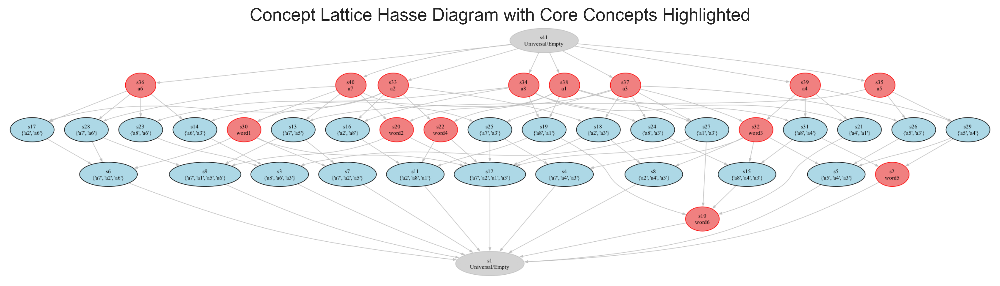

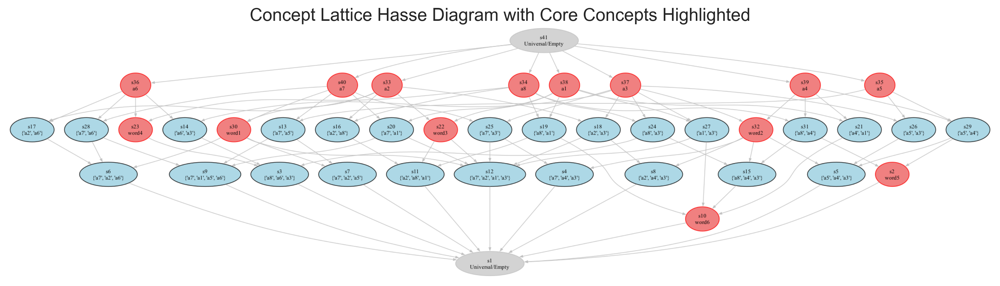

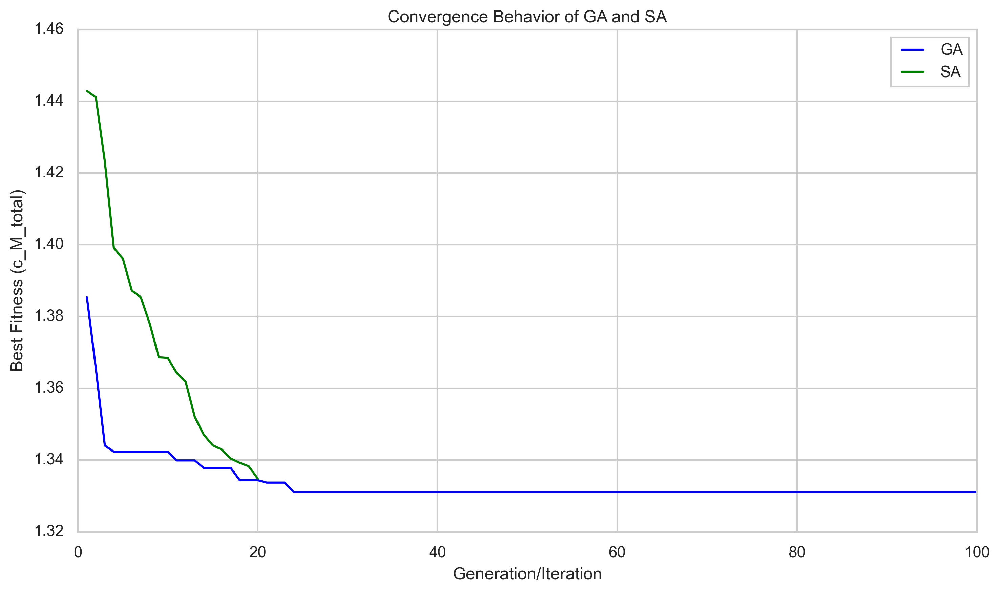

In [103]:
"""
Convergence Behavior Analysis of Genetic Algorithms (GA) and Simulated Annealing (SA) on the TAE Dataset

This script analyzes the convergence behavior of Genetic Algorithms (GA) and Simulated Annealing (SA)
when applied to a concept lattice derived from the TAE dataset. The analysis includes:

1. Assigning unique IDs to concepts in the lattice.
2. Building a Hasse diagram to represent the lattice structure.
3. Identifying universal and empty concepts.
4. Selecting attribute concepts and defining core concepts (C_M).
5. Generating weighted frequencies for concepts.
6. Running both GA and SA to optimize the selection of core concepts.
7. Calculating generation costs and generating word sequences.
8. Visualizing the Hasse diagram with core concepts highlighted.
9. Comparing the convergence behaviors of GA and SA.

**Note:** Replace the `concepts_lattice` with your actual TAE dataset.

Dependencies:
- networkx
- matplotlib
- numpy
- pygraphviz (for visualization)
- logging

Ensure all dependencies are installed before running the script.
"""

from typing import Set, List, Tuple, Dict
import networkx as nx
import matplotlib.pyplot as plt
import random
import numpy as np
import logging
import sys

# ----------------------------
# Function Definitions
# ----------------------------

def assign_ids(concepts_lattice: List[Tuple[Set[str], Tuple[str, ...]]]) -> List[Tuple[str, frozenset, frozenset]]:
    """
    Assigns unique IDs to each concept in the lattice.

    Returns:
    - List of tuples: (ID, extent, intent)
    """
    assigned_concepts = []
    for idx, (extent, intent) in enumerate(concepts_lattice, start=1):
        concept_id = f's{idx}'
        assigned_concepts.append((concept_id, frozenset(extent), frozenset(intent)))
    return assigned_concepts

def build_hasse_diagram(assigned_concepts: List[Tuple[str, frozenset, frozenset]]) -> nx.DiGraph:
    """
    Builds a directed Hasse diagram graph where each node is a concept ID.
    Edges point from a concept to its immediate subconcepts.

    Returns:
    - Directed Graph (networkx.DiGraph)
    """
    DG = nx.DiGraph()
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}

    # Initialize nodes
    for cid, _, _ in assigned_concepts:
        DG.add_node(cid)

    # For each concept, find its immediate subconcepts
    for cid_c, _, intent_c in assigned_concepts:
        # Potential subconcepts are those with intents that are supersets of intent_c and not equal
        potential_subconcepts = [(cid_d, intent_d) for cid_d, _, intent_d in assigned_concepts
                                 if intent_d != intent_c and intent_d.issuperset(intent_c)]

        # Now, for each potential subconcept, check if it's an immediate subconcept
        for cid_d, intent_d in potential_subconcepts:
            # There should be no concept intent_e such that intent_c ⊂ intent_e ⊂ intent_d
            is_immediate = True
            for cid_e, _, intent_e in assigned_concepts:
                if intent_e != intent_c and intent_e != intent_d:
                    if intent_e.issuperset(intent_c) and intent_e.issubset(intent_d):
                        is_immediate = False
                        break
            if is_immediate:
                # Add edge from cid_c to cid_d
                DG.add_edge(cid_c, cid_d)

    return DG

def find_attribute_concepts(assigned_concepts: List[Tuple[str, frozenset, frozenset]], 
                           all_attributes: Set[str],
                           exclude_concepts: Set[str]) -> Dict[str, str]:
    """
    Finds the attribute concepts s_{A_i} for each attribute A_i in all_attributes,
    excluding any concepts in exclude_concepts.

    Returns:
    - Dictionary mapping attribute A_i to concept ID of s_{A_i}
    """
    attribute_concepts = {}
    for A_i in all_attributes:
        # Find concepts where A_i is in intent and not excluded
        concepts_with_Ai = [(cid, intent) for cid, _, intent in assigned_concepts 
                            if A_i in intent and cid not in exclude_concepts]
        if not concepts_with_Ai:
            continue  # No concepts with A_i in intent
        # Find minimal intent size
        min_intent_size = min(len(intent) for cid, intent in concepts_with_Ai)
        # Select concepts with minimal intent size
        minimal_concepts = [(cid, intent) for cid, intent in concepts_with_Ai 
                            if len(intent) == min_intent_size]
        # If multiple concepts, pick one (e.g., first)
        cid_min, _ = minimal_concepts[0]
        attribute_concepts[A_i] = cid_min
    return attribute_concepts

def generate_weighted_frequencies(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                                  C_M: Set[str],
                                  exclude_concepts: Set[str],
                                  seed_value: int = 42) -> Dict[str, float]:
    """
    Generates weighted frequency values for each concept.
    Core concepts (attributes and randomly selected) are assigned higher frequencies.
    Other concepts are assigned lower frequencies.
    The frequencies are normalized to sum to 1.

    Parameters:
    - assigned_concepts: List of all assigned concepts with IDs.
    - C_M: Core concepts subset.
    - exclude_concepts: Set of concepts to exclude from processing.
    - seed_value: Seed for random number generator for reproducibility.

    Returns:
    - Dictionary mapping concept IDs to their frequencies.
    """
    random.seed(seed_value)
    frequencies = {}
    total = 0.0

    for cid, _, intent in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts
        if cid in C_M:
            # Assign higher frequency range for core concepts
            freq = random.uniform(0.4, 1.0)  # Adjusted range for core concepts
        else:
            # Assign lower frequency range for non-core concepts
            freq = random.uniform(0.05, 0.3)  # Adjusted range for non-core concepts
        frequencies[cid] = freq
        total += freq

    # Normalize frequencies to sum to 1
    for cid in frequencies:
        frequencies[cid] /= total

    return frequencies

def assign_words_to_core_concepts(C_M: Set[str], 
                                  assigned_concepts: List[Tuple[str, frozenset, frozenset]], 
                                  attribute_to_cid: Dict[str, str], 
                                  P_s: Dict[str, float]) -> Dict[str, str]:
    """
    Assigns unique words to concepts in the core concepts C_M.

    Parameters:
    - C_M: Set of concept IDs in core concepts.
    - assigned_concepts: List of all assigned concepts with IDs.
    - attribute_to_cid: Mapping from attribute A_i to concept ID s_{A_i}
    - P_s: Frequency distribution of concepts.

    Returns:
    - Dictionary mapping concept IDs to words.
    """
    C_M_word_map = {}
    used_words = set()

    # Map from concept ID to intent and extent
    cid_to_intent = {cid: intent for cid, _, intent in assigned_concepts}
    cid_to_extent = {cid: extent for cid, extent, _ in assigned_concepts}

    # Assign words to attribute concepts
    for A_i, cid in attribute_to_cid.items():
        C_M_word_map[cid] = A_i
        used_words.add(A_i)

    # Identify randomly selected core concepts (C_M excluding attribute concepts)
    attribute_concept_ids = set(attribute_to_cid.values())
    random_core_concepts = C_M - attribute_concept_ids

    # If there are randomly selected core concepts, assign words based on frequency
    if random_core_concepts:
        # Sort randomly selected core concepts based on descending frequency
        sorted_random_C_M = sorted(random_core_concepts, key=lambda cid: P_s.get(cid, 0), reverse=True)

        extra_word_counter = 1

        for cid in sorted_random_C_M:
            extent = cid_to_extent[cid]
            intent = cid_to_intent[cid]
            # Prefer words from the intent
            possible_words = sorted(intent)
            # If intent is empty, use words from extent
            if not possible_words:
                possible_words = sorted(extent)
            # Assign the first available word not already used
            assigned = False
            for word in possible_words:
                if word not in used_words:
                    C_M_word_map[cid] = word
                    used_words.add(word)
                    assigned = True
                    break
            if not assigned:
                # If all words in intent and extent are used, assign any new unique word
                word = f'word{extra_word_counter}'
                extra_word_counter += 1
                C_M_word_map[cid] = word
                used_words.add(word)
    return C_M_word_map

def calculate_costs(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                   DG: nx.DiGraph,
                   C_M: Set[str],
                   id_to_intent: Dict[str, frozenset],
                   alpha_p: int = 1,
                   alpha_c: int = 2,
                   exclude_concepts: Set[str] = set(),
                   verbose: bool = False) -> Tuple[Dict[str, float], Dict[str, Tuple[str, str, Set[str]]]]:
    """
    Calculates the generation cost c(s) for each concept and identifies the minimal cost paths.

    Parameters:
    - assigned_concepts: List of all assigned concepts with IDs.
    - DG: Directed Hasse diagram graph.
    - C_M: Core concepts subset.
    - id_to_intent: Mapping from concept ID to intent.
    - alpha_p: Cost parameter for superconcept paths.
    - alpha_c: Cost parameter for subconcept paths.
    - exclude_concepts: Set of concepts to exclude from processing.

    Returns:
    - Tuple containing:
        - Dictionary mapping concept IDs to their costs.
        - Dictionary mapping concept IDs to their minimal cost path information.
    """
    c = {}
    min_cost_paths = {}  # To store minimal cost path info for each concept

    for cid, _, intent_s in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts
        if verbose:
            print(f"\nProcessing Concept {cid} with Intent: {set(intent_s)}")
        if cid in C_M:
            c_s = 1  # Single word representation
            c[cid] = c_s
            if verbose:
                print(f"  {cid} is in C_M. c({cid}) = {c_s}")
            min_cost_paths[cid] = ('core_concept', cid, set())
            continue
        # Initialize min_cost to a large value
        min_cost = float('inf')
        min_path = None  # To store minimal cost path info
        # Find nearest superconcepts in C_M
        superconcepts_in_C_M = set(nx.ancestors(DG, cid)).intersection(C_M)
        if superconcepts_in_C_M:
            # Reduce to nearest superconcepts in C_M
            nearest_superconcepts = []
            min_length = float('inf')
            for super_cid in superconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=super_cid, target=cid)
                    if length < min_length:
                        min_length = length
                        nearest_superconcepts = [super_cid]
                    elif length == min_length:
                        nearest_superconcepts.append(super_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest superconcepts in C_M: {sorted(nearest_superconcepts)}")
            for super_cid in nearest_superconcepts:
                # Compute cost via superconcept
                intent_s_p = id_to_intent[super_cid]
                A_r = intent_s - intent_s_p  # Remaining attributes
                cost_p = alpha_p * (1 + len(A_r))
                if verbose:
                    print(f"    Via Superconcept {super_cid}:")
                    print(f"      Attributes covered by {super_cid}: {intent_s_p}")
                    print(f"      Remaining Attributes to Add: {A_r}")
                    print(f"      Cost: {alpha_p} * (1 + {len(A_r)}) = {cost_p}")
                if cost_p < min_cost:
                    min_cost = cost_p
                    min_path = ('superconcept', super_cid, A_r)
        else:
            if verbose:
                print("  No superconcepts in C_M.")

        # Find nearest subconcepts in C_M
        subconcepts_in_C_M = set(nx.descendants(DG, cid)).intersection(C_M)
        if subconcepts_in_C_M:
            # Reduce to nearest subconcepts in C_M
            nearest_subconcepts = []
            min_length = float('inf')
            for sub_cid in subconcepts_in_C_M:
                try:
                    length = nx.shortest_path_length(DG, source=cid, target=sub_cid)
                    if length < min_length:
                        min_length = length
                        nearest_subconcepts = [sub_cid]
                    elif length == min_length:
                        nearest_subconcepts.append(sub_cid)
                except nx.NetworkXNoPath:
                    continue
            if verbose:
                print(f"  Nearest subconcepts in C_M: {sorted(nearest_subconcepts)}")
            for sub_cid in nearest_subconcepts:
                # Compute cost via subconcept
                intent_s_c = id_to_intent[sub_cid]
                A_e = intent_s_c - intent_s  # Extra attributes to remove
                cost_c = alpha_c * (1 + len(A_e))
                if verbose:
                    print(f"    Via Subconcept {sub_cid}:")
                    print(f"      Attributes covered by {sub_cid}: {intent_s_c}")
                    print(f"      Extra Attributes to Remove: {A_e}")
                    print(f"      Cost: {alpha_c} * (1 + {len(A_e)}) = {cost_c}")
                if cost_c < min_cost:
                    min_cost = cost_c
                    min_path = ('subconcept', sub_cid, A_e)
        else:
            if verbose:
                print("  No subconcepts in C_M.")

        if min_cost == float('inf'):
            # No paths via C_M, assign default cost
            c_s = alpha_p * len(intent_s)
            if verbose:
                print(f"  No paths via C_M. Assigning default cost: c({cid}) = {c_s}")
            min_cost_paths[cid] = ('default', '', intent_s)
        else:
            c_s = min_cost
            if verbose:
                print(f"  Minimal Cost for {cid}: c({cid}) = {c_s}")
            min_cost_paths[cid] = min_path

        c[cid] = c_s

    return c, min_cost_paths

def generate_word_sequences(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                            DG: nx.DiGraph,
                            C_M: Set[str],
                            C_M_word_map: Dict[str, str],
                            c: Dict[str, float],
                            min_cost_paths: Dict[str, Tuple[str, str, Set[str]]],
                            exclude_concepts: Set[str],
                            attribute_to_cid: Dict[str, str],
                            ) -> Dict[str, str]:
    """
    Generates word sequences for each concept based on the minimal cost paths used in cost calculation.

    Parameters:
    - assigned_concepts: List of all assigned concepts with IDs.
    - DG: Directed Hasse diagram graph.
    - C_M: Core concepts subset.
    - C_M_word_map: Mapping from core concept IDs to words.
    - c: Dictionary of minimal costs for each concept.
    - min_cost_paths: Dictionary of minimal cost paths for each concept.
    - exclude_concepts: Set of concepts to exclude from processing.
    - attribute_to_cid: Mapping from attribute A_i to concept ID s_{A_i}

    Returns:
    - Dictionary mapping concept IDs to their generated word sequences.
    """
    word_sequences = {}

    for cid, _, intent_s in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts

        path_info = min_cost_paths.get(cid)
        if not path_info:
            # Assign 'Unknown' if no minimal cost path was found
            word_sequences[cid] = 'Unknown'
            continue

        path_type, ref_cid, attributes = path_info

        if path_type == 'core_concept':
            # Concept is in C_M
            word_sequences[cid] = C_M_word_map[cid]
        elif path_type in ['superconcept', 'subconcept']:
            # Word sequence is word of ref_cid + words of attributes
            words = [C_M_word_map[ref_cid]]
            for A_i in attributes:
                s_Ai_cid = attribute_to_cid.get(A_i)
                if s_Ai_cid and s_Ai_cid in C_M_word_map:
                    words.append(C_M_word_map[s_Ai_cid])
                else:
                    # Attribute concept not found, use attribute name
                    words.append(A_i)
            sequence = ' '.join(words)
            word_sequences[cid] = sequence.strip()
        elif path_type == 'default':
            # No paths via C_M, use words of attributes directly
            words = []
            for A_i in attributes:
                s_Ai_cid = attribute_to_cid.get(A_i)
                if s_Ai_cid and s_Ai_cid in C_M_word_map:
                    words.append(C_M_word_map[s_Ai_cid])
                else:
                    # Attribute concept not found, use attribute name
                    words.append(A_i)
            sequence = ' '.join(words)
            word_sequences[cid] = sequence.strip()
        else:
            # Should not happen, but handle unexpected cases
            word_sequences[cid] = 'Unknown'

    return word_sequences

def visualize_hasse_diagram(DG: nx.DiGraph, 
                            id_to_intent: Dict[str, frozenset], 
                            C_M_word_map: Dict[str, str], 
                            C_M: Set[str], 
                            exclude_concepts: Set[str], 
                            output_filename: str = 'concept_lattice_hasse.png', 
                            dpi: int = 300):
    """
    Visualizes the Hasse diagram of the concept lattice using NetworkX and PyGraphviz.
    The graph is set to display from Top to Bottom (rankdir=TB).

    Parameters:
    - DG: Directed Hasse diagram graph.
    - id_to_intent: Mapping from concept ID to intent.
    - C_M_word_map: Mapping from core concept IDs to words.
    - C_M: Core concepts subset.
    - exclude_concepts: Set of concepts to exclude from visualization (e.g., universal and empty).
    - output_filename: Filename for saving the visualization.
    - dpi: Resolution of the saved image.
    """
    try:
        import pygraphviz
        from networkx.drawing.nx_agraph import to_agraph
    except ImportError:
        print("PyGraphviz is not installed. Please install it to visualize the Hasse diagram.")
        return

    # Initialize PyGraphviz AGraph
    A = to_agraph(DG)

    # Set graph attributes for Top to Bottom direction
    A.graph_attr.update(rankdir='TB')  # Top to Bottom

    # Apply hierarchical layout
    A.layout(prog='dot')  # 'dot' is suitable for hierarchical layouts

    # Customize node styles
    for node in A.nodes():
        cid = node.name
        word = C_M_word_map.get(cid, '')
        if cid in C_M:
            node.attr['color'] = 'red'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightcoral'
            node.attr['label'] = f"{cid}\n{word}"
        elif cid in exclude_concepts:
            node.attr['color'] = 'gray'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightgray'
            node.attr['label'] = f"{cid}\nUniversal/Empty"
        else:
            node.attr['color'] = 'black'
            node.attr['style'] = 'filled'
            node.attr['fillcolor'] = 'lightblue'
            node.attr['label'] = f"{cid}\n{set(id_to_intent[cid])}"
        node.attr['shape'] = 'ellipse'
        node.attr['fontsize'] = '10'

    # Customize edge styles
    for edge in A.edges():
        edge.attr['color'] = 'gray'
        edge.attr['arrowsize'] = '0.5'

    # Render the graph to a file with high resolution
    A.draw(output_filename, format='png', prog='dot')

    # Display the graph using matplotlib with increased figure size for better clarity
    plt.figure(figsize=(16, 12), dpi=dpi)  # Increased figure size and DPI
    img = plt.imread(output_filename)
    plt.imshow(img)
    plt.axis('off')
    plt.title("Concept Lattice Hasse Diagram with Core Concepts Highlighted", fontsize=16)
    plt.show()

def print_relationships(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                        DG: nx.DiGraph,
                        id_to_intent: Dict[str, frozenset],
                        C_M: Set[str],
                        exclude_concepts: Set[str]) -> None:
    """
    Prints all superconcepts and subconcepts in L and C_M for each concept,
    excluding the universal and empty concepts.
    """
    for cid, extent, intent in assigned_concepts:
        if cid in exclude_concepts:
            continue  # Skip universal and empty concepts

        print(f"Concept ID: {cid}")
        print("-" * 40)
        print(f"  Extent (Objects): {set(extent)}")
        print(f"  Intent (Attributes): {set(intent)}\n")

        # All superconcepts in L, excluding universal and empty concepts
        all_super_in_L = nx.ancestors(DG, cid) - exclude_concepts
        if all_super_in_L:
            print("  All Superconcepts in L:")
            for super_id in sorted(all_super_in_L, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("  All Superconcepts in L: None")

        # All superconcepts in C_M
        all_super_in_C_M = all_super_in_L.intersection(C_M)
        if all_super_in_C_M:
            print("\n  All Superconcepts in C_M:")
            for super_id in sorted(all_super_in_C_M, key=lambda x: int(x[1:])):
                super_intent = id_to_intent.get(super_id, set())
                print(f"    {super_id}: {set(super_intent)}")
        else:
            print("\n  All Superconcepts in C_M: None")

        # All subconcepts in L, excluding universal and empty concepts
        all_sub_in_L = nx.descendants(DG, cid) - exclude_concepts
        if all_sub_in_L:
            print("\n  All Subconcepts in L:")
            for sub_id in sorted(all_sub_in_L, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in L: None")

        # All subconcepts in C_M
        all_sub_in_C_M = all_sub_in_L.intersection(C_M)
        if all_sub_in_C_M:
            print("\n  All Subconcepts in C_M:")
            for sub_id in sorted(all_sub_in_C_M, key=lambda x: int(x[1:])):
                sub_intent = id_to_intent.get(sub_id, set())
                print(f"    {sub_id}: {set(sub_intent)}")
        else:
            print("\n  All Subconcepts in C_M: None")

        print("-" * 40 + "\n")

# Genetic Algorithm Functions with Improvements

def initialize_population(pop_size: int,
                          num_additional_concepts: int,
                          attribute_concept_ids: Set[str],
                          exclude_concepts: Set[str],
                          total_concepts: List[str],
                          seed_value: int = 42) -> List[Set[str]]:
    """
    Initializes a population of individuals (subsets of concept IDs).
    Ensures diversity by random sampling.
    """
    random.seed(seed_value)
    population = []
    eligible_concepts = set(total_concepts) - attribute_concept_ids - exclude_concepts
    for _ in range(pop_size):
        if num_additional_concepts > len(eligible_concepts):
            sampled = set(random.sample(eligible_concepts, len(eligible_concepts)))
        else:
            sampled = set(random.sample(eligible_concepts, num_additional_concepts))
        individual = sampled.copy()
        individual.update(attribute_concept_ids)
        population.append(individual)
    return population

def ga_fitness_function(C_M_candidate: Set[str],
                        assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                        DG: nx.DiGraph,
                        exclude_concepts: Set[str],
                        id_to_intent: Dict[str, frozenset],
                        P_s: Dict[str, float],
                        attribute_to_cid: Dict[str, str],
                        alpha_p: int = 1,
                        alpha_c: int = 2) -> float:
    """
    Calculates the total expected generation cost c_M for a candidate C_M.
    """
    c_candidate, _ = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M_candidate,
        id_to_intent=id_to_intent,
        alpha_p=alpha_p,
        alpha_c=alpha_c,
        exclude_concepts=exclude_concepts,
        verbose=False
    )

    # Calculate Total Expected Generation Cost c_M
    c_M_total = 0.0
    for cid in c_candidate:
        c_s = c_candidate[cid]
        ps = P_s.get(cid, 0)
        term = c_s * ps
        c_M_total += term
    return c_M_total

def selection(population: List[Set[str]], fitness_scores: List[float], num_parents: int) -> List[Set[str]]:
    """
    Selects parents for crossover based on fitness scores using tournament selection.
    """
    parents = []
    for _ in range(num_parents):
        # Tournament selection with k=3
        candidates = random.sample(list(zip(population, fitness_scores)), k=3)
        parent = min(candidates, key=lambda x: x[1])[0]  # Select the individual with the lowest fitness
        parents.append(parent)
    return parents

def crossover(parent1: Set[str], parent2: Set[str], attribute_concept_ids: Set[str]) -> Set[str]:
    """
    Performs uniform crossover between two parents to produce an offspring.
    Ensures consistent gene ordering by sorting.
    """
    offspring = set()
    genes1 = sorted(parent1 - attribute_concept_ids)
    genes2 = sorted(parent2 - attribute_concept_ids)

    # Ensure both gene lists are of the same length by padding shorter one
    max_length = max(len(genes1), len(genes2))
    genes1.extend([None] * (max_length - len(genes1)))
    genes2.extend([None] * (max_length - len(genes2)))

    for gene1, gene2 in zip(genes1, genes2):
        if gene1 is None and gene2 is not None:
            offspring.add(gene2)
        elif gene2 is None and gene1 is not None:
            offspring.add(gene1)
        elif gene1 is not None and gene2 is not None:
            if random.random() < 0.5:
                offspring.add(gene1)
            else:
                offspring.add(gene2)
        # If both genes are None, do nothing

    # Ensure attribute concepts are included
    offspring.update(attribute_concept_ids)
    return offspring

def mutation(individual: Set[str], mutation_rate: float, eligible_concepts: Set[str], attribute_concept_ids: Set[str]) -> Set[str]:
    """
    Mutates an individual by randomly adding/removing concepts.
    """
    individual = set(individual)
    non_attribute_genes = individual - attribute_concept_ids
    for gene in list(non_attribute_genes):
        if random.random() < mutation_rate:
            individual.remove(gene)
            available_genes = eligible_concepts - individual
            if available_genes:
                new_gene = random.choice(list(available_genes))
                individual.add(new_gene)
    # Attribute concepts remain included
    individual.update(attribute_concept_ids)
    return individual

def calculate_genotypic_diversity(population: List[Set[str]]) -> float:
    """
    Calculates the average pairwise Hamming distance among individuals.
    """
    total_distance = 0
    count = 0
    pop_list = [set(individual) for individual in population]
    for i in range(len(pop_list)):
        for j in range(i + 1, len(pop_list)):
            distance = len(pop_list[i].symmetric_difference(pop_list[j]))
            total_distance += distance
            count += 1
    return total_distance / count if count > 0 else 0

def genetic_algorithm(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                      DG: nx.DiGraph,
                      exclude_concepts: Set[str],
                      id_to_intent: Dict[str, frozenset],
                      P_s: Dict[str, float],
                      attribute_to_cid: Dict[str, str],
                      total_concepts: List[str],
                      pop_size: int = 50,
                      num_generations: int = 100,
                      mutation_rate: float = 0.1,
                      alpha_p: int = 1,
                      alpha_c: int = 2,
                      desired_percentage: float = 0.20,
                      seed_value: int = 42,
                      elitism_rate: float = 0.05) -> Tuple[Set[str], List[float]]:
    """
    Runs the genetic algorithm to find the optimal subset C_M.
    Incorporates elitism to preserve top individuals across generations.

    Returns:
    - Best individual found (Set[str]).
    - List of best fitness scores per generation.
    """
    random.seed(seed_value)
    np.random.seed(seed_value)

    # Calculate elite count
    elite_count = max(1, int(elitism_rate * pop_size))

    attribute_concept_ids = set(attribute_to_cid.values())
    total_concepts_set = set(total_concepts) - exclude_concepts

    # Calculate number of additional concepts to select (excluding attribute concepts)
    num_additional_concepts = int(round(desired_percentage * len(total_concepts_set - attribute_concept_ids)))
    # Ensure we don't select more concepts than are available
    num_additional_concepts = min(num_additional_concepts, len(total_concepts_set - attribute_concept_ids))

    # Total number of concepts to select (size of C_M)
    total_concepts_to_select = len(attribute_concept_ids) + num_additional_concepts

    print(f"Genetic Algorithm:")
    print(f"Total number of concepts in the lattice (excluding exclude_concepts): {len(total_concepts_set)}")
    print(f"Number of attribute concepts: {len(attribute_concept_ids)}")
    print(f"Desired percentage of additional concepts: {desired_percentage * 100}%")
    print(f"Number of additional concepts to select: {num_additional_concepts}")
    print(f"Total number of concepts in C_M: {total_concepts_to_select}\n")

    # Initialize population
    population = initialize_population(
        pop_size=pop_size,
        num_additional_concepts=num_additional_concepts,
        attribute_concept_ids=attribute_concept_ids,
        exclude_concepts=exclude_concepts,
        total_concepts=total_concepts,
        seed_value=seed_value
    )

    best_fitness = float('inf')
    best_individual = None
    fitness_history = []

    # Configure logging for monitoring
    logging.basicConfig(filename='ga_log.txt', level=logging.INFO,
                        format='%(asctime)s - Generation %(message)s')

    for generation in range(num_generations):
        fitness_scores = [ga_fitness_function(
            individual, assigned_concepts, DG, exclude_concepts, id_to_intent, P_s, attribute_to_cid,
            alpha_p, alpha_c) for individual in population]

        # Identify elite individuals
        elite_indices = np.argsort(fitness_scores)[:elite_count]
        elites = [population[i] for i in elite_indices]
        elite_fitness = [fitness_scores[i] for i in elite_indices]

        # Update best individual
        if elite_fitness[0] < best_fitness:
            best_fitness = elite_fitness[0]
            best_individual = elites[0].copy()

        fitness_history.append(best_fitness)

        # Calculate diversity
        diversity = calculate_genotypic_diversity(population)

        # Log current generation's best fitness and diversity
        logging.info(f"{generation + 1}, Best Fitness: {best_fitness:.4f}, Diversity: {diversity:.4f}")

        # Selection
        parents = selection(population, fitness_scores, num_parents=pop_size // 2)

        # Crossover and Mutation to create new population
        offspring = []
        eligible_concepts = set(total_concepts_set) - attribute_concept_ids
        while len(offspring) < pop_size - elite_count:
            parent1, parent2 = random.sample(parents, 2)
            child = crossover(parent1, parent2, attribute_concept_ids)
            # Adaptive mutation rate based on diversity (optional)
            adjusted_mutation_rate = mutation_rate * (1 - diversity / len(eligible_concepts))
            child = mutation(child, adjusted_mutation_rate, eligible_concepts, attribute_concept_ids)
            offspring.append(child)

        # Combine elites with offspring to form the new population
        population = elites + offspring

        if (generation + 1) % 10 == 0 or generation == 0:
            print(f"GA Generation {generation + 1}/{num_generations}, Best Fitness: {best_fitness:.4f}")

    print(f"\nGA Optimal c_M_total found: {best_fitness:.4f}")
    return best_individual, fitness_history

# Simulated Annealing Functions

def initial_solution_sa(attribute_concept_ids: Set[str],
                       eligible_concepts: Set[str],
                       num_additional_concepts: int) -> Set[str]:
    """
    Generates an initial solution (subset of concept IDs).
    """
    solution = set(random.sample(eligible_concepts, num_additional_concepts))
    solution.update(attribute_concept_ids)
    return solution

def sa_fitness_function(C_M_candidate: Set[str],
                        assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                        DG: nx.DiGraph,
                        exclude_concepts: Set[str],
                        id_to_intent: Dict[str, frozenset],
                        P_s: Dict[str, float],
                        attribute_to_cid: Dict[str, str],
                        alpha_p: int = 1,
                        alpha_c: int = 2) -> float:
    """
    Calculates the total expected generation cost c_M for a candidate C_M.
    """
    c_candidate, _ = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M_candidate,
        id_to_intent=id_to_intent,
        alpha_p=alpha_p,
        alpha_c=alpha_c,
        exclude_concepts=exclude_concepts,
        verbose=False  # Suppress detailed tracing during fitness evaluation
    )

    # Calculate Total Expected Generation Cost c_M
    c_M_total = 0.0
    for cid in c_candidate:
        c_s = c_candidate[cid]
        ps = P_s.get(cid, 0)
        term = c_s * ps
        c_M_total += term
    return c_M_total

def get_neighbor_sa(solution: Set[str],
                   attribute_concept_ids: Set[str],
                   eligible_concepts: Set[str]) -> Set[str]:
    """
    Generates a neighboring solution by swapping a concept.
    """
    neighbor = set(solution)
    non_attribute_genes = neighbor - attribute_concept_ids
    if not non_attribute_genes:
        return neighbor  # No non-attribute genes to swap

    # Remove a random non-attribute concept
    gene_to_remove = random.choice(list(non_attribute_genes))
    neighbor.remove(gene_to_remove)

    # Add a new concept not in the current solution
    available_genes = eligible_concepts - neighbor - attribute_concept_ids
    if available_genes:
        gene_to_add = random.choice(list(available_genes))
        neighbor.add(gene_to_add)
    else:
        # If no available genes, re-add the removed gene
        neighbor.add(gene_to_remove)

    return neighbor

def simulated_annealing(assigned_concepts: List[Tuple[str, frozenset, frozenset]],
                        DG: nx.DiGraph,
                        exclude_concepts: Set[str],
                        id_to_intent: Dict[str, frozenset],
                        P_s: Dict[str, float],
                        attribute_to_cid: Dict[str, str],
                        total_concepts: List[str],
                        initial_temp: float = 1000.0,
                        final_temp: float = 1.0,
                        alpha: float = 0.95,
                        num_iterations: int = 100,
                        desired_percentage: float = 0.20,
                        seed_value: int = None) -> Tuple[Set[str], List[float]]:
    """
    Runs the simulated annealing algorithm to find the optimal subset C_M.

    Returns:
    - Best solution found (Set[str]).
    - List of best fitness scores per temperature step.
    """
    if seed_value is not None:
        random.seed(seed_value)
        np.random.seed(seed_value)

    attribute_concept_ids = set(attribute_to_cid.values())
    total_concepts_set = set(total_concepts) - exclude_concepts

    # Calculate number of additional concepts to select (excluding attribute concepts)
    num_additional_concepts = int(round(desired_percentage * len(total_concepts_set - attribute_concept_ids)))
    # Ensure we don't select more concepts than are available
    num_additional_concepts = min(num_additional_concepts, len(total_concepts_set - attribute_concept_ids))

    # Total number of concepts to select (size of C_M)
    total_concepts_to_select = len(attribute_concept_ids) + num_additional_concepts

    print(f"Simulated Annealing:")
    print(f"Total number of concepts in the lattice (excluding exclude_concepts): {len(total_concepts_set)}")
    print(f"Number of attribute concepts: {len(attribute_concept_ids)}")
    print(f"Desired percentage of additional concepts: {desired_percentage * 100}%")
    print(f"Number of additional concepts to select: {num_additional_concepts}")
    print(f"Total number of concepts in C_M: {total_concepts_to_select}\n")

    # Generate initial solution
    eligible_concepts = total_concepts_set - attribute_concept_ids
    current_solution = initial_solution_sa(attribute_concept_ids, eligible_concepts, num_additional_concepts)
    current_fitness = sa_fitness_function(
        C_M_candidate=current_solution,
        assigned_concepts=assigned_concepts,
        DG=DG,
        exclude_concepts=exclude_concepts,
        id_to_intent=id_to_intent,
        P_s=P_s,
        attribute_to_cid=attribute_to_cid
    )

    best_solution = set(current_solution)
    best_fitness = current_fitness
    fitness_history = [best_fitness]

    temp = initial_temp
    iteration = 0

    while temp > final_temp:
        for _ in range(num_iterations):
            neighbor_solution = get_neighbor_sa(current_solution, attribute_concept_ids, eligible_concepts)
            neighbor_fitness = sa_fitness_function(
                C_M_candidate=neighbor_solution,
                assigned_concepts=assigned_concepts,
                DG=DG,
                exclude_concepts=exclude_concepts,
                id_to_intent=id_to_intent,
                P_s=P_s,
                attribute_to_cid=attribute_to_cid
            )

            delta_fitness = neighbor_fitness - current_fitness

            if delta_fitness < 0 or random.uniform(0, 1) < np.exp(-delta_fitness / temp):
                current_solution = neighbor_solution
                current_fitness = neighbor_fitness

                if current_fitness < best_fitness:
                    best_solution = set(current_solution)
                    best_fitness = current_fitness
                    fitness_history.append(best_fitness)

        temp *= alpha
        iteration += 1
        print(f"SA Iteration {iteration}, Temperature: {temp:.4f}, Best Fitness: {best_fitness:.4f}")

    print(f"\nSA Optimal c_M_total found: {best_fitness:.4f}")
    return best_solution, fitness_history

# ----------------------------
# Main Execution
# ----------------------------

def main():
    # ----------------------------
    # Define the Concept Lattice Data
    # ----------------------------
    # Replace the following example data with your actual TAE dataset
    # Example: concepts_lattice = [(set_of_extent, tuple_of_intent), ...]
    # Example concept lattice with 5 concepts
    concepts_lattice = lattice4

    # Assign unique IDs to each concept
    assigned_concepts = assign_ids(concepts_lattice)

    # Create mappings for easy reference
    intent_to_id = {intent: cid for cid, _, intent in assigned_concepts}
    id_to_intent = {cid: intent for cid, _, intent in assigned_concepts}

    # Build directed Hasse diagram
    DG = build_hasse_diagram(assigned_concepts)  # Directed Hasse diagram

    # Build set of all objects and all attributes
    all_objects = set()
    all_attributes = set()
    for extent, intent in concepts_lattice:
        all_objects.update(extent)
        all_attributes.update(intent)

    # Convert to frozensets for comparison
    all_objects = frozenset(all_objects)
    all_attributes = frozenset(all_attributes)

    # Identify the universal (top) and empty (bottom) concepts
    universal_concept_id = None
    empty_concept_id = None
    for cid, extent, intent in assigned_concepts:
        if extent == all_objects and len(intent) == 0:
            universal_concept_id = cid
        if len(extent) == 0 and intent == all_attributes:
            empty_concept_id = cid

    exclude_concepts = {universal_concept_id, empty_concept_id}
    exclude_concepts.discard(None)  # Remove None values if any

    # Print Universal and Empty Concepts
    print(f"Universal Concept (Greatest): {universal_concept_id}")
    print(f"Empty Concept (Least): {empty_concept_id}\n")

    # Find attribute concepts and define Core Concepts C_M
    attribute_to_cid = find_attribute_concepts(assigned_concepts, all_attributes, exclude_concepts)
    C_M_initial = set(attribute_to_cid.values())

    print("Attribute Concepts (must be included in C_M):")
    for attr, cid in attribute_to_cid.items():
        print(f"  {attr}: {cid}")
    print()

    # Generate weighted frequencies
    P_s = generate_weighted_frequencies(assigned_concepts, C_M_initial, exclude_concepts)

    # Determine population size based on lattice size
    def determine_population_size(total_concepts: int, scaling_factor: float = 0.1) -> int:
        """
        Determines population size based on total number of concepts.
        """
        return max(50, int(total_concepts * scaling_factor))

    total_concept_ids = [cid for cid, _, _ in assigned_concepts]
    lattice_size = len(total_concept_ids) - len(exclude_concepts)
    pop_size = determine_population_size(lattice_size, scaling_factor=0.1)

    # Run Genetic Algorithm to find optimal C_M
    optimal_C_M_ga, fitness_history_ga = genetic_algorithm(
        assigned_concepts=assigned_concepts,
        DG=DG,
        exclude_concepts=exclude_concepts,
        id_to_intent=id_to_intent,
        P_s=P_s,
        attribute_to_cid=attribute_to_cid,
        total_concepts=total_concept_ids,
        pop_size=pop_size,
        num_generations=100,
        mutation_rate=0.1,
        alpha_p=1,
        alpha_c=2,
        desired_percentage=0.20,
        seed_value=42,
        elitism_rate=0.05  # 5% elitism
    )

    C_M_ga = optimal_C_M_ga

    print("\nGA Core Concepts C_M (Attribute Concepts + Optimized Concepts):")
    print(f"Total number of concepts in C_M: {len(C_M_ga)}")
    print(f"Number of attribute concepts: {len(attribute_to_cid)}")
    print(f"Number of additional concepts: {len(C_M_ga) - len(attribute_to_cid)}\n")
    for cid in sorted(C_M_ga, key=lambda x: int(x[1:])):
        intent = id_to_intent[cid]
        print(f"  {cid}: {set(intent)}")
    print("\n" + "="*50 + "\n")

    # Run Simulated Annealing to find optimal C_M
    optimal_C_M_sa, fitness_history_sa = simulated_annealing(
        assigned_concepts=assigned_concepts,
        DG=DG,
        exclude_concepts=exclude_concepts,
        id_to_intent=id_to_intent,
        P_s=P_s,
        attribute_to_cid=attribute_to_cid,
        total_concepts=total_concept_ids,
        initial_temp=1500.0,
        final_temp=1.0,
        alpha=0.95,
        num_iterations=200,
        desired_percentage=0.20,
        seed_value=42  # Set seed for reproducibility
    )

    C_M_sa = optimal_C_M_sa

    print("\nSA Core Concepts C_M (Attribute Concepts + Optimized Concepts):")
    print(f"Total number of concepts in C_M: {len(C_M_sa)}")
    print(f"Number of attribute concepts: {len(attribute_to_cid)}")
    print(f"Number of additional concepts: {len(C_M_sa) - len(attribute_concept_ids)}\n")
    for cid in sorted(C_M_sa, key=lambda x: int(x[1:])):
        intent = id_to_intent[cid]
        print(f"  {cid}: {set(intent)}")
    print("\n" + "="*50 + "\n")

    # Assign words to C_M concepts based on frequency (using GA's C_M)
    C_M_word_map_ga = assign_words_to_core_concepts(C_M_ga, assigned_concepts, attribute_to_cid, P_s)

    # Assign words to C_M concepts based on frequency (using SA's C_M)
    C_M_word_map_sa = assign_words_to_core_concepts(C_M_sa, assigned_concepts, attribute_to_cid, P_s)

    # Print relationships for all concepts, excluding universal and empty concepts
    print("Relationships for GA's C_M:")
    print("---------------------------")
    print_relationships(assigned_concepts, DG, id_to_intent, C_M_ga, exclude_concepts)

    print("Relationships for SA's C_M:")
    print("---------------------------")
    print_relationships(assigned_concepts, DG, id_to_intent, C_M_sa, exclude_concepts)

    # ----------------------------
    # Cost Calculation for GA
    # ----------------------------

    print("\n" + "="*50 + "\n")
    print("Generation Cost c(s) for Each Concept (GA):")
    print("----------------------------------------------------------------")
    # Calculate costs for GA's C_M
    c_ga, min_cost_paths_ga = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M_ga,
        id_to_intent=id_to_intent,
        alpha_p=1,
        alpha_c=2,
        exclude_concepts=exclude_concepts,
        verbose=True
    )

    # Calculate Total Expected Generation Cost c_M for GA
    print("\nTotal Expected Generation Cost c_M (GA):")
    print("----------------------------------------------------------------")
    c_M_total_ga = 0.0
    for cid in sorted(c_ga.keys(), key=lambda x: int(x[1:])):
        c_s = c_ga[cid]
        ps = P_s.get(cid, 0)
        term = c_s * ps
        c_M_total_ga += term
        print(f"  {cid}: c({cid}) * P({cid}) = {c_s} * {ps:.4f} = {term:.4f}")
    print(f"\nTotal Expected Generation Cost c_M (GA) = {c_M_total_ga:.4f}")

    # ----------------------------
    # Cost Calculation for SA
    # ----------------------------

    print("\n" + "="*50 + "\n")
    print("Generation Cost c(s) for Each Concept (SA):")
    print("----------------------------------------------------------------")
    # Calculate costs for SA's C_M
    c_sa, min_cost_paths_sa = calculate_costs(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M_sa,
        id_to_intent=id_to_intent,
        alpha_p=1,
        alpha_c=2,
        exclude_concepts=exclude_concepts,
        verbose=True
    )

    # Calculate Total Expected Generation Cost c_M for SA
    print("\nTotal Expected Generation Cost c_M (SA):")
    print("----------------------------------------------------------------")
    c_M_total_sa = 0.0
    for cid in sorted(c_sa.keys(), key=lambda x: int(x[1:])):
        c_s = c_sa[cid]
        ps = P_s.get(cid, 0)
        term = c_s * ps
        c_M_total_sa += term
        print(f"  {cid}: c({cid}) * P({cid}) = {c_s} * {ps:.4f} = {term:.4f}")
    print(f"\nTotal Expected Generation Cost c_M (SA) = {c_M_total_sa:.4f}")

    # ----------------------------
    # Generate Word Sequences for GA and SA
    # ----------------------------

    # Generate word sequences based on minimal cost paths for GA
    word_sequences_ga = generate_word_sequences(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M_ga,
        C_M_word_map=C_M_word_map_ga,
        c=c_ga,
        min_cost_paths=min_cost_paths_ga,
        exclude_concepts=exclude_concepts,
        attribute_to_cid=attribute_to_cid
    )

    # Generate word sequences based on minimal cost paths for SA
    word_sequences_sa = generate_word_sequences(
        assigned_concepts=assigned_concepts,
        DG=DG,
        C_M=C_M_sa,
        C_M_word_map=C_M_word_map_sa,
        c=c_sa,
        min_cost_paths=min_cost_paths_sa,
        exclude_concepts=exclude_concepts,
        attribute_to_cid=attribute_to_cid
    )

    # Print word sequences for GA
    print("\nWord Sequences for Each Concept (GA):\n")
    for cid in sorted(word_sequences_ga.keys(), key=lambda x: int(x[1:])):  # Sort by numerical ID
        sequence = word_sequences_ga[cid]
        word_count = len(sequence.split()) if sequence else 0
        print(f"{cid}: '{sequence}' (Word Count: {word_count})")

    # Print word sequences for SA
    print("\nWord Sequences for Each Concept (SA):\n")
    for cid in sorted(word_sequences_sa.keys(), key=lambda x: int(x[1:])):  # Sort by numerical ID
        sequence = word_sequences_sa[cid]
        word_count = len(sequence.split()) if sequence else 0
        print(f"{cid}: '{sequence}' (Word Count: {word_count})")

    # ----------------------------
    # Visualization
    # ----------------------------

    # Visualize the Hasse Diagram for GA
    visualize_hasse_diagram(
        DG=DG,
        id_to_intent=id_to_intent,
        C_M_word_map=C_M_word_map_ga,
        C_M=C_M_ga,
        exclude_concepts=exclude_concepts,
        output_filename='concept_lattice_hasse_ga.png',
        dpi=300
    )

    # Visualize the Hasse Diagram for SA
    visualize_hasse_diagram(
        DG=DG,
        id_to_intent=id_to_intent,
        C_M_word_map=C_M_word_map_sa,
        C_M=C_M_sa,
        exclude_concepts=exclude_concepts,
        output_filename='concept_lattice_hasse_sa.png',
        dpi=300
    )

    # ----------------------------
    # Plot Convergence Behaviors
    # ----------------------------

    plt.figure(figsize=(10, 6))
    plt.plot(range(1, len(fitness_history_ga) + 1), fitness_history_ga, label='GA', color='blue')
    plt.plot(range(1, len(fitness_history_sa) + 1), fitness_history_sa, label='SA', color='green')
    plt.xlabel('Generation/Iteration')
    plt.ylabel('Best Fitness (c_M_total)')
    plt.title('Convergence Behavior of GA and SA')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.savefig('convergence_comparison.png', dpi=300)
    plt.show()

if __name__ == "__main__":
    main()
